# Define Input Folder and Files

In [1]:
import os

# Define the folder path
input_folder = "Input_Folder_without_Nan"

# Get the list of CSV file names in the folder
input_files = [file for file in os.listdir(input_folder) if file.endswith('.csv')]

# Print the results
print("Input Folder:", input_folder)
print(f"Input Files: {len(input_files)}")
print(input_files)


Input Folder: Input_Folder_without_Nan
Input Files: 41
['UP002.csv', 'UP003.csv', 'UP004.csv', 'UP008.csv', 'UP009.csv', 'UP012.csv', 'UP014.csv', 'UP016.csv', 'UP017.csv', 'UP018.csv', 'UP019.csv', 'UP020.csv', 'UP021.csv', 'UP022.csv', 'UP023.csv', 'UP024.csv', 'UP025.csv', 'UP026.csv', 'UP028.csv', 'UP029.csv', 'UP030.csv', 'UP031.csv', 'UP032.csv', 'UP033.csv', 'UP034.csv', 'UP035.csv', 'UP036.csv', 'UP037.csv', 'UP038.csv', 'UP039.csv', 'UP040.csv', 'UP041.csv', 'UP042.csv', 'UP043.csv', 'UP044.csv', 'UP046.csv', 'UP048.csv', 'UP049.csv', 'UP050.csv', 'UP051.csv', 'UP052.csv']


In [2]:
import pandas as pd

dataframes_dictionary = {}  # Dictionary to store DataFrames
print(input_folder)
for file in input_files:
    file_path = os.path.join(input_folder, file)
    if os.path.exists(file_path):
        # Load the CSV file
        df = pd.read_csv(file_path)
        dataframes_dictionary[file] = df


Input_Folder_without_Nan


# Add Additional columns to the dataframes

In [3]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
import torch
import torch.nn.functional as F
from torch_geometric.nn import GATConv
from torch_geometric.data import Data

from sklearn.preprocessing import LabelEncoder

# Initialize a label encoder
label_encoder = LabelEncoder()

# Load and process the data
dataframes = []
for file_name in input_files:
    df = dataframes_dictionary[file_name]
    
    # Convert 'From Date' to pandas datetime
    df['From Date'] = pd.to_datetime(df['From Date'])
    
    # Split 'From Date' into Year, Month, Day, Hour
    df['Year'] = df['From Date'].dt.year
    df['Month'] = df['From Date'].dt.month
    df['Day'] = df['From Date'].dt.day
    df['Hour'] = df['From Date'].dt.hour
    
    # Drop the original 'From Date' column
    df.drop('From Date', axis=1, inplace=True)
    
    dataframes.append(df)


# Split the data into training and test sets

In [4]:
train_dataframes = []
test_dataframes = []

split_ratio = 0.85  # 85% train, 15% test
train_size = int(len(dataframes[0]) * split_ratio)

for node_idx, df in enumerate(dataframes):
    # Split the dataframe into train and test sets

    train_df = df.iloc[:train_size]
    test_df = df.iloc[train_size:]
    
    # Append the train and test dataframes to the respective lists
    train_dataframes.append(train_df)
    test_dataframes.append(test_df)

print(f"Train dataframes shape: {train_dataframes[0].shape}")
print(f"Test dataframes shape: {test_dataframes[0].shape}")    

Train dataframes shape: (8343, 15)
Test dataframes shape: (1473, 15)


# Scale the Data

In [7]:
from sklearn.preprocessing import StandardScaler

scalers = {}

feature_scalers = {}

print(train_dataframes[0].dtypes)

# Apply StandardScaler to all numeric columns except 'Year', 'Month', 'Day', 'Hour'
for node_idx, df in enumerate(train_dataframes):

    print(f"Training Processing {input_files[node_idx]}, node index: {node_idx}")
    # Encode the 'Year' column
    df['Year'] = label_encoder.fit_transform(df['Year'])

    numeric_columns = df.select_dtypes(include=[np.number]).columns.tolist()
    columns_to_scale = [col for col in numeric_columns if col not in ['Year', 'Month', 'Day', 'Hour', 'AT (degree C)']]
    
    scaler = StandardScaler()
    df[columns_to_scale] = scaler.fit_transform(df[columns_to_scale])
    feature_scalers[input_files[node_idx]] = scaler

    scaler1 = StandardScaler()
    df['AT (degree C)'] = scaler1.fit_transform(df[['AT (degree C)']])
    
    # Save the scaler for the target column
    scalers[input_files[node_idx]] = scaler1


print(test_dataframes[0].dtypes)    

# Apply the same scaling to the test dataframes
for node_idx, df in enumerate(test_dataframes):

    print(f"Testing Processing {input_files[node_idx]}, node index: {node_idx}, shape: {df.shape}")
    # Encode the 'Year' column
    df['Year'] = label_encoder.fit_transform(df['Year'])

    numeric_columns = df.select_dtypes(include=[np.number]).columns.tolist()
    columns_to_scale = [col for col in numeric_columns if col not in ['Year', 'Month', 'Day', 'Hour', 'AT (degree C)']]
    
    scaler = feature_scalers[input_files[node_idx]]
    df[columns_to_scale] = scaler.transform(df[columns_to_scale])
    
    scaler1 = scalers[input_files[node_idx]]
    df['AT (degree C)'] = scaler1.transform(df[['AT (degree C)']])
 

PM2.5 (ug/m3)    float64
PM10 (ug/m3)     float64
NO (ug/m3)       float64
NO2 (ug/m3)      float64
SO2 (ug/m3)      float64
CO (mg/m3)       float64
Ozone (ug/m3)    float64
RH (%)           float64
WS (m/s)         float64
WD (degree)      float64
AT (degree C)    float64
Year               int32
Month              int32
Day                int32
Hour               int32
dtype: object
Training Processing UP002.csv, node index: 0
Training Processing UP003.csv, node index: 1
Training Processing UP004.csv, node index: 2
Training Processing UP008.csv, node index: 3
Training Processing UP009.csv, node index: 4
Training Processing UP012.csv, node index: 5
Training Processing UP014.csv, node index: 6
Training Processing UP016.csv, node index: 7
Training Processing UP017.csv, node index: 8
Training Processing UP018.csv, node index: 9
Training Processing UP019.csv, node index: 10
Training Processing UP020.csv, node index: 11
Training Processing UP021.csv, node index: 12
Training Processing UP0

C:\Users\Asus\AppData\Local\Temp\ipykernel_18636\2524091884.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Year'] = label_encoder.fit_transform(df['Year'])
C:\Users\Asus\AppData\Local\Temp\ipykernel_18636\2524091884.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[columns_to_scale] = scaler.fit_transform(df[columns_to_scale])
C:\Users\Asus\AppData\Local\Temp\ipykernel_18636\2524091884.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usin

Training Processing UP033.csv, node index: 23
Training Processing UP034.csv, node index: 24
Training Processing UP035.csv, node index: 25
Training Processing UP036.csv, node index: 26
Training Processing UP037.csv, node index: 27
Training Processing UP038.csv, node index: 28
Training Processing UP039.csv, node index: 29
Training Processing UP040.csv, node index: 30
Training Processing UP041.csv, node index: 31
Training Processing UP042.csv, node index: 32
Training Processing UP043.csv, node index: 33
Training Processing UP044.csv, node index: 34
Training Processing UP046.csv, node index: 35
Training Processing UP048.csv, node index: 36
Training Processing UP049.csv, node index: 37
Training Processing UP050.csv, node index: 38


C:\Users\Asus\AppData\Local\Temp\ipykernel_18636\2524091884.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['AT (degree C)'] = scaler1.fit_transform(df[['AT (degree C)']])
C:\Users\Asus\AppData\Local\Temp\ipykernel_18636\2524091884.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Year'] = label_encoder.fit_transform(df['Year'])
C:\Users\Asus\AppData\Local\Temp\ipykernel_18636\2524091884.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

Training Processing UP051.csv, node index: 39
Training Processing UP052.csv, node index: 40
PM2.5 (ug/m3)    float64
PM10 (ug/m3)     float64
NO (ug/m3)       float64
NO2 (ug/m3)      float64
SO2 (ug/m3)      float64
CO (mg/m3)       float64
Ozone (ug/m3)    float64
RH (%)           float64
WS (m/s)         float64
WD (degree)      float64
AT (degree C)    float64
Year               int32
Month              int32
Day                int32
Hour               int32
dtype: object
Testing Processing UP002.csv, node index: 0, shape: (1473, 15)
Testing Processing UP003.csv, node index: 1, shape: (1473, 15)
Testing Processing UP004.csv, node index: 2, shape: (1473, 15)
Testing Processing UP008.csv, node index: 3, shape: (1473, 15)
Testing Processing UP009.csv, node index: 4, shape: (1473, 15)
Testing Processing UP012.csv, node index: 5, shape: (1473, 15)
Testing Processing UP014.csv, node index: 6, shape: (1473, 15)
Testing Processing UP016.csv, node index: 7, shape: (1473, 15)
Testing Process

C:\Users\Asus\AppData\Local\Temp\ipykernel_18636\2524091884.py:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['AT (degree C)'] = scaler1.transform(df[['AT (degree C)']])
C:\Users\Asus\AppData\Local\Temp\ipykernel_18636\2524091884.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Year'] = label_encoder.fit_transform(df['Year'])
C:\Users\Asus\AppData\Local\Temp\ipykernel_18636\2524091884.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .

# Modifying the csv to add latitude and longitude

In [8]:
import pandas as pd

# Load the CSV file
file_path = 'final.csv'  # Replace with your file path
df = pd.read_csv(file_path, header=None)

# Define the new column names
new_columns = ['file_name', 'state', 'city', 'agency', 'station_location', 
               'start_month', 'start_month_num', 'start_year', 'latitude', 'longitude']

# Assign the new column names to the dataframe
df.columns = new_columns

# Save the modified dataframe back to CSV
modified_file_path = 'final_modified.csv'  # Specify the output file path
df.to_csv(modified_file_path, index=False)

print(f"Modified file saved as {modified_file_path}")

Modified file saved as final_modified.csv


# Checking if all files have latitudes and longitudes

In [9]:
import pandas as pd

# Load the CSV file
df = pd.read_csv('final_modified.csv')

# Remove ".csv" extension from the files_with_at_column
files_without_extension = [file.replace('.csv', '') for file in input_files]

# Filter rows from the dataframe where the file_name is in the files_without_extension array
filtered_df = df[df['file_name'].isin(files_without_extension)]

# Extract latitude and longitude of the filtered rows
filtered_lat_long_positions = filtered_df[['latitude', 'longitude']].values.tolist()

# Find file names that do not have latitude and longitude information
missing_files = [file for file in files_without_extension if file not in filtered_df['file_name'].values]

# Print the results
print("Filtered latitude and longitude positions:", filtered_lat_long_positions)
print("Files without latitude and longitude information:", missing_files)


Filtered latitude and longitude positions: [[26.828687, 80.968257], [25.347671, 82.98085], [27.198724, 78.006069], [28.543866, 77.331016], [28.662102, 77.373283], [28.478246, 77.481831], [29.467858, 77.711593], [28.722131, 77.753682], [28.694105, 77.4549], [28.645805, 77.369211], [28.73341, 77.298604], [28.553622, 77.47128], [28.58997, 77.311681], [28.569039, 77.397499], [28.957922, 77.759078], [26.849806, 81.007399], [29.002044, 77.760152], [29.06265, 77.71476], [27.204282, 77.925518], [25.301191, 82.996499], [27.194169, 77.965192], [25.262166, 82.995247], [26.731409, 83.433118], [25.493404, 81.862706], [27.233706, 78.026988], [26.763279, 80.927821], [25.428788, 81.91389], [27.166823, 78.376626], [25.449042, 81.827394], [26.90648, 80.983889], [26.506816, 80.251968], [25.325445, 82.995173], [27.104555, 78.003352], [27.57421, 77.654082], [26.426674, 80.325968], [28.885193, 78.738921], [28.854246, 78.772174], [28.841239, 78.696695], [28.964466, 77.27869], [27.16446, 78.391286], [25.45357

# Calculating distances between the points

In [10]:
import math

# Function to calculate the Haversine distance between two points on the Earth
def haversine(lat1, lon1, lat2, lon2):
    # Radius of the Earth in kilometers
    R = 6371.0
    
    # Convert latitude and longitude from degrees to radians
    lat1_rad = math.radians(lat1)
    lon1_rad = math.radians(lon1)
    lat2_rad = math.radians(lat2)
    lon2_rad = math.radians(lon2)
    
    # Differences in coordinates
    dlat = lat2_rad - lat1_rad
    dlon = lon2_rad - lon1_rad
    
    # Haversine formula
    a = math.sin(dlat / 2)**2 + math.cos(lat1_rad) * math.cos(lat2_rad) * math.sin(dlon / 2)**2
    c = 2 * math.atan2(math.sqrt(a), math.sqrt(1 - a))
    
    # Distance in kilometers
    distance = R * c
    return distance

# Initialize a 2D array to store the distances
num_stations = len(filtered_lat_long_positions)
distance_matrix = [[0] * num_stations for _ in range(num_stations)]

# Iterate over the array to calculate distances between each pair of stations
for i in range(num_stations):
    for j in range(num_stations):
        lat1, lon1 = filtered_lat_long_positions[i]
        lat2, lon2 = filtered_lat_long_positions[j]
        
        # Check if any latitude or longitude is None
        if None in (lat1, lon1, lat2, lon2):
            distance_matrix[i][j] = -1
        else:
            # Calculate the distance using the Haversine formula
            distance_matrix[i][j] = haversine(lat1, lon1, lat2, lon2)

# Output the 2D distance array
for row in distance_matrix:
    print(row)

# Get the number of rows (length of the outer list)
rows = len(distance_matrix)

# Get the number of columns (length of the first inner list, assuming all rows have the same number of columns)
columns = len(distance_matrix[0]) if rows > 0 else 0

# Print the shape
print(f"Shape: ({rows}, {columns})")


[0.0, 259.831294268261, 296.3073062470489, 405.71967084165664, 408.2831201387903, 389.2780421976758, 433.6248093898384, 379.9022461663081, 403.1202784144766, 407.75269006951396, 418.5168023768209, 394.0985785077845, 409.75765217382735, 401.26086412872326, 394.3312597566813, 4.538336824596205, 397.16042095417515, 404.7358890189317, 304.28787362360157, 264.3631791522258, 300.25474049648807, 267.10222540161783, 244.91806957183363, 173.24469530741052, 294.77943248602156, 8.30691912317224, 182.0490886691721, 259.5051000084394, 175.75234561274783, 8.788059469298602, 79.66689357184394, 262.5205143903347, 295.4259311719268, 338.07059597527996, 77.93792481191839, 316.7232944225239, 311.9990131479505, 316.1633594061282, 433.3949665835895, 258.0326294852914, 281.95404023105255]
[259.831294268261, 0.0, 536.971001381933, 663.1333206367073, 666.5260268959933, 646.748508222628, 692.9632693541472, 639.2595346251944, 661.7347052324445, 665.8970511529196, 676.9228193417765, 652.0154437921375, 667.406227

# Plotting the points on the map

In [11]:
import folium

avg_lat = sum([pos[0] for pos in filtered_lat_long_positions]) / len(filtered_lat_long_positions)
avg_long = sum([pos[1] for pos in filtered_lat_long_positions]) / len(filtered_lat_long_positions)
my_map = folium.Map(location=[avg_lat, avg_long], zoom_start=5)
    
# Add markers for each position
for lat, long in filtered_lat_long_positions:
    folium.Marker(location=[lat, long]).add_to(my_map)
    
# Save the map to an HTML file
my_map.save("map.html")

# Display the map in the notebook
my_map


# Plotting the points in a plot

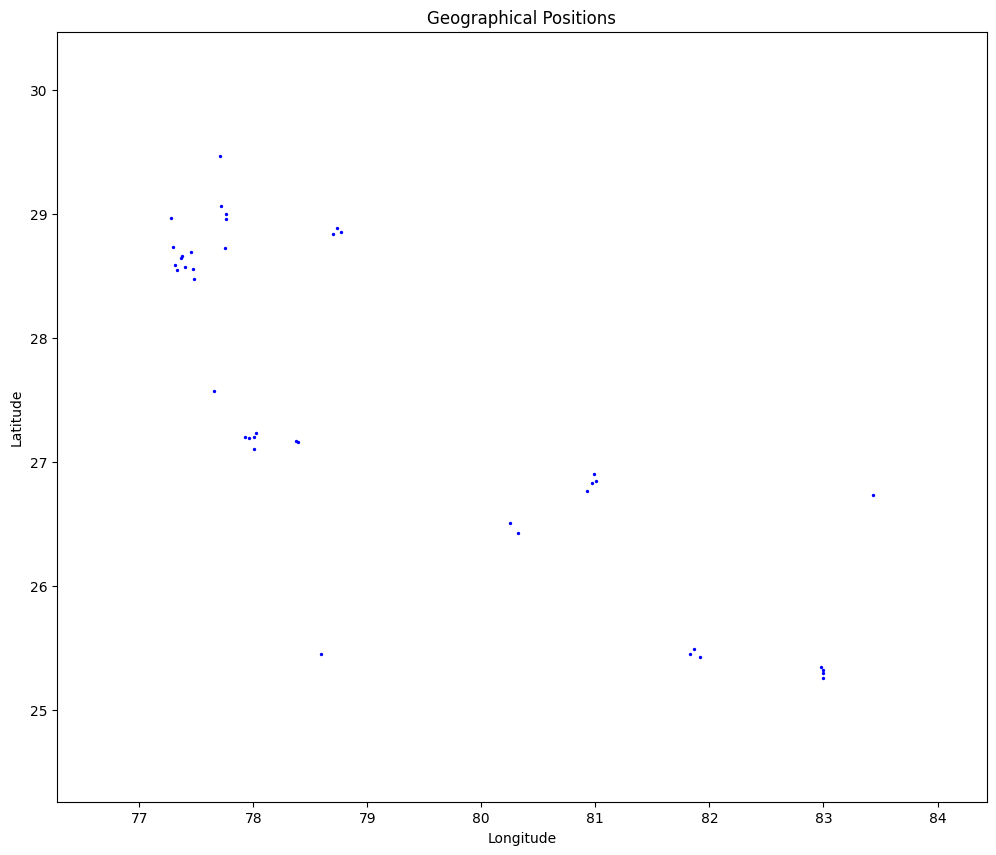

In [12]:
import matplotlib.pyplot as plt

# Split the latitude and longitude into separate lists
latitudes = [pos[0] for pos in filtered_lat_long_positions]
longitudes = [pos[1] for pos in filtered_lat_long_positions]

# Create a scatter plot with a larger figure size
plt.figure(figsize=(12, 10))  # Increase the figure size

# Plot the points with a larger marker size
plt.scatter(longitudes, latitudes, color='blue', marker='o', s=2)

# Label the axes
plt.xlabel('Longitude')
plt.ylabel('Latitude')

# Title of the plot
plt.title('Geographical Positions')

# Set the axis limits to zoom in and create more space between points
plt.xlim(min(longitudes) - 1, max(longitudes) + 1)
plt.ylim(min(latitudes) - 1, max(latitudes) + 1)

# Save the plot as an image file
output_image = 'positions_plot_large.png'
plt.savefig(output_image, dpi=300)  # Increase dpi for better resolution

# Show the plot
plt.show()


# Determine the k nearest neighbours

In [13]:
import numpy as np

k = 8  # Number of nearest neighbors

# Initialize adjacency matrix (with all zeros)
adjacency_matrix = np.zeros((len(input_files), len(input_files)), dtype=int)

# Loop through each entry to find k nearest neighbors
for i in range(len(input_files)):
    # Get distances for the i-th entry
    distances = distance_matrix[i]
    
    # Find the indices of the k smallest distances, excluding the distance to itself (i.e., index i)
    nearest_neighbors = np.argsort(distances)[1:k+1]  # 1:k+1 because argsort includes self-distance at position 0
    
    # Print the k nearest neighbors for the current file
    print(f"\nFile: {input_files[i]}")
    print(f"K-nearest neighbors: {[input_files[j] for j in nearest_neighbors]}")
    
    # Update the adjacency matrix to represent edges
    for neighbor in nearest_neighbors:
        adjacency_matrix[i][neighbor] = 1
        adjacency_matrix[neighbor][i] = 1  # Ensure undirected edge

# Print the adjacency matrix
print("\nAdjacency Matrix:")
print(adjacency_matrix)

# Print neighbors for each file based on the adjacency matrix
for i in range(len(input_files)):
    neighbors = [input_files[j] for j in range(len(input_files)) if adjacency_matrix[i][j] == 1]
    print(f"\nNeighbors of {input_files[i]} based on adjacency matrix: {neighbors}")


File: UP002.csv
K-nearest neighbors: ['UP024.csv', 'UP035.csv', 'UP039.csv', 'UP044.csv', 'UP040.csv', 'UP033.csv', 'UP038.csv', 'UP036.csv']

File: UP003.csv
K-nearest neighbors: ['UP041.csv', 'UP029.csv', 'UP031.csv', 'UP036.csv', 'UP033.csv', 'UP038.csv', 'UP032.csv', 'UP024.csv']

File: UP004.csv
K-nearest neighbors: ['UP030.csv', 'UP034.csv', 'UP028.csv', 'UP042.csv', 'UP037.csv', 'UP051.csv', 'UP043.csv', 'UP012.csv']

File: UP008.csv
K-nearest neighbors: ['UP021.csv', 'UP022.csv', 'UP018.csv', 'UP020.csv', 'UP009.csv', 'UP012.csv', 'UP017.csv', 'UP019.csv']

File: UP009.csv
K-nearest neighbors: ['UP018.csv', 'UP017.csv', 'UP021.csv', 'UP022.csv', 'UP019.csv', 'UP008.csv', 'UP020.csv', 'UP012.csv']

File: UP012.csv
K-nearest neighbors: ['UP020.csv', 'UP022.csv', 'UP008.csv', 'UP021.csv', 'UP018.csv', 'UP009.csv', 'UP017.csv', 'UP019.csv']

File: UP014.csv
K-nearest neighbors: ['UP026.csv', 'UP025.csv', 'UP023.csv', 'UP050.csv', 'UP016.csv', 'UP017.csv', 'UP019.csv', 'UP009.csv']

# Plotting the edges on the map

In [14]:
import folium

# Create a Folium map centered at the average of the coordinates
center_lat = sum([pos[0] for pos in filtered_lat_long_positions]) / len(filtered_lat_long_positions)
center_long = sum([pos[1] for pos in filtered_lat_long_positions]) / len(filtered_lat_long_positions)

# Initialize the map
m = folium.Map(location=[center_lat, center_long], zoom_start=5)

# Add markers for each position
for idx, (lat, long) in enumerate(filtered_lat_long_positions):
    folium.Marker([lat, long], tooltip=f'Point {idx + 1}').add_to(m)

# Add edges based on adjacency matrix
for i in range(len(adjacency_matrix)):
    for j in range(i + 1, len(adjacency_matrix)):  # Only check upper triangle to avoid duplicate edges
        if adjacency_matrix[i][j] == 1:
            # Draw a line between point i and point j
            folium.PolyLine([filtered_lat_long_positions[i], filtered_lat_long_positions[j]], color="blue").add_to(m)

# Save the map to an HTML file or display in Jupyter notebook
m.save("map_with_edges.html")

# To display directly in Jupyter notebook
m


# Change the diagonal elements to 1

In [15]:
# Change the diagonal elements to 1
np.fill_diagonal(adjacency_matrix, 1)
adjacency_matrix

array([[1, 0, 0, ..., 0, 0, 0],
       [0, 1, 0, ..., 0, 0, 0],
       [0, 0, 1, ..., 0, 1, 1],
       ...,
       [0, 0, 0, ..., 1, 0, 0],
       [0, 0, 1, ..., 0, 1, 1],
       [0, 0, 1, ..., 0, 1, 1]])

# Prepare Graph Data for GNN

In [16]:
# Prepare graph data for each timestamp
def prepare_graph_data_for_timestamp(dataframes, adjacency_matrix, timestamp_index):
    # Extract the row corresponding to the timestamp index from all CSV files
    features = np.stack([df.iloc[timestamp_index].values for df in dataframes], axis=0)  # shape (num_nodes, num_features)
    
    # Create node features (tensor)
    node_features = torch.tensor(features, dtype=torch.float)
    
    # Create edge index (adjacency matrix)
    edge_index = torch.tensor(np.array(np.nonzero(adjacency_matrix)), dtype=torch.long)
    
    # Create target tensor (for 'AT (degree C)')
    target_values = torch.tensor([df.iloc[timestamp_index]['AT (degree C)'] for df in dataframes], dtype=torch.float)
    
    graph_data = Data(x=node_features, edge_index=edge_index, y=target_values)
    print(f"Graph data for timestamp {timestamp_index} created.")
    print(graph_data)
    return graph_data

# Get the number of timestamps
train_num_timestamps = len(train_dataframes[0])
test_num_timestamps = len(test_dataframes[0])

# Prepare graph data for each timestamp
train_graph_data_list = [prepare_graph_data_for_timestamp(train_dataframes, adjacency_matrix, i) for i in range(train_num_timestamps)]
test_graph_data_list = [prepare_graph_data_for_timestamp(test_dataframes, adjacency_matrix, i) for i in range(test_num_timestamps)]

print(f"Number of graph data objects created for training: {len(train_graph_data_list)}")
print(f"Number of graph data objects created for testing: {len(test_graph_data_list)}")
print("Sample training graph data object:")
print(train_graph_data_list[0])
print("Sample testing graph data object:")
print(test_graph_data_list[0])

Graph data for timestamp 0 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 1 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 2 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 3 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 4 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 5 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 6 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 7 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 8 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 9 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 10 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 11 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for

# GAT Implementation

Epoch 0, Loss: 0.2584808562547022
Epoch 1, Loss: 0.1200910840853495
Epoch 2, Loss: 0.11557895585963349
Epoch 3, Loss: 0.11319039032143625
Epoch 4, Loss: 0.11255045717484542
Epoch 5, Loss: 0.1096553542791554
Epoch 6, Loss: 0.1094263239127279
Epoch 7, Loss: 0.10956666151127069
Epoch 8, Loss: 0.10953129509905511
Epoch 9, Loss: 0.109513604021999
Epoch 10, Loss: 0.10807690291727895
Epoch 11, Loss: 0.10811304396109252
Epoch 12, Loss: 0.10828913707888024
Epoch 13, Loss: 0.10859477458392011
Epoch 14, Loss: 0.10850980376114105
Epoch 15, Loss: 0.10813489269291512
Epoch 16, Loss: 0.10778994460608156
Epoch 17, Loss: 0.10795281272987467
Epoch 18, Loss: 0.10778436494029386
Epoch 19, Loss: 0.10757250766109451
Epoch 20, Loss: 0.10748505360682073
Epoch 21, Loss: 0.10754999700573356
Epoch 22, Loss: 0.10749100959256656
Epoch 23, Loss: 0.10730199070156637
Epoch 24, Loss: 0.10742304630809306
Epoch 25, Loss: 0.10710970203373342
Epoch 26, Loss: 0.10715735264680186
Epoch 27, Loss: 0.10749795881296355
Epoch 28

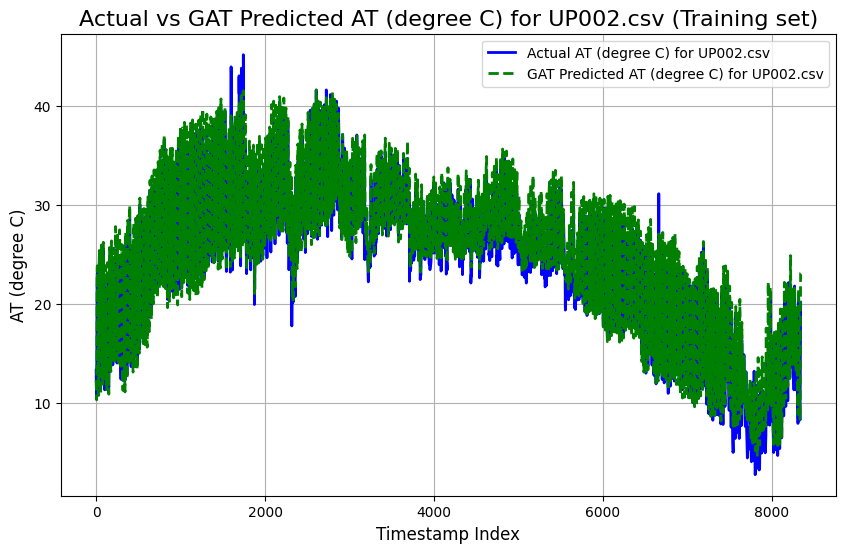

UP003.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.1981
Mean Squared Error (MSE): 2.3769
Root Mean Squared Error (RMSE): 1.5417
Pearson Correlation Coefficient: 0.9866
R-squared (R²): 0.9687

----------------------------------------



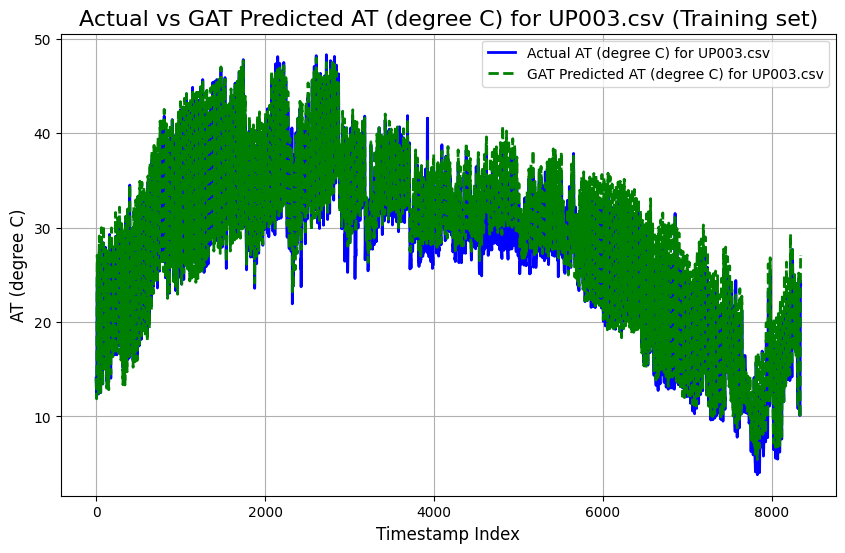

UP004.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.2289
Mean Squared Error (MSE): 2.2345
Root Mean Squared Error (RMSE): 1.4948
Pearson Correlation Coefficient: 0.9886
R-squared (R²): 0.9733

----------------------------------------



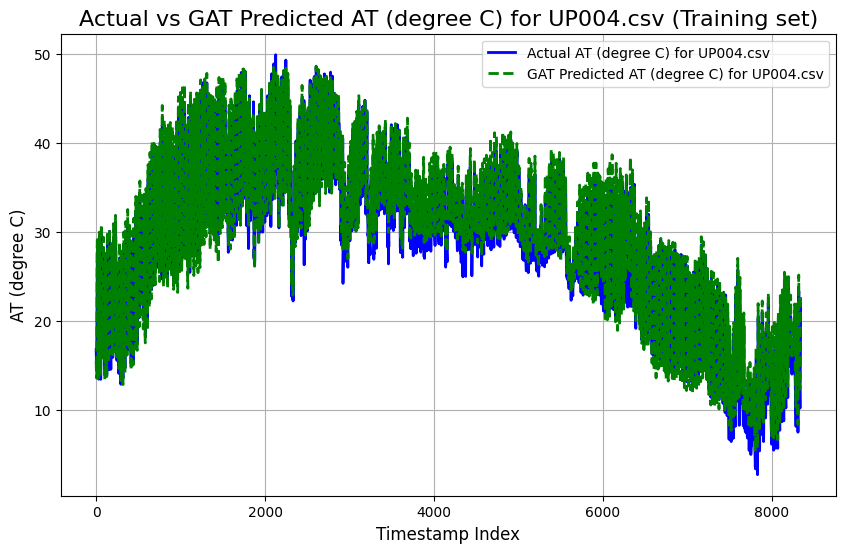

UP008.csv (Training set) Metrics:
Mean Absolute Error (MAE): 5.0981
Mean Squared Error (MSE): 55.0342
Root Mean Squared Error (RMSE): 7.4185
Pearson Correlation Coefficient: 0.8126
R-squared (R²): 0.6336

----------------------------------------



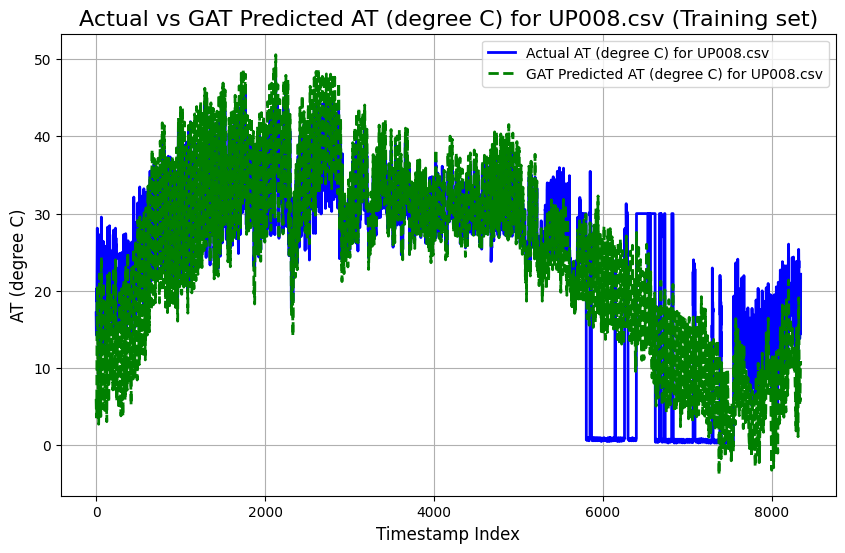

UP009.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.1131
Mean Squared Error (MSE): 1.9446
Root Mean Squared Error (RMSE): 1.3945
Pearson Correlation Coefficient: 0.9854
R-squared (R²): 0.9681

----------------------------------------



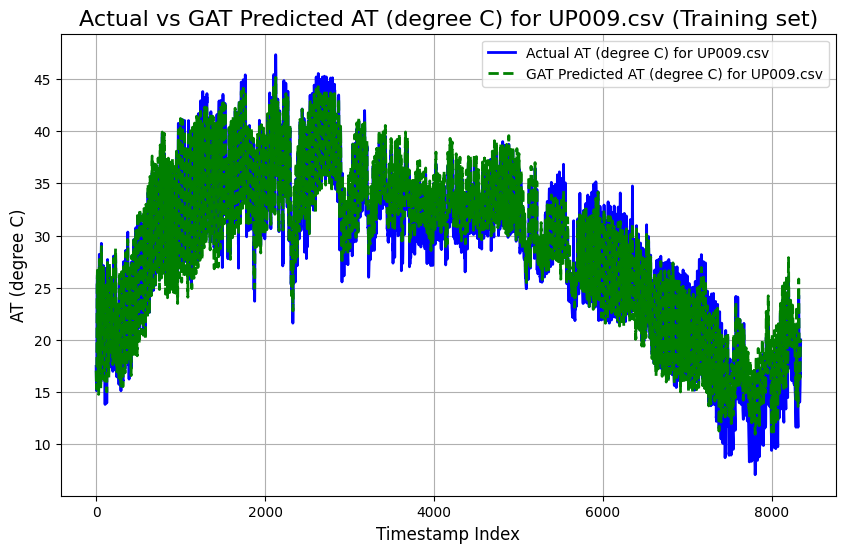

UP012.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.4145
Mean Squared Error (MSE): 3.9472
Root Mean Squared Error (RMSE): 1.9868
Pearson Correlation Coefficient: 0.9832
R-squared (R²): 0.9636

----------------------------------------



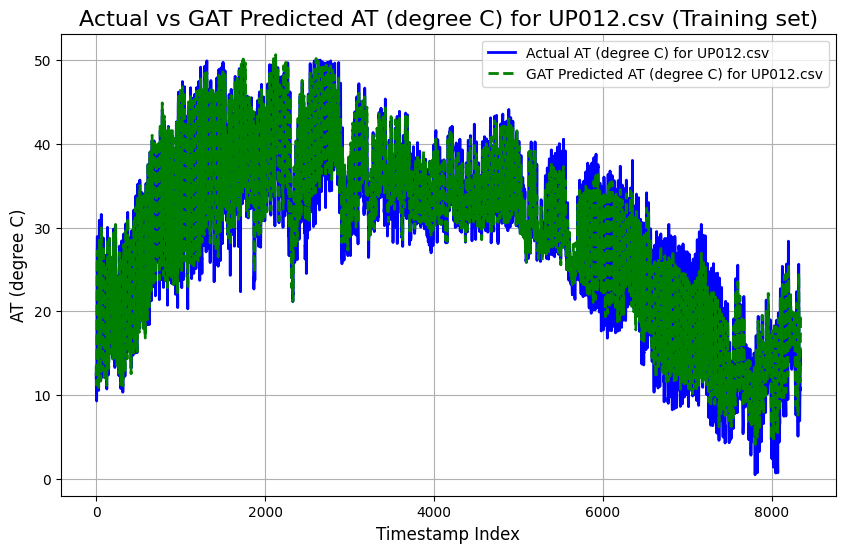

UP014.csv (Training set) Metrics:
Mean Absolute Error (MAE): 2.9659
Mean Squared Error (MSE): 12.9863
Root Mean Squared Error (RMSE): 3.6036
Pearson Correlation Coefficient: 0.9530
R-squared (R²): 0.9023

----------------------------------------



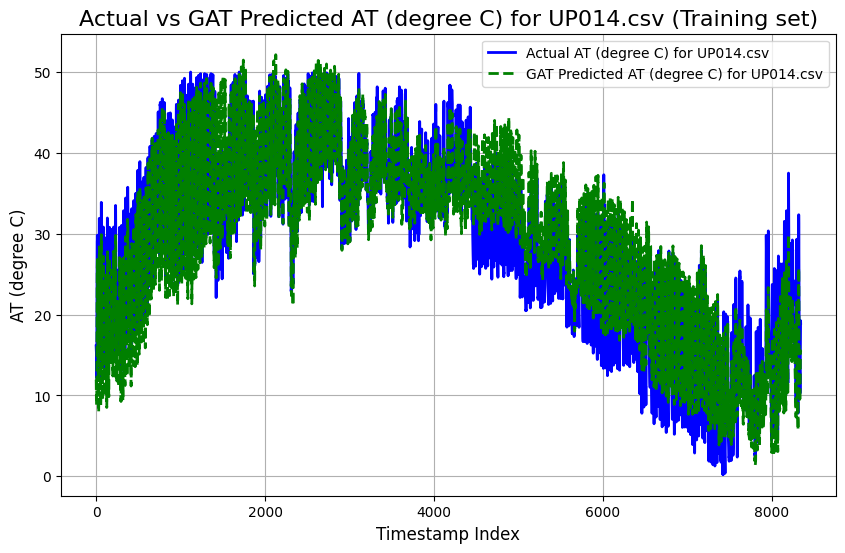

UP016.csv (Training set) Metrics:
Mean Absolute Error (MAE): 2.8110
Mean Squared Error (MSE): 12.0693
Root Mean Squared Error (RMSE): 3.4741
Pearson Correlation Coefficient: 0.9573
R-squared (R²): 0.9115

----------------------------------------



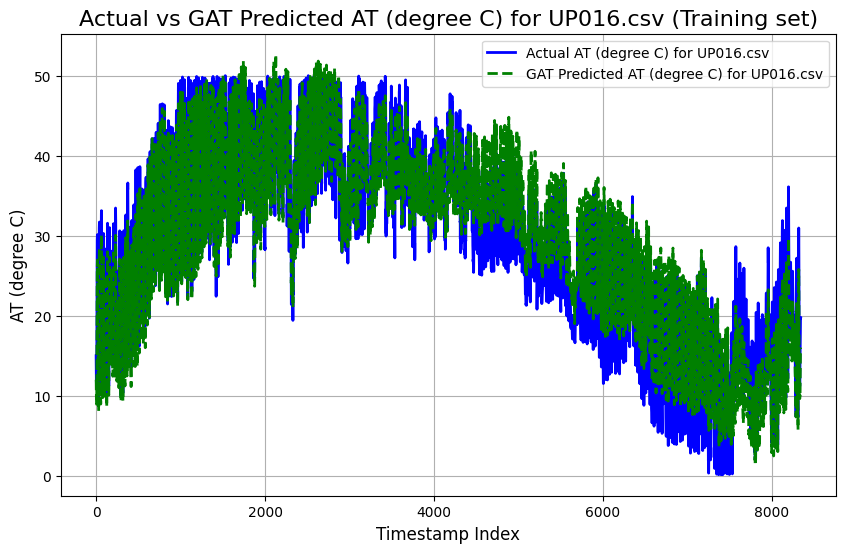

UP017.csv (Training set) Metrics:
Mean Absolute Error (MAE): 0.8750
Mean Squared Error (MSE): 1.1190
Root Mean Squared Error (RMSE): 1.0578
Pearson Correlation Coefficient: 0.9843
R-squared (R²): 0.9658

----------------------------------------



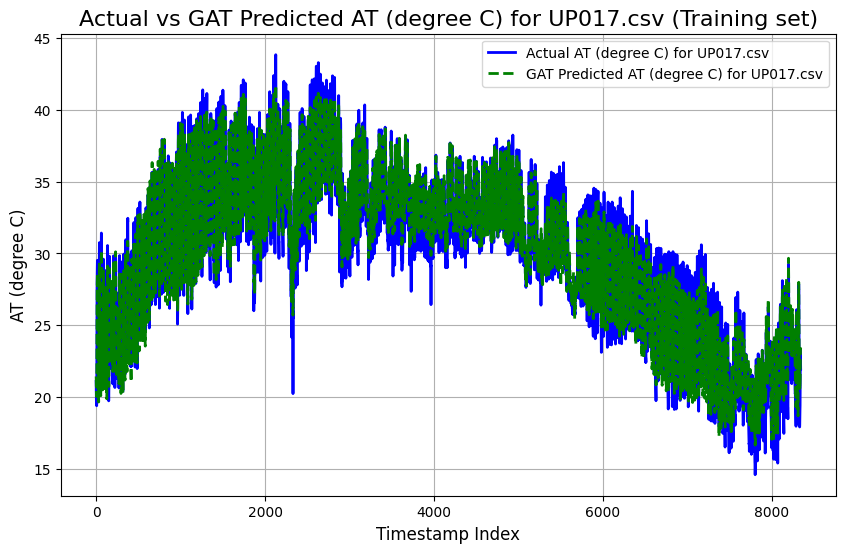

UP018.csv (Training set) Metrics:
Mean Absolute Error (MAE): 4.6141
Mean Squared Error (MSE): 42.5363
Root Mean Squared Error (RMSE): 6.5220
Pearson Correlation Coefficient: 0.5489
R-squared (R²): 0.1198

----------------------------------------



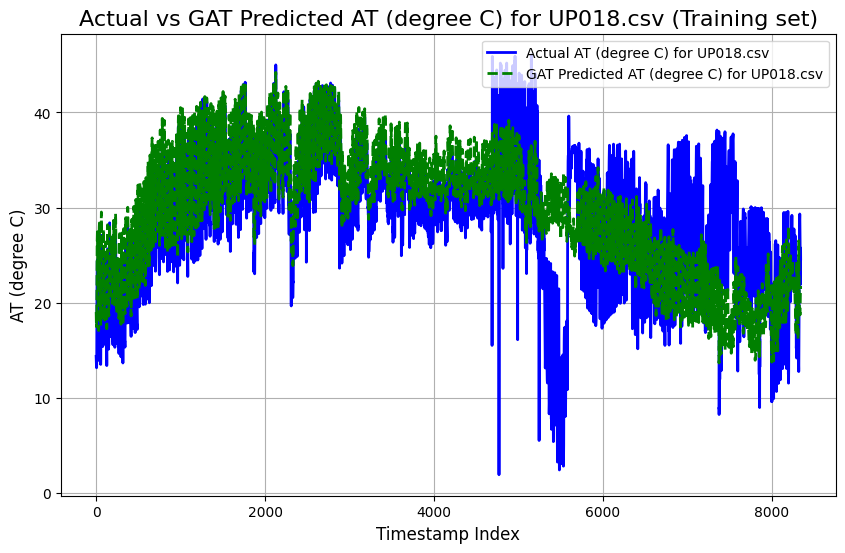

UP019.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.5083
Mean Squared Error (MSE): 4.9817
Root Mean Squared Error (RMSE): 2.2320
Pearson Correlation Coefficient: 0.9355
R-squared (R²): 0.8701

----------------------------------------



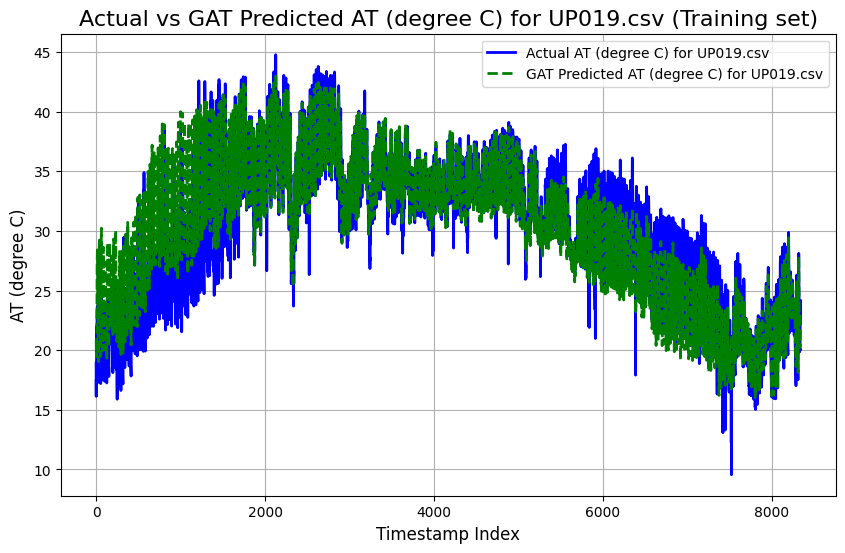

UP020.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.2115
Mean Squared Error (MSE): 2.2201
Root Mean Squared Error (RMSE): 1.4900
Pearson Correlation Coefficient: 0.9818
R-squared (R²): 0.9609

----------------------------------------



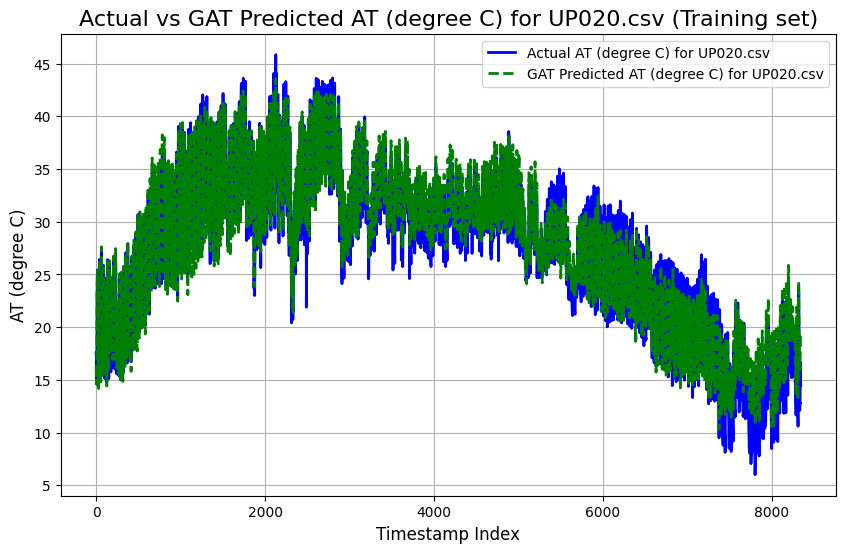

UP021.csv (Training set) Metrics:
Mean Absolute Error (MAE): 3.5393
Mean Squared Error (MSE): 21.3933
Root Mean Squared Error (RMSE): 4.6253
Pearson Correlation Coefficient: 0.8627
R-squared (R²): 0.7304

----------------------------------------



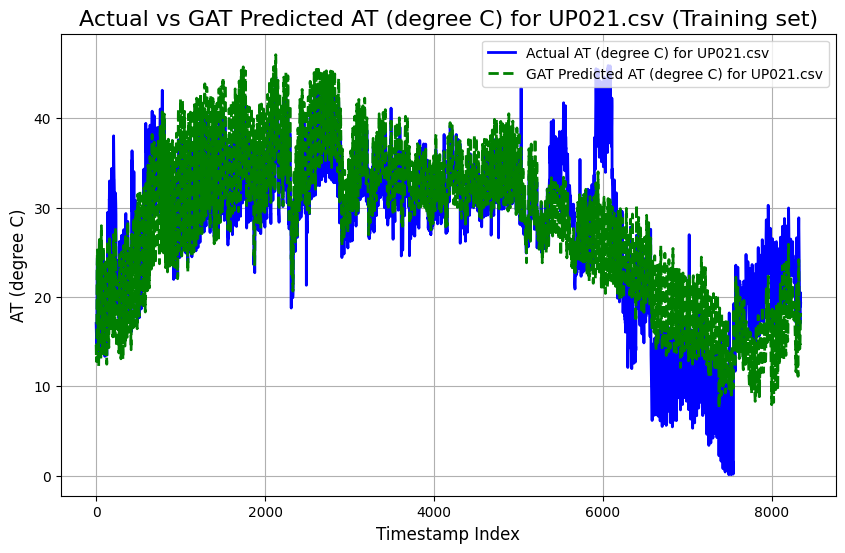

UP022.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.2673
Mean Squared Error (MSE): 3.0283
Root Mean Squared Error (RMSE): 1.7402
Pearson Correlation Coefficient: 0.9746
R-squared (R²): 0.9471

----------------------------------------



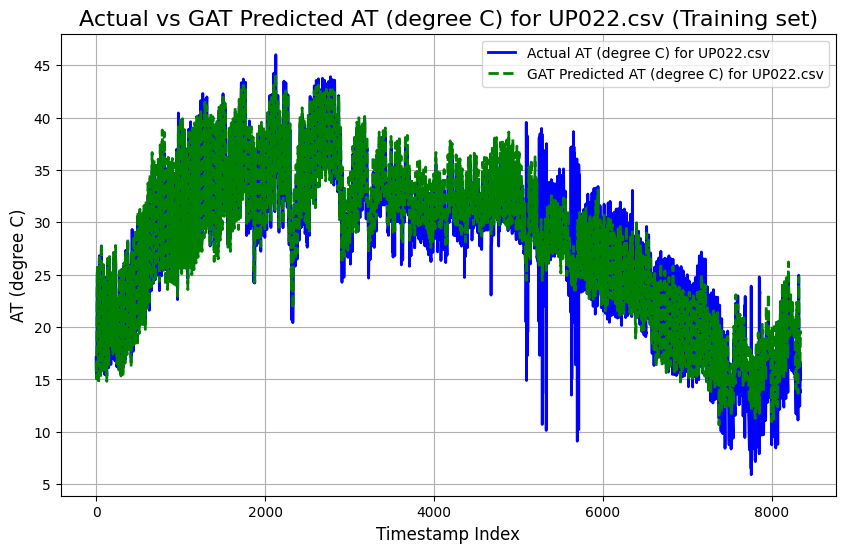

UP023.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.2756
Mean Squared Error (MSE): 3.4863
Root Mean Squared Error (RMSE): 1.8672
Pearson Correlation Coefficient: 0.9725
R-squared (R²): 0.9418

----------------------------------------



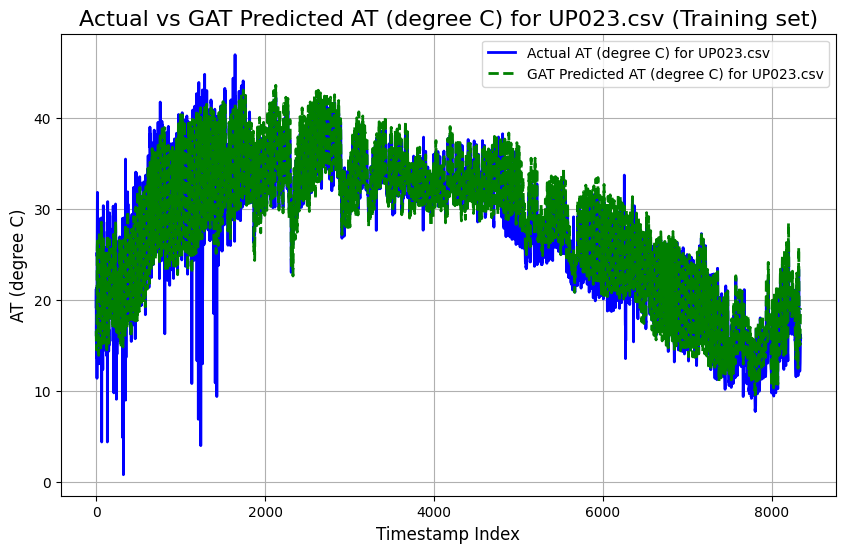

UP024.csv (Training set) Metrics:
Mean Absolute Error (MAE): 2.6299
Mean Squared Error (MSE): 13.3060
Root Mean Squared Error (RMSE): 3.6477
Pearson Correlation Coefficient: 0.8371
R-squared (R²): 0.6646

----------------------------------------



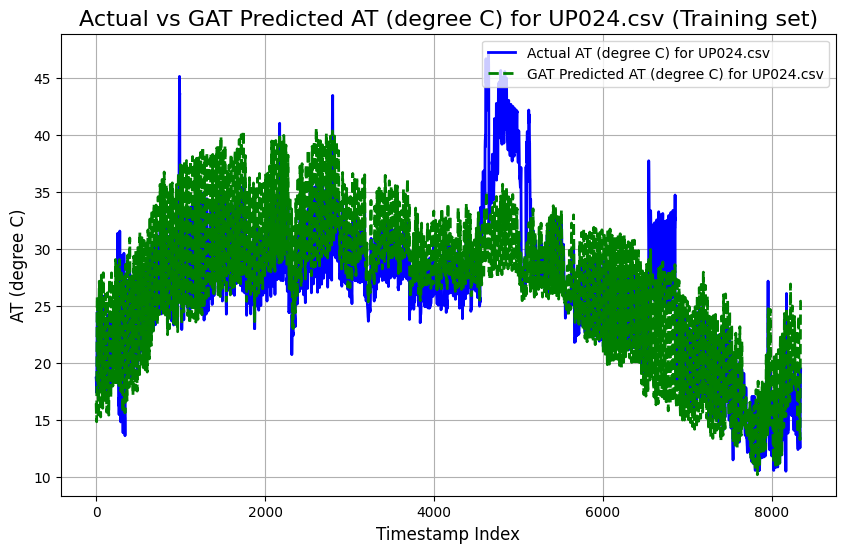

UP025.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.0168
Mean Squared Error (MSE): 1.7575
Root Mean Squared Error (RMSE): 1.3257
Pearson Correlation Coefficient: 0.9869
R-squared (R²): 0.9704

----------------------------------------



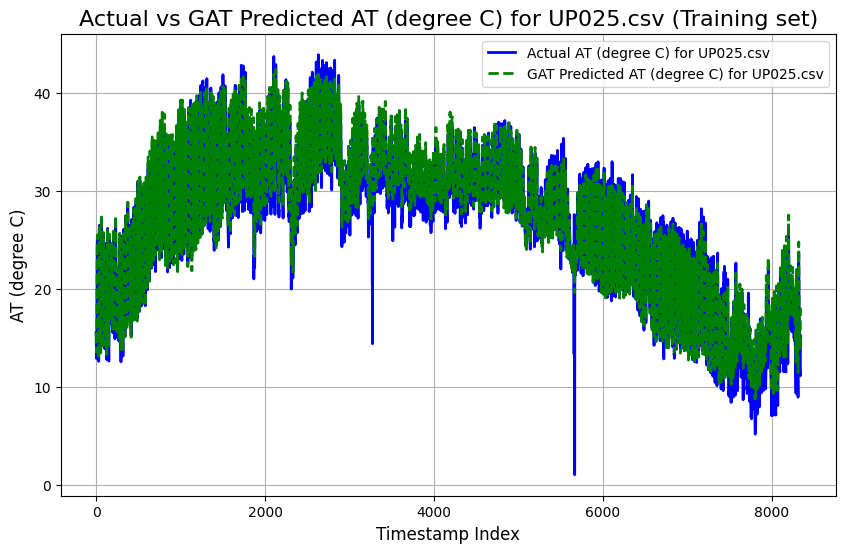

UP026.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.0131
Mean Squared Error (MSE): 1.6719
Root Mean Squared Error (RMSE): 1.2930
Pearson Correlation Coefficient: 0.9894
R-squared (R²): 0.9756

----------------------------------------



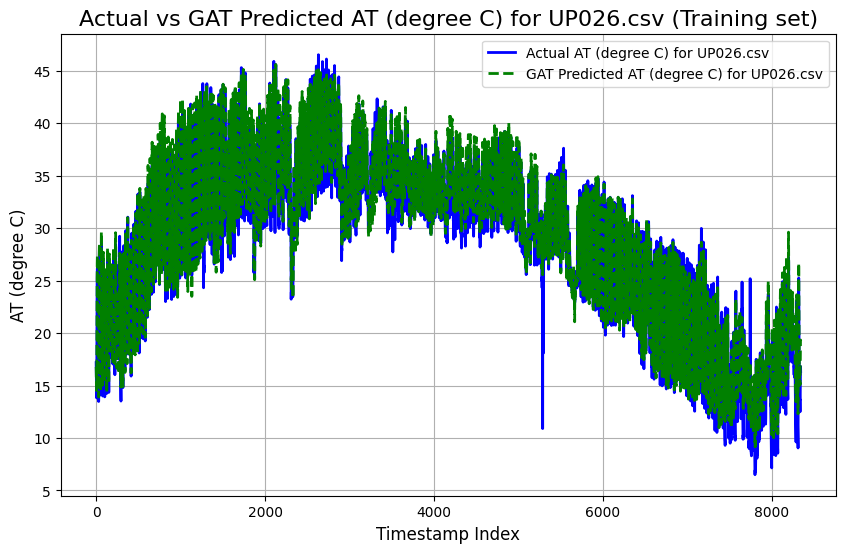

UP028.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.7669
Mean Squared Error (MSE): 4.8101
Root Mean Squared Error (RMSE): 2.1932
Pearson Correlation Coefficient: 0.9763
R-squared (R²): 0.9482

----------------------------------------



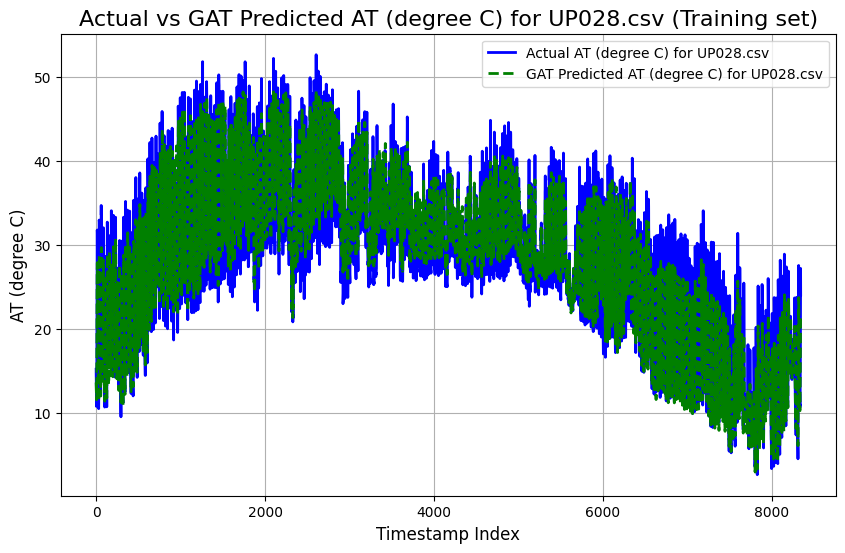

UP029.csv (Training set) Metrics:
Mean Absolute Error (MAE): 0.9321
Mean Squared Error (MSE): 1.6088
Root Mean Squared Error (RMSE): 1.2684
Pearson Correlation Coefficient: 0.9889
R-squared (R²): 0.9735

----------------------------------------



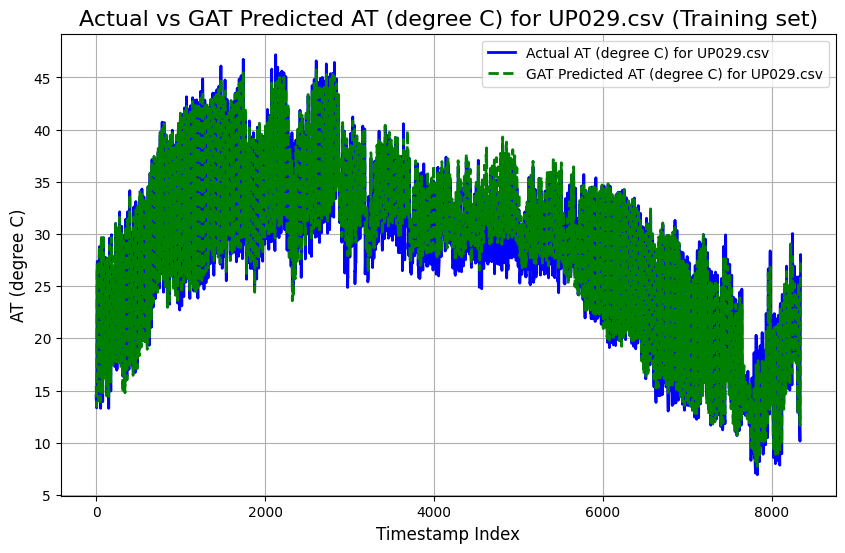

UP030.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.2153
Mean Squared Error (MSE): 2.3979
Root Mean Squared Error (RMSE): 1.5485
Pearson Correlation Coefficient: 0.9873
R-squared (R²): 0.9706

----------------------------------------



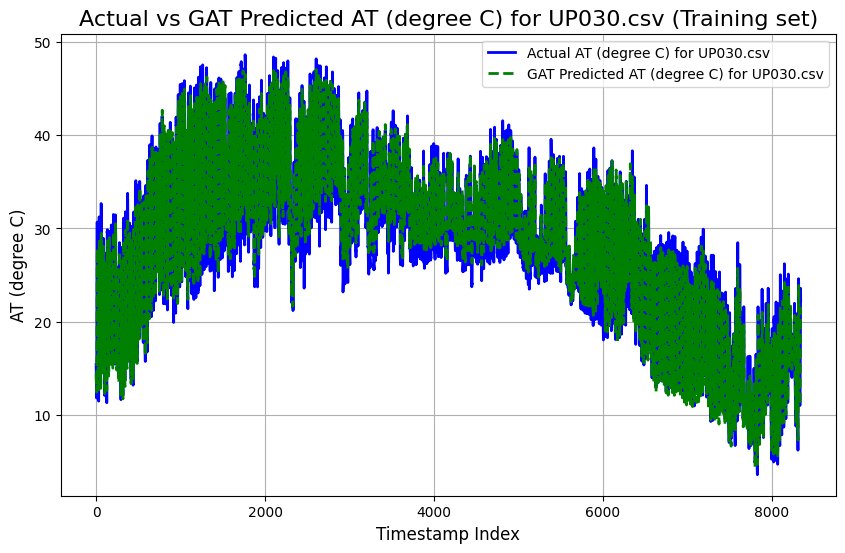

UP031.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.4827
Mean Squared Error (MSE): 3.5663
Root Mean Squared Error (RMSE): 1.8885
Pearson Correlation Coefficient: 0.9764
R-squared (R²): 0.9479

----------------------------------------



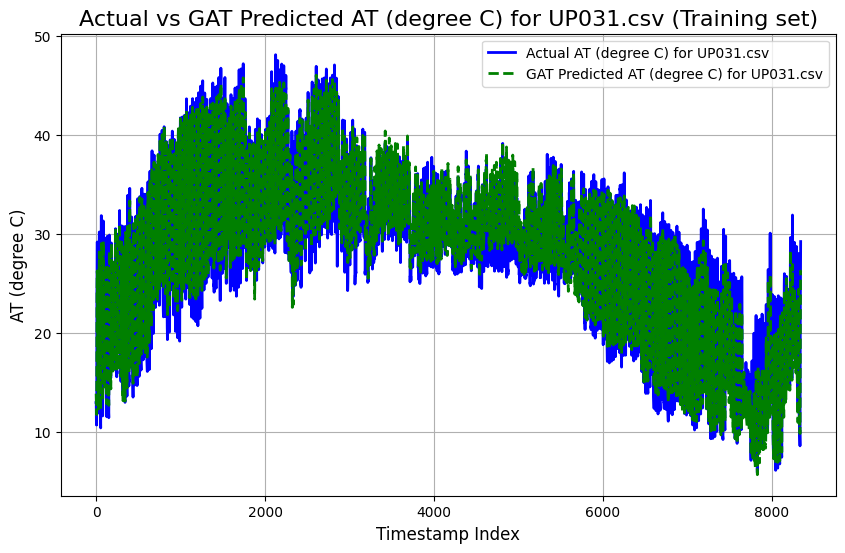

UP032.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.4354
Mean Squared Error (MSE): 3.5872
Root Mean Squared Error (RMSE): 1.8940
Pearson Correlation Coefficient: 0.9691
R-squared (R²): 0.9330

----------------------------------------



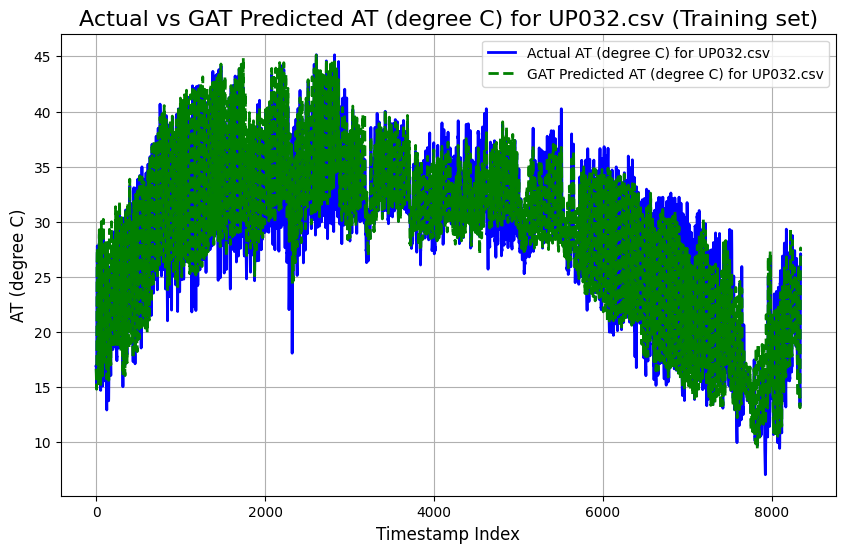

UP033.csv (Training set) Metrics:
Mean Absolute Error (MAE): 0.9038
Mean Squared Error (MSE): 1.4903
Root Mean Squared Error (RMSE): 1.2208
Pearson Correlation Coefficient: 0.9903
R-squared (R²): 0.9764

----------------------------------------



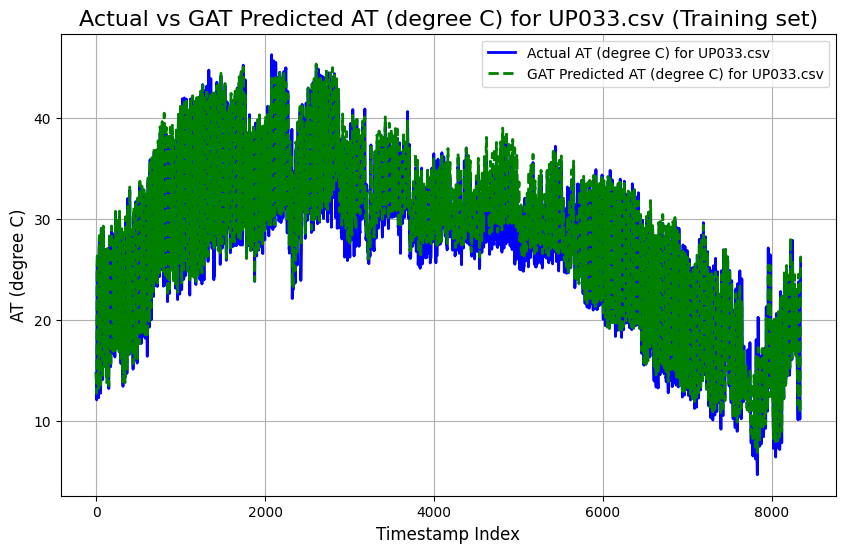

UP034.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.3847
Mean Squared Error (MSE): 4.2190
Root Mean Squared Error (RMSE): 2.0540
Pearson Correlation Coefficient: 0.9792
R-squared (R²): 0.9540

----------------------------------------



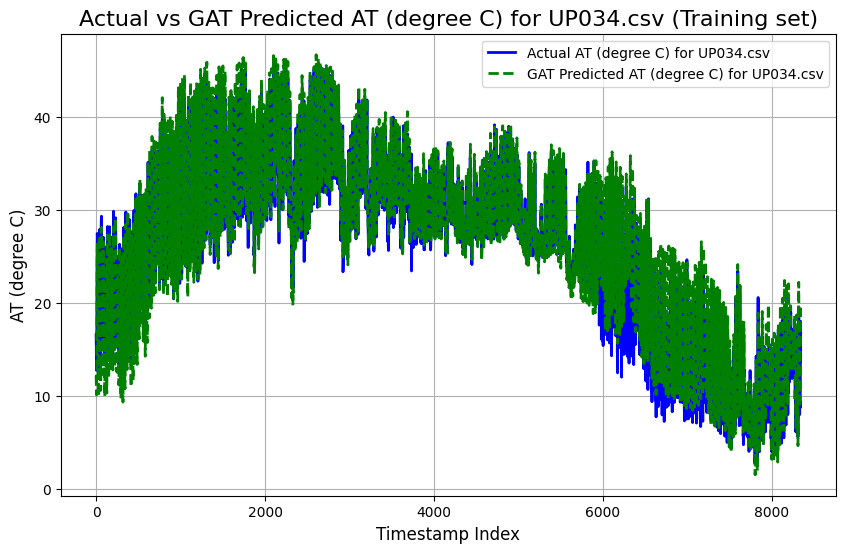

UP035.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.0116
Mean Squared Error (MSE): 1.7198
Root Mean Squared Error (RMSE): 1.3114
Pearson Correlation Coefficient: 0.9898
R-squared (R²): 0.9754

----------------------------------------



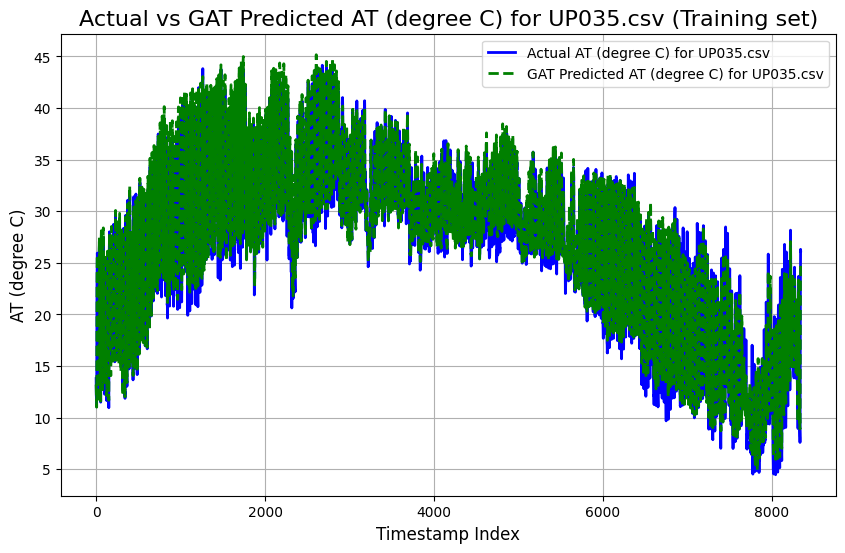

UP036.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.0495
Mean Squared Error (MSE): 2.0548
Root Mean Squared Error (RMSE): 1.4335
Pearson Correlation Coefficient: 0.9856
R-squared (R²): 0.9667

----------------------------------------



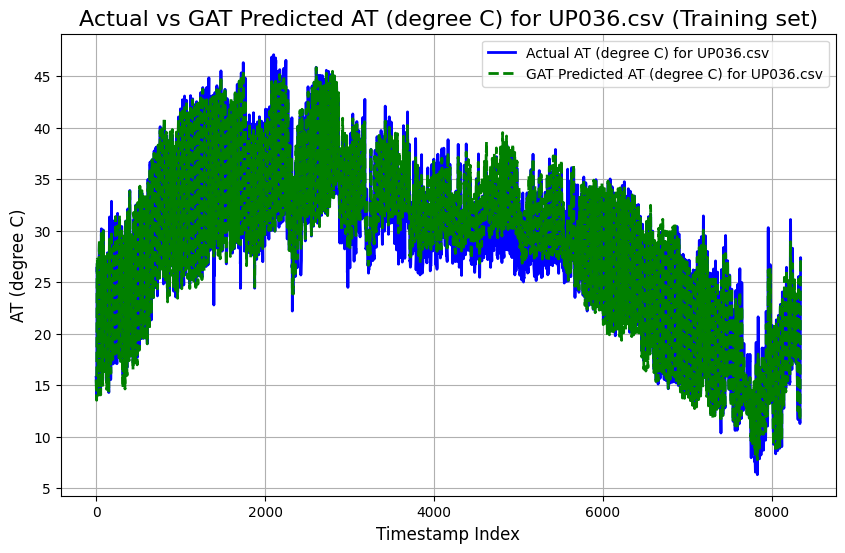

UP037.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.0910
Mean Squared Error (MSE): 1.9949
Root Mean Squared Error (RMSE): 1.4124
Pearson Correlation Coefficient: 0.9891
R-squared (R²): 0.9743

----------------------------------------



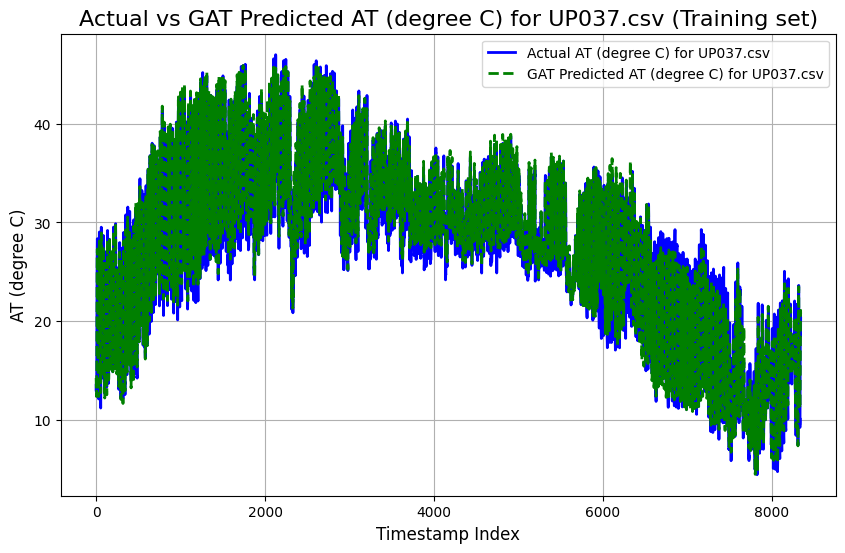

UP038.csv (Training set) Metrics:
Mean Absolute Error (MAE): 0.9901
Mean Squared Error (MSE): 1.8703
Root Mean Squared Error (RMSE): 1.3676
Pearson Correlation Coefficient: 0.9866
R-squared (R²): 0.9689

----------------------------------------



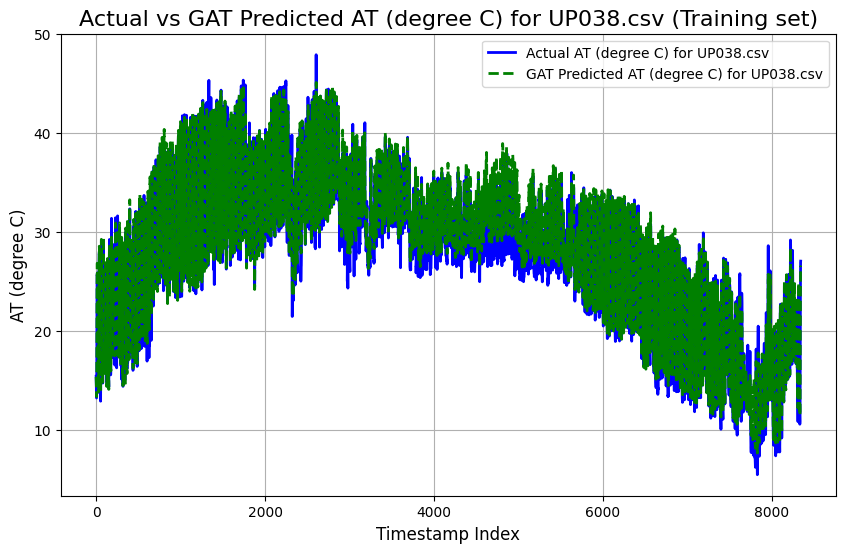

UP039.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.5578
Mean Squared Error (MSE): 4.0778
Root Mean Squared Error (RMSE): 2.0194
Pearson Correlation Coefficient: 0.9767
R-squared (R²): 0.9487

----------------------------------------



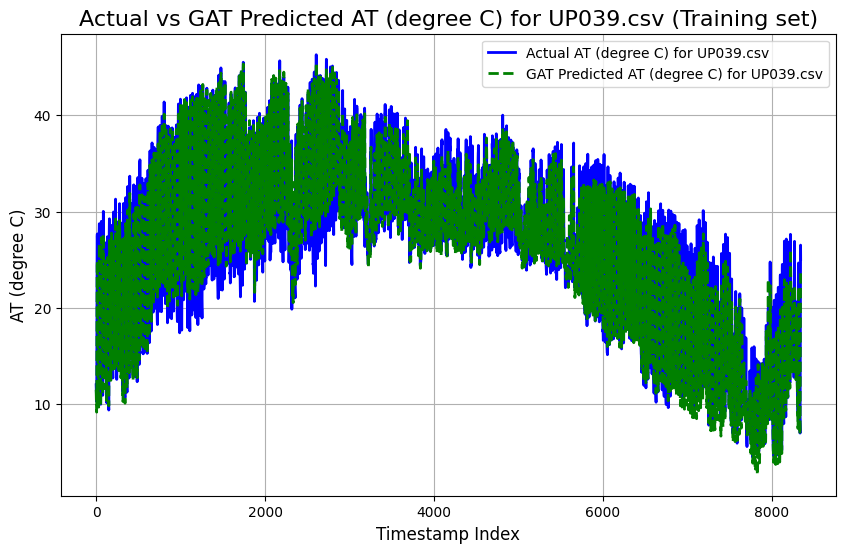

UP040.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.3191
Mean Squared Error (MSE): 2.9087
Root Mean Squared Error (RMSE): 1.7055
Pearson Correlation Coefficient: 0.9840
R-squared (R²): 0.9638

----------------------------------------



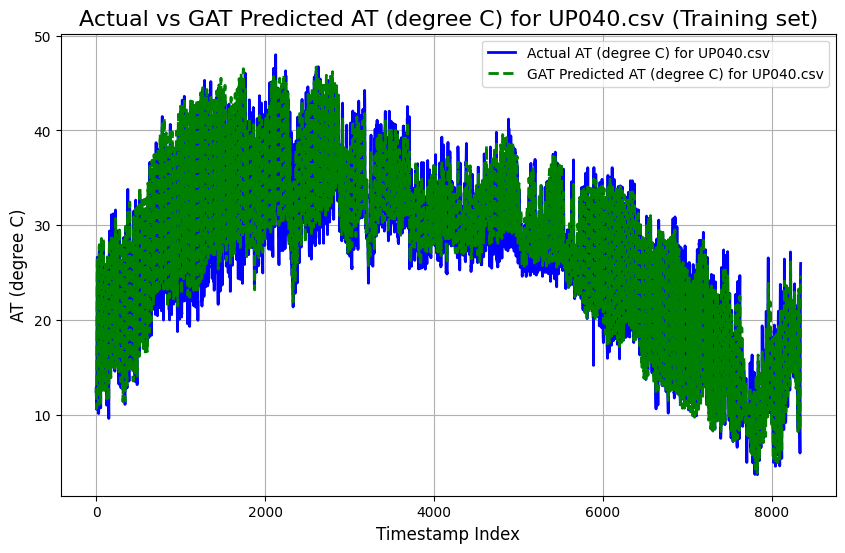

UP041.csv (Training set) Metrics:
Mean Absolute Error (MAE): 0.9865
Mean Squared Error (MSE): 1.7385
Root Mean Squared Error (RMSE): 1.3185
Pearson Correlation Coefficient: 0.9872
R-squared (R²): 0.9699

----------------------------------------



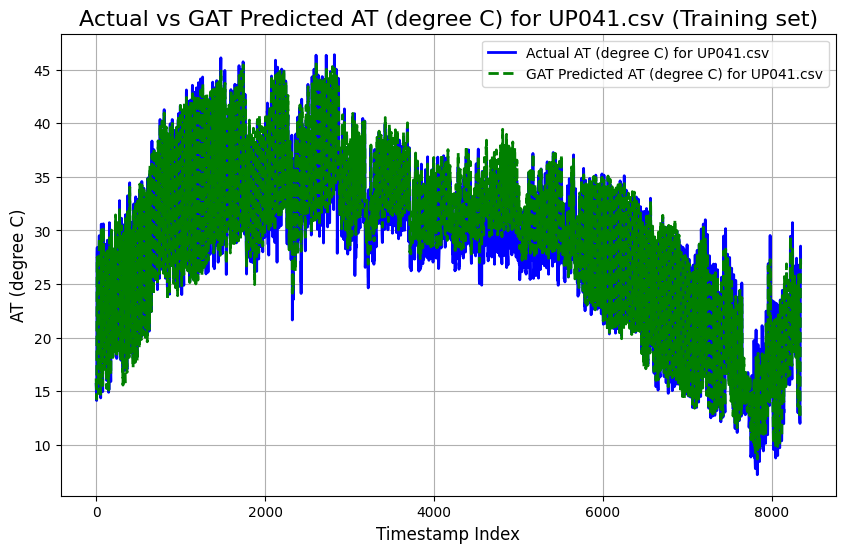

UP042.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.0841
Mean Squared Error (MSE): 2.3879
Root Mean Squared Error (RMSE): 1.5453
Pearson Correlation Coefficient: 0.9846
R-squared (R²): 0.9651

----------------------------------------



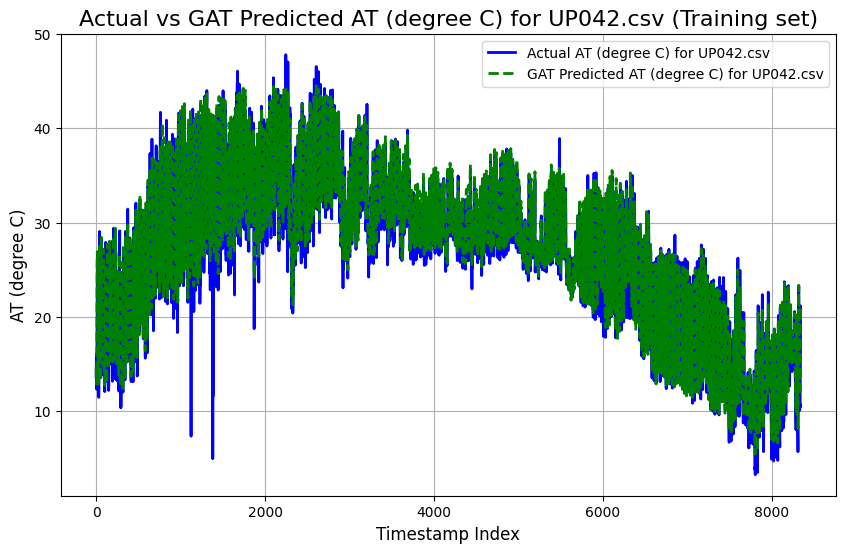

UP043.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.0793
Mean Squared Error (MSE): 2.0968
Root Mean Squared Error (RMSE): 1.4480
Pearson Correlation Coefficient: 0.9880
R-squared (R²): 0.9720

----------------------------------------



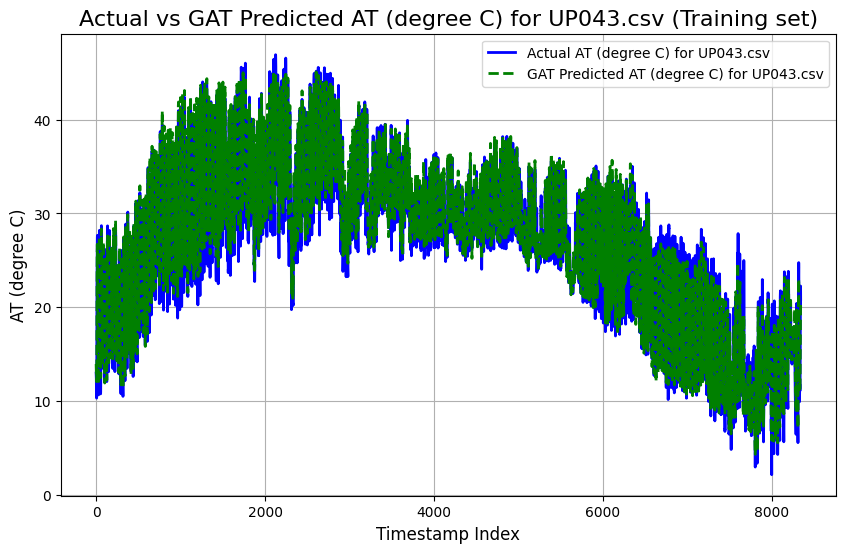

UP044.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.1256
Mean Squared Error (MSE): 2.1763
Root Mean Squared Error (RMSE): 1.4752
Pearson Correlation Coefficient: 0.9880
R-squared (R²): 0.9720

----------------------------------------



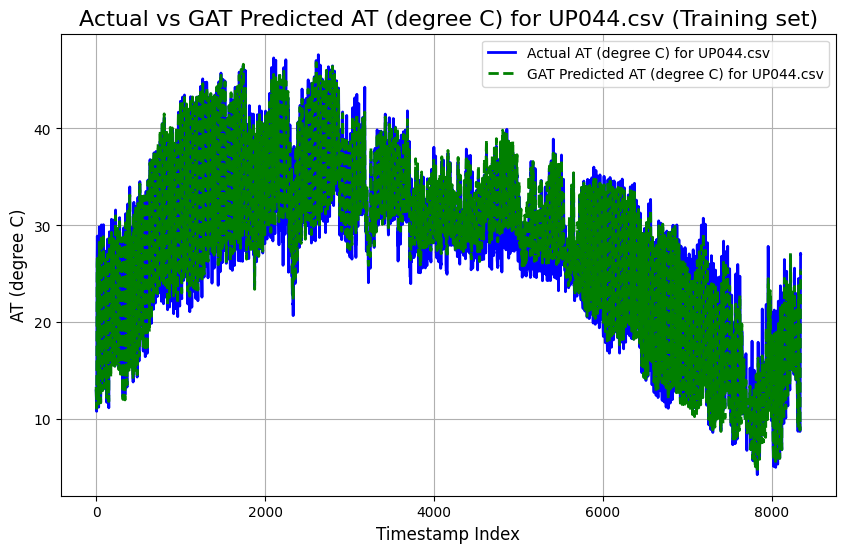

UP046.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.3982
Mean Squared Error (MSE): 3.1231
Root Mean Squared Error (RMSE): 1.7672
Pearson Correlation Coefficient: 0.9797
R-squared (R²): 0.9552

----------------------------------------



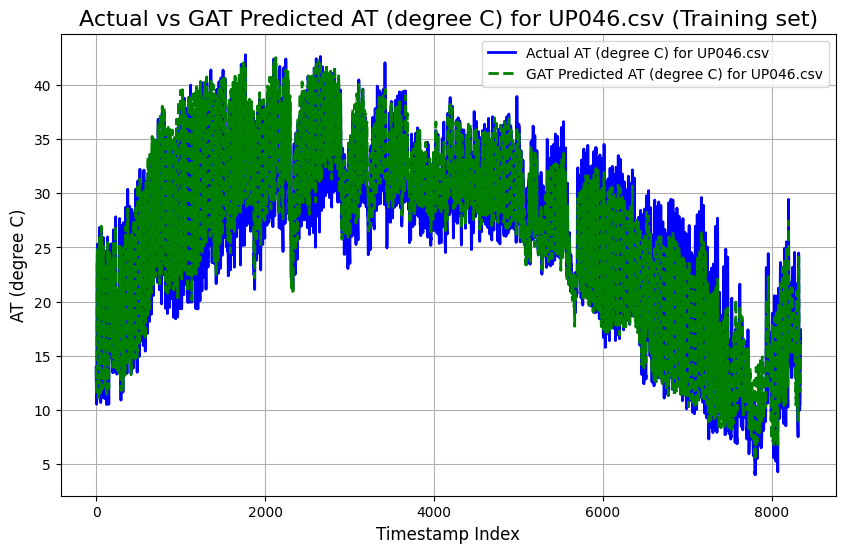

UP048.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.5089
Mean Squared Error (MSE): 3.8439
Root Mean Squared Error (RMSE): 1.9606
Pearson Correlation Coefficient: 0.9735
R-squared (R²): 0.9427

----------------------------------------



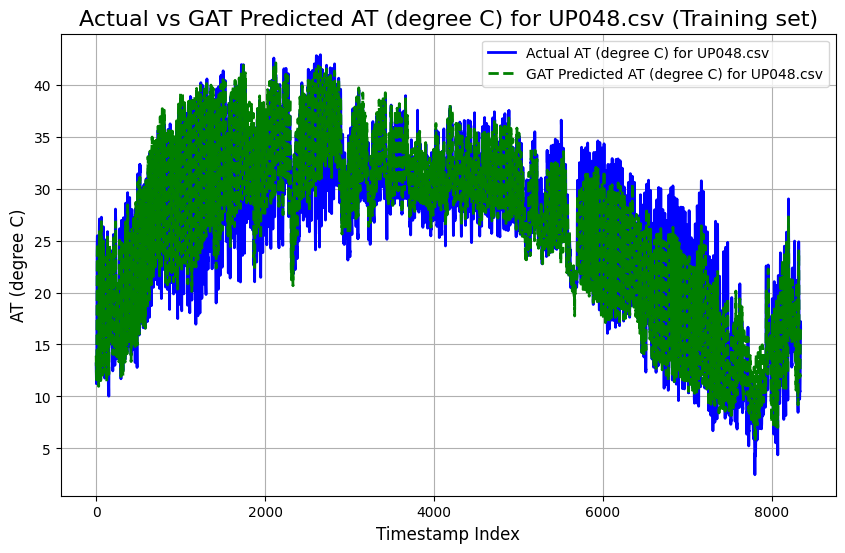

UP049.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.3140
Mean Squared Error (MSE): 2.9907
Root Mean Squared Error (RMSE): 1.7294
Pearson Correlation Coefficient: 0.9811
R-squared (R²): 0.9581

----------------------------------------



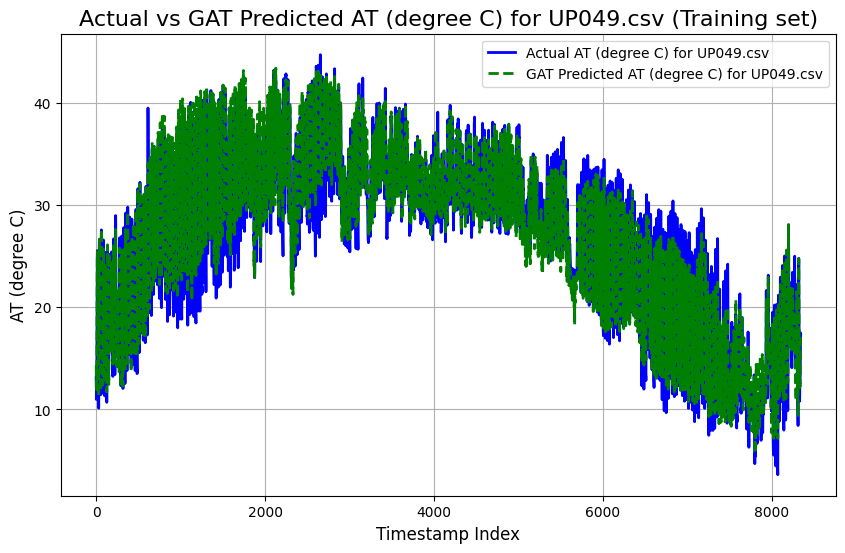

UP050.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.4917
Mean Squared Error (MSE): 4.2063
Root Mean Squared Error (RMSE): 2.0509
Pearson Correlation Coefficient: 0.9664
R-squared (R²): 0.9305

----------------------------------------



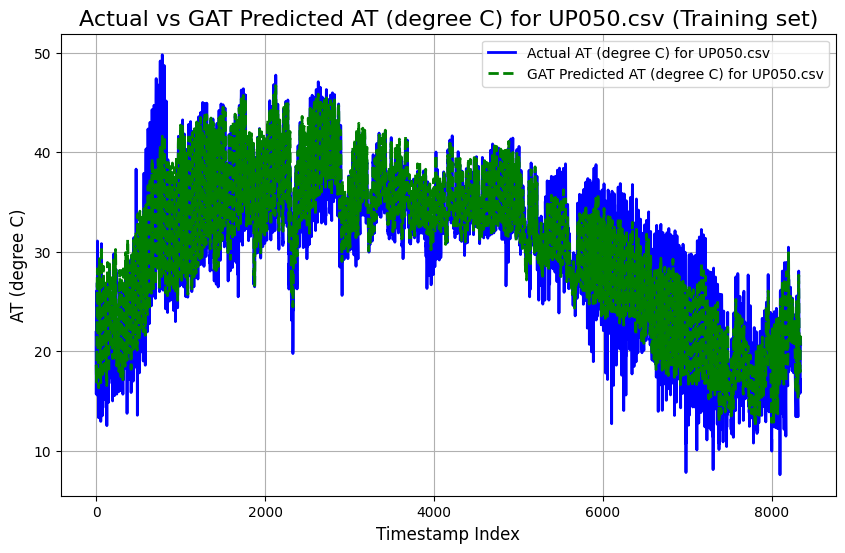

UP051.csv (Training set) Metrics:
Mean Absolute Error (MAE): 2.5851
Mean Squared Error (MSE): 21.3234
Root Mean Squared Error (RMSE): 4.6177
Pearson Correlation Coefficient: 0.8554
R-squared (R²): 0.7025

----------------------------------------



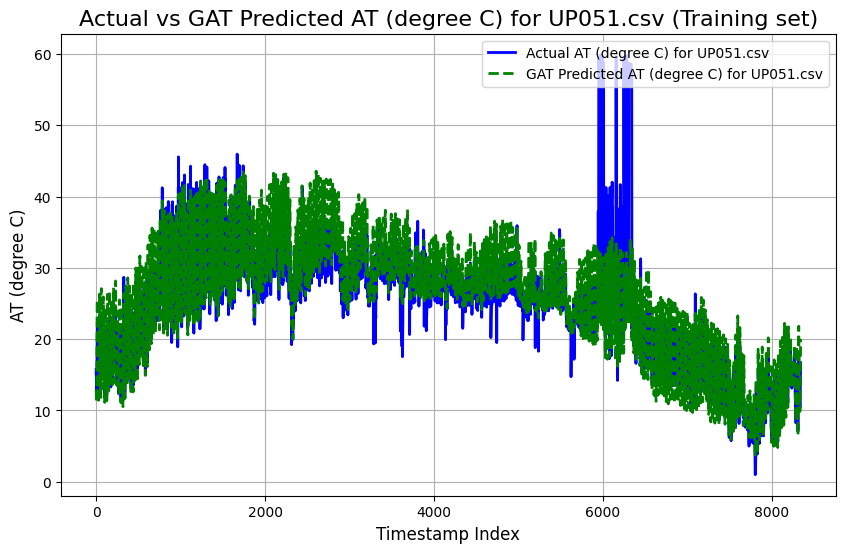

UP052.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.5638
Mean Squared Error (MSE): 4.2108
Root Mean Squared Error (RMSE): 2.0520
Pearson Correlation Coefficient: 0.9718
R-squared (R²): 0.9389

----------------------------------------



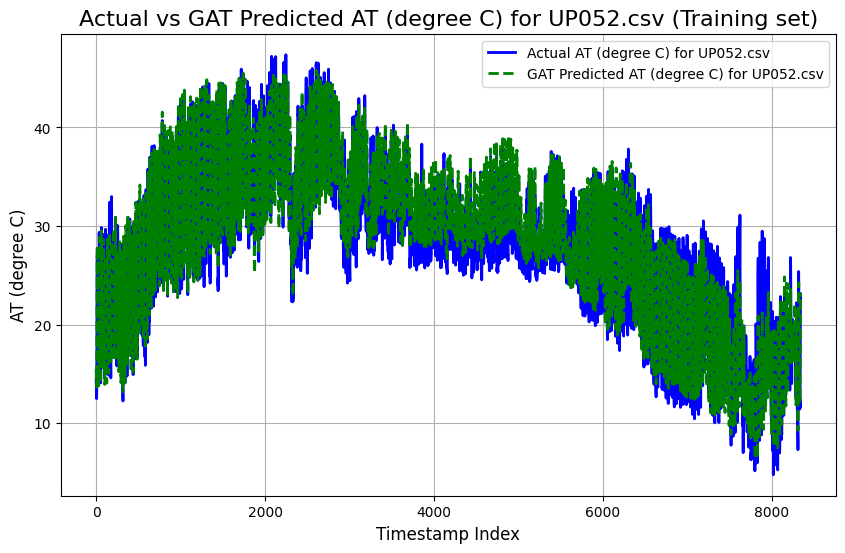

UP002.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.1598
Mean Squared Error (MSE): 2.1167
Root Mean Squared Error (RMSE): 1.4549
Pearson Correlation Coefficient: 0.9718
R-squared (R²): 0.9253

----------------------------------------



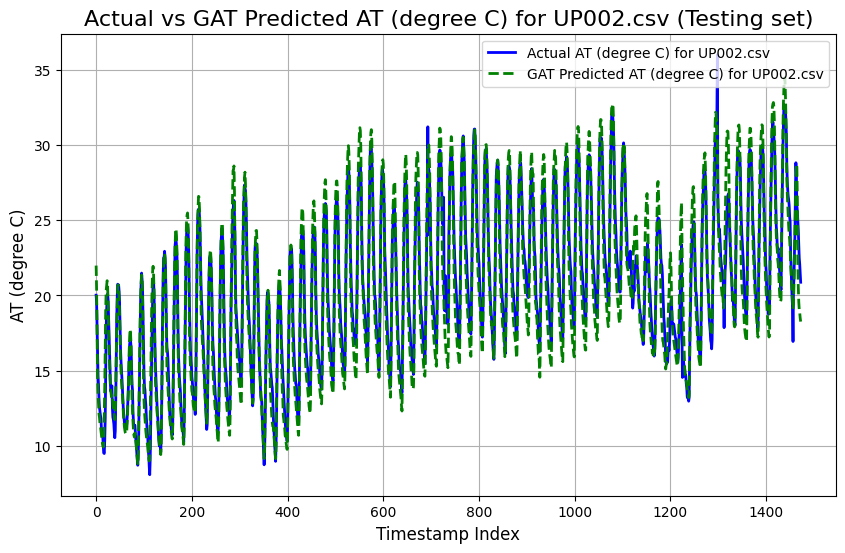

UP003.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.2940
Mean Squared Error (MSE): 2.2931
Root Mean Squared Error (RMSE): 1.5143
Pearson Correlation Coefficient: 0.9791
R-squared (R²): 0.9392

----------------------------------------



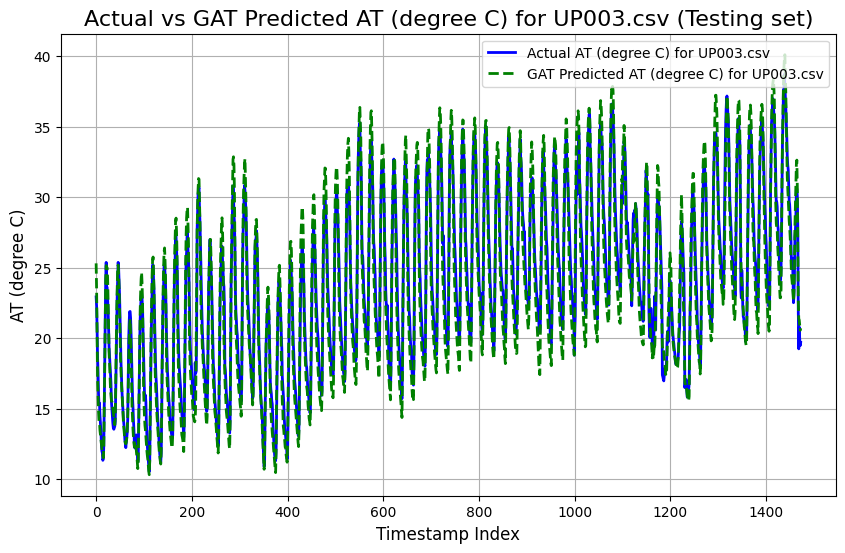

UP004.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.3007
Mean Squared Error (MSE): 2.4962
Root Mean Squared Error (RMSE): 1.5799
Pearson Correlation Coefficient: 0.9708
R-squared (R²): 0.9273

----------------------------------------



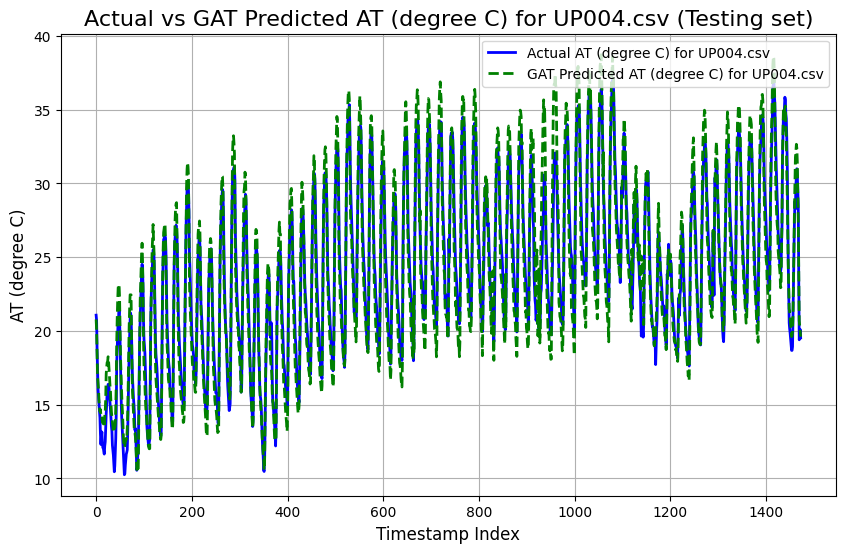

UP008.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 5.3219
Mean Squared Error (MSE): 36.8012
Root Mean Squared Error (RMSE): 6.0664
Pearson Correlation Coefficient: 0.8662
R-squared (R²): -0.7018

----------------------------------------



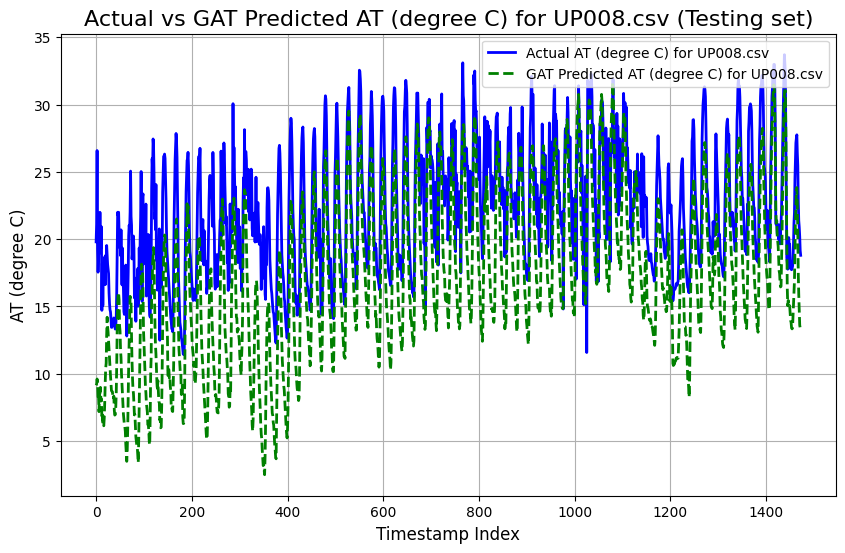

UP009.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.7606
Mean Squared Error (MSE): 1.2268
Root Mean Squared Error (RMSE): 1.1076
Pearson Correlation Coefficient: 0.9760
R-squared (R²): 0.9418

----------------------------------------



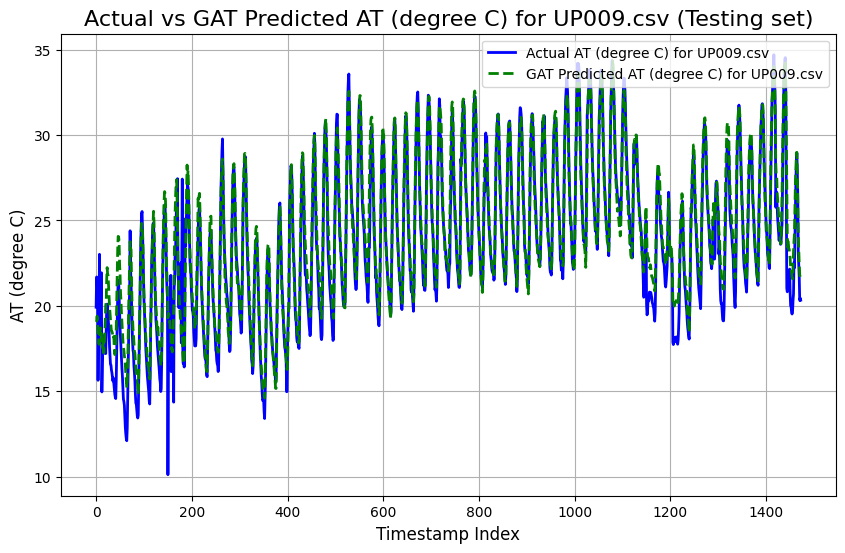

UP012.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.3865
Mean Squared Error (MSE): 3.2043
Root Mean Squared Error (RMSE): 1.7901
Pearson Correlation Coefficient: 0.9637
R-squared (R²): 0.9274

----------------------------------------



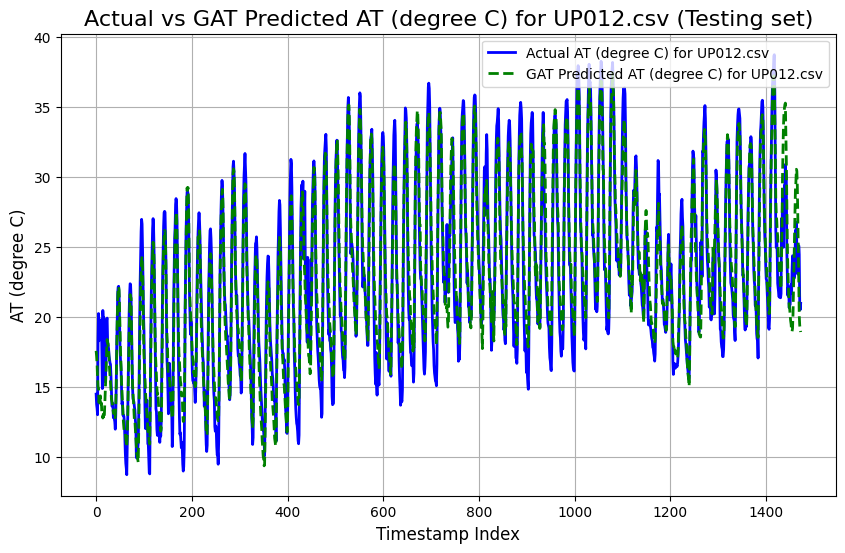

UP014.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 5.4756
Mean Squared Error (MSE): 33.2880
Root Mean Squared Error (RMSE): 5.7696
Pearson Correlation Coefficient: 0.9703
R-squared (R²): 0.4770

----------------------------------------



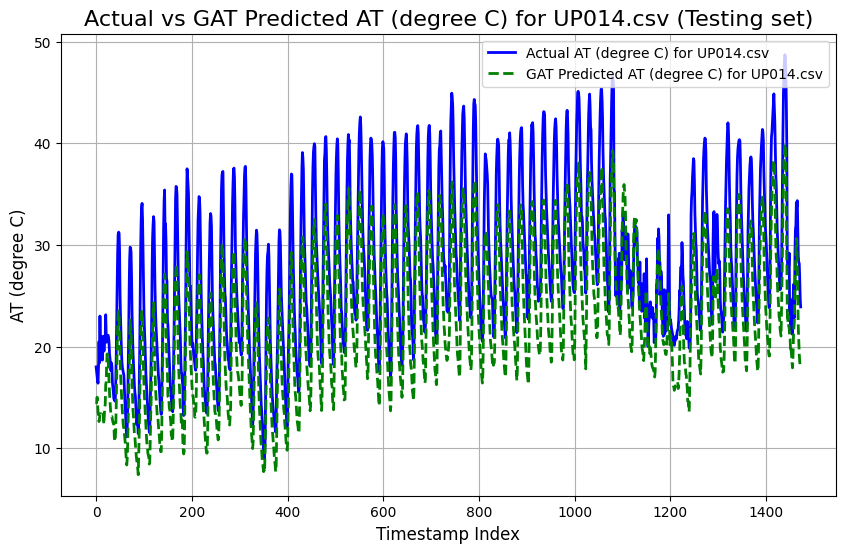

UP016.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 4.6052
Mean Squared Error (MSE): 23.5218
Root Mean Squared Error (RMSE): 4.8499
Pearson Correlation Coefficient: 0.9794
R-squared (R²): 0.6193

----------------------------------------



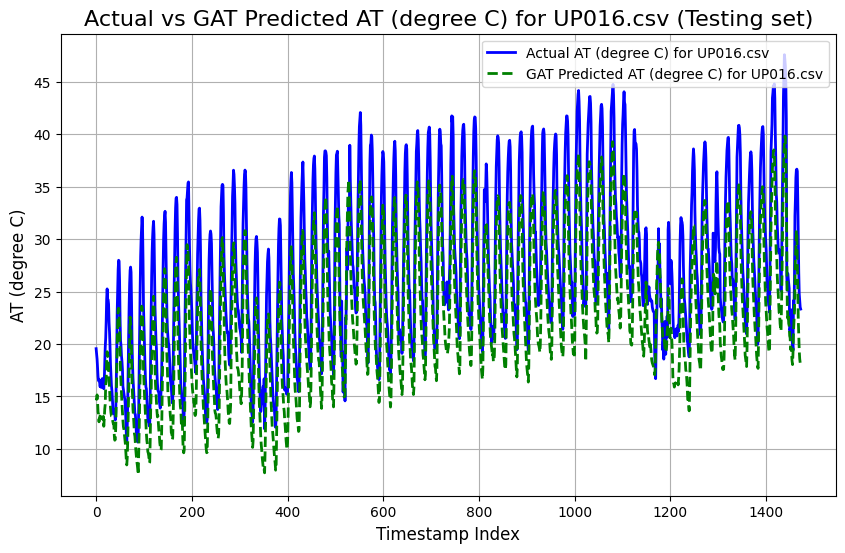

UP017.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.7741
Mean Squared Error (MSE): 1.0696
Root Mean Squared Error (RMSE): 1.0342
Pearson Correlation Coefficient: 0.9674
R-squared (R²): 0.9210

----------------------------------------



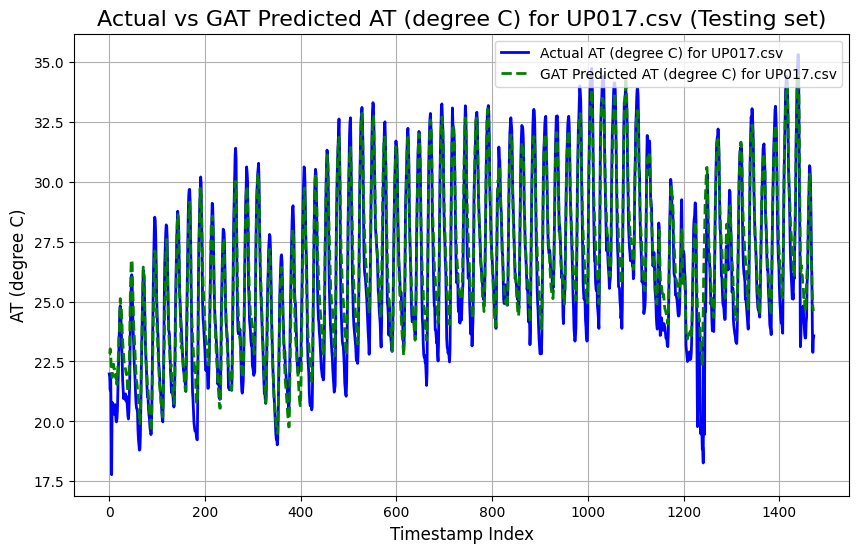

UP018.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 8.0982
Mean Squared Error (MSE): 102.6010
Root Mean Squared Error (RMSE): 10.1292
Pearson Correlation Coefficient: -0.6595
R-squared (R²): -2.7836

----------------------------------------



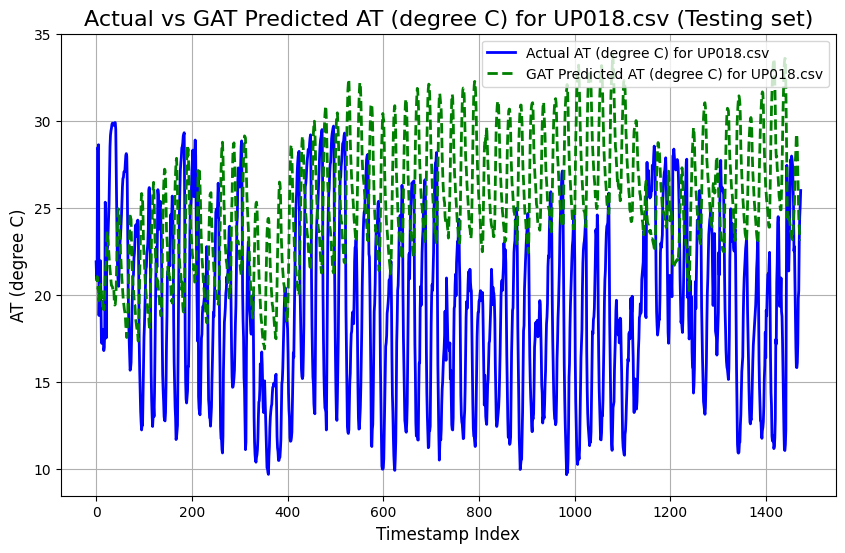

UP019.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.8136
Mean Squared Error (MSE): 4.0047
Root Mean Squared Error (RMSE): 2.0012
Pearson Correlation Coefficient: 0.9588
R-squared (R²): 0.7620

----------------------------------------



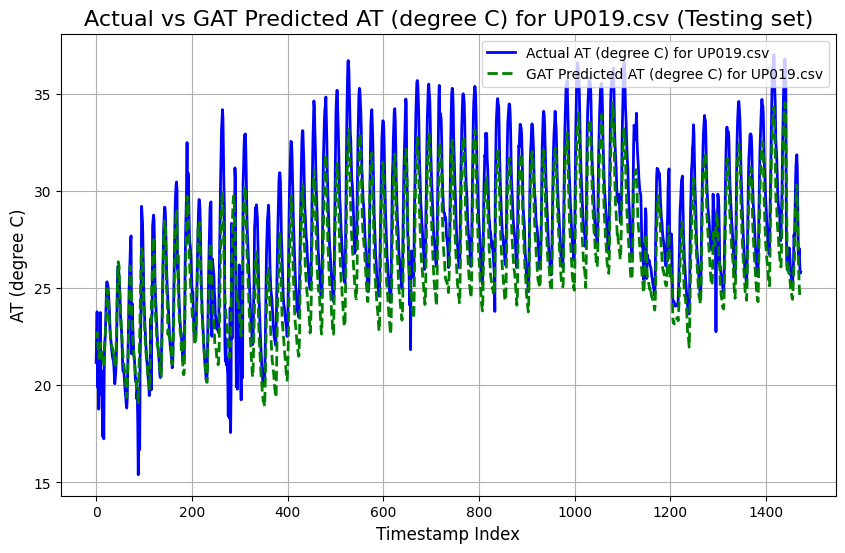

UP020.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.8655
Mean Squared Error (MSE): 1.2764
Root Mean Squared Error (RMSE): 1.1298
Pearson Correlation Coefficient: 0.9775
R-squared (R²): 0.9365

----------------------------------------



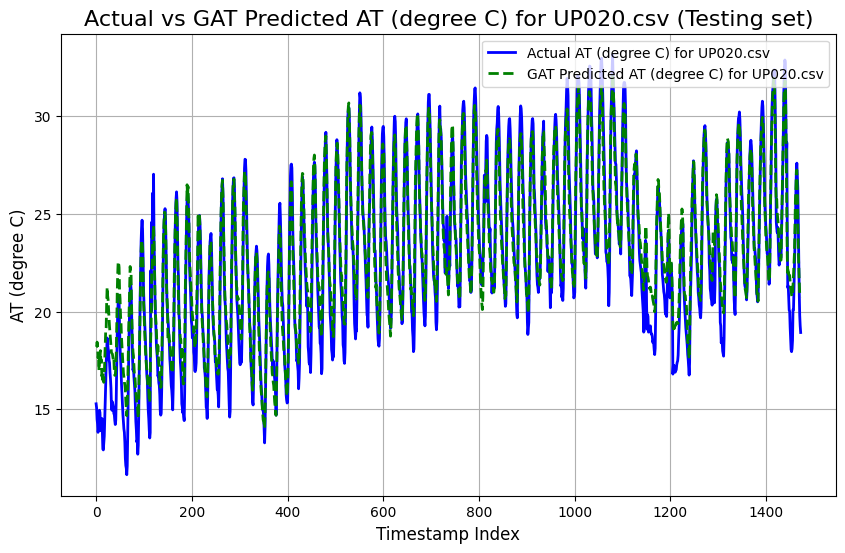

UP021.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 2.9349
Mean Squared Error (MSE): 12.9646
Root Mean Squared Error (RMSE): 3.6006
Pearson Correlation Coefficient: 0.8830
R-squared (R²): 0.3098

----------------------------------------



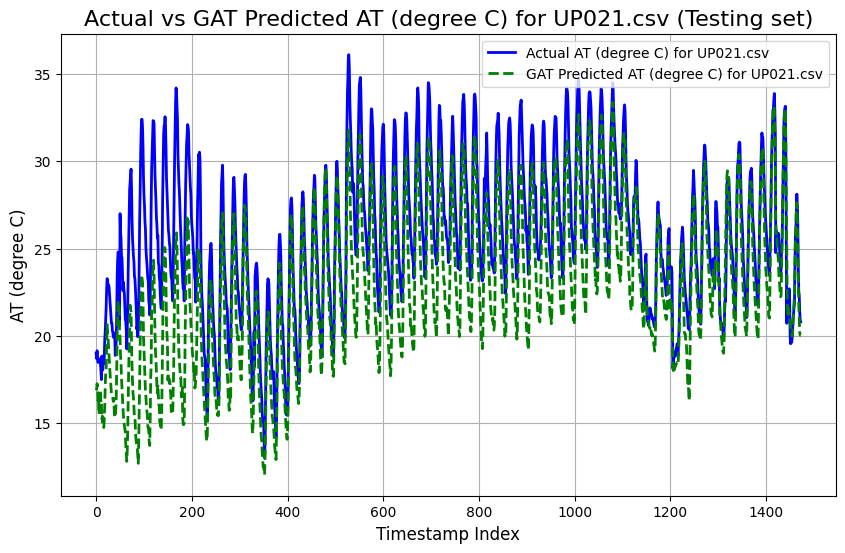

UP022.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.8283
Mean Squared Error (MSE): 1.2125
Root Mean Squared Error (RMSE): 1.1012
Pearson Correlation Coefficient: 0.9794
R-squared (R²): 0.9378

----------------------------------------



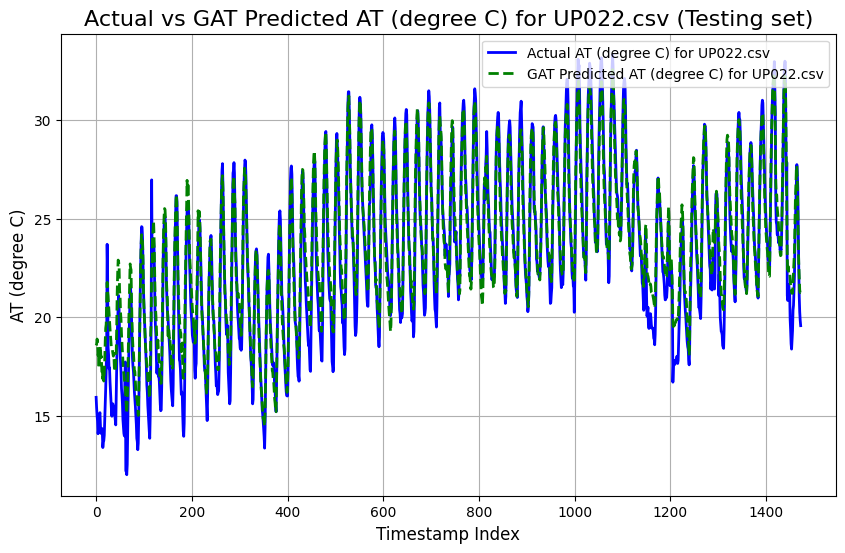

UP023.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.6116
Mean Squared Error (MSE): 3.3622
Root Mean Squared Error (RMSE): 1.8336
Pearson Correlation Coefficient: 0.9780
R-squared (R²): 0.8093

----------------------------------------



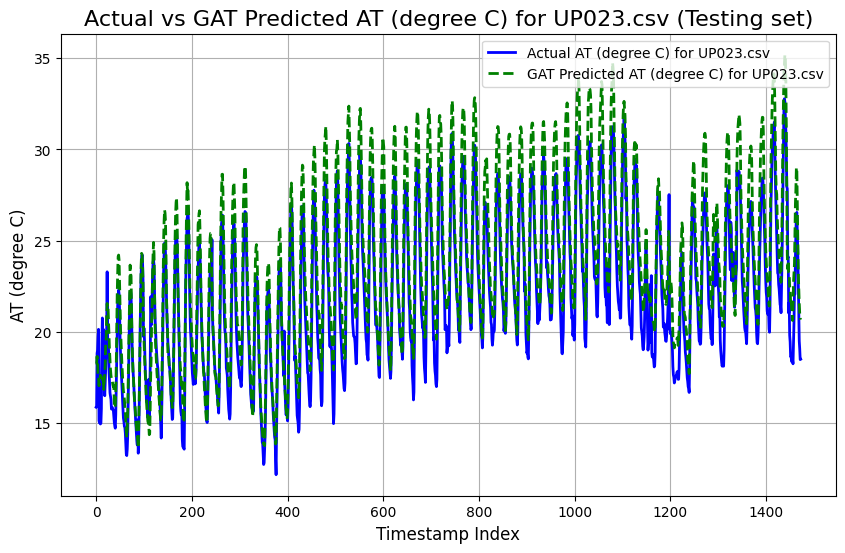

UP024.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 3.2887
Mean Squared Error (MSE): 15.1767
Root Mean Squared Error (RMSE): 3.8957
Pearson Correlation Coefficient: 0.9609
R-squared (R²): -0.6930

----------------------------------------



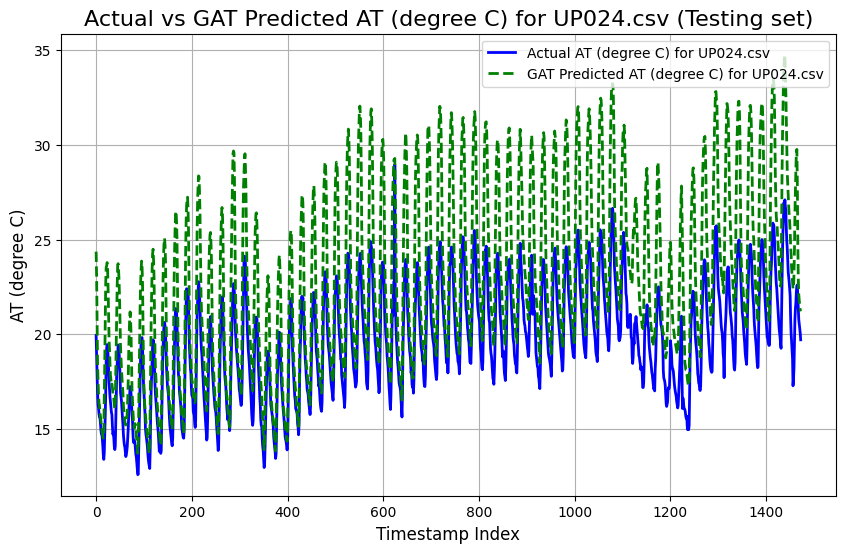

UP025.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.7632
Mean Squared Error (MSE): 1.1030
Root Mean Squared Error (RMSE): 1.0502
Pearson Correlation Coefficient: 0.9809
R-squared (R²): 0.9552

----------------------------------------



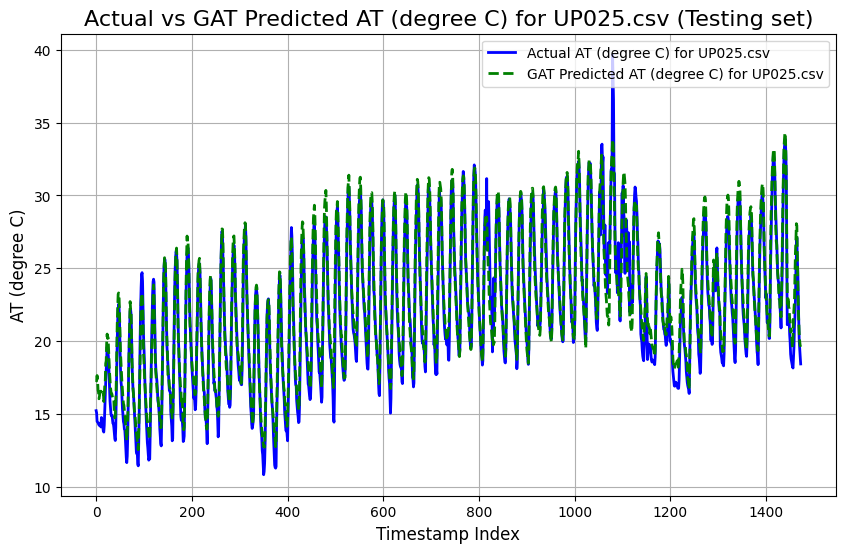

UP026.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.3304
Mean Squared Error (MSE): 2.5461
Root Mean Squared Error (RMSE): 1.5957
Pearson Correlation Coefficient: 0.9695
R-squared (R²): 0.9080

----------------------------------------



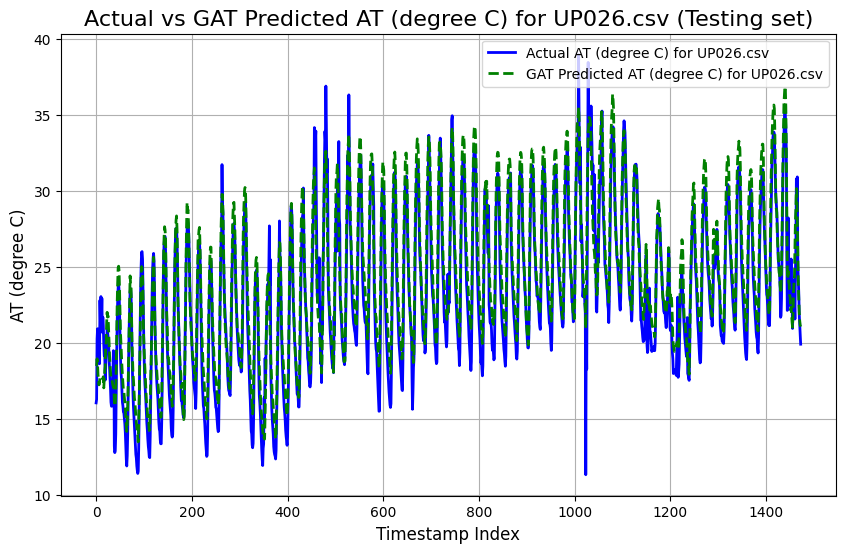

UP028.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.3226
Mean Squared Error (MSE): 3.6373
Root Mean Squared Error (RMSE): 1.9072
Pearson Correlation Coefficient: 0.9746
R-squared (R²): 0.9376

----------------------------------------



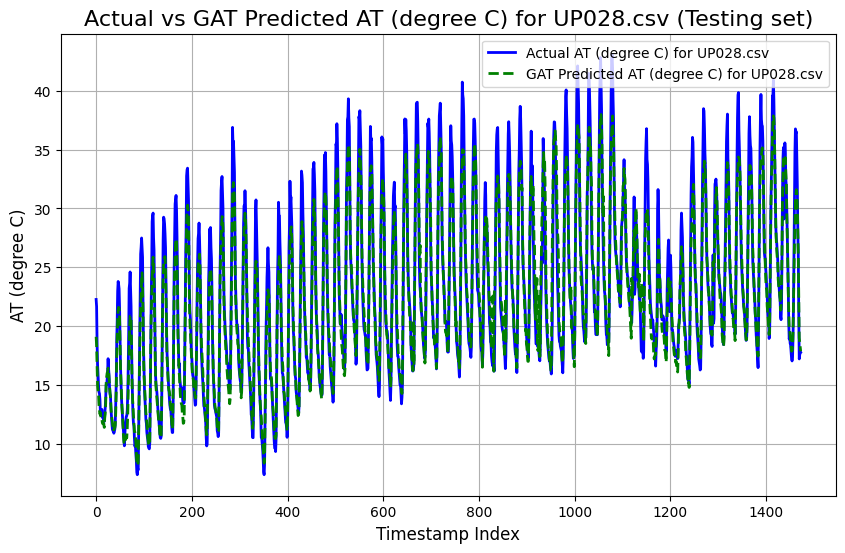

UP029.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.7159
Mean Squared Error (MSE): 0.8191
Root Mean Squared Error (RMSE): 0.9050
Pearson Correlation Coefficient: 0.9915
R-squared (R²): 0.9779

----------------------------------------



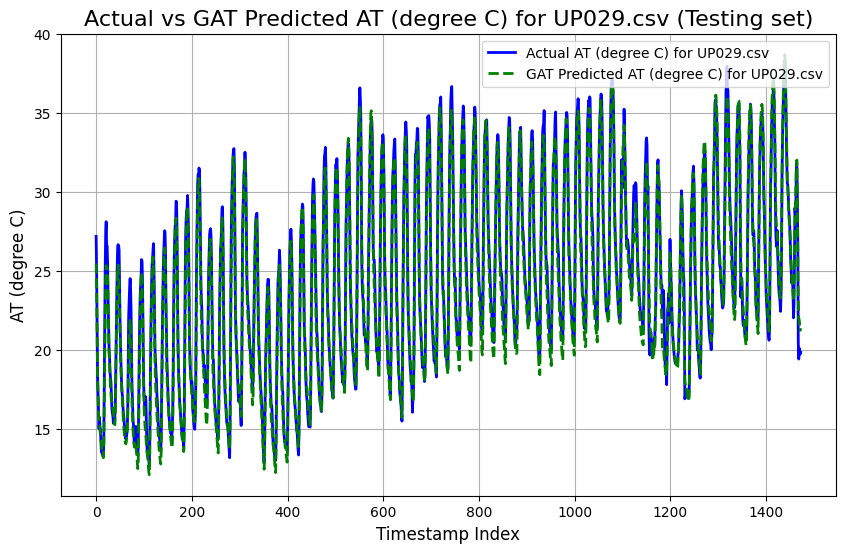

UP030.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.0670
Mean Squared Error (MSE): 2.1617
Root Mean Squared Error (RMSE): 1.4703
Pearson Correlation Coefficient: 0.9790
R-squared (R²): 0.9508

----------------------------------------



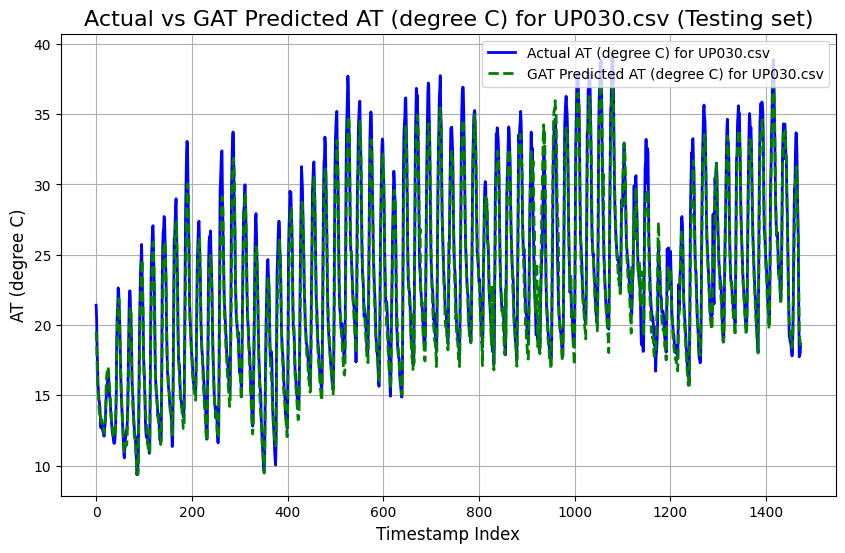

UP031.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.4933
Mean Squared Error (MSE): 3.7368
Root Mean Squared Error (RMSE): 1.9331
Pearson Correlation Coefficient: 0.9638
R-squared (R²): 0.9234

----------------------------------------



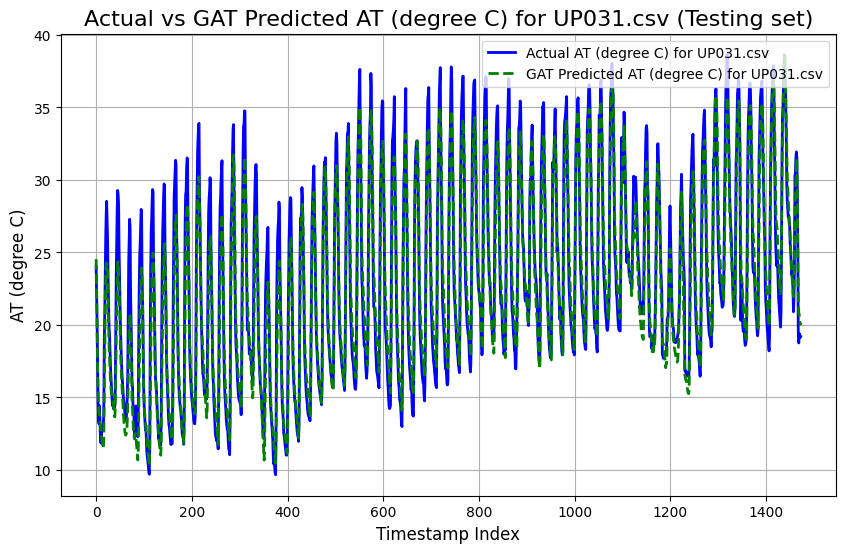

UP032.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.1386
Mean Squared Error (MSE): 2.1023
Root Mean Squared Error (RMSE): 1.4499
Pearson Correlation Coefficient: 0.9689
R-squared (R²): 0.9388

----------------------------------------



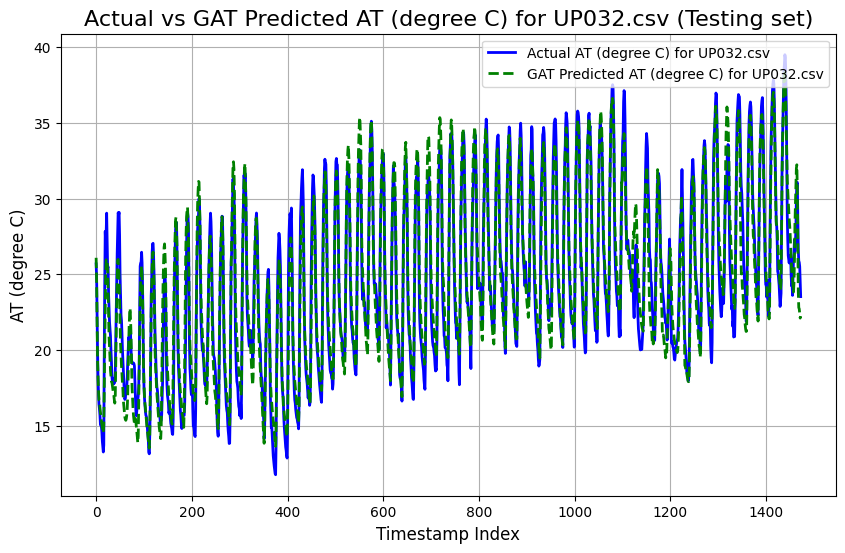

UP033.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.6695
Mean Squared Error (MSE): 0.7615
Root Mean Squared Error (RMSE): 0.8726
Pearson Correlation Coefficient: 0.9910
R-squared (R²): 0.9791

----------------------------------------



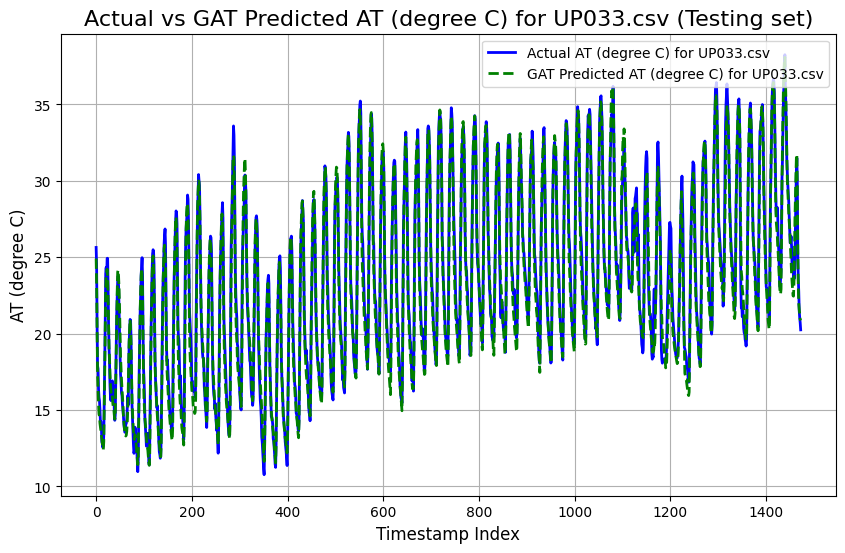

UP034.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 3.8929
Mean Squared Error (MSE): 23.7792
Root Mean Squared Error (RMSE): 4.8764
Pearson Correlation Coefficient: 0.8874
R-squared (R²): -0.0547

----------------------------------------



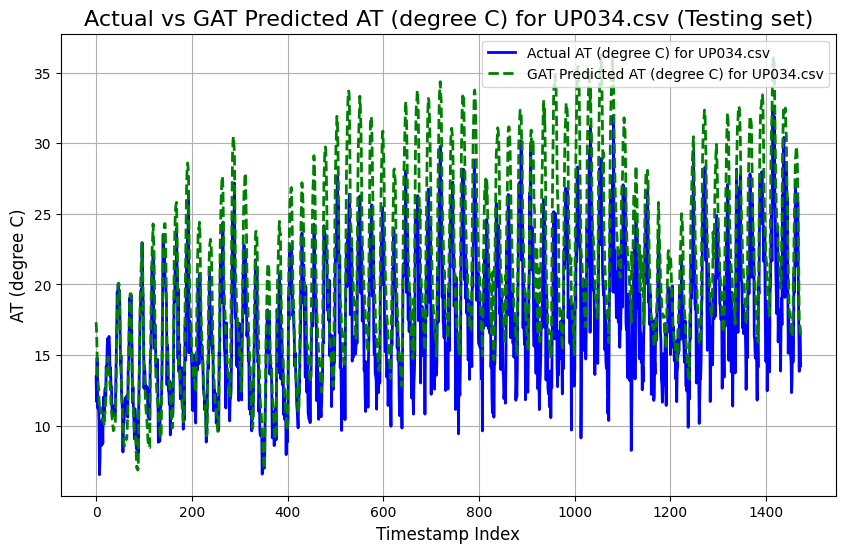

UP035.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.0099
Mean Squared Error (MSE): 1.7602
Root Mean Squared Error (RMSE): 1.3267
Pearson Correlation Coefficient: 0.9783
R-squared (R²): 0.9547

----------------------------------------



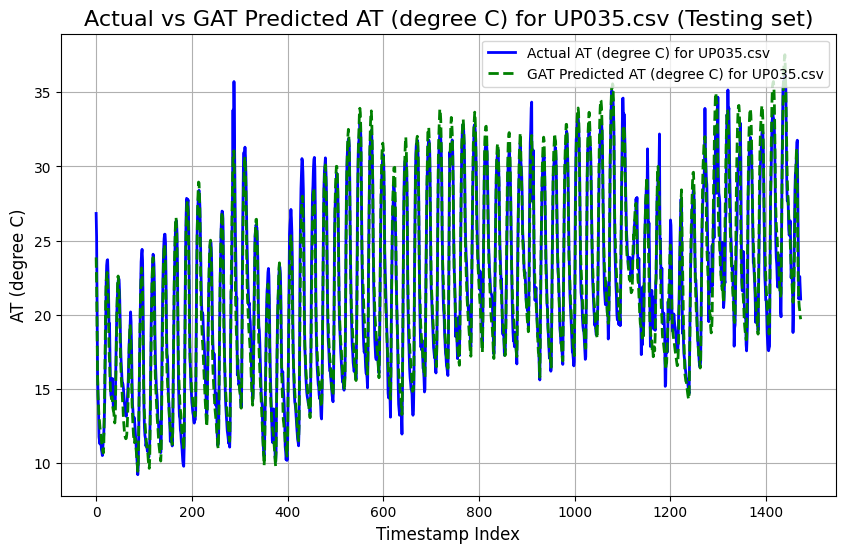

UP036.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.0003
Mean Squared Error (MSE): 1.5177
Root Mean Squared Error (RMSE): 1.2319
Pearson Correlation Coefficient: 0.9806
R-squared (R²): 0.9556

----------------------------------------



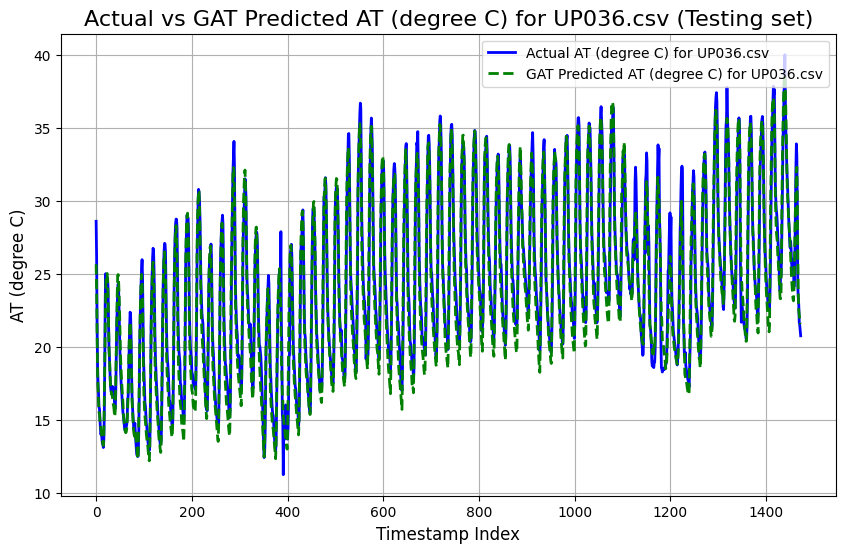

UP037.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.0651
Mean Squared Error (MSE): 2.0198
Root Mean Squared Error (RMSE): 1.4212
Pearson Correlation Coefficient: 0.9746
R-squared (R²): 0.9490

----------------------------------------



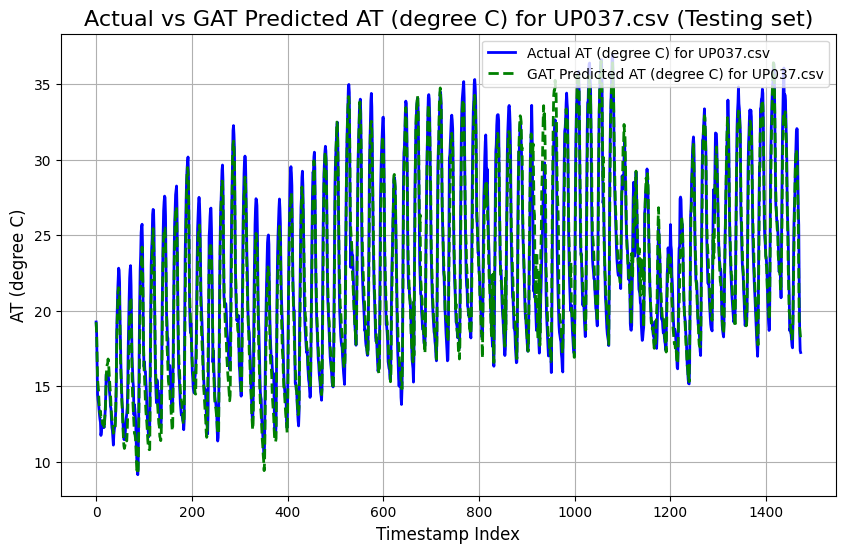

UP038.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.8325
Mean Squared Error (MSE): 1.0449
Root Mean Squared Error (RMSE): 1.0222
Pearson Correlation Coefficient: 0.9896
R-squared (R²): 0.9681

----------------------------------------



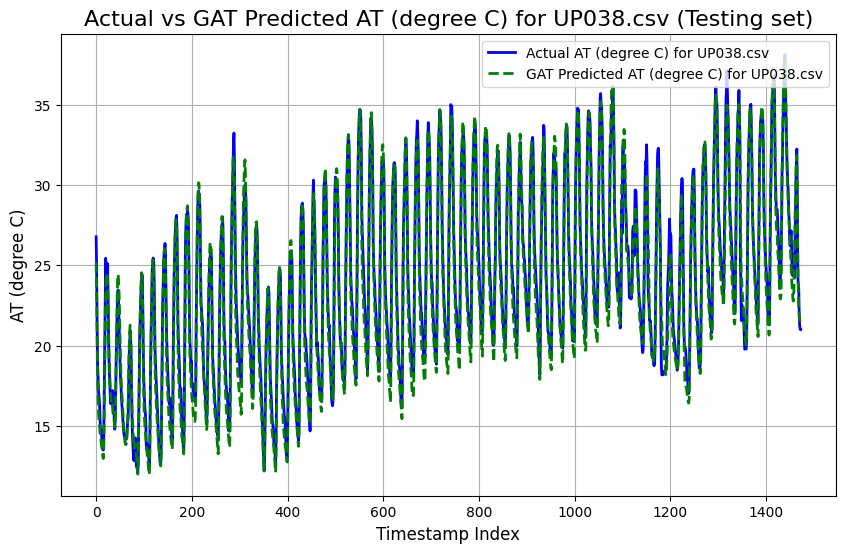

UP039.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.4744
Mean Squared Error (MSE): 3.4212
Root Mean Squared Error (RMSE): 1.8497
Pearson Correlation Coefficient: 0.9698
R-squared (R²): 0.9339

----------------------------------------



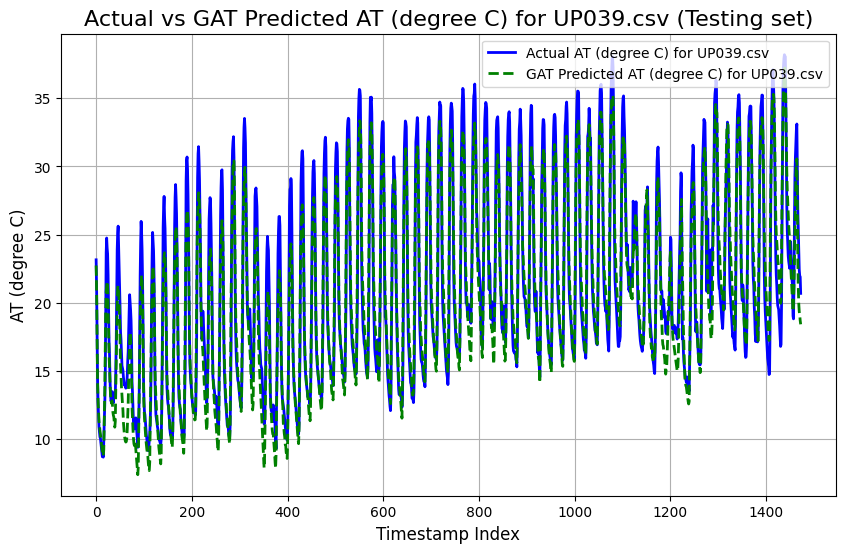

UP040.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.1316
Mean Squared Error (MSE): 2.0124
Root Mean Squared Error (RMSE): 1.4186
Pearson Correlation Coefficient: 0.9777
R-squared (R²): 0.9525

----------------------------------------



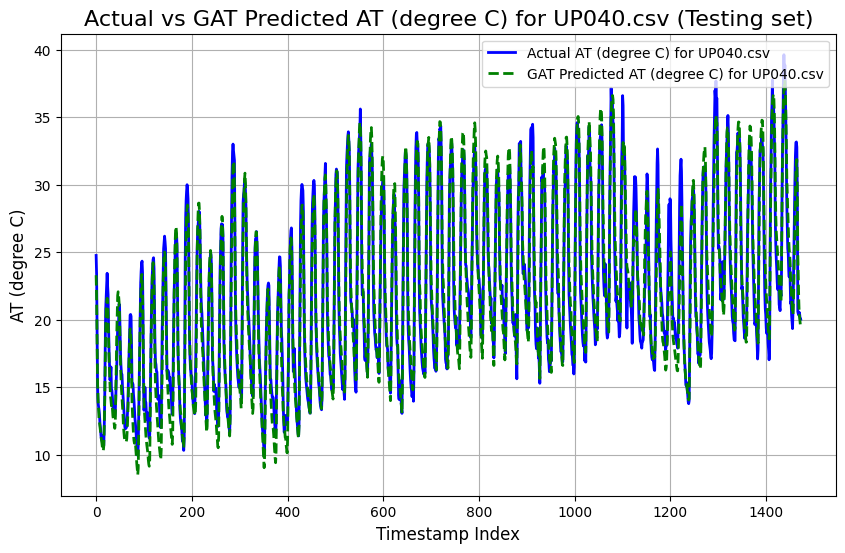

UP041.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.0383
Mean Squared Error (MSE): 1.7267
Root Mean Squared Error (RMSE): 1.3140
Pearson Correlation Coefficient: 0.9780
R-squared (R²): 0.9490

----------------------------------------



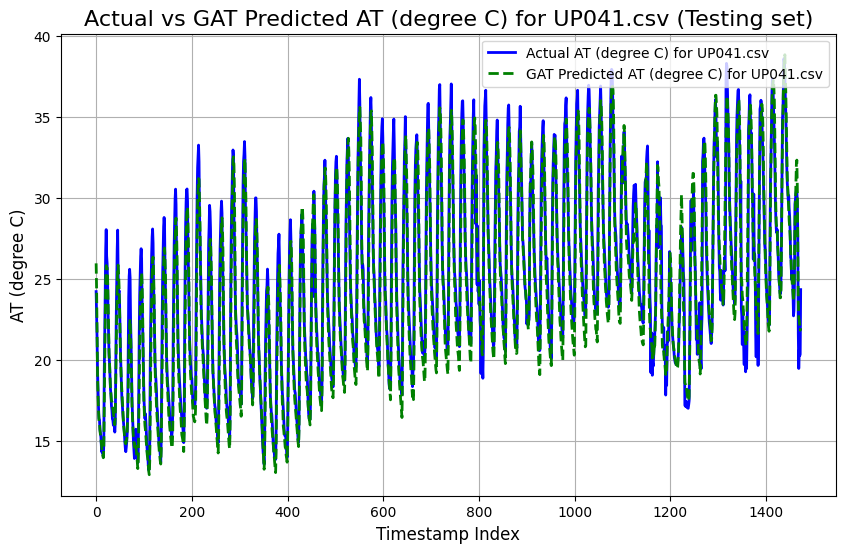

UP042.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.9505
Mean Squared Error (MSE): 1.6212
Root Mean Squared Error (RMSE): 1.2733
Pearson Correlation Coefficient: 0.9760
R-squared (R²): 0.9520

----------------------------------------



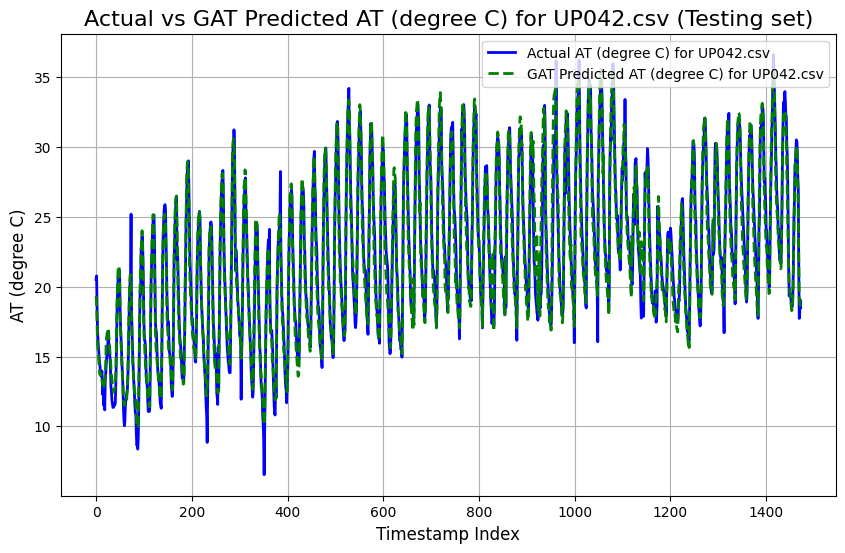

UP043.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.9112
Mean Squared Error (MSE): 1.5765
Root Mean Squared Error (RMSE): 1.2556
Pearson Correlation Coefficient: 0.9798
R-squared (R²): 0.9569

----------------------------------------



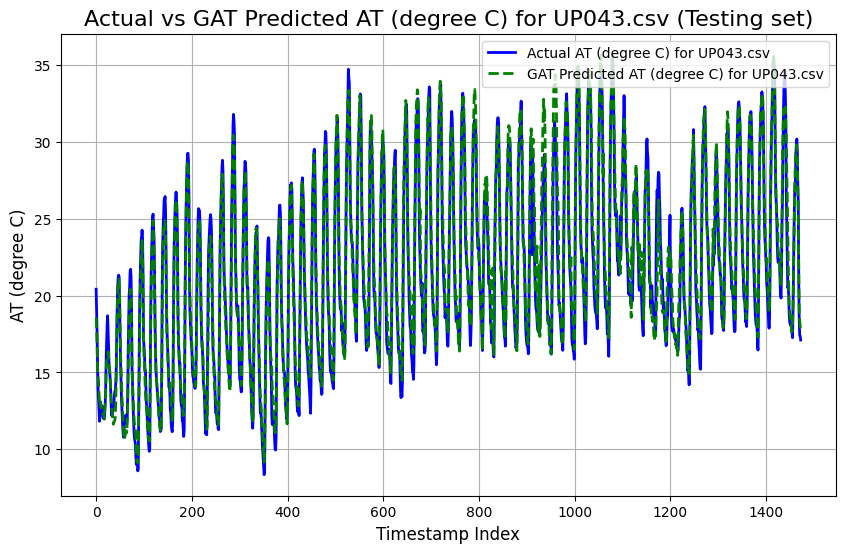

UP044.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.9572
Mean Squared Error (MSE): 1.6226
Root Mean Squared Error (RMSE): 1.2738
Pearson Correlation Coefficient: 0.9867
R-squared (R²): 0.9632

----------------------------------------



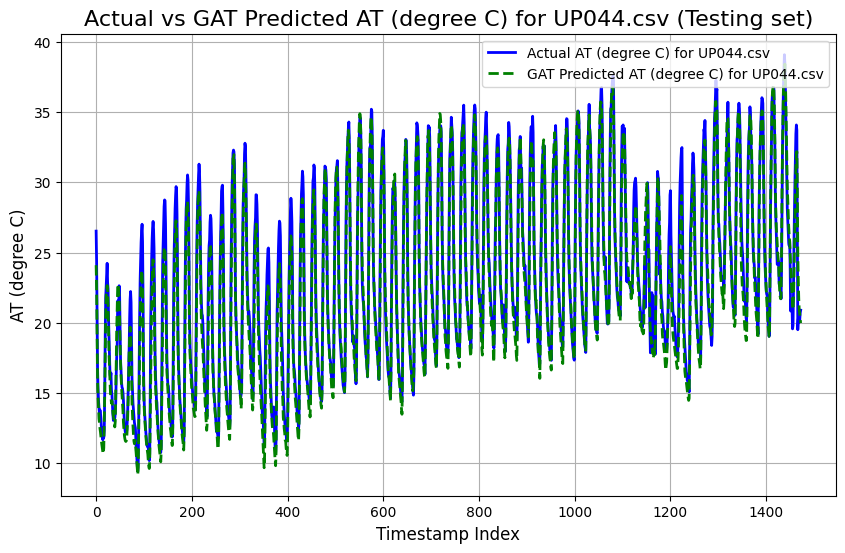

UP046.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.2110
Mean Squared Error (MSE): 2.2154
Root Mean Squared Error (RMSE): 1.4884
Pearson Correlation Coefficient: 0.9747
R-squared (R²): 0.9374

----------------------------------------



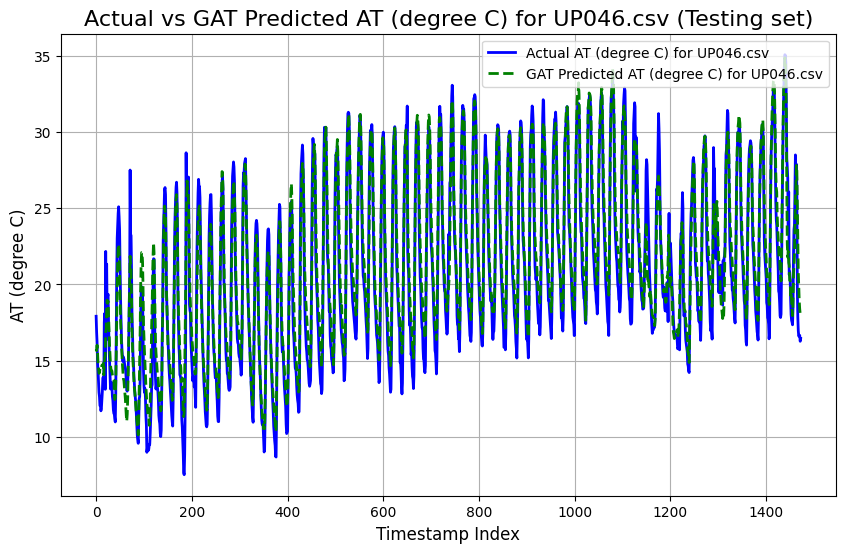

UP048.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.4215
Mean Squared Error (MSE): 3.3411
Root Mean Squared Error (RMSE): 1.8279
Pearson Correlation Coefficient: 0.9612
R-squared (R²): 0.9095

----------------------------------------



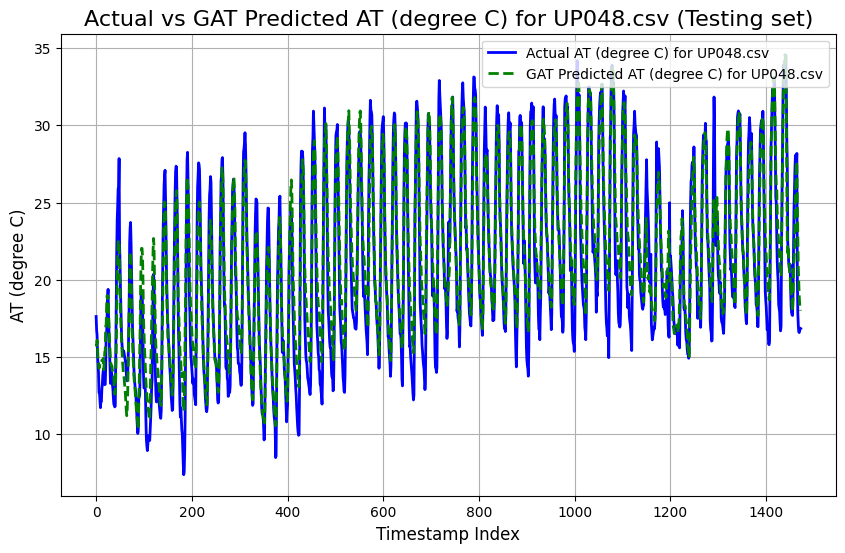

UP049.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.2979
Mean Squared Error (MSE): 2.6600
Root Mean Squared Error (RMSE): 1.6309
Pearson Correlation Coefficient: 0.9652
R-squared (R²): 0.9191

----------------------------------------



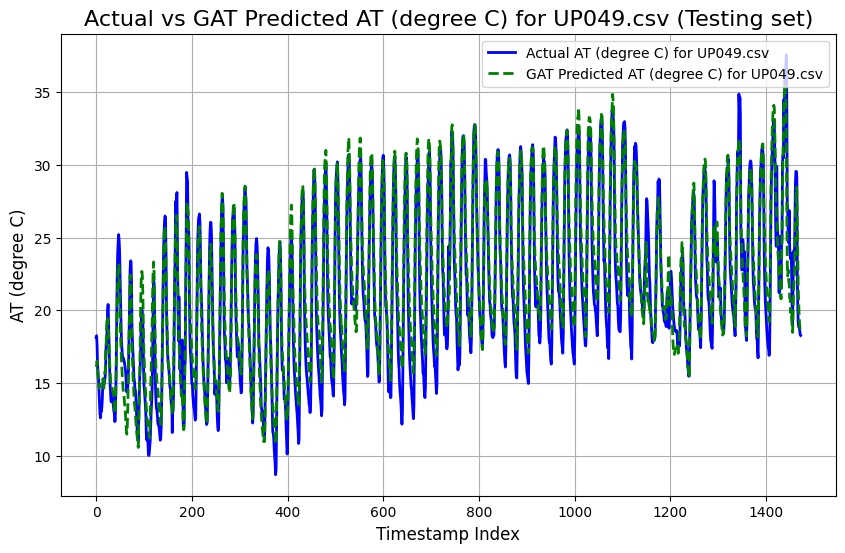

UP050.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.2025
Mean Squared Error (MSE): 2.6918
Root Mean Squared Error (RMSE): 1.6407
Pearson Correlation Coefficient: 0.9516
R-squared (R²): 0.8935

----------------------------------------



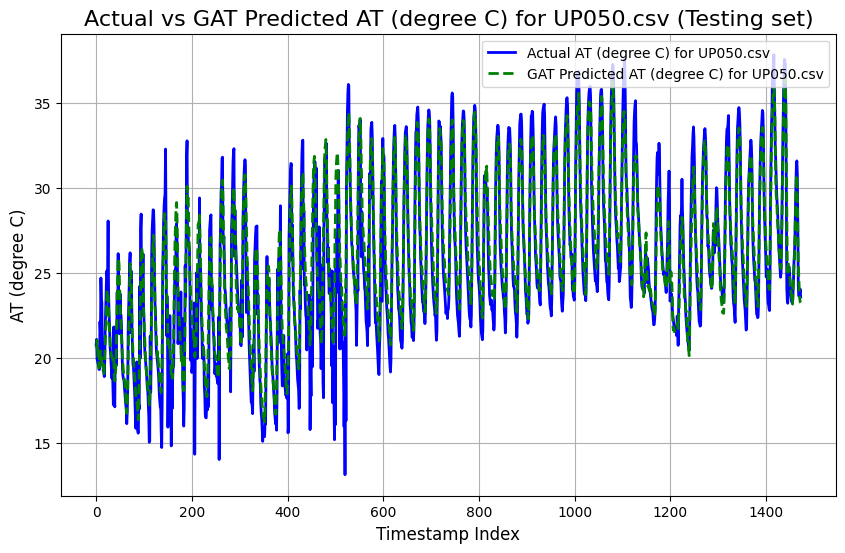

UP051.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 3.1594
Mean Squared Error (MSE): 41.8695
Root Mean Squared Error (RMSE): 6.4707
Pearson Correlation Coefficient: 0.6419
R-squared (R²): 0.3849

----------------------------------------



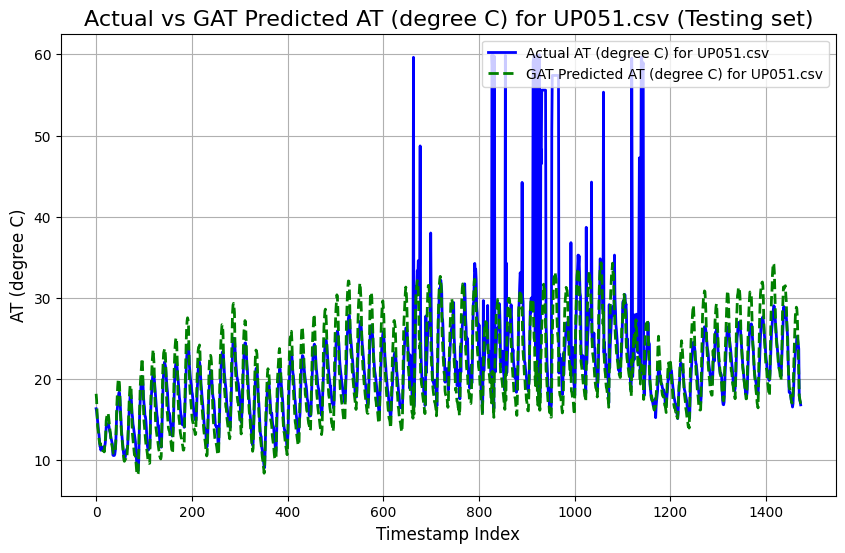

UP052.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.4353
Mean Squared Error (MSE): 3.3801
Root Mean Squared Error (RMSE): 1.8385
Pearson Correlation Coefficient: 0.9625
R-squared (R²): 0.9070

----------------------------------------



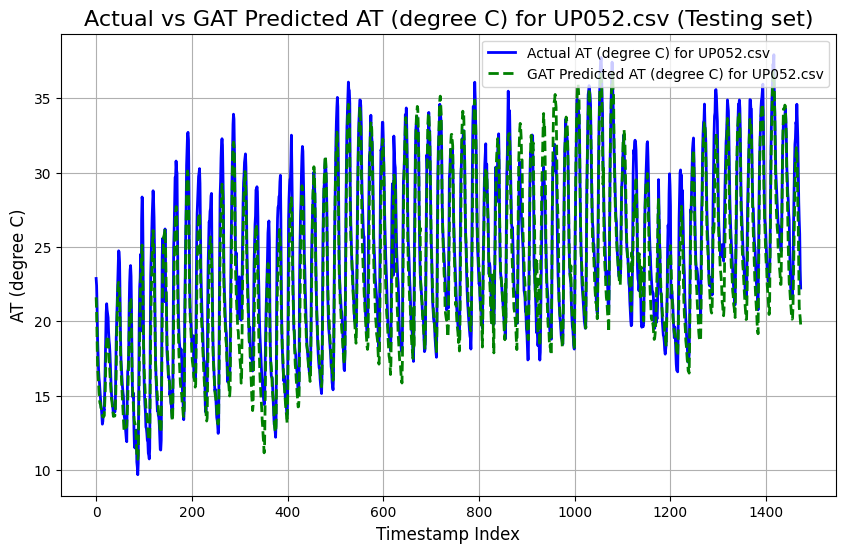

Train GNN Imputed 1.csv
CSV file 'Train GNN Imputed 1.csv' created successfully.
Test GNN Imputed 1.csv
CSV file 'Test GNN Imputed 1.csv' created successfully.
UP002.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.1471
Mean Squared Error (MSE): 2.2405
Root Mean Squared Error (RMSE): 1.4968
Pearson Correlation Coefficient: 0.9822
R-squared (R²): 0.9603

----------------------------------------



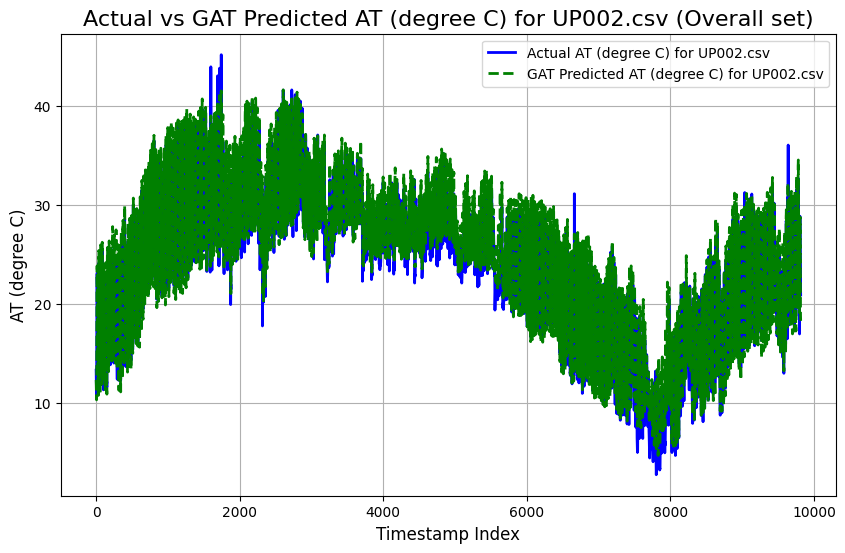

UP003.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.2125
Mean Squared Error (MSE): 2.3644
Root Mean Squared Error (RMSE): 1.5377
Pearson Correlation Coefficient: 0.9857
R-squared (R²): 0.9673

----------------------------------------



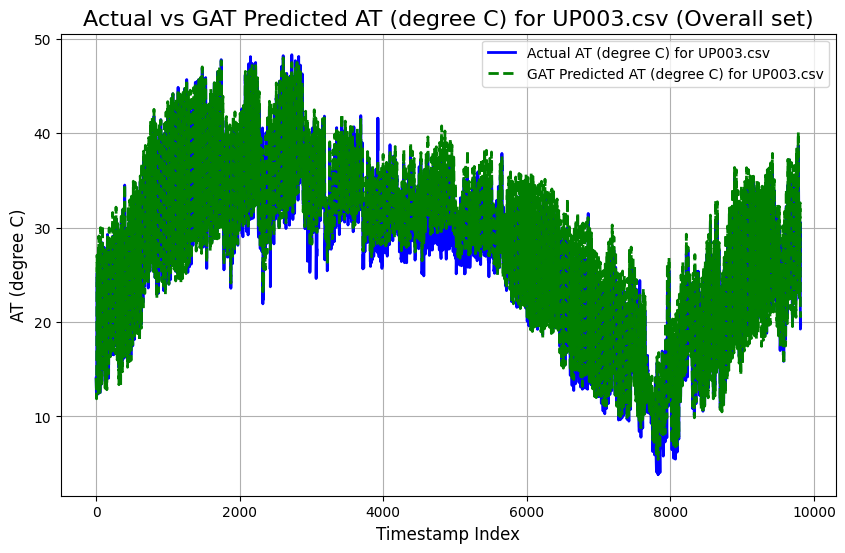

UP004.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.2396
Mean Squared Error (MSE): 2.2738
Root Mean Squared Error (RMSE): 1.5079
Pearson Correlation Coefficient: 0.9875
R-squared (R²): 0.9712

----------------------------------------



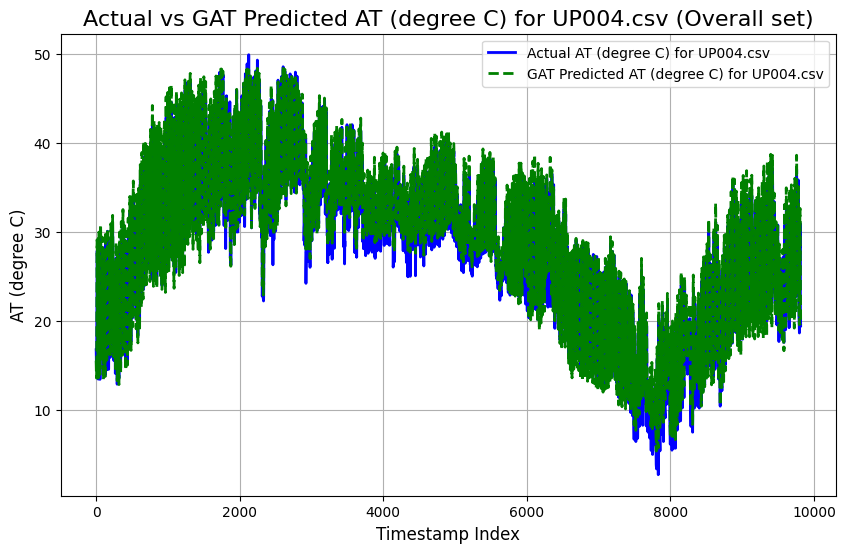

UP008.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 5.1316
Mean Squared Error (MSE): 52.2981
Root Mean Squared Error (RMSE): 7.2317
Pearson Correlation Coefficient: 0.8013
R-squared (R²): 0.6012

----------------------------------------



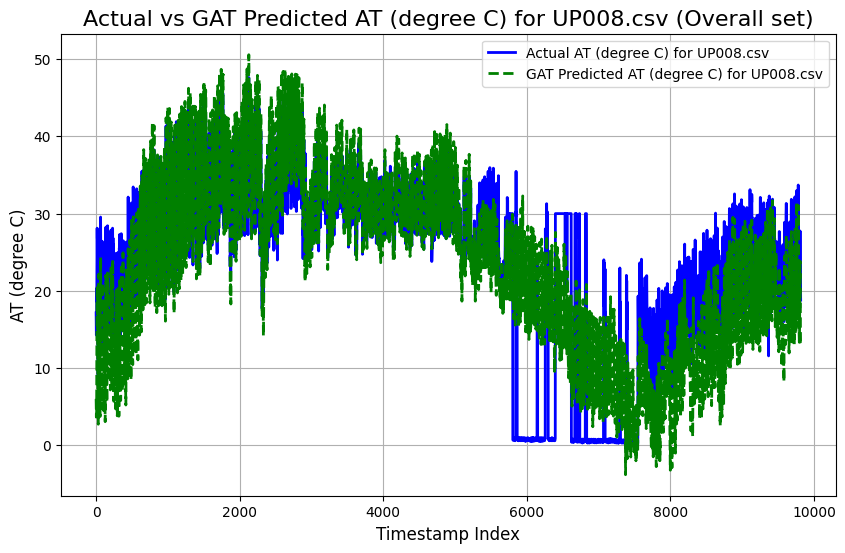

UP009.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.0602
Mean Squared Error (MSE): 1.8369
Root Mean Squared Error (RMSE): 1.3553
Pearson Correlation Coefficient: 0.9855
R-squared (R²): 0.9681

----------------------------------------



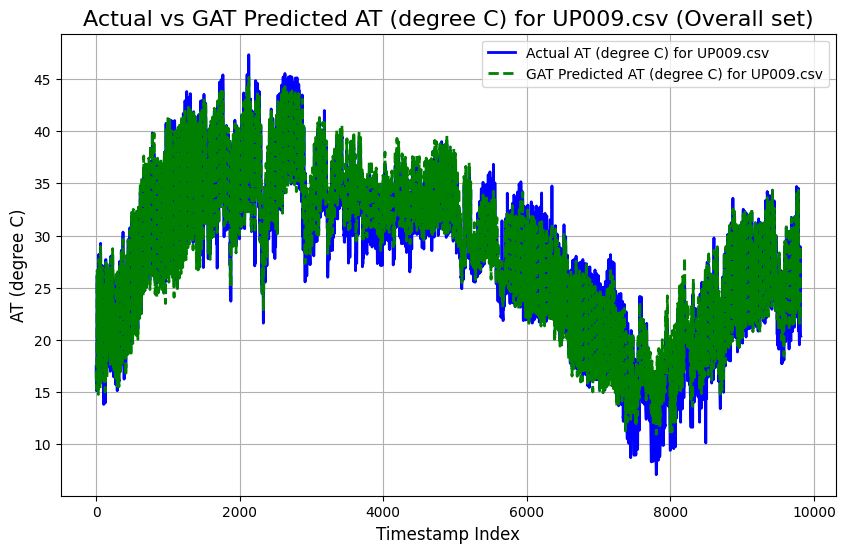

UP012.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.4103
Mean Squared Error (MSE): 3.8357
Root Mean Squared Error (RMSE): 1.9585
Pearson Correlation Coefficient: 0.9824
R-squared (R²): 0.9626

----------------------------------------



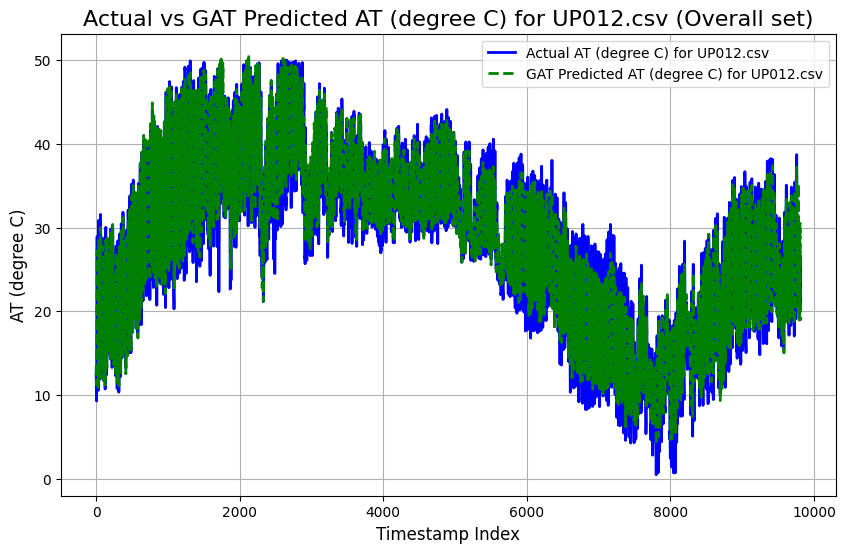

UP014.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 3.3425
Mean Squared Error (MSE): 16.0328
Root Mean Squared Error (RMSE): 4.0041
Pearson Correlation Coefficient: 0.9362
R-squared (R²): 0.8692

----------------------------------------



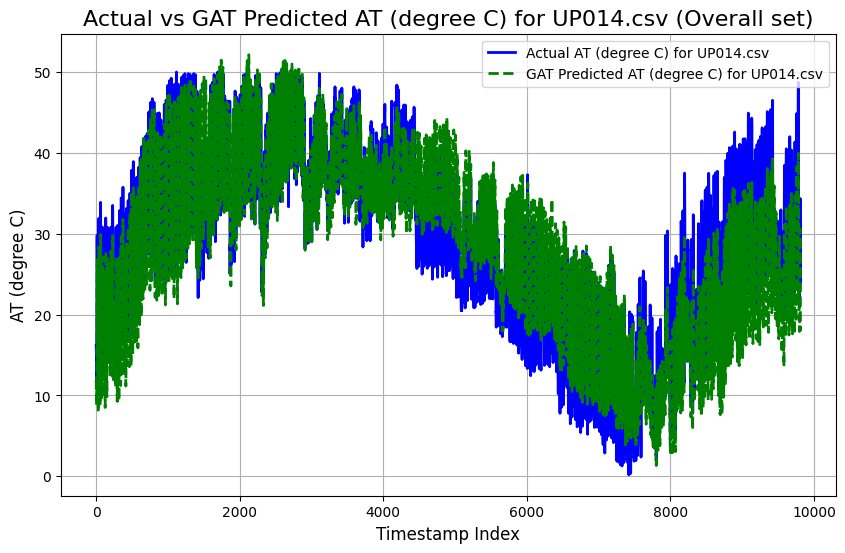

UP016.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 3.0802
Mean Squared Error (MSE): 13.7879
Root Mean Squared Error (RMSE): 3.7132
Pearson Correlation Coefficient: 0.9460
R-squared (R²): 0.8901

----------------------------------------



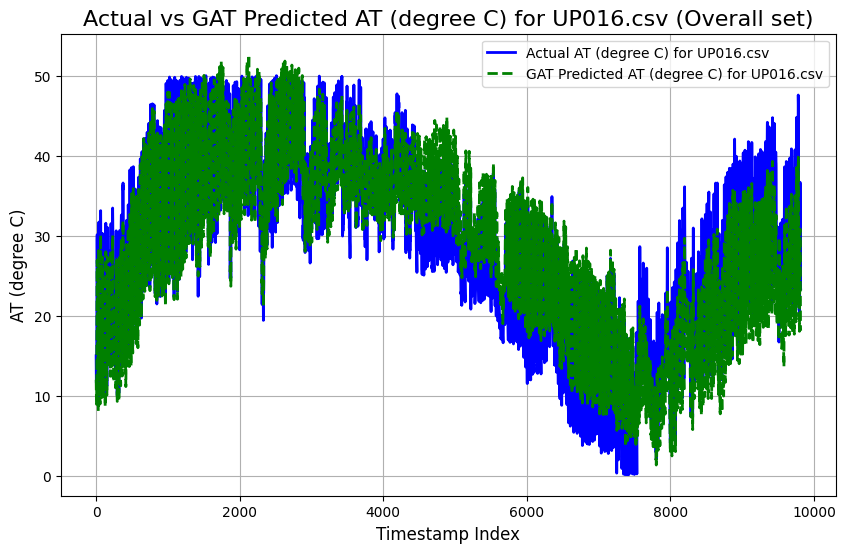

UP017.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 0.8598
Mean Squared Error (MSE): 1.1116
Root Mean Squared Error (RMSE): 1.0543
Pearson Correlation Coefficient: 0.9837
R-squared (R²): 0.9644

----------------------------------------



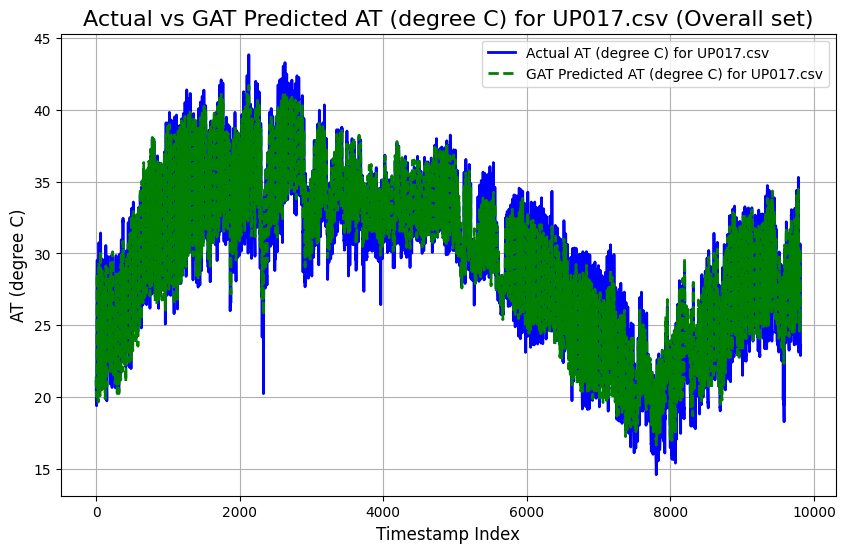

UP018.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 5.1370
Mean Squared Error (MSE): 51.5497
Root Mean Squared Error (RMSE): 7.1798
Pearson Correlation Coefficient: 0.5086
R-squared (R²): 0.1072

----------------------------------------



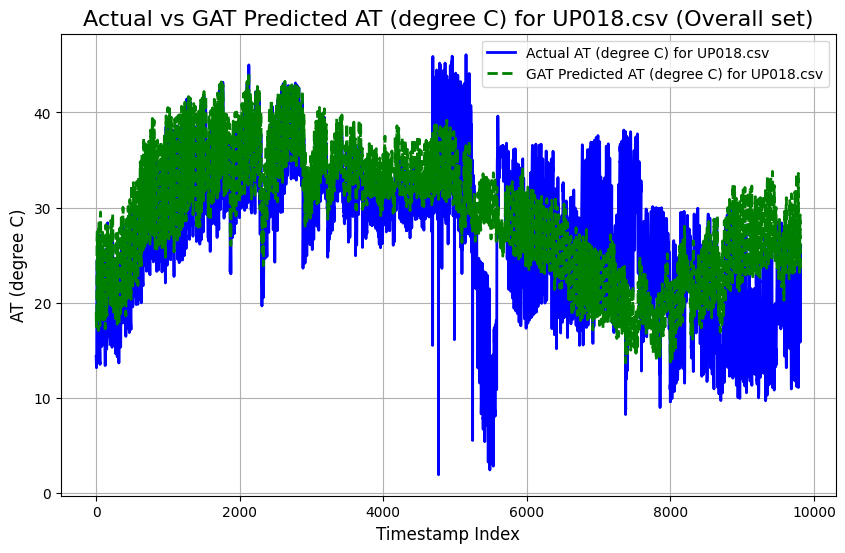

UP019.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.5541
Mean Squared Error (MSE): 4.8351
Root Mean Squared Error (RMSE): 2.1989
Pearson Correlation Coefficient: 0.9312
R-squared (R²): 0.8638

----------------------------------------



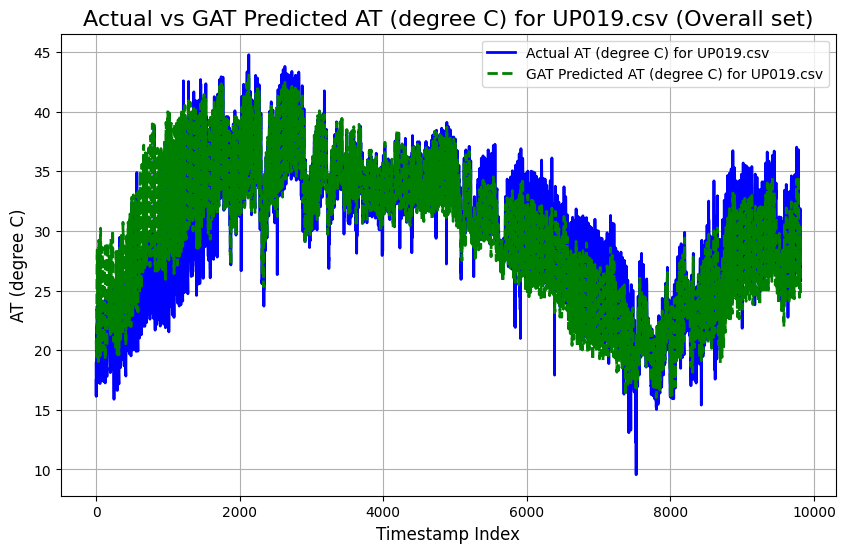

UP020.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.1596
Mean Squared Error (MSE): 2.0785
Root Mean Squared Error (RMSE): 1.4417
Pearson Correlation Coefficient: 0.9820
R-squared (R²): 0.9613

----------------------------------------



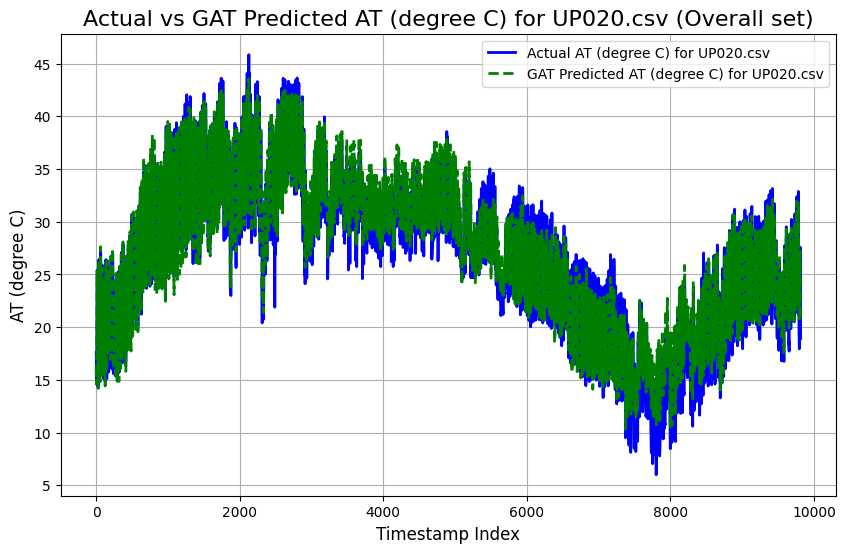

UP021.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 3.4486
Mean Squared Error (MSE): 20.1285
Root Mean Squared Error (RMSE): 4.4865
Pearson Correlation Coefficient: 0.8568
R-squared (R²): 0.7154

----------------------------------------



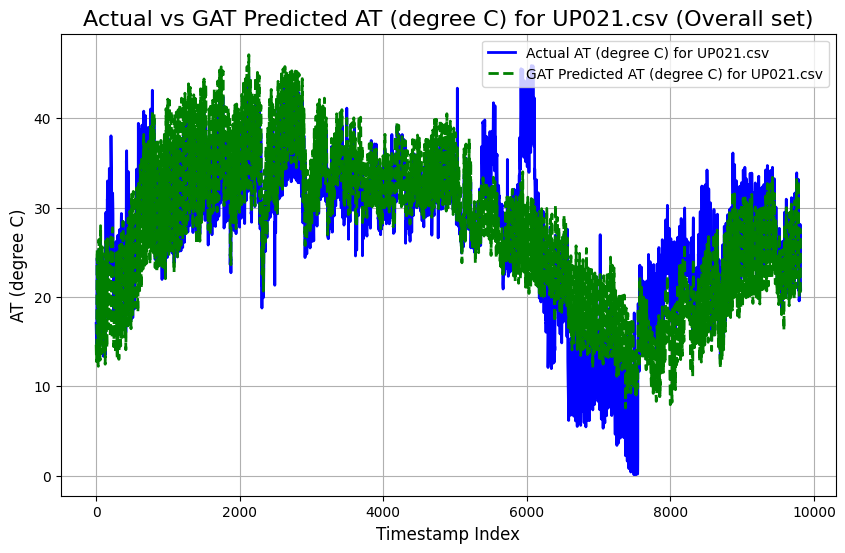

UP022.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.2014
Mean Squared Error (MSE): 2.7558
Root Mean Squared Error (RMSE): 1.6601
Pearson Correlation Coefficient: 0.9758
R-squared (R²): 0.9491

----------------------------------------



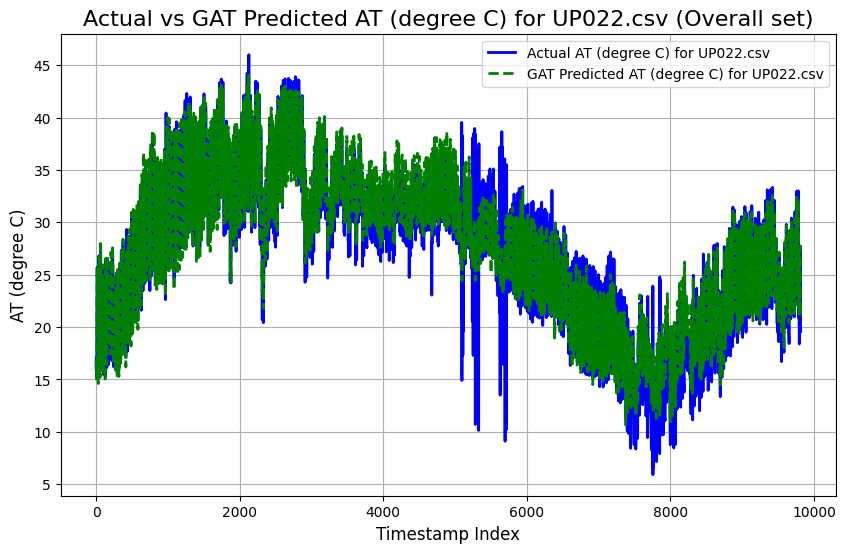

UP023.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.3260
Mean Squared Error (MSE): 3.4677
Root Mean Squared Error (RMSE): 1.8622
Pearson Correlation Coefficient: 0.9727
R-squared (R²): 0.9395

----------------------------------------



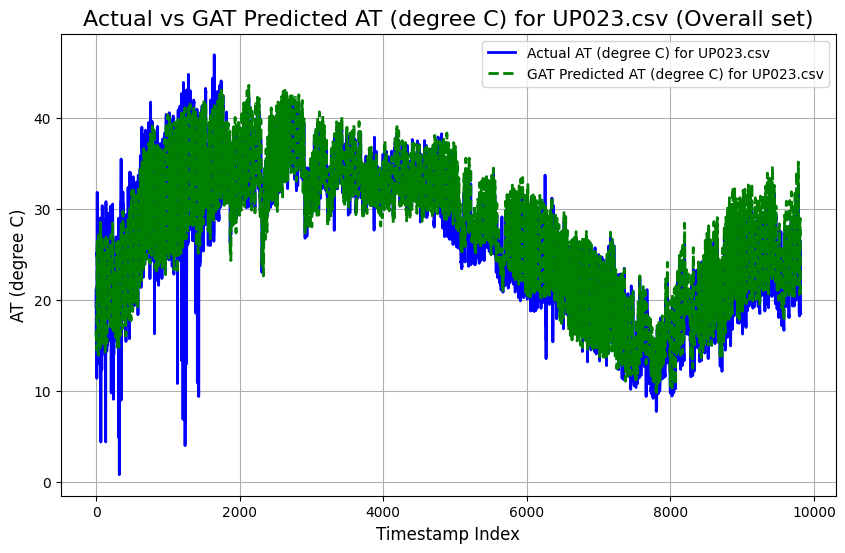

UP024.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 2.7288
Mean Squared Error (MSE): 13.5867
Root Mean Squared Error (RMSE): 3.6860
Pearson Correlation Coefficient: 0.8398
R-squared (R²): 0.6654

----------------------------------------



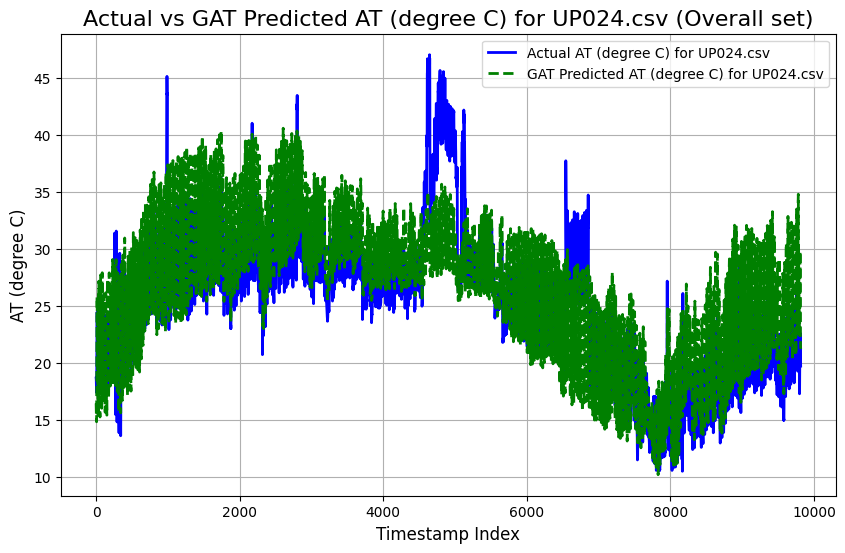

UP025.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 0.9788
Mean Squared Error (MSE): 1.6592
Root Mean Squared Error (RMSE): 1.2881
Pearson Correlation Coefficient: 0.9870
R-squared (R²): 0.9707

----------------------------------------



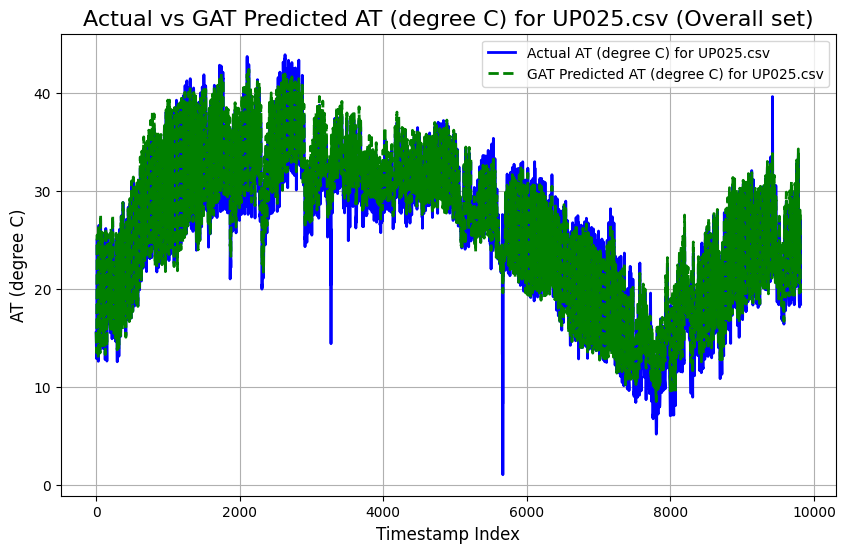

UP026.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.0607
Mean Squared Error (MSE): 1.8031
Root Mean Squared Error (RMSE): 1.3428
Pearson Correlation Coefficient: 0.9884
R-squared (R²): 0.9726

----------------------------------------



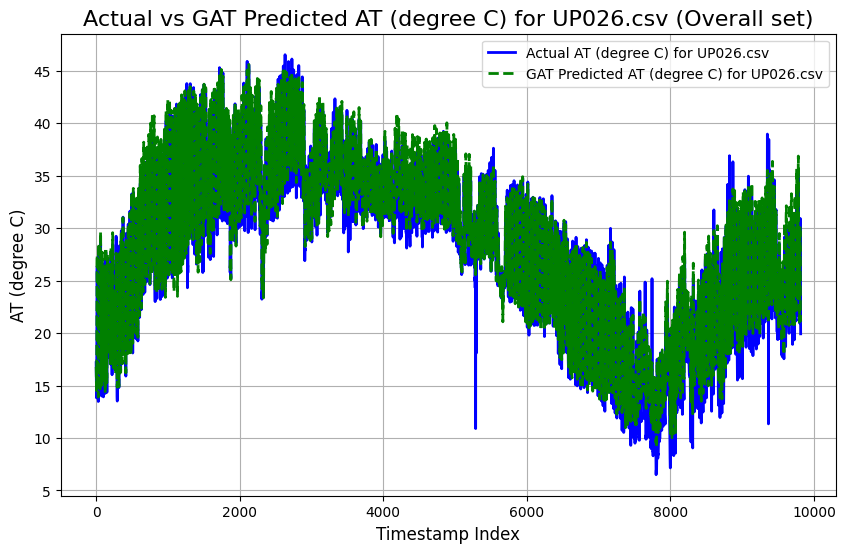

UP028.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.7002
Mean Squared Error (MSE): 4.6341
Root Mean Squared Error (RMSE): 2.1527
Pearson Correlation Coefficient: 0.9756
R-squared (R²): 0.9487

----------------------------------------



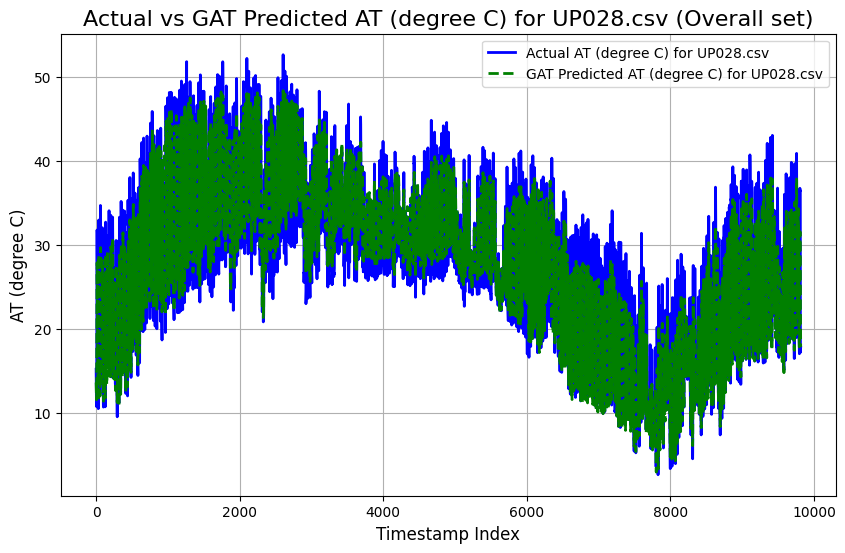

UP029.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 0.8996
Mean Squared Error (MSE): 1.4903
Root Mean Squared Error (RMSE): 1.2208
Pearson Correlation Coefficient: 0.9888
R-squared (R²): 0.9747

----------------------------------------



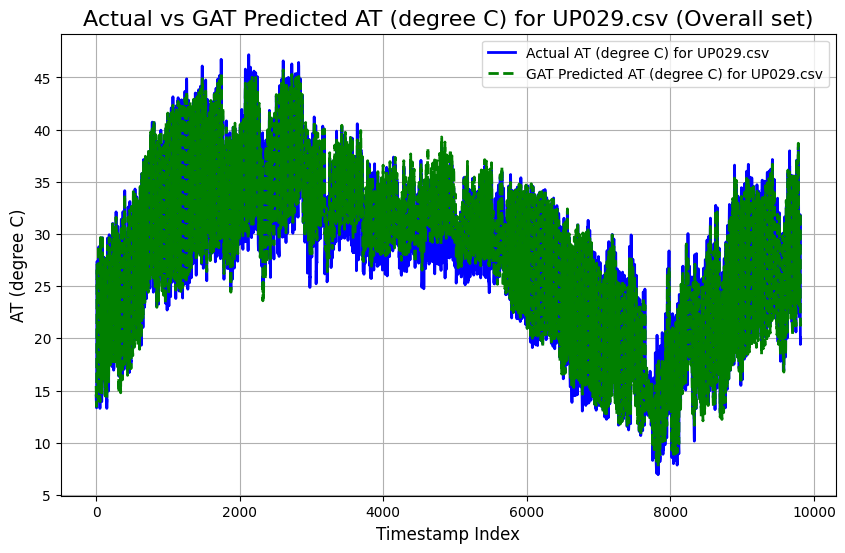

UP030.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.1931
Mean Squared Error (MSE): 2.3624
Root Mean Squared Error (RMSE): 1.5370
Pearson Correlation Coefficient: 0.9862
R-squared (R²): 0.9697

----------------------------------------



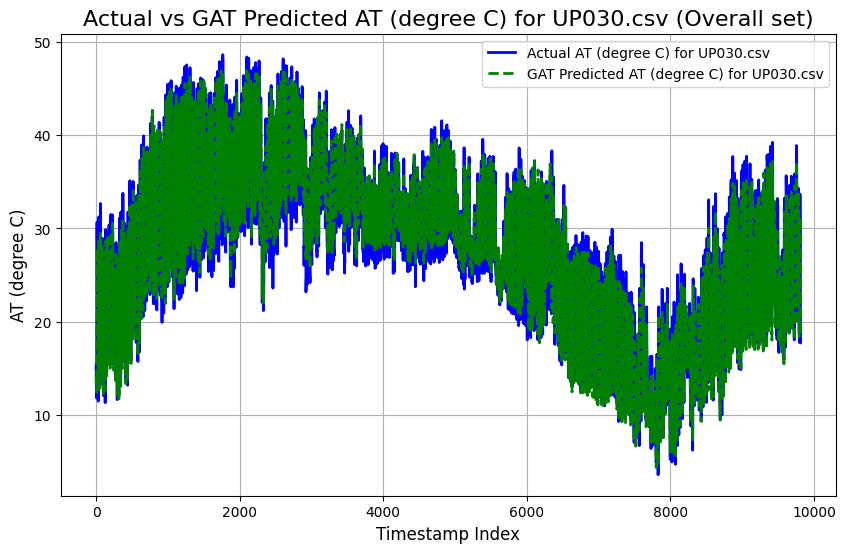

UP031.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.4843
Mean Squared Error (MSE): 3.5919
Root Mean Squared Error (RMSE): 1.8952
Pearson Correlation Coefficient: 0.9748
R-squared (R²): 0.9467

----------------------------------------



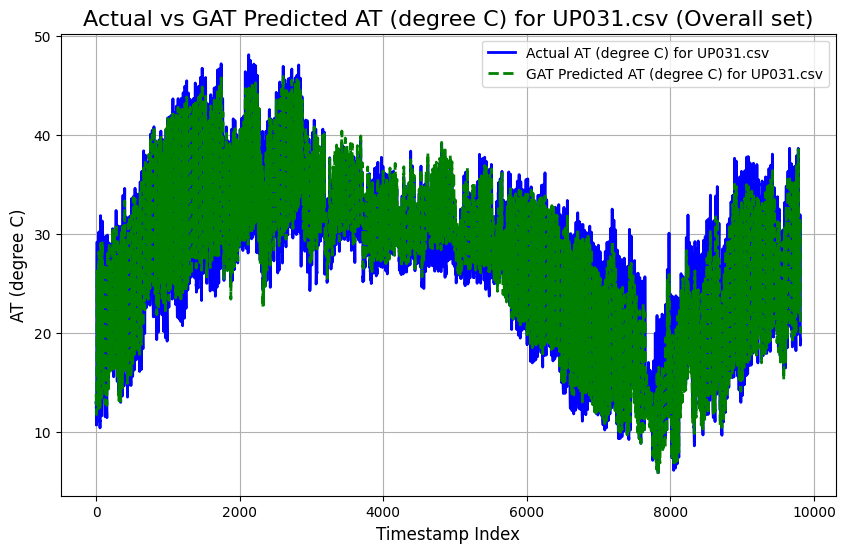

UP032.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.3908
Mean Squared Error (MSE): 3.3644
Root Mean Squared Error (RMSE): 1.8342
Pearson Correlation Coefficient: 0.9699
R-squared (R²): 0.9358

----------------------------------------



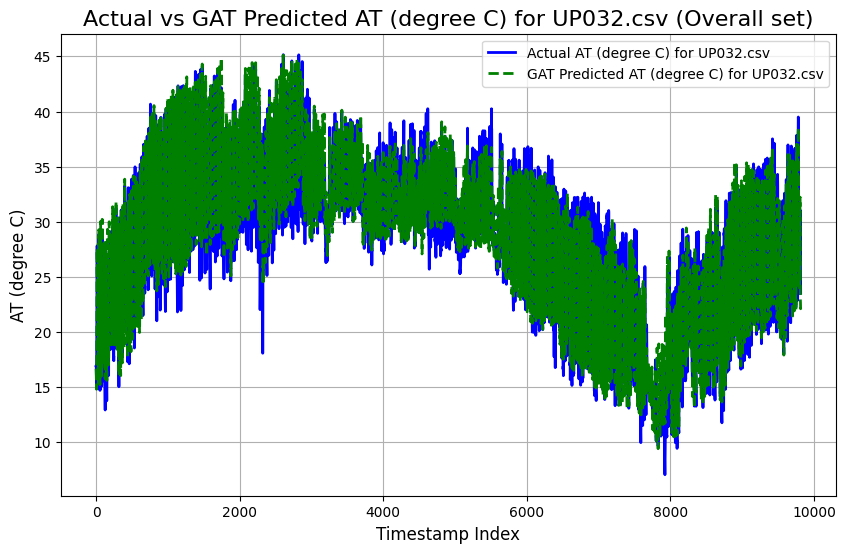

UP033.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 0.8686
Mean Squared Error (MSE): 1.3809
Root Mean Squared Error (RMSE): 1.1751
Pearson Correlation Coefficient: 0.9902
R-squared (R²): 0.9774

----------------------------------------



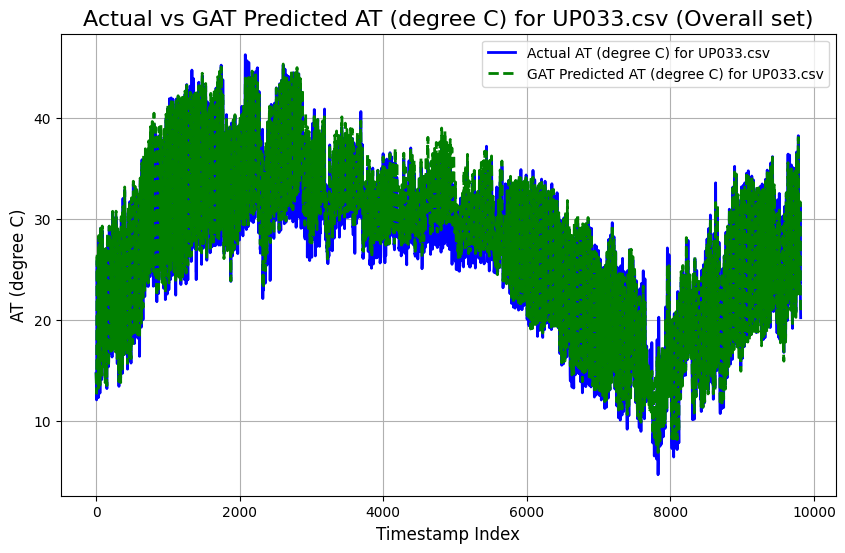

UP034.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.7611
Mean Squared Error (MSE): 7.1542
Root Mean Squared Error (RMSE): 2.6747
Pearson Correlation Coefficient: 0.9663
R-squared (R²): 0.9212

----------------------------------------



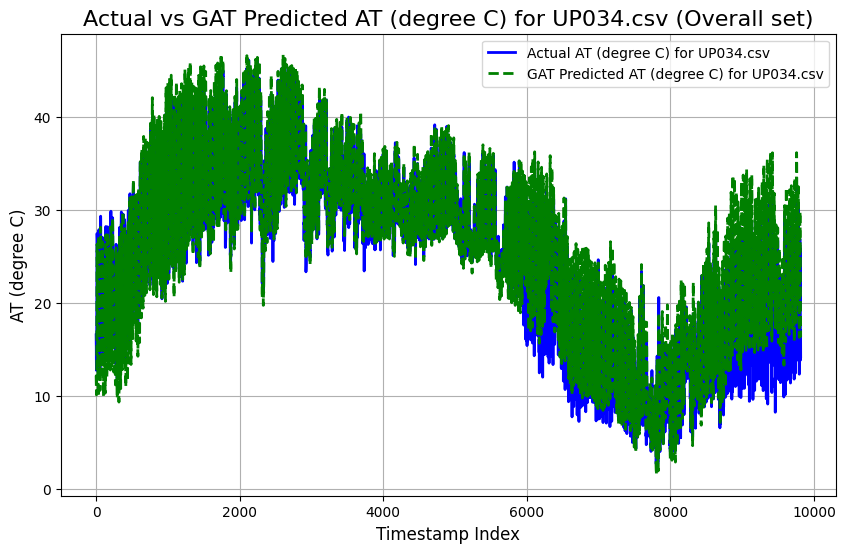

UP035.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.0113
Mean Squared Error (MSE): 1.7259
Root Mean Squared Error (RMSE): 1.3137
Pearson Correlation Coefficient: 0.9890
R-squared (R²): 0.9745

----------------------------------------



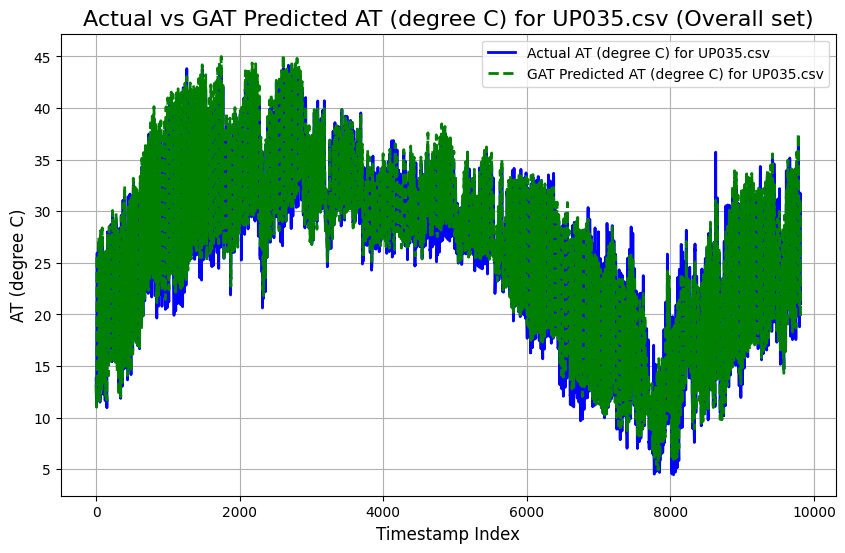

UP036.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.0421
Mean Squared Error (MSE): 1.9742
Root Mean Squared Error (RMSE): 1.4051
Pearson Correlation Coefficient: 0.9851
R-squared (R²): 0.9667

----------------------------------------



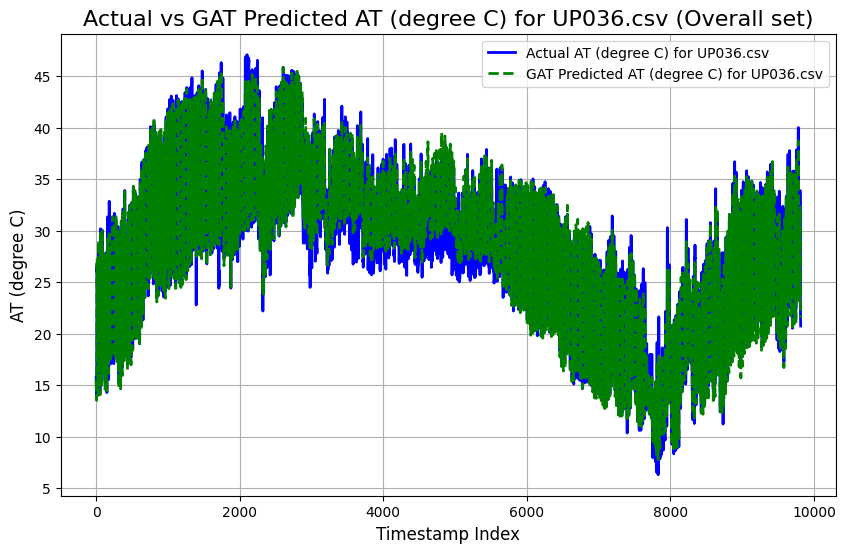

UP037.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.0871
Mean Squared Error (MSE): 1.9987
Root Mean Squared Error (RMSE): 1.4137
Pearson Correlation Coefficient: 0.9881
R-squared (R²): 0.9731

----------------------------------------



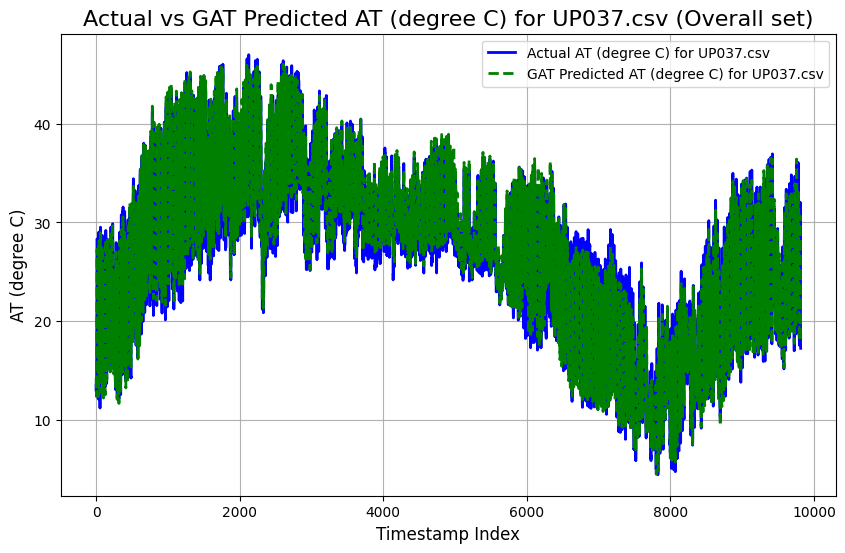

UP038.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 0.9665
Mean Squared Error (MSE): 1.7465
Root Mean Squared Error (RMSE): 1.3215
Pearson Correlation Coefficient: 0.9865
R-squared (R²): 0.9697

----------------------------------------



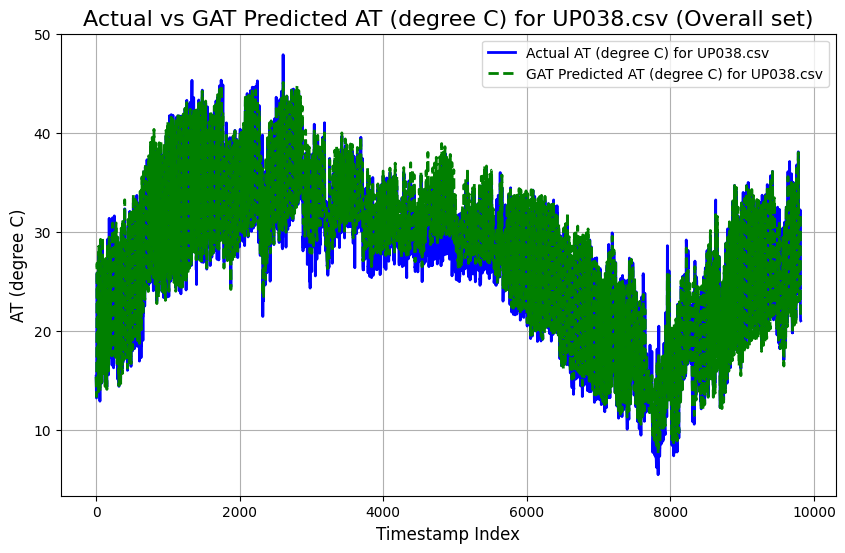

UP039.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.5453
Mean Squared Error (MSE): 3.9793
Root Mean Squared Error (RMSE): 1.9948
Pearson Correlation Coefficient: 0.9758
R-squared (R²): 0.9487

----------------------------------------



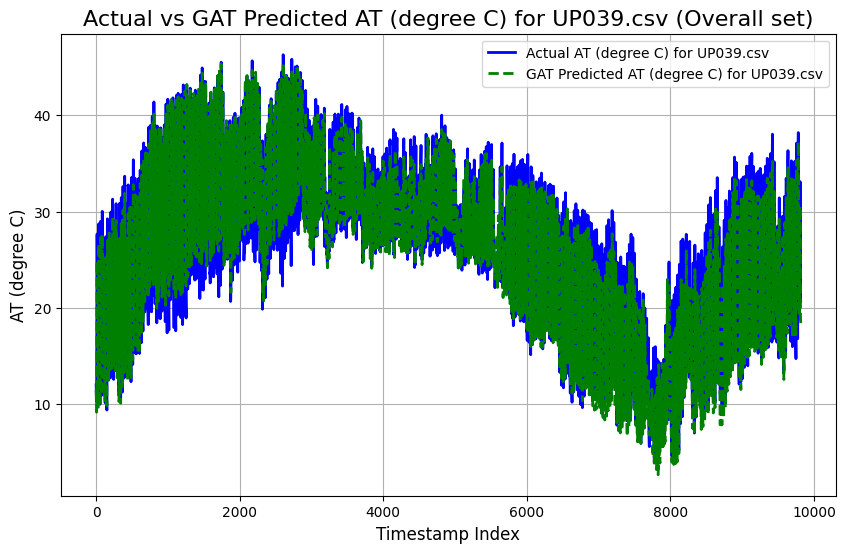

UP040.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.2910
Mean Squared Error (MSE): 2.7742
Root Mean Squared Error (RMSE): 1.6656
Pearson Correlation Coefficient: 0.9838
R-squared (R²): 0.9641

----------------------------------------



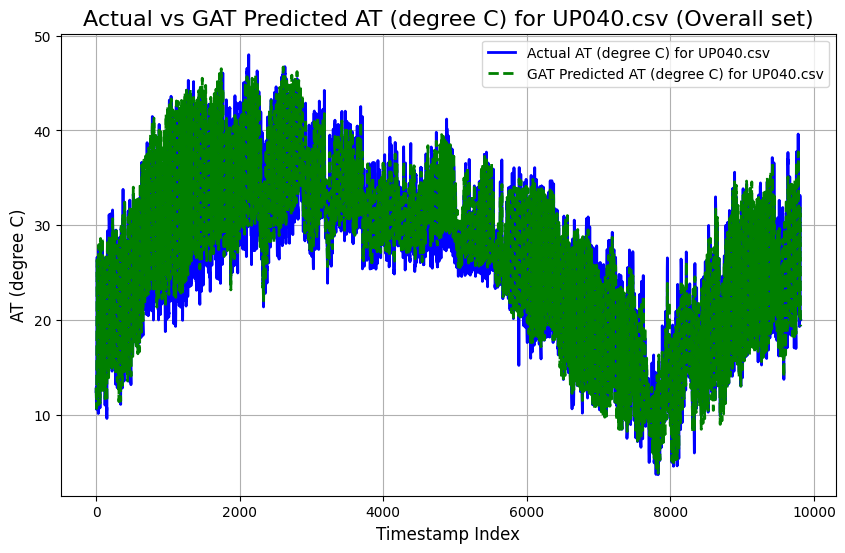

UP041.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 0.9942
Mean Squared Error (MSE): 1.7367
Root Mean Squared Error (RMSE): 1.3178
Pearson Correlation Coefficient: 0.9860
R-squared (R²): 0.9688

----------------------------------------



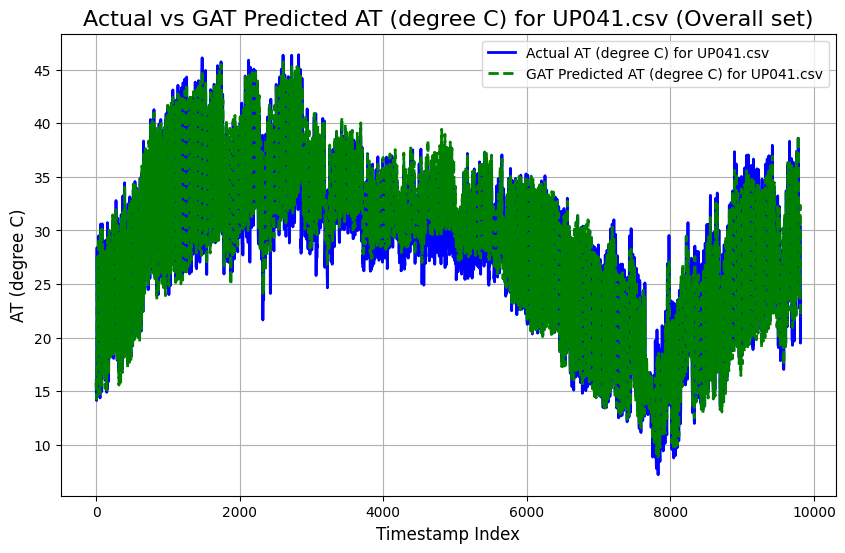

UP042.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.0640
Mean Squared Error (MSE): 2.2729
Root Mean Squared Error (RMSE): 1.5076
Pearson Correlation Coefficient: 0.9843
R-squared (R²): 0.9653

----------------------------------------



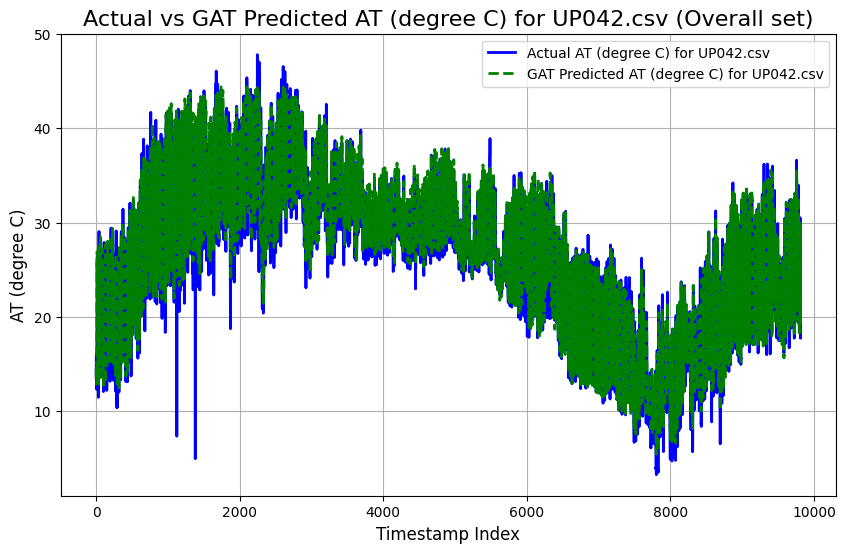

UP043.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.0541
Mean Squared Error (MSE): 2.0187
Root Mean Squared Error (RMSE): 1.4208
Pearson Correlation Coefficient: 0.9879
R-squared (R²): 0.9721

----------------------------------------



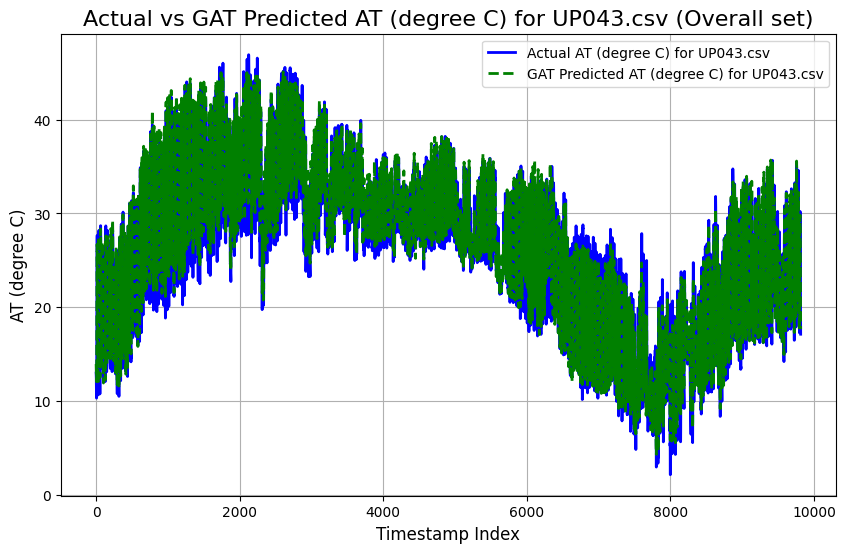

UP044.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.1004
Mean Squared Error (MSE): 2.0933
Root Mean Squared Error (RMSE): 1.4468
Pearson Correlation Coefficient: 0.9873
R-squared (R²): 0.9719

----------------------------------------



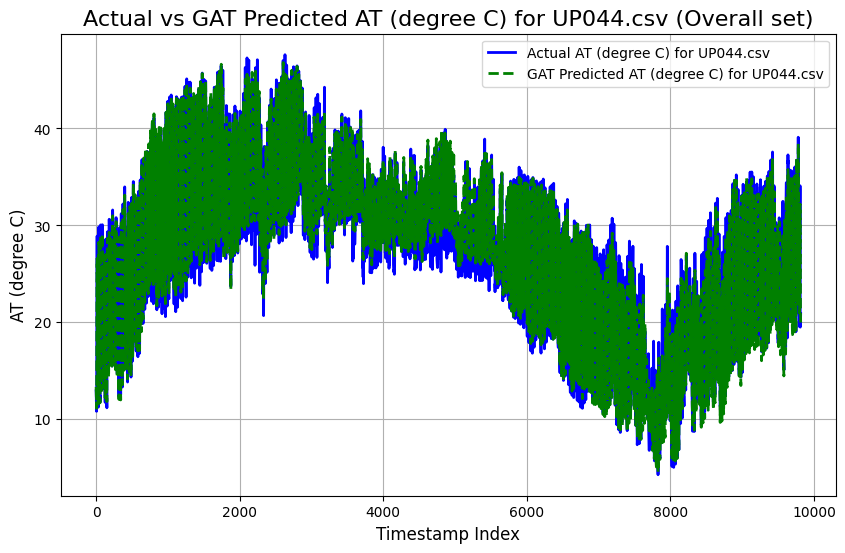

UP046.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.3701
Mean Squared Error (MSE): 2.9869
Root Mean Squared Error (RMSE): 1.7283
Pearson Correlation Coefficient: 0.9798
R-squared (R²): 0.9557

----------------------------------------



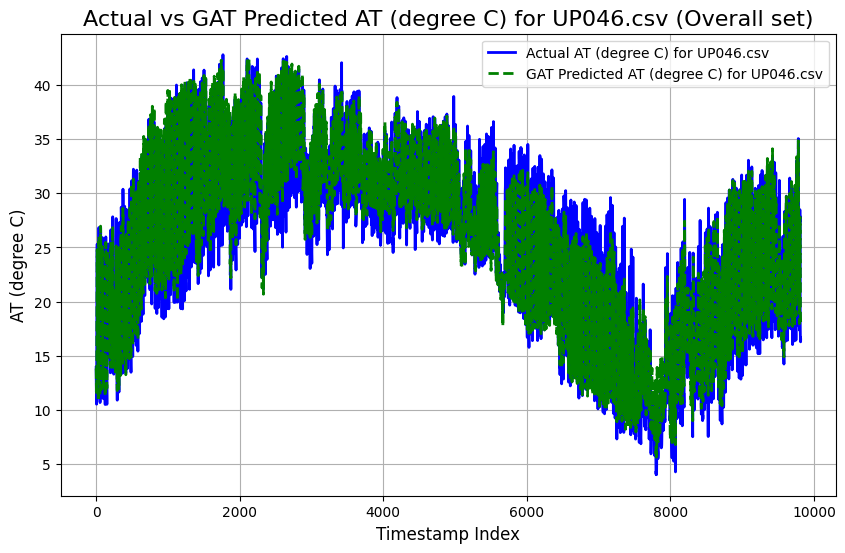

UP048.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.4958
Mean Squared Error (MSE): 3.7685
Root Mean Squared Error (RMSE): 1.9413
Pearson Correlation Coefficient: 0.9729
R-squared (R²): 0.9423

----------------------------------------



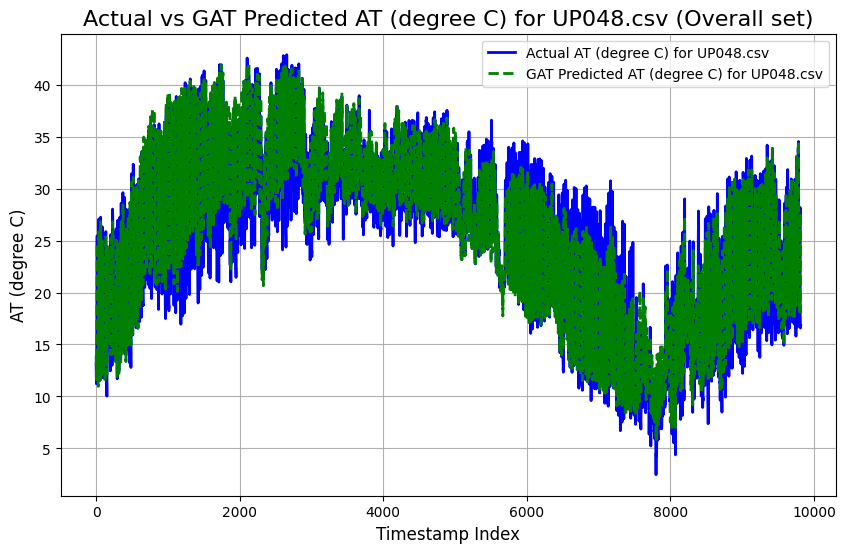

UP049.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.3116
Mean Squared Error (MSE): 2.9411
Root Mean Squared Error (RMSE): 1.7150
Pearson Correlation Coefficient: 0.9807
R-squared (R²): 0.9572

----------------------------------------



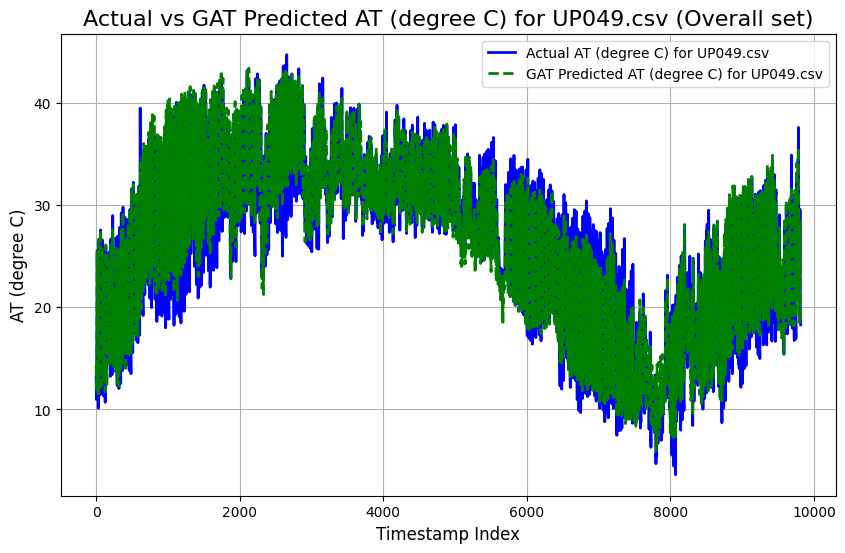

UP050.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.4483
Mean Squared Error (MSE): 3.9790
Root Mean Squared Error (RMSE): 1.9948
Pearson Correlation Coefficient: 0.9666
R-squared (R²): 0.9311

----------------------------------------



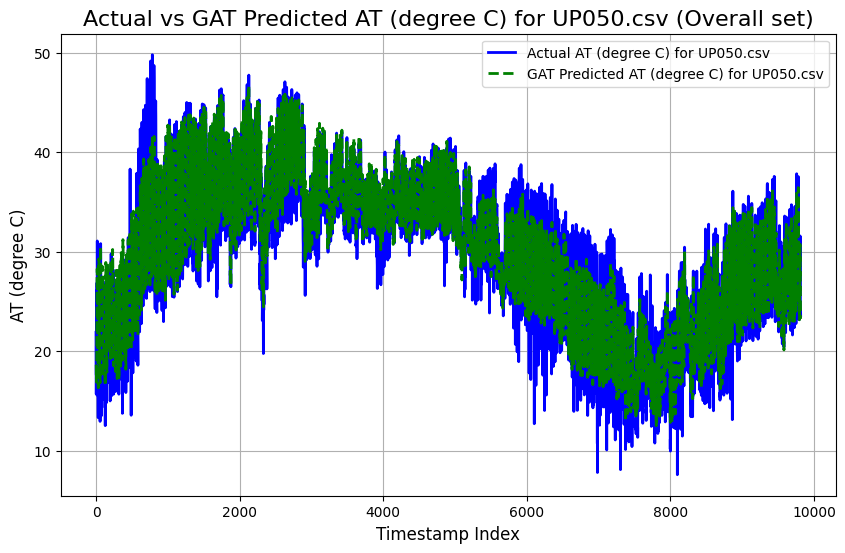

UP051.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 2.6713
Mean Squared Error (MSE): 24.4066
Root Mean Squared Error (RMSE): 4.9403
Pearson Correlation Coefficient: 0.8305
R-squared (R²): 0.6629

----------------------------------------



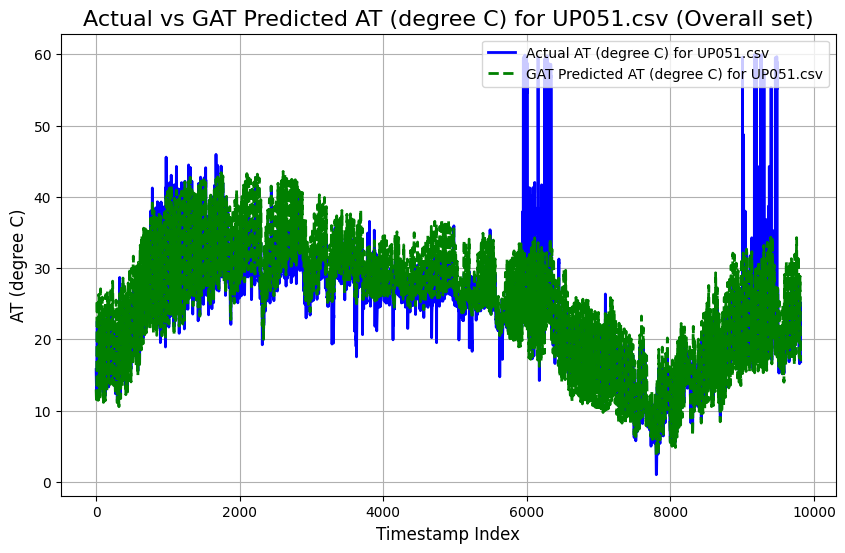

UP052.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.5445
Mean Squared Error (MSE): 4.0862
Root Mean Squared Error (RMSE): 2.0214
Pearson Correlation Coefficient: 0.9705
R-squared (R²): 0.9376

----------------------------------------



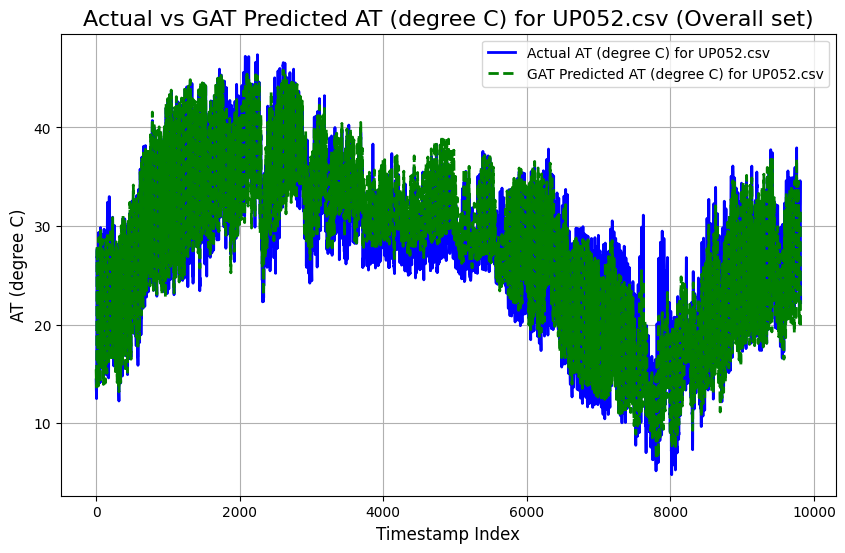

Overall GNN Imputed 1.csv
CSV file 'Overall GNN Imputed 1.csv' created successfully.
Shape of gat_outputs: (9816, 41)
Shape of actual_values: (9816, 41)


In [17]:

from torch.optim.lr_scheduler import StepLR
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from scipy.stats import pearsonr

# Define the GAT model
class GATModel(torch.nn.Module):
    def __init__(self, in_channels, out_channels):
        super(GATModel, self).__init__()
        self.conv1 = GATConv(in_channels, 8, heads=8, dropout=0.2)
        self.conv2 = GATConv(8 * 8, out_channels, heads=1, concat=False, dropout=0.2)
        
    def forward(self, data):
        x, edge_index = data.x, data.edge_index
        # First GAT layer followed by ELU activation
        x = self.conv1(x, edge_index)
        x = F.elu(x)
        # Dropout
        x = F.dropout(x, p=0.2, training=self.training)
        
        # Second GAT layer followed by ELU activation
        x = self.conv2(x, edge_index)
        return x

# Initialize the model and optimizer
in_channels = train_graph_data_list[0].x.size(-1)  # Number of input features (depends on the number of columns)
out_channels = 1  # Predicting a single value ('AT (degree C)')
model = GATModel(in_channels, out_channels)

optimizer = torch.optim.Adam(model.parameters(), lr=0.0005, weight_decay=5e-4)
loss_fn = torch.nn.MSELoss()

# StepLR: Reduces the learning rate by gamma every step_size epochs
scheduler = StepLR(optimizer, step_size=5, gamma=0.5)

# Train the GAT model on the training set
def train_gat(graph_data_list, epochs=30):
    model.train()
    for epoch in range(epochs):
        epoch_loss = 0
        for graph_data in graph_data_list:
            optimizer.zero_grad()
            out = model(graph_data)
            loss = loss_fn(out.squeeze(), graph_data.y)
            loss.backward()
            optimizer.step()
            epoch_loss += loss.item()
        scheduler.step()
        print(f"Epoch {epoch}, Loss: {epoch_loss/len(graph_data_list)}")

# Train the model using the training dataset
train_gat(train_graph_data_list)

# Evaluate the model on the training and testing sets
def evaluate_gat(graph_data_list):
    model.eval()
    gat_outputs = []
    actual_values = []
    with torch.no_grad():
        for graph_data in graph_data_list:
            gat_output = model(graph_data)
            gat_outputs.append(gat_output.squeeze().numpy())
            actual_values.append(graph_data.y.squeeze().numpy())
    return np.array(gat_outputs), np.array(actual_values)

# Get GAT predictions for training and testing sets
train_gat_outputs, train_actual_values = evaluate_gat(train_graph_data_list)
test_gat_outputs, test_actual_values = evaluate_gat(test_graph_data_list)

train_gnn_mae_list = []
train_gnn_mse_list = []
train_gnn_rmse_list = []
train_gnn_pearson_corr_list = []
train_gnn_r_squared_list = []

test_gnn_mae_list = []
test_gnn_mse_list = []
test_gnn_rmse_list = []
test_gnn_pearson_corr_list = []
test_gnn_r_squared_list = []

overall_gnn_mae_list = []
overall_gnn_mse_list = []
overall_gnn_rmse_list = []
overall_gnn_pearson_corr_list = []
overall_gnn_r_squared_list = []

# Apply inverse scaling and calculate performance metrics for training and testing sets
def inverse_scale_and_evaluate(gat_outputs, actual_values, set_type):
    gat_outputs_inverse_scaled = []
    actual_values_inverse_scaled = []
    for node_idx in range(gat_outputs.shape[1]):
        gat_node_values = gat_outputs[:, node_idx].reshape(-1, 1)
        actual_node_values = actual_values[:, node_idx].reshape(-1, 1)
        gat_node_inverse_scaled = scalers[input_files[node_idx]].inverse_transform(gat_node_values).flatten()
        actual_node_inverse_scaled = scalers[input_files[node_idx]].inverse_transform(actual_node_values).flatten()
        gat_outputs_inverse_scaled.append(gat_node_inverse_scaled)
        actual_values_inverse_scaled.append(actual_node_inverse_scaled)
    
    # Evaluate performance metrics for each node
    num_nodes = gat_outputs.shape[1]
    for node_idx in range(num_nodes):
        actual = actual_values_inverse_scaled[node_idx]
        predicted = gat_outputs_inverse_scaled[node_idx]
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        rmse = np.sqrt(mse)
        pearson_corr, _ = pearsonr(actual, predicted)
        r_squared = r2_score(actual, predicted)
        
        print(f"{input_files[node_idx]} ({set_type} set) Metrics:")
        print(f"Mean Absolute Error (MAE): {mae:.4f}")
        print(f"Mean Squared Error (MSE): {mse:.4f}")
        print(f"Root Mean Squared Error (RMSE): {rmse:.4f}")
        print(f"Pearson Correlation Coefficient: {pearson_corr:.4f}")
        print(f"R-squared (R²): {r_squared:.4f}")
        print("\n" + "-"*40 + "\n")

        if(set_type == 'Training'):
            train_gnn_mae_list.append(mae)
            train_gnn_mse_list.append(mse)
            train_gnn_rmse_list.append(rmse)
            train_gnn_pearson_corr_list.append(pearson_corr)
            train_gnn_r_squared_list.append(r_squared)

        if(set_type == 'Testing'):
            test_gnn_mae_list.append(mae)
            test_gnn_mse_list.append(mse)
            test_gnn_rmse_list.append(rmse)
            test_gnn_pearson_corr_list.append(pearson_corr)
            test_gnn_r_squared_list.append(r_squared)

        if(set_type == 'Overall'):
            overall_gnn_mae_list.append(mae)
            overall_gnn_mse_list.append(mse)
            overall_gnn_rmse_list.append(rmse)
            overall_gnn_pearson_corr_list.append(pearson_corr)
            overall_gnn_r_squared_list.append(r_squared)        
        
        # Plot actual vs predicted values for this node
        plt.figure(figsize=(10, 6))
        plt.plot(actual, label=f'Actual AT (degree C) for {input_files[node_idx]}', color='blue', linewidth=2)
        plt.plot(predicted, label=f'GAT Predicted AT (degree C) for {input_files[node_idx]}', color='green', linestyle='--', linewidth=2)
        plt.title(f'Actual vs GAT Predicted AT (degree C) for {input_files[node_idx]} ({set_type} set)', fontsize=16)
        plt.xlabel('Timestamp Index', fontsize=12)
        plt.ylabel('AT (degree C)', fontsize=12)
        plt.legend(loc='upper right')
        plt.grid(True)
        plt.show()

# Evaluate and plot for both training and testing sets
inverse_scale_and_evaluate(train_gat_outputs, train_actual_values, 'Training')
inverse_scale_and_evaluate(test_gat_outputs, test_actual_values, 'Testing')

def create_metrics_gnn_csv(file_name, input_files, mae_list, mse_list, rmse_list, r2_list, corr_list):
    metrics_df = pd.DataFrame({
        "File Name": input_files,
        "MAE": mae_list,
        "MSE": mse_list,
        "RMSE": rmse_list,
        "R2": r2_list,
        "CorrCoeff": corr_list
    })
    metrics_df.to_csv(file_name, index=False)
    print(f"CSV file '{file_name}' created successfully.")


# Create CSV for training set
file_name = "Train GNN Imputed 1.csv"
print(file_name)
create_metrics_gnn_csv(file_name, input_files, train_gnn_mae_list, train_gnn_mse_list, train_gnn_rmse_list, train_gnn_r_squared_list, train_gnn_pearson_corr_list)

# Create CSV for training set
file_name = "Test GNN Imputed 1.csv"
print(file_name)
create_metrics_gnn_csv(file_name, input_files, test_gnn_mae_list, test_gnn_mse_list, test_gnn_rmse_list, test_gnn_r_squared_list, test_gnn_pearson_corr_list)

# Concatenate training and testing outputs
gat_outputs = np.concatenate([train_gat_outputs, test_gat_outputs], axis=0)
actual_values = np.concatenate([train_actual_values, test_actual_values], axis=0)
inverse_scale_and_evaluate(gat_outputs, actual_values, 'Overall')

# Create CSV for overall set
file_name = "Overall GNN Imputed 1.csv"
print(file_name)
create_metrics_gnn_csv(file_name, input_files, overall_gnn_mae_list, overall_gnn_mse_list, overall_gnn_rmse_list, overall_gnn_r_squared_list, overall_gnn_pearson_corr_list)

# Print the shapes of gat_outputs and actual_values
print(f"Shape of gat_outputs: {gat_outputs.shape}")
print(f"Shape of actual_values: {actual_values.shape}")


# Showing the GAT outputs and actual outputs

In [18]:
gat_outputs_without_inverse_scaled = []
actual_values_without_inverse_scaled = []

for node_idx in range(gat_outputs.shape[1]):
    # Extract predictions and actual values for the current node across all timestamps
    gat_node_values = gat_outputs[:, node_idx].reshape(-1, 1)
    actual_node_values = actual_values[:, node_idx].reshape(-1, 1)
    
    # Append the inverse scaled values for this node
    gat_outputs_without_inverse_scaled.append(gat_node_values)
    actual_values_without_inverse_scaled.append(actual_node_values)

# Plot the actual vs predicted values for each node
num_nodes = gat_outputs.shape[1]
print(gat_outputs_without_inverse_scaled)
print(actual_values_without_inverse_scaled)


[array([[-1.550706 ],
       [-1.5895698],
       [-1.6320342],
       ...,
       [-0.697792 ],
       [-0.7444158],
       [-0.7752995]], dtype=float32), array([[-1.59102   ],
       [-1.6198877 ],
       [-1.6686502 ],
       ...,
       [-0.80364555],
       [-0.84624714],
       [-0.8290388 ]], dtype=float32), array([[-1.4411957 ],
       [-1.482774  ],
       [-1.5387628 ],
       ...,
       [-0.92269105],
       [-0.95527893],
       [-0.99907535]], dtype=float32), array([[-1.4415543],
       [-1.4742635],
       [-1.5441374],
       ...,
       [-0.8212115],
       [-0.8391429],
       [-0.8373559]], dtype=float32), array([[-1.4510722 ],
       [-1.4734284 ],
       [-1.5624441 ],
       ...,
       [-0.83904827],
       [-0.8623244 ],
       [-0.86555785]], dtype=float32), array([[-1.440439 ],
       [-1.4765788],
       [-1.544022 ],
       ...,
       [-0.8737374],
       [-0.899708 ],
       [-0.9202251]], dtype=float32), array([[-1.425285  ],
       [-1.4413058 ],
       

# Adding the GNN predicted values as a new column

In [19]:
train_gat_outputs_without_inverse_scaled = []
test_gat_outputs_without_inverse_scaled = []
train_size = train_dataframes[0].shape[0]

for node_idx in range(num_nodes):
    train1 = gat_outputs_without_inverse_scaled[node_idx][:train_size]
    test1 = gat_outputs_without_inverse_scaled[node_idx][train_size:]
    train_gat_outputs_without_inverse_scaled.append(train1)
    test_gat_outputs_without_inverse_scaled.append(test1)

# Add predicted values as a new column in each dataframe and print column and row details
for node_idx, df in enumerate(train_dataframes):
    # Extract the predicted values for the current node (inverse scaled)
    predicted_values = train_gat_outputs_without_inverse_scaled[node_idx].flatten()
    print(df.shape)
    print(len(predicted_values))

    # Add a new column for the predicted values
    df['Predicted AT (degree C)'] = predicted_values

    # Print column numbers and names
    print(f"DataFrame {node_idx + 1} - {input_files[node_idx]}: Columns")
    for col_idx, col_name in enumerate(df.columns):
        print(f"Column {col_idx + 1}: {col_name}")

    print(f"Row numbers total: {len(df)}")    

# Optionally print the first few rows to verify the predicted column was added correctly
    print(df.head(10))  # Display the first few rows of the dataframe for verification
    print("\n" + "="*60 + "\n")


# Add predicted values as a new column in each dataframe and print column and row details
for node_idx, df in enumerate(test_dataframes):
    # Extract the predicted values for the current node (inverse scaled)
    predicted_values = test_gat_outputs_without_inverse_scaled[node_idx].flatten()

    # Add a new column for the predicted values
    df['Predicted AT (degree C)'] = predicted_values

    # Print column numbers and names
    print(f"DataFrame {node_idx + 1} - {input_files[node_idx]}: Columns")
    for col_idx, col_name in enumerate(df.columns):
        print(f"Column {col_idx + 1}: {col_name}")

    print(f"Row numbers total: {len(df)}")    

# Optionally print the first few rows to verify the predicted column was added correctly
    print(df.head(10))  # Display the first few rows of the dataframe for verification
    print("\n" + "="*60 + "\n")


(8343, 15)
8343
DataFrame 1 - UP002.csv: Columns
Column 1: PM2.5 (ug/m3)
Column 2: PM10 (ug/m3)
Column 3: NO (ug/m3)
Column 4: NO2 (ug/m3)
Column 5: SO2 (ug/m3)
Column 6: CO (mg/m3)
Column 7: Ozone (ug/m3)
Column 8: RH (%)
Column 9: WS (m/s)
Column 10: WD (degree)
Column 11: AT (degree C)
Column 12: Year
Column 13: Month
Column 14: Day
Column 15: Hour
Column 16: Predicted AT (degree C)
Row numbers total: 8343
   PM2.5 (ug/m3)  PM10 (ug/m3)  NO (ug/m3)  NO2 (ug/m3)  SO2 (ug/m3)  \
0       0.026293      0.443649    0.117046     0.433734    -0.846243   
1       0.106304      0.344591    0.081311     0.343616    -0.313307   
2       0.078903      0.248329    0.201752     0.640199     0.095690   
3       0.086575      0.237278    0.102818     0.593795     0.157659   
4      -0.176474      0.093884    0.053185     0.202385     0.201038   
5      -0.087257      0.001749    0.093884     0.336890    -0.084021   
6      -0.172748     -0.006638    0.213995     0.894078    -0.112940   
7       0.0

C:\Users\Asus\AppData\Local\Temp\ipykernel_18636\1830292258.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_18636\1830292258.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_18636\1830292258.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,co

(8343, 15)
8343
DataFrame 18 - UP026.csv: Columns
Column 1: PM2.5 (ug/m3)
Column 2: PM10 (ug/m3)
Column 3: NO (ug/m3)
Column 4: NO2 (ug/m3)
Column 5: SO2 (ug/m3)
Column 6: CO (mg/m3)
Column 7: Ozone (ug/m3)
Column 8: RH (%)
Column 9: WS (m/s)
Column 10: WD (degree)
Column 11: AT (degree C)
Column 12: Year
Column 13: Month
Column 14: Day
Column 15: Hour
Column 16: Predicted AT (degree C)
Row numbers total: 8343
   PM2.5 (ug/m3)  PM10 (ug/m3)  NO (ug/m3)  NO2 (ug/m3)  SO2 (ug/m3)  \
0       2.451056      2.600436   12.586393     2.979432    -0.131780   
1       2.296283      1.696668    4.009088     2.360831    -0.275913   
2       2.103862      1.246999    0.282997     1.047089    -0.269714   
3       2.605829      1.340034    0.147618     1.304185     0.175861   
4       3.162175      1.915965    0.123067     1.109891    -0.155802   
5       2.735503      1.481802    0.607768     1.086340    -0.326282   
6       3.266751      1.816284    3.071253     1.372090    -0.337131   
7       3.

C:\Users\Asus\AppData\Local\Temp\ipykernel_18636\1830292258.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_18636\1830292258.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_18636\1830292258.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,co

      PM2.5 (ug/m3)  PM10 (ug/m3)  NO (ug/m3)  NO2 (ug/m3)  SO2 (ug/m3)  \
8343      -0.516880     -0.468270   -0.083637    -0.633683    -1.138690   
8344      -0.689063     -0.383696   -0.084575    -0.635231    -1.061792   
8345      -0.727001     -0.182534   -0.084575    -0.642968    -1.046063   
8346      -0.481130      0.314238   -0.089265    -0.632136    -1.044316   
8347      -0.316608      0.269801   -0.099585    -0.633683    -1.075774   
8348       0.856207      2.649022   -0.093956    -0.632909    -1.147428   
8349       1.166282      2.525107   -0.092080    -0.637552    -1.161409   
8350       1.113387      1.832270   -0.091142    -0.627493    -1.161409   
8351       0.611065      1.531881   -0.086451    -0.642968    -1.142185   
8352       0.392188      1.139591   -0.084575    -0.638326    -1.060045   

      CO (mg/m3)  Ozone (ug/m3)    RH (%)  WS (m/s)  WD (degree)  \
8343   -0.440818      -0.559297 -1.115235 -0.500593     0.459304   
8344   -0.472151      -0.702944 -0.843

C:\Users\Asus\AppData\Local\Temp\ipykernel_18636\1830292258.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_18636\1830292258.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_18636\1830292258.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,co

# Creating feature and target lists

In [20]:
# Initialize lists to store features and target for each dataframe
train_features_list = []
train_target_list = []

test_features_list = []
test_target_list = []

# Iterate over each dataframe to separate features and target
for node_idx, (df1, df2) in enumerate(zip(train_dataframes, test_dataframes)):
    # Features include all columns except 'AT (degree C)'
    trainfeatures1 = df1.drop(columns=['AT (degree C)'])
    testfeatures1 = df2.drop(columns=['AT (degree C)'])
    
    # Target is the 'AT (degree C)' column
    traintarget1 = df1['AT (degree C)']
    testtarget1 = df2['AT (degree C)']
    
    # Append the features and target to the respective lists
    train_features_list.append(trainfeatures1)
    train_target_list.append(traintarget1)
    test_features_list.append(testfeatures1)
    test_target_list.append(testtarget1)
    
    # Print the columns of features and target, and number of rows
    print(f"DataFrame {node_idx + 1} - {input_files[node_idx]}:")
    print(f"Features columns: {len(trainfeatures1.columns)}")
    print(trainfeatures1.columns)
    
    print("\nTarget column:")
    print(traintarget1.name)
    
    print(f"\nNumber of rows in training features: {trainfeatures1.shape[0]}")
    print(f"Number of rows in training target: {traintarget1.shape[0]}")
    print(f"\nNumber of rows in testing features: {testfeatures1.shape[0]}")
    print(f"Number of rows in testing target: {testtarget1.shape[0]}")
    print("\n" + "="*60 + "\n")

DataFrame 1 - UP002.csv:
Features columns: 15
Index(['PM2.5 (ug/m3)', 'PM10 (ug/m3)', 'NO (ug/m3)', 'NO2 (ug/m3)',
       'SO2 (ug/m3)', 'CO (mg/m3)', 'Ozone (ug/m3)', 'RH (%)', 'WS (m/s)',
       'WD (degree)', 'Year', 'Month', 'Day', 'Hour',
       'Predicted AT (degree C)'],
      dtype='object')

Target column:
AT (degree C)

Number of rows in training features: 8343
Number of rows in training target: 8343

Number of rows in testing features: 1473
Number of rows in testing target: 1473


DataFrame 2 - UP003.csv:
Features columns: 15
Index(['PM2.5 (ug/m3)', 'PM10 (ug/m3)', 'NO (ug/m3)', 'NO2 (ug/m3)',
       'SO2 (ug/m3)', 'CO (mg/m3)', 'Ozone (ug/m3)', 'RH (%)', 'WS (m/s)',
       'WD (degree)', 'Year', 'Month', 'Day', 'Hour',
       'Predicted AT (degree C)'],
      dtype='object')

Target column:
AT (degree C)

Number of rows in training features: 8343
Number of rows in training target: 8343

Number of rows in testing features: 1473
Number of rows in testing target: 1473


DataFr

# Transformer Model Implementation

C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\transformer.py:307: UserWarning: enable_nested_tensor is True, but self.use_nested_tensor is False because encoder_layer.self_attn.batch_first was not True(use batch_first for better inference performance)
  warnings.warn(f"enable_nested_tensor is True, but self.use_nested_tensor is False because {why_not_sparsity_fast_path}")


For Batch Size= 3 and Sequence Length = 3
Processing node 1...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.1169
Epoch [2/50], Train Loss: 0.0880
Epoch [3/50], Train Loss: 0.0818
Epoch [4/50], Train Loss: 0.0777
Epoch [5/50], Train Loss: 0.0699
Epoch [6/50], Train Loss: 0.0651
Epoch [7/50], Train Loss: 0.0653
Epoch [8/50], Train Loss: 0.0617
Epoch [9/50], Train Loss: 0.0601
Epoch [10/50], Train Loss: 0.0584
Epoch [11/50], Train Loss: 0.0581
Epoch [12/50], Train Loss: 0.0570
Epoch [13/50], Train Loss: 0.0582
Epoch [14/50], Train Loss: 0.0572
Epoch [15/50], Train Loss: 0.0565
Epoch [16/50], Train Loss: 0.0560
Epoch [17/50], Train Loss: 0.0556
Epoch [18/50], Train Loss: 0.0576
Epoch [19/50], Train Loss: 0.0545
Epoch [20/50], Train Loss: 0.0557
Epoch [21/50], Train Loss: 0.0543
Epoch [22/50], Train Loss: 0.0548
Epoch [23/50], Train Loss: 0.0541
Epoch [24/50], Train Loss: 0.0549
Epoch [25/50], Train Loss: 0.0536
Epoch [26/50], Train Loss: 0.0530
Epoch [27/50], Train Loss: 0.0533
Epoch [28/50], Train Loss: 0.0525
Epoch [29/50], Train Loss: 0.0519
Epoch [30/50], Train Lo

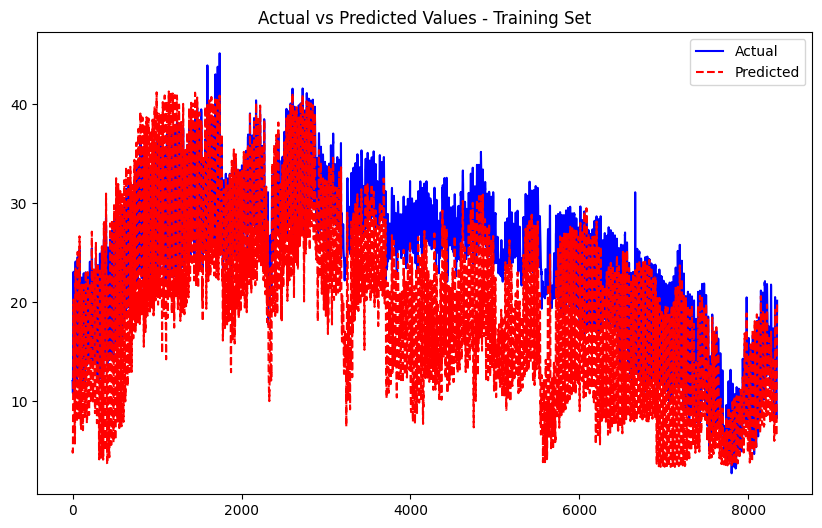

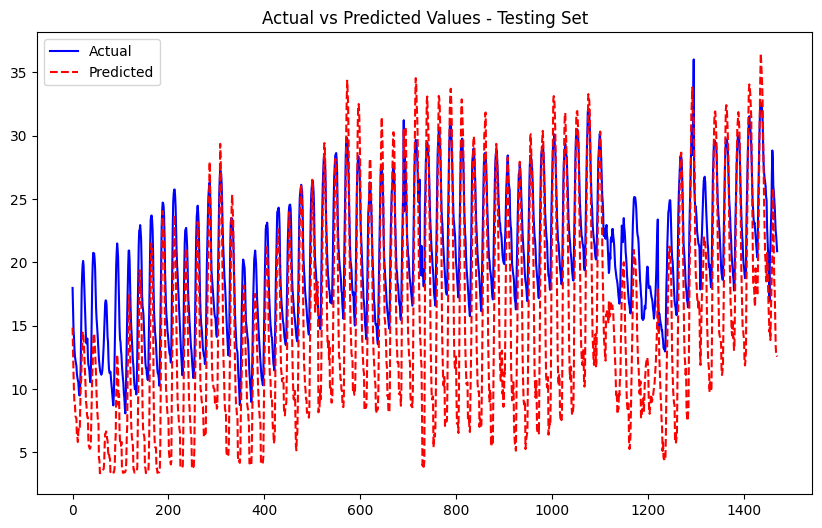

Processing node 2...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0511
Epoch [2/50], Train Loss: 0.0500
Epoch [3/50], Train Loss: 0.0556
Epoch [4/50], Train Loss: 0.0528
Epoch [5/50], Train Loss: 0.0487
Epoch [6/50], Train Loss: 0.0548
Epoch [7/50], Train Loss: 0.0530
Epoch [8/50], Train Loss: 0.0496
Epoch [9/50], Train Loss: 0.0516
Epoch [10/50], Train Loss: 0.0493
Epoch [11/50], Train Loss: 0.0464
Epoch [12/50], Train Loss: 0.0470
Epoch [13/50], Train Loss: 0.0475
Epoch [14/50], Train Loss: 0.0465
Epoch [15/50], Train Loss: 0.0458
Epoch [16/50], Train Loss: 0.0457
Epoch [17/50], Train Loss: 0.0466
Epoch [18/50], Train Loss: 0.0457
Epoch [19/50], Train Loss: 0.0458
Epoch [20/50], Train Loss: 0.0466
Epoch [21/50], Train Loss: 0.0450
Epoch [22/50], Train Loss: 0.0459
Epoch [23/50], Train Loss: 0.0461
Epoch [24/50], Train Loss: 0.0462
Epoch [25/50], Train Loss: 0.0458
Epoch [26/50], Train Loss: 0.0452
Epoch [27/50], Train Loss: 0.0456
Epoch [28/50], Train Loss: 0.0450
Epoch [29/50], Train Loss: 0.0452
Epoch [30/50], Train Lo

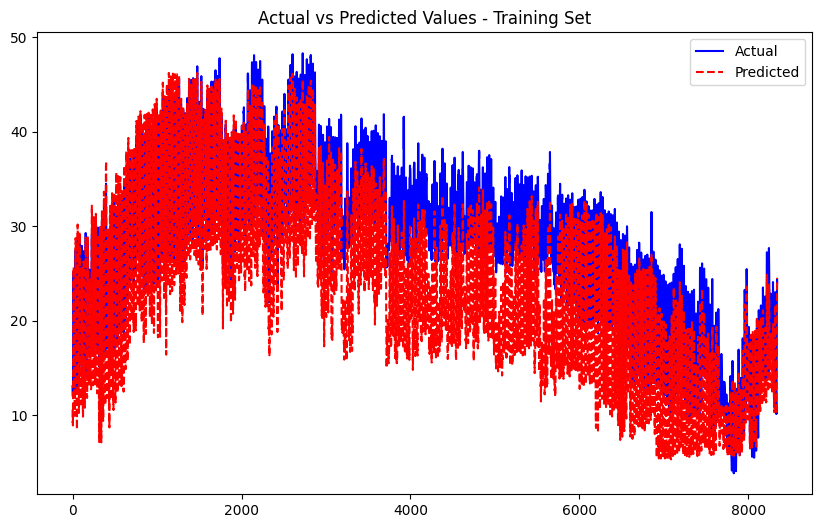

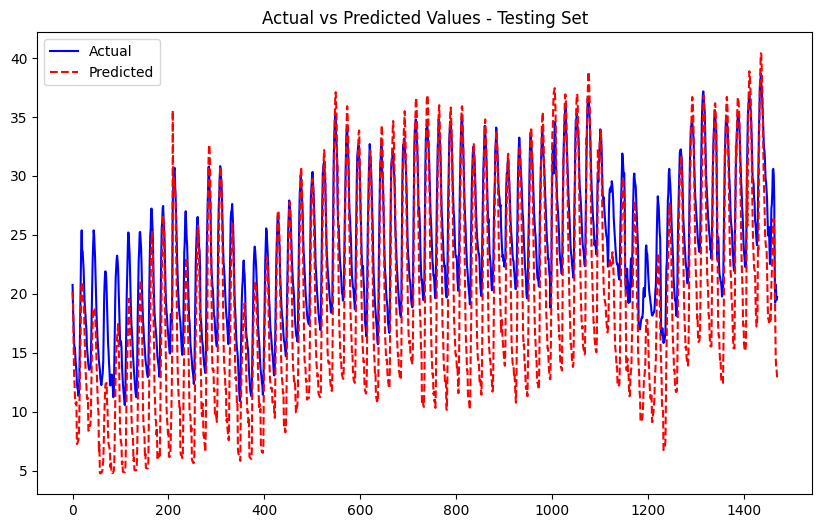

Processing node 3...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0405
Epoch [2/50], Train Loss: 0.0405
Epoch [3/50], Train Loss: 0.0396
Epoch [4/50], Train Loss: 0.0381
Epoch [5/50], Train Loss: 0.0388
Epoch [6/50], Train Loss: 0.0390
Epoch [7/50], Train Loss: 0.0380
Epoch [8/50], Train Loss: 0.0387
Epoch [9/50], Train Loss: 0.0380
Epoch [10/50], Train Loss: 0.0376
Epoch [11/50], Train Loss: 0.0384
Epoch [12/50], Train Loss: 0.0388
Epoch [13/50], Train Loss: 0.0383
Epoch [14/50], Train Loss: 0.0382
Epoch [15/50], Train Loss: 0.0382
Epoch [16/50], Train Loss: 0.0380
Epoch [17/50], Train Loss: 0.0399
Epoch [18/50], Train Loss: 0.0402
Epoch [19/50], Train Loss: 0.0383
Epoch [20/50], Train Loss: 0.0380
Epoch [21/50], Train Loss: 0.0402
Epoch [22/50], Train Loss: 0.0377
Epoch [23/50], Train Loss: 0.0384
Epoch [24/50], Train Loss: 0.0422
Epoch [25/50], Train Loss: 0.0389
Epoch [26/50], Train Loss: 0.0377
Epoch [27/50], Train Loss: 0.0373
Epoch [28/50], Train Loss: 0.0380
Epoch [29/50], Train Loss: 0.0381
Epoch [30/50], Train Lo

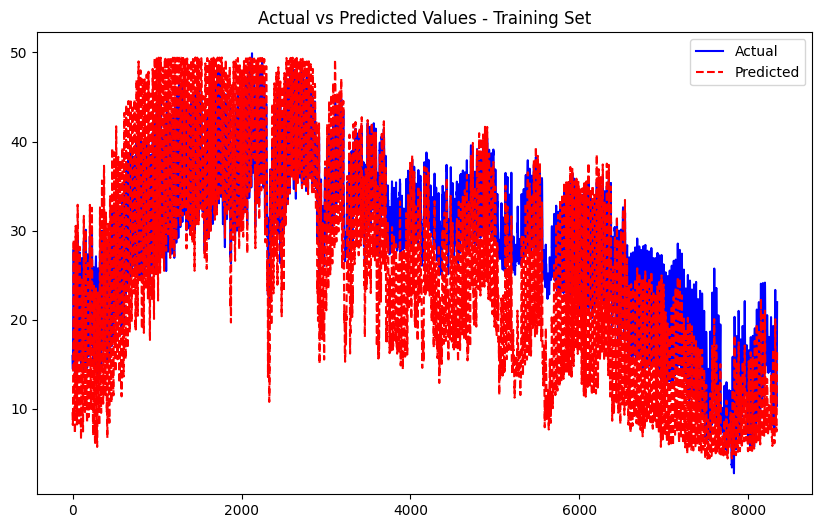

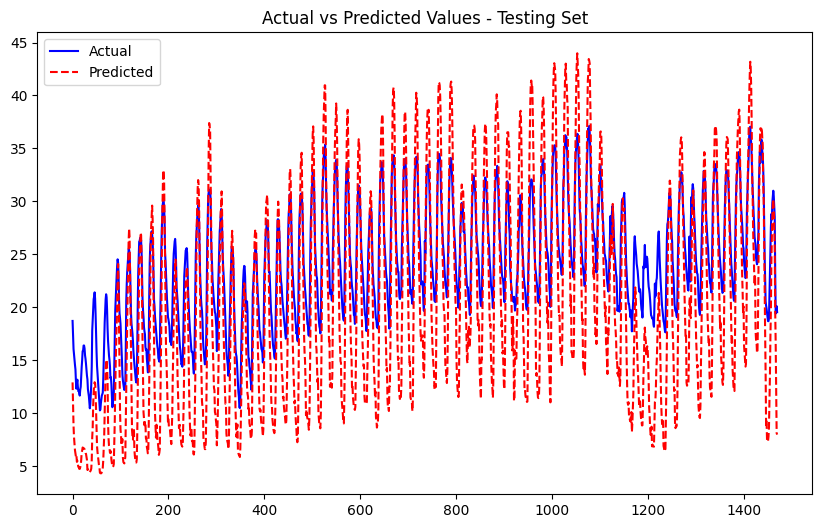

Processing node 4...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.2120
Epoch [2/50], Train Loss: 0.2167
Epoch [3/50], Train Loss: 0.2160
Epoch [4/50], Train Loss: 0.2202
Epoch [5/50], Train Loss: 0.2145
Epoch [6/50], Train Loss: 0.2211
Epoch [7/50], Train Loss: 0.2123
Epoch [8/50], Train Loss: 0.2122
Epoch [9/50], Train Loss: 0.2148
Epoch [10/50], Train Loss: 0.2094
Epoch [11/50], Train Loss: 0.2061
Epoch [12/50], Train Loss: 0.2038
Epoch [13/50], Train Loss: 0.1948
Epoch [14/50], Train Loss: 0.1996
Epoch [15/50], Train Loss: 0.2043
Epoch [16/50], Train Loss: 0.2032
Epoch [17/50], Train Loss: 0.2037
Epoch [18/50], Train Loss: 0.2114
Epoch [19/50], Train Loss: 0.2162
Epoch [20/50], Train Loss: 0.2106
Epoch [21/50], Train Loss: 0.2161
Epoch [22/50], Train Loss: 0.1971
Epoch [23/50], Train Loss: 0.2064
Epoch [24/50], Train Loss: 0.2067
Epoch [25/50], Train Loss: 0.2087
Epoch [26/50], Train Loss: 0.2047
Epoch [27/50], Train Loss: 0.2107
Epoch [28/50], Train Loss: 0.2012
Epoch [29/50], Train Loss: 0.2040
Epoch [30/50], Train Lo

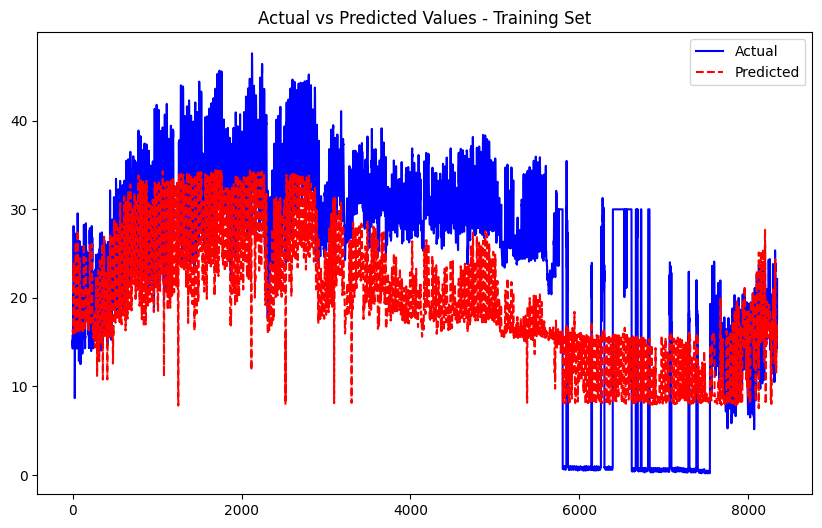

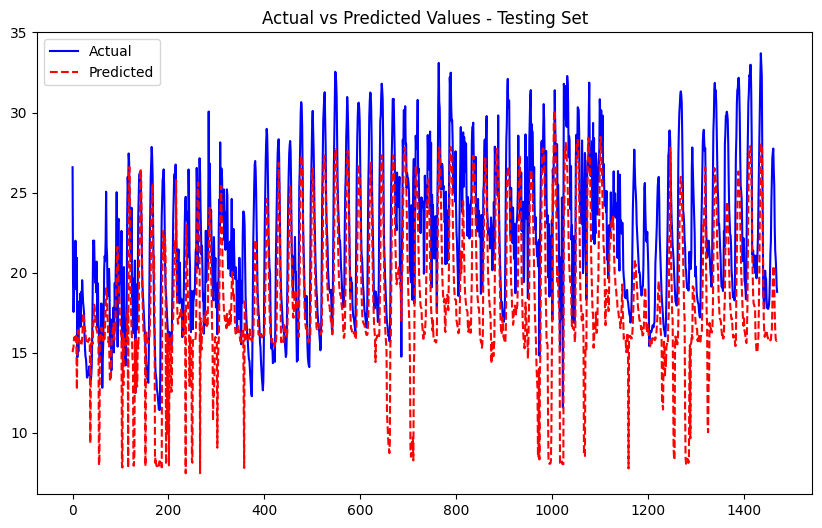

Processing node 5...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0782
Epoch [2/50], Train Loss: 0.0575
Epoch [3/50], Train Loss: 0.0529
Epoch [4/50], Train Loss: 0.0507
Epoch [5/50], Train Loss: 0.0488
Epoch [6/50], Train Loss: 0.0474
Epoch [7/50], Train Loss: 0.0462
Epoch [8/50], Train Loss: 0.0457
Epoch [9/50], Train Loss: 0.0461
Epoch [10/50], Train Loss: 0.0441
Epoch [11/50], Train Loss: 0.0438
Epoch [12/50], Train Loss: 0.0449
Epoch [13/50], Train Loss: 0.0441
Epoch [14/50], Train Loss: 0.0413
Epoch [15/50], Train Loss: 0.0421
Epoch [16/50], Train Loss: 0.0412
Epoch [17/50], Train Loss: 0.0421
Epoch [18/50], Train Loss: 0.0417
Epoch [19/50], Train Loss: 0.0401
Epoch [20/50], Train Loss: 0.0406
Epoch [21/50], Train Loss: 0.0406
Epoch [22/50], Train Loss: 0.0409
Epoch [23/50], Train Loss: 0.0401
Epoch [24/50], Train Loss: 0.0403
Epoch [25/50], Train Loss: 0.0401
Epoch [26/50], Train Loss: 0.0398
Epoch [27/50], Train Loss: 0.0395
Epoch [28/50], Train Loss: 0.0393
Epoch [29/50], Train Loss: 0.0398
Epoch [30/50], Train Lo

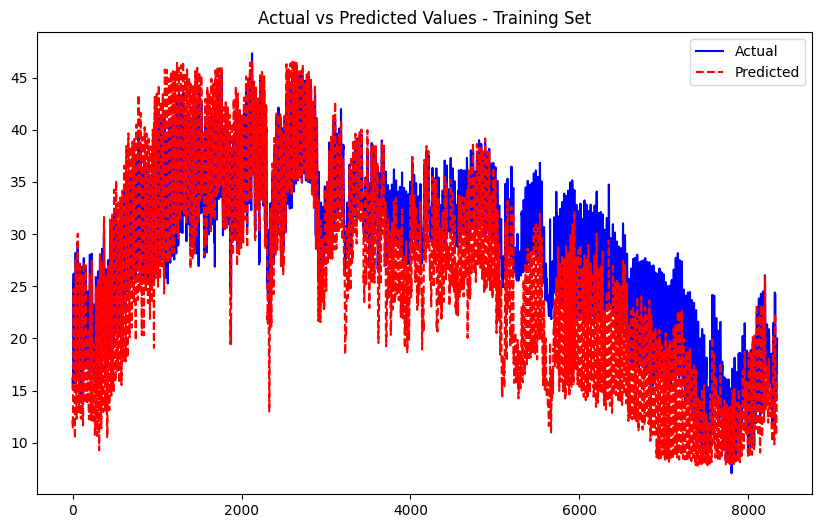

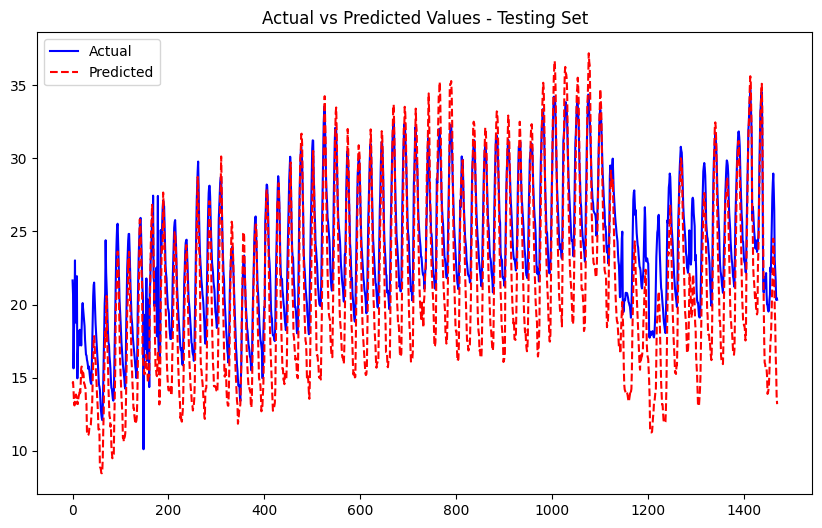

Processing node 6...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0617
Epoch [2/50], Train Loss: 0.0602
Epoch [3/50], Train Loss: 0.0593
Epoch [4/50], Train Loss: 0.0582
Epoch [5/50], Train Loss: 0.0567
Epoch [6/50], Train Loss: 0.0593
Epoch [7/50], Train Loss: 0.0585
Epoch [8/50], Train Loss: 0.0610
Epoch [9/50], Train Loss: 0.0600
Epoch [10/50], Train Loss: 0.0587
Epoch [11/50], Train Loss: 0.0578
Epoch [12/50], Train Loss: 0.0574
Epoch [13/50], Train Loss: 0.0568
Epoch [14/50], Train Loss: 0.0575
Epoch [15/50], Train Loss: 0.0564
Epoch [16/50], Train Loss: 0.0571
Epoch [17/50], Train Loss: 0.0559
Epoch [18/50], Train Loss: 0.0553
Epoch [19/50], Train Loss: 0.0561
Epoch [20/50], Train Loss: 0.0555
Epoch [21/50], Train Loss: 0.0568
Epoch [22/50], Train Loss: 0.0546
Epoch [23/50], Train Loss: 0.0551
Epoch [24/50], Train Loss: 0.0545
Epoch [25/50], Train Loss: 0.0539
Epoch [26/50], Train Loss: 0.0543
Epoch [27/50], Train Loss: 0.0550
Epoch [28/50], Train Loss: 0.0543
Epoch [29/50], Train Loss: 0.0554
Epoch [30/50], Train Lo

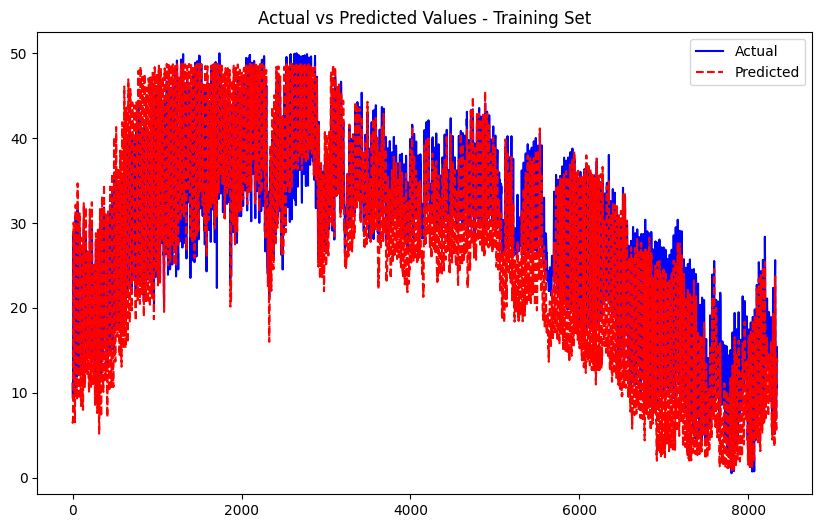

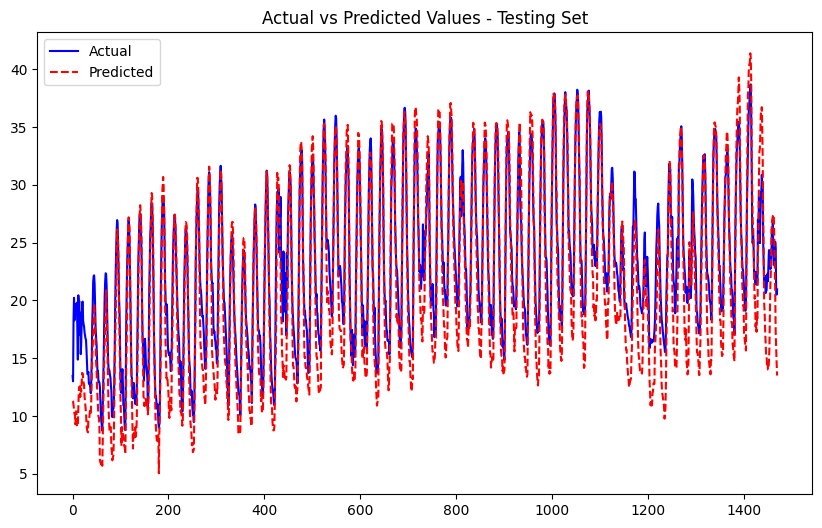

Processing node 7...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0583
Epoch [2/50], Train Loss: 0.0579
Epoch [3/50], Train Loss: 0.0564
Epoch [4/50], Train Loss: 0.0556
Epoch [5/50], Train Loss: 0.0546
Epoch [6/50], Train Loss: 0.0547
Epoch [7/50], Train Loss: 0.0544
Epoch [8/50], Train Loss: 0.0537
Epoch [9/50], Train Loss: 0.0544
Epoch [10/50], Train Loss: 0.0534
Epoch [11/50], Train Loss: 0.0532
Epoch [12/50], Train Loss: 0.0536
Epoch [13/50], Train Loss: 0.0539
Epoch [14/50], Train Loss: 0.0529
Epoch [15/50], Train Loss: 0.0528
Epoch [16/50], Train Loss: 0.0535
Epoch [17/50], Train Loss: 0.0532
Epoch [18/50], Train Loss: 0.0532
Epoch [19/50], Train Loss: 0.0529
Epoch [20/50], Train Loss: 0.0531
Epoch [21/50], Train Loss: 0.0533
Epoch [22/50], Train Loss: 0.0520
Epoch [23/50], Train Loss: 0.0524
Epoch [24/50], Train Loss: 0.0519
Epoch [25/50], Train Loss: 0.0525
Epoch [26/50], Train Loss: 0.0527
Epoch [27/50], Train Loss: 0.0528
Epoch [28/50], Train Loss: 0.0530
Epoch [29/50], Train Loss: 0.0525
Epoch [30/50], Train Lo

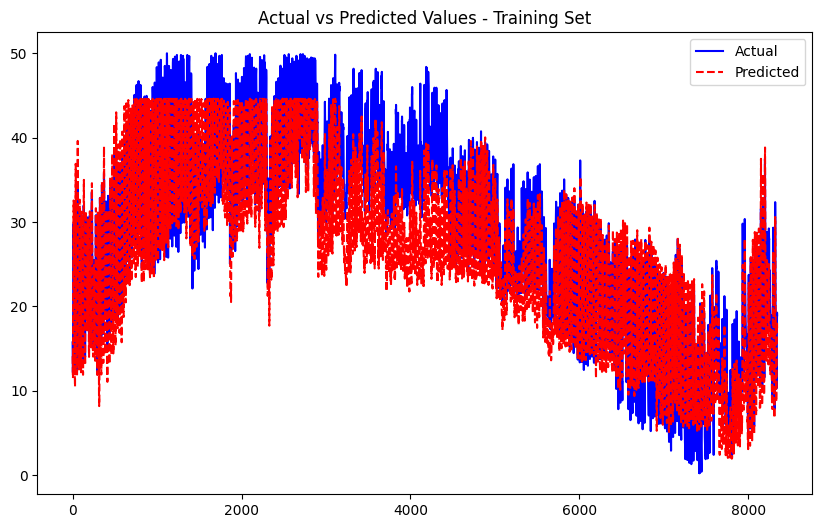

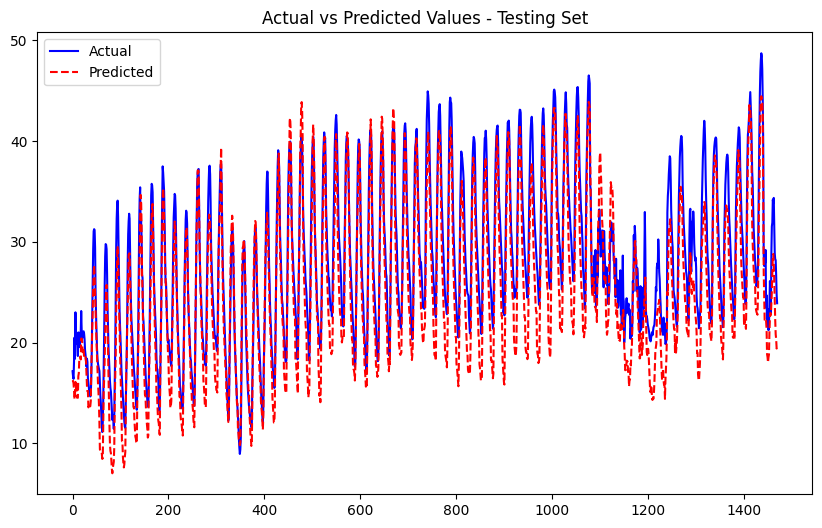

Processing node 8...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0655
Epoch [2/50], Train Loss: 0.0634
Epoch [3/50], Train Loss: 0.0620
Epoch [4/50], Train Loss: 0.0603
Epoch [5/50], Train Loss: 0.0612
Epoch [6/50], Train Loss: 0.0601
Epoch [7/50], Train Loss: 0.0592
Epoch [8/50], Train Loss: 0.0602
Epoch [9/50], Train Loss: 0.0596
Epoch [10/50], Train Loss: 0.0598
Epoch [11/50], Train Loss: 0.0594
Epoch [12/50], Train Loss: 0.0597
Epoch [13/50], Train Loss: 0.0603
Epoch [14/50], Train Loss: 0.0593
Epoch [15/50], Train Loss: 0.0587
Epoch [16/50], Train Loss: 0.0595
Epoch [17/50], Train Loss: 0.0592
Epoch [18/50], Train Loss: 0.0582
Epoch [19/50], Train Loss: 0.0586
Epoch [20/50], Train Loss: 0.0586
Epoch [21/50], Train Loss: 0.0596
Epoch [22/50], Train Loss: 0.0587
Epoch [23/50], Train Loss: 0.0586
Epoch [24/50], Train Loss: 0.0579
Epoch [25/50], Train Loss: 0.0588
Epoch [26/50], Train Loss: 0.0580
Epoch [27/50], Train Loss: 0.0586
Epoch [28/50], Train Loss: 0.0578
Epoch [29/50], Train Loss: 0.0587
Epoch [30/50], Train Lo

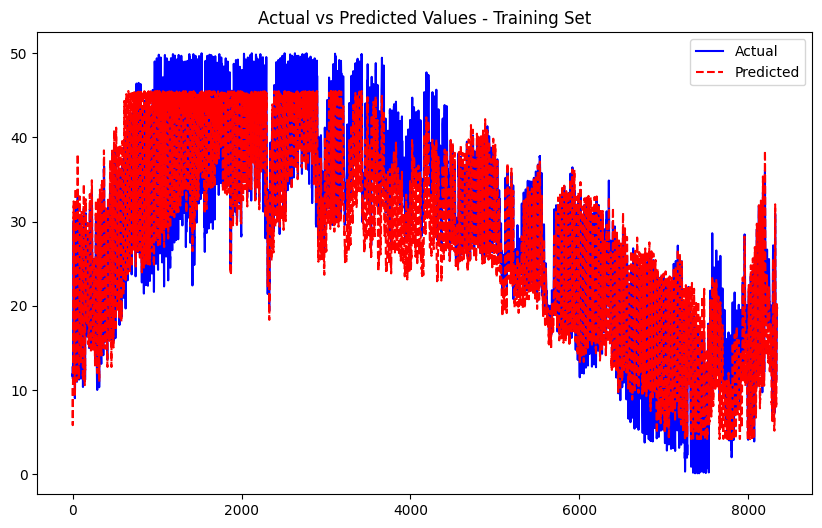

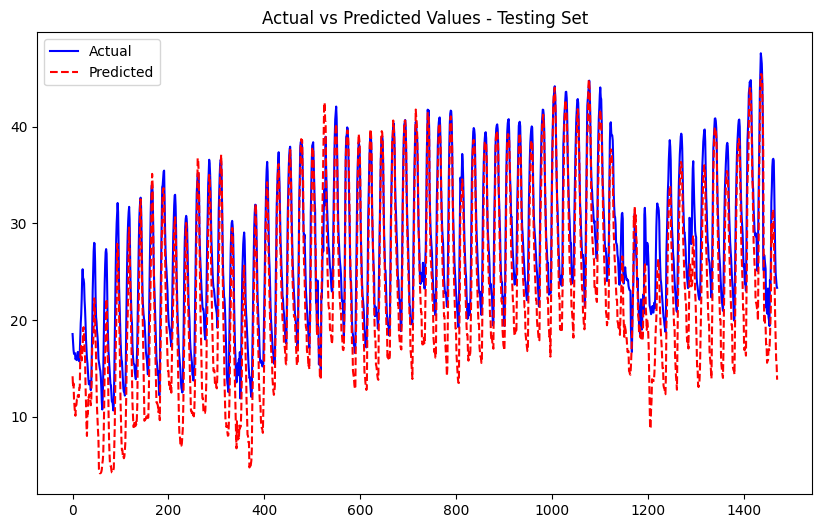

Processing node 9...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0503
Epoch [2/50], Train Loss: 0.0476
Epoch [3/50], Train Loss: 0.0475
Epoch [4/50], Train Loss: 0.0472
Epoch [5/50], Train Loss: 0.0468
Epoch [6/50], Train Loss: 0.0465
Epoch [7/50], Train Loss: 0.0454
Epoch [8/50], Train Loss: 0.0452
Epoch [9/50], Train Loss: 0.0452
Epoch [10/50], Train Loss: 0.0445
Epoch [11/50], Train Loss: 0.0441
Epoch [12/50], Train Loss: 0.0441
Epoch [13/50], Train Loss: 0.0442
Epoch [14/50], Train Loss: 0.0437
Epoch [15/50], Train Loss: 0.0439
Epoch [16/50], Train Loss: 0.0439
Epoch [17/50], Train Loss: 0.0437
Epoch [18/50], Train Loss: 0.0442
Epoch [19/50], Train Loss: 0.0432
Epoch [20/50], Train Loss: 0.0434
Epoch [21/50], Train Loss: 0.0426
Epoch [22/50], Train Loss: 0.0439
Epoch [23/50], Train Loss: 0.0443
Epoch [24/50], Train Loss: 0.0444
Epoch [25/50], Train Loss: 0.0440
Epoch [26/50], Train Loss: 0.0454
Epoch [27/50], Train Loss: 0.0440
Epoch [28/50], Train Loss: 0.0443
Epoch [29/50], Train Loss: 0.0440
Epoch [30/50], Train Lo

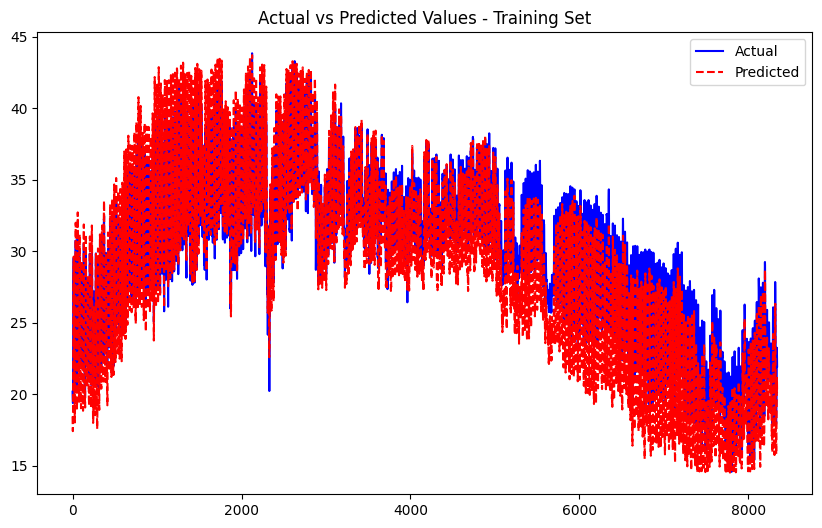

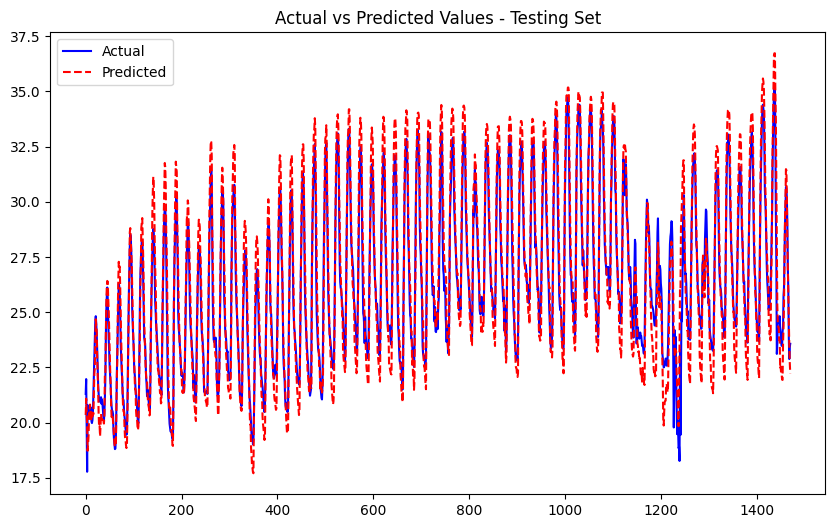

Processing node 10...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.3958
Epoch [2/50], Train Loss: 0.3875
Epoch [3/50], Train Loss: 0.3577
Epoch [4/50], Train Loss: 0.3373
Epoch [5/50], Train Loss: 0.3261
Epoch [6/50], Train Loss: 0.3145
Epoch [7/50], Train Loss: 0.3087
Epoch [8/50], Train Loss: 0.2972
Epoch [9/50], Train Loss: 0.2890
Epoch [10/50], Train Loss: 0.2818
Epoch [11/50], Train Loss: 0.2743
Epoch [12/50], Train Loss: 0.2643
Epoch [13/50], Train Loss: 0.2600
Epoch [14/50], Train Loss: 0.2620
Epoch [15/50], Train Loss: 0.2554
Epoch [16/50], Train Loss: 0.2468
Epoch [17/50], Train Loss: 0.2446
Epoch [18/50], Train Loss: 0.2494
Epoch [19/50], Train Loss: 0.2442
Epoch [20/50], Train Loss: 0.2362
Epoch [21/50], Train Loss: 0.2296
Epoch [22/50], Train Loss: 0.2283
Epoch [23/50], Train Loss: 0.2329
Epoch [24/50], Train Loss: 0.2282
Epoch [25/50], Train Loss: 0.2269
Epoch [26/50], Train Loss: 0.2247
Epoch [27/50], Train Loss: 0.2244
Epoch [28/50], Train Loss: 0.2196
Epoch [29/50], Train Loss: 0.2158
Epoch [30/50], Train Lo

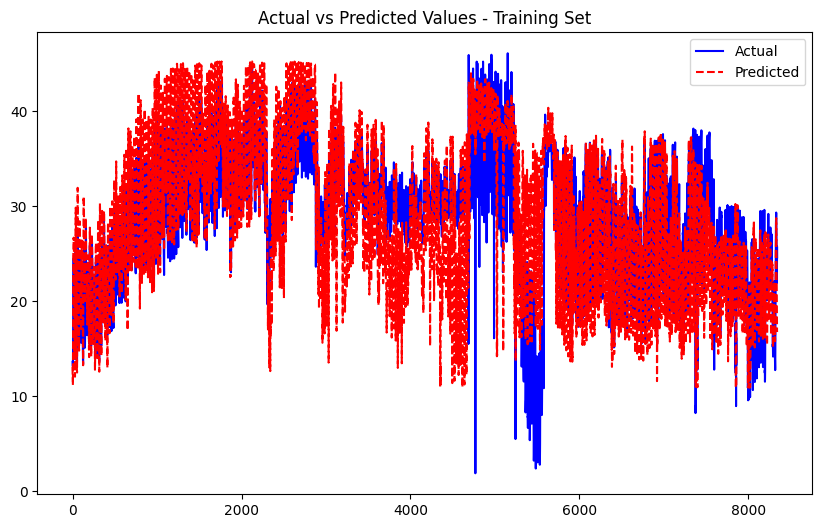

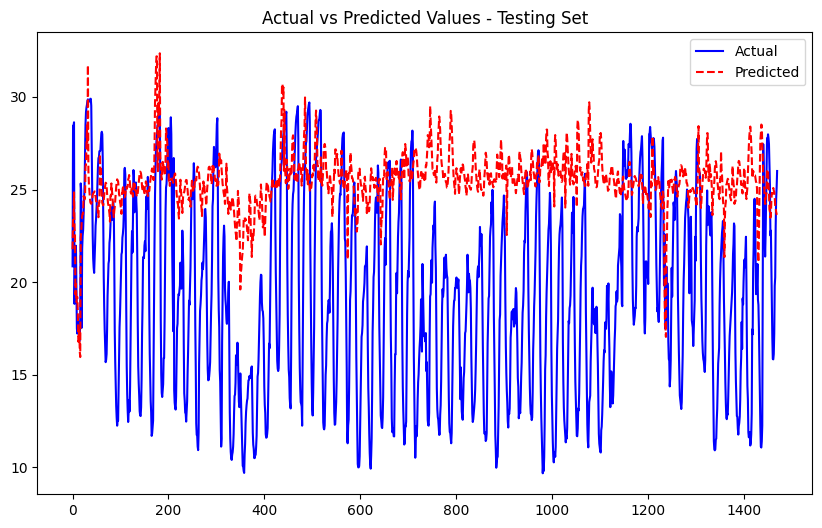

Processing node 11...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.1003
Epoch [2/50], Train Loss: 0.0852
Epoch [3/50], Train Loss: 0.0794
Epoch [4/50], Train Loss: 0.0745
Epoch [5/50], Train Loss: 0.0700
Epoch [6/50], Train Loss: 0.0674
Epoch [7/50], Train Loss: 0.0660
Epoch [8/50], Train Loss: 0.0655
Epoch [9/50], Train Loss: 0.0639
Epoch [10/50], Train Loss: 0.0634
Epoch [11/50], Train Loss: 0.0619
Epoch [12/50], Train Loss: 0.0612
Epoch [13/50], Train Loss: 0.0622
Epoch [14/50], Train Loss: 0.0608
Epoch [15/50], Train Loss: 0.0605
Epoch [16/50], Train Loss: 0.0594
Epoch [17/50], Train Loss: 0.0592
Epoch [18/50], Train Loss: 0.0583
Epoch [19/50], Train Loss: 0.0594
Epoch [20/50], Train Loss: 0.0585
Epoch [21/50], Train Loss: 0.0575
Epoch [22/50], Train Loss: 0.0579
Epoch [23/50], Train Loss: 0.0576
Epoch [24/50], Train Loss: 0.0581
Epoch [25/50], Train Loss: 0.0570
Epoch [26/50], Train Loss: 0.0574
Epoch [27/50], Train Loss: 0.0580
Epoch [28/50], Train Loss: 0.0569
Epoch [29/50], Train Loss: 0.0564
Epoch [30/50], Train Lo

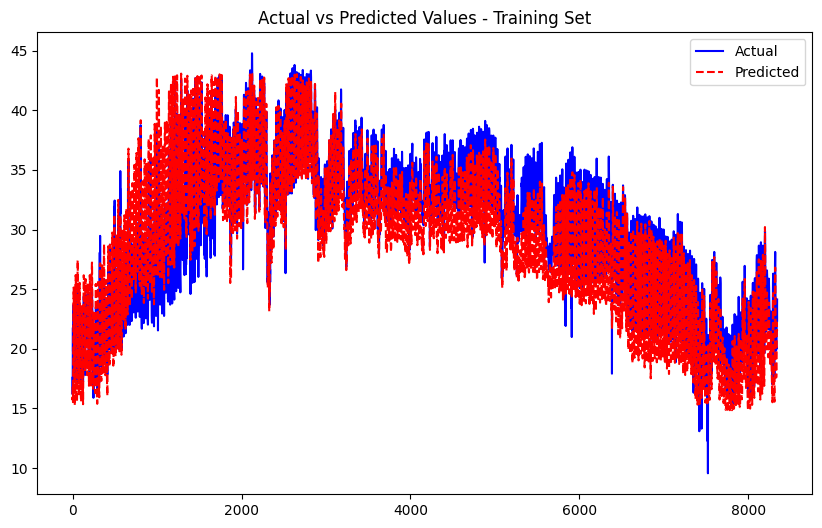

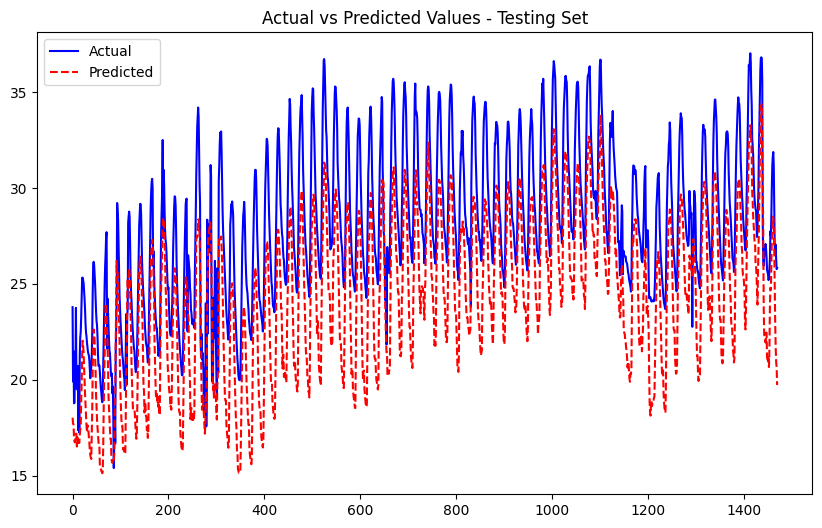

Processing node 12...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0373
Epoch [2/50], Train Loss: 0.0364
Epoch [3/50], Train Loss: 0.0364
Epoch [4/50], Train Loss: 0.0364
Epoch [5/50], Train Loss: 0.0351
Epoch [6/50], Train Loss: 0.0356
Epoch [7/50], Train Loss: 0.0360
Epoch [8/50], Train Loss: 0.0353
Epoch [9/50], Train Loss: 0.0352
Epoch [10/50], Train Loss: 0.0360
Epoch [11/50], Train Loss: 0.0344
Epoch [12/50], Train Loss: 0.0347
Epoch [13/50], Train Loss: 0.0342
Epoch [14/50], Train Loss: 0.0349
Epoch [15/50], Train Loss: 0.0344
Epoch [16/50], Train Loss: 0.0345
Epoch [17/50], Train Loss: 0.0337
Epoch [18/50], Train Loss: 0.0341
Epoch [19/50], Train Loss: 0.0342
Epoch [20/50], Train Loss: 0.0345
Epoch [21/50], Train Loss: 0.0343
Epoch [22/50], Train Loss: 0.0338
Epoch [23/50], Train Loss: 0.0337
Epoch [24/50], Train Loss: 0.0341
Epoch [25/50], Train Loss: 0.0342
Epoch [26/50], Train Loss: 0.0339
Epoch [27/50], Train Loss: 0.0344
Epoch [28/50], Train Loss: 0.0334
Epoch [29/50], Train Loss: 0.0342
Epoch [30/50], Train Lo

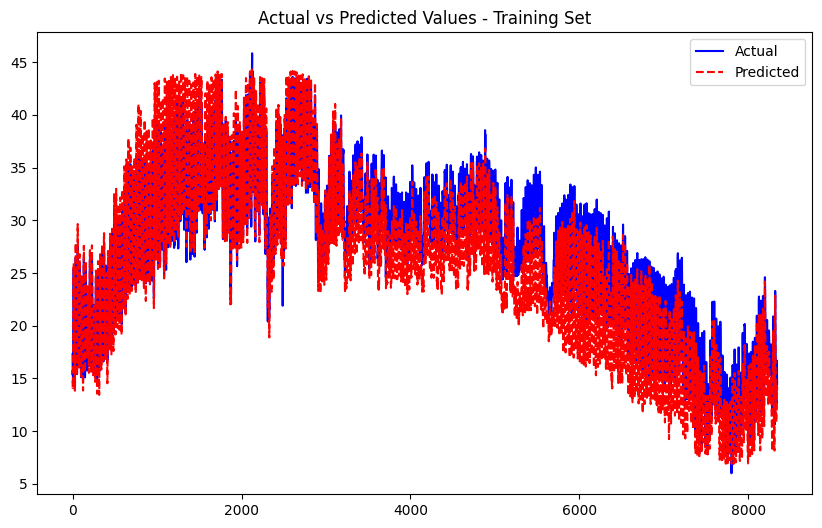

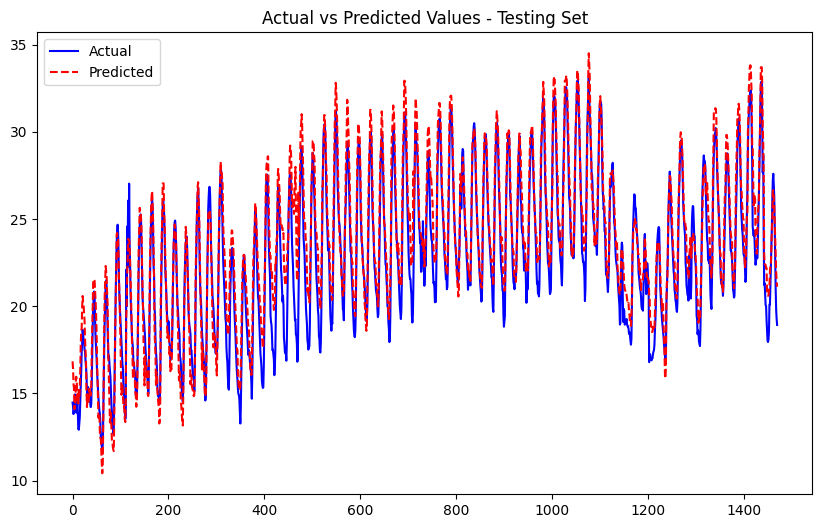

Processing node 13...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0850
Epoch [2/50], Train Loss: 0.0952
Epoch [3/50], Train Loss: 0.0960
Epoch [4/50], Train Loss: 0.0986
Epoch [5/50], Train Loss: 0.1023
Epoch [6/50], Train Loss: 0.1008
Epoch [7/50], Train Loss: 0.0996
Epoch [8/50], Train Loss: 0.0988
Epoch [9/50], Train Loss: 0.0985
Epoch [10/50], Train Loss: 0.0984
Epoch [11/50], Train Loss: 0.1030
Epoch [12/50], Train Loss: 0.0986
Epoch [13/50], Train Loss: 0.0961
Epoch [14/50], Train Loss: 0.0954
Epoch [15/50], Train Loss: 0.0979
Epoch [16/50], Train Loss: 0.0950
Epoch [17/50], Train Loss: 0.0927
Epoch [18/50], Train Loss: 0.0927
Epoch [19/50], Train Loss: 0.0956
Epoch [20/50], Train Loss: 0.0945
Epoch [21/50], Train Loss: 0.0960
Epoch [22/50], Train Loss: 0.0950
Epoch [23/50], Train Loss: 0.0937
Epoch [24/50], Train Loss: 0.0944
Epoch [25/50], Train Loss: 0.0931
Epoch [26/50], Train Loss: 0.0965
Epoch [27/50], Train Loss: 0.0935
Epoch [28/50], Train Loss: 0.0910
Epoch [29/50], Train Loss: 0.0895
Epoch [30/50], Train Lo

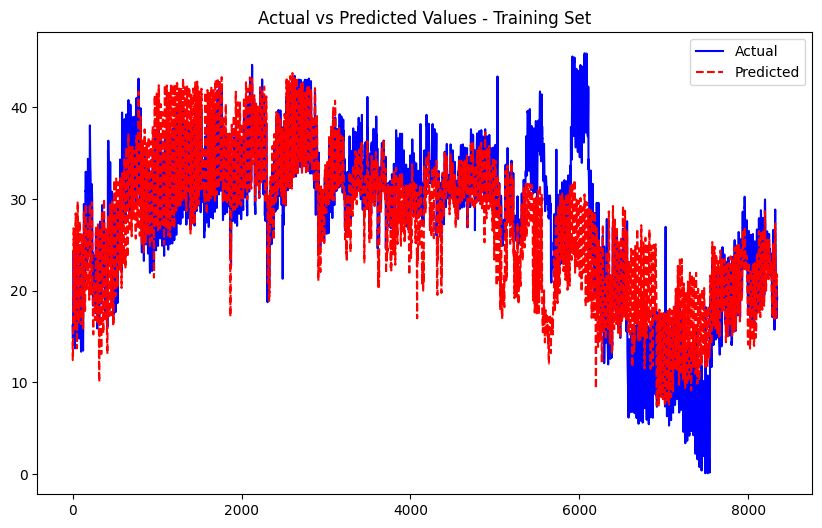

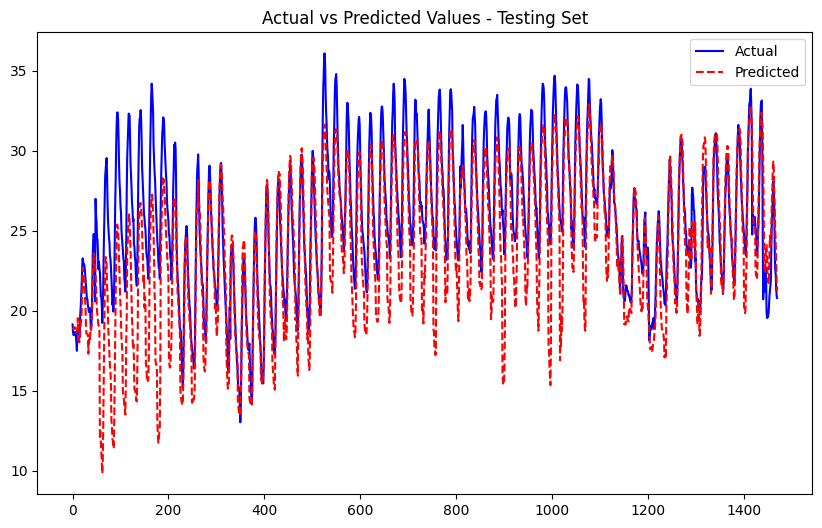

Processing node 14...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0620
Epoch [2/50], Train Loss: 0.0601
Epoch [3/50], Train Loss: 0.0571
Epoch [4/50], Train Loss: 0.0546
Epoch [5/50], Train Loss: 0.0542
Epoch [6/50], Train Loss: 0.0538
Epoch [7/50], Train Loss: 0.0526
Epoch [8/50], Train Loss: 0.0529
Epoch [9/50], Train Loss: 0.0516
Epoch [10/50], Train Loss: 0.0521
Epoch [11/50], Train Loss: 0.0525
Epoch [12/50], Train Loss: 0.0522
Epoch [13/50], Train Loss: 0.0519
Epoch [14/50], Train Loss: 0.0514
Epoch [15/50], Train Loss: 0.0508
Epoch [16/50], Train Loss: 0.0508
Epoch [17/50], Train Loss: 0.0503
Epoch [18/50], Train Loss: 0.0494
Epoch [19/50], Train Loss: 0.0500
Epoch [20/50], Train Loss: 0.0492
Epoch [21/50], Train Loss: 0.0494
Epoch [22/50], Train Loss: 0.0485
Epoch [23/50], Train Loss: 0.0489
Epoch [24/50], Train Loss: 0.0489
Epoch [25/50], Train Loss: 0.0486
Epoch [26/50], Train Loss: 0.0483
Epoch [27/50], Train Loss: 0.0485
Epoch [28/50], Train Loss: 0.0483
Epoch [29/50], Train Loss: 0.0485
Epoch [30/50], Train Lo

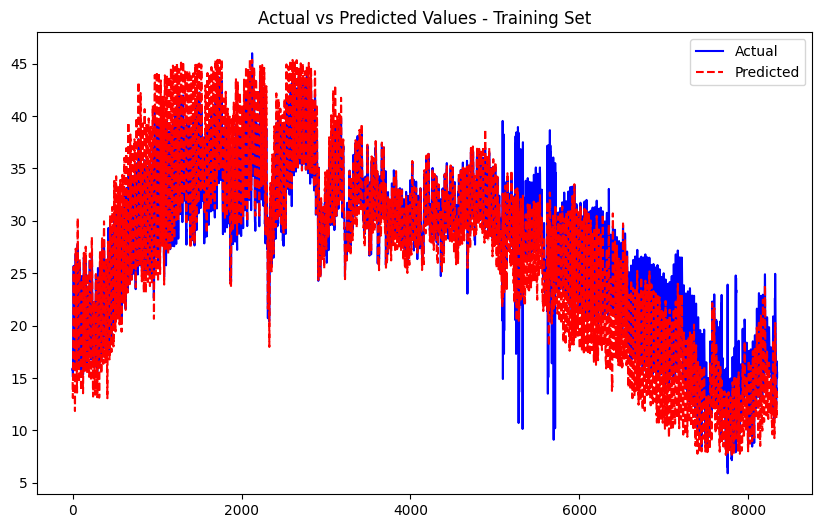

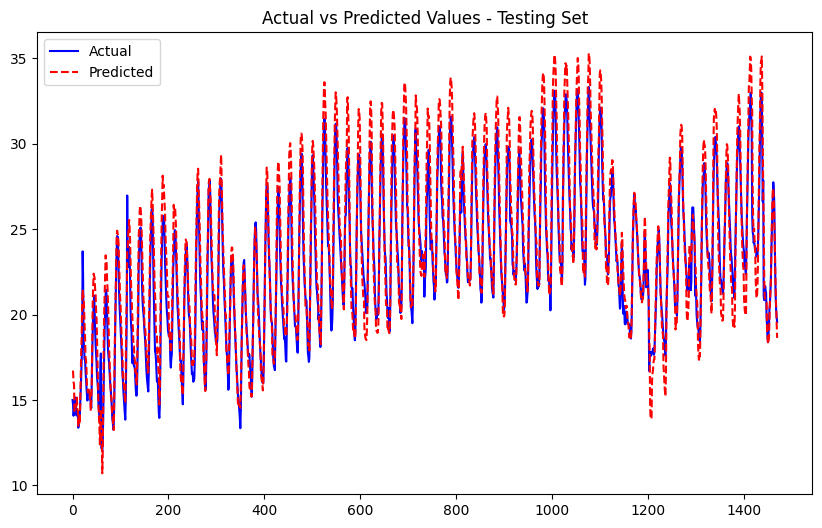

Processing node 15...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0647
Epoch [2/50], Train Loss: 0.0638
Epoch [3/50], Train Loss: 0.0640
Epoch [4/50], Train Loss: 0.0631
Epoch [5/50], Train Loss: 0.0629
Epoch [6/50], Train Loss: 0.0626
Epoch [7/50], Train Loss: 0.0623
Epoch [8/50], Train Loss: 0.0627
Epoch [9/50], Train Loss: 0.0624
Epoch [10/50], Train Loss: 0.0622
Epoch [11/50], Train Loss: 0.0625
Epoch [12/50], Train Loss: 0.0627
Epoch [13/50], Train Loss: 0.0627
Epoch [14/50], Train Loss: 0.0625
Epoch [15/50], Train Loss: 0.0633
Epoch [16/50], Train Loss: 0.0625
Epoch [17/50], Train Loss: 0.0620
Epoch [18/50], Train Loss: 0.0614
Epoch [19/50], Train Loss: 0.0614
Epoch [20/50], Train Loss: 0.0614
Epoch [21/50], Train Loss: 0.0612
Epoch [22/50], Train Loss: 0.0612
Epoch [23/50], Train Loss: 0.0607
Epoch [24/50], Train Loss: 0.0619
Epoch [25/50], Train Loss: 0.0609
Epoch [26/50], Train Loss: 0.0606
Epoch [27/50], Train Loss: 0.0614
Epoch [28/50], Train Loss: 0.0613
Epoch [29/50], Train Loss: 0.0612
Epoch [30/50], Train Lo

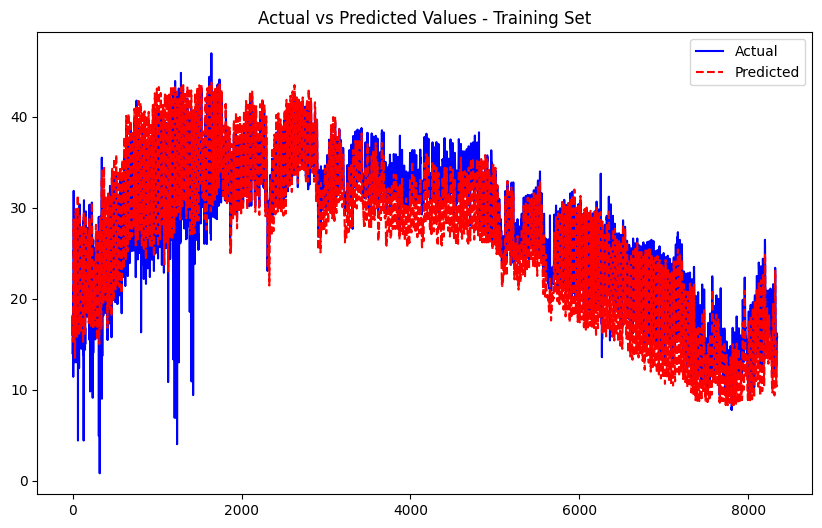

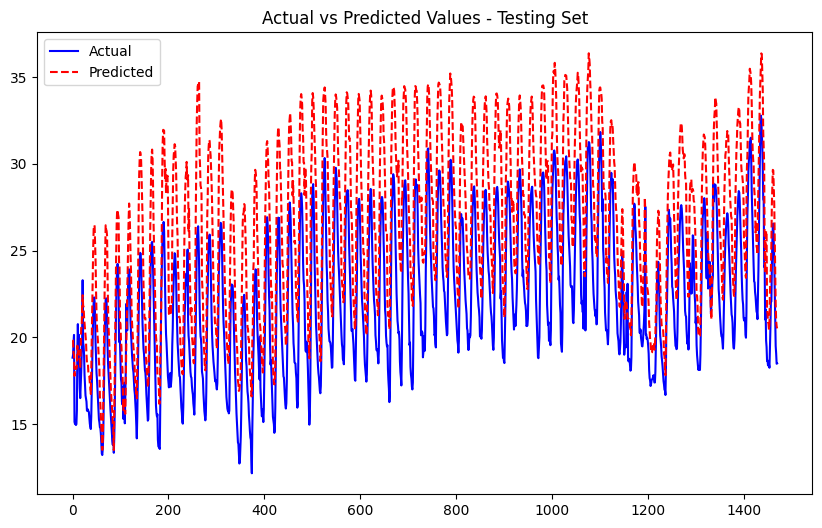

Processing node 16...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.1037
Epoch [2/50], Train Loss: 0.1030
Epoch [3/50], Train Loss: 0.1011
Epoch [4/50], Train Loss: 0.1025
Epoch [5/50], Train Loss: 0.1004
Epoch [6/50], Train Loss: 0.1007
Epoch [7/50], Train Loss: 0.0974
Epoch [8/50], Train Loss: 0.0992
Epoch [9/50], Train Loss: 0.0995
Epoch [10/50], Train Loss: 0.0987
Epoch [11/50], Train Loss: 0.1009
Epoch [12/50], Train Loss: 0.0996
Epoch [13/50], Train Loss: 0.0973
Epoch [14/50], Train Loss: 0.0978
Epoch [15/50], Train Loss: 0.0985
Epoch [16/50], Train Loss: 0.1000
Epoch [17/50], Train Loss: 0.0975
Epoch [18/50], Train Loss: 0.0990
Epoch [19/50], Train Loss: 0.0999
Epoch [20/50], Train Loss: 0.0976
Epoch [21/50], Train Loss: 0.0964
Epoch [22/50], Train Loss: 0.0958
Epoch [23/50], Train Loss: 0.0965
Epoch [24/50], Train Loss: 0.0944
Epoch [25/50], Train Loss: 0.0960
Epoch [26/50], Train Loss: 0.0953
Epoch [27/50], Train Loss: 0.0958
Epoch [28/50], Train Loss: 0.0970
Epoch [29/50], Train Loss: 0.0979
Epoch [30/50], Train Lo

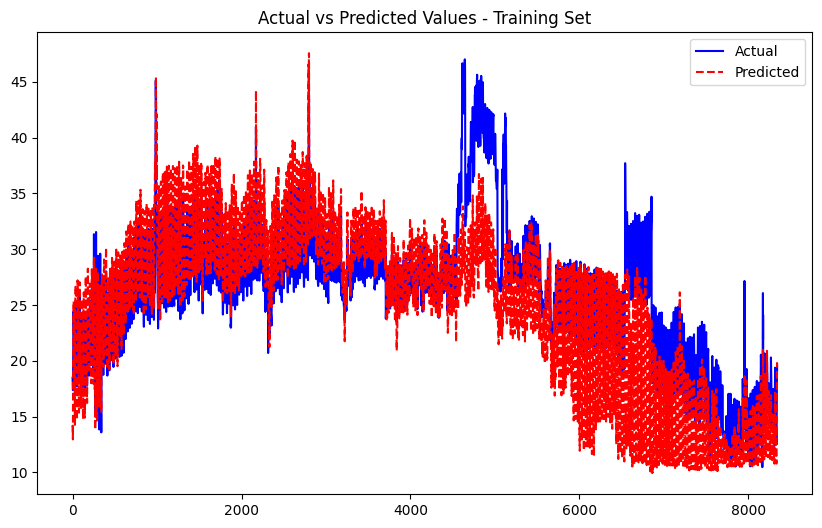

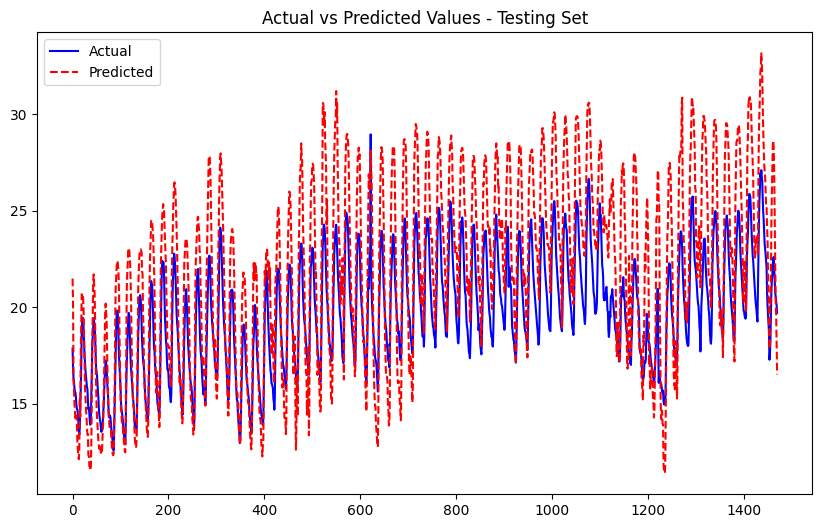

Processing node 17...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0533
Epoch [2/50], Train Loss: 0.0497
Epoch [3/50], Train Loss: 0.0473
Epoch [4/50], Train Loss: 0.0464
Epoch [5/50], Train Loss: 0.0451
Epoch [6/50], Train Loss: 0.0447
Epoch [7/50], Train Loss: 0.0443
Epoch [8/50], Train Loss: 0.0443
Epoch [9/50], Train Loss: 0.0432
Epoch [10/50], Train Loss: 0.0428
Epoch [11/50], Train Loss: 0.0428
Epoch [12/50], Train Loss: 0.0426
Epoch [13/50], Train Loss: 0.0427
Epoch [14/50], Train Loss: 0.0426
Epoch [15/50], Train Loss: 0.0419
Epoch [16/50], Train Loss: 0.0419
Epoch [17/50], Train Loss: 0.0422
Epoch [18/50], Train Loss: 0.0420
Epoch [19/50], Train Loss: 0.0418
Epoch [20/50], Train Loss: 0.0421
Epoch [21/50], Train Loss: 0.0419
Epoch [22/50], Train Loss: 0.0412
Epoch [23/50], Train Loss: 0.0412
Epoch [24/50], Train Loss: 0.0413
Epoch [25/50], Train Loss: 0.0413
Epoch [26/50], Train Loss: 0.0409
Epoch [27/50], Train Loss: 0.0411
Epoch [28/50], Train Loss: 0.0411
Epoch [29/50], Train Loss: 0.0415
Epoch [30/50], Train Lo

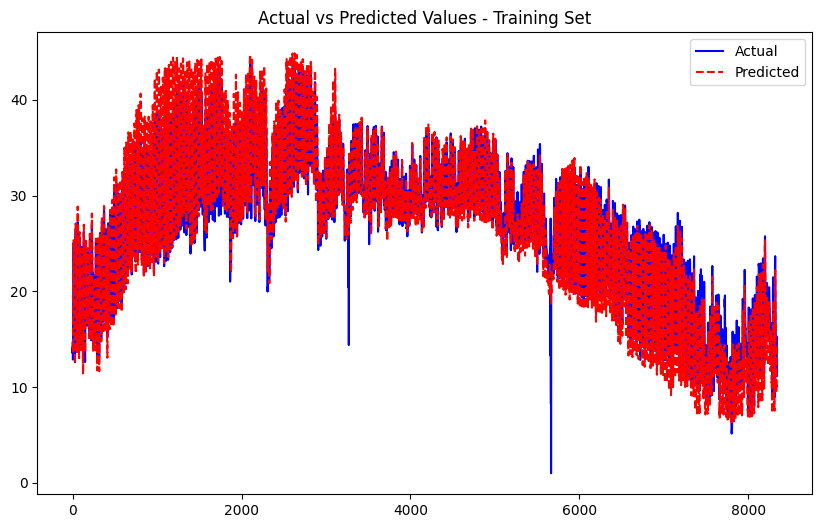

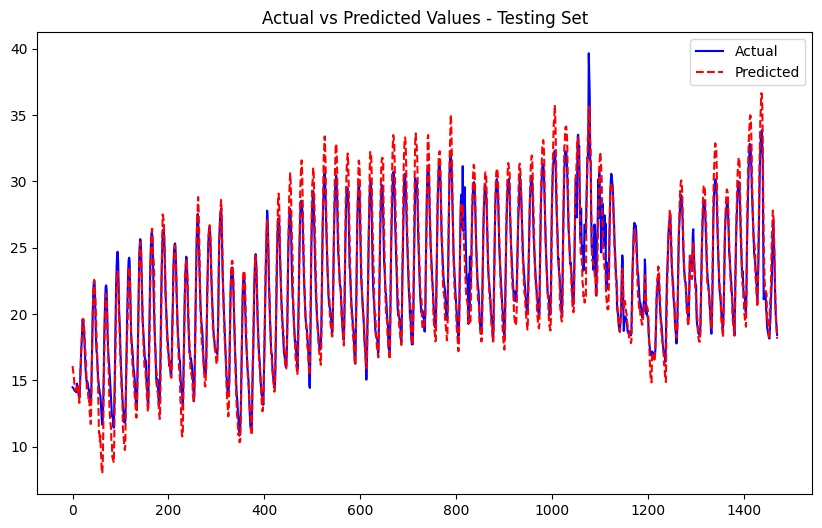

Processing node 18...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0414
Epoch [2/50], Train Loss: 0.0384
Epoch [3/50], Train Loss: 0.0383
Epoch [4/50], Train Loss: 0.0374
Epoch [5/50], Train Loss: 0.0373
Epoch [6/50], Train Loss: 0.0367
Epoch [7/50], Train Loss: 0.0374
Epoch [8/50], Train Loss: 0.0375
Epoch [9/50], Train Loss: 0.0372
Epoch [10/50], Train Loss: 0.0372
Epoch [11/50], Train Loss: 0.0372
Epoch [12/50], Train Loss: 0.0370
Epoch [13/50], Train Loss: 0.0364
Epoch [14/50], Train Loss: 0.0368
Epoch [15/50], Train Loss: 0.0368
Epoch [16/50], Train Loss: 0.0369
Epoch [17/50], Train Loss: 0.0369
Epoch [18/50], Train Loss: 0.0369
Epoch [19/50], Train Loss: 0.0369
Epoch [20/50], Train Loss: 0.0371
Epoch [21/50], Train Loss: 0.0368
Epoch [22/50], Train Loss: 0.0373
Epoch [23/50], Train Loss: 0.0364
Epoch [24/50], Train Loss: 0.0370
Epoch [25/50], Train Loss: 0.0362
Epoch [26/50], Train Loss: 0.0367
Epoch [27/50], Train Loss: 0.0364
Epoch [28/50], Train Loss: 0.0371
Epoch [29/50], Train Loss: 0.0366
Epoch [30/50], Train Lo

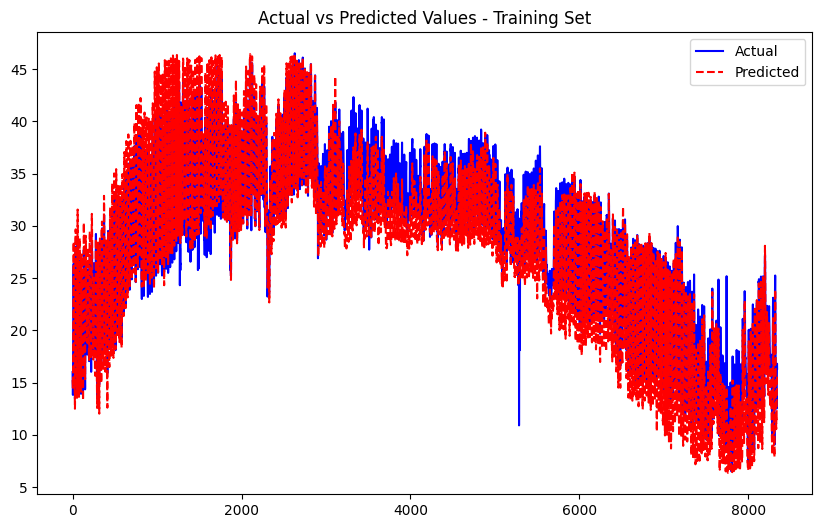

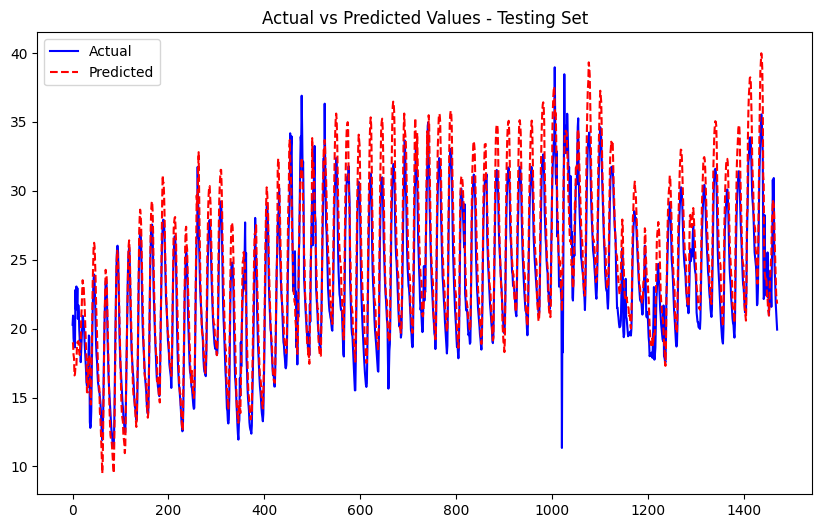

Processing node 19...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0755
Epoch [2/50], Train Loss: 0.0720
Epoch [3/50], Train Loss: 0.0714
Epoch [4/50], Train Loss: 0.0682
Epoch [5/50], Train Loss: 0.0680
Epoch [6/50], Train Loss: 0.0682
Epoch [7/50], Train Loss: 0.0666
Epoch [8/50], Train Loss: 0.0673
Epoch [9/50], Train Loss: 0.0664
Epoch [10/50], Train Loss: 0.0667
Epoch [11/50], Train Loss: 0.0656
Epoch [12/50], Train Loss: 0.0652
Epoch [13/50], Train Loss: 0.0648
Epoch [14/50], Train Loss: 0.0652
Epoch [15/50], Train Loss: 0.0648
Epoch [16/50], Train Loss: 0.0647
Epoch [17/50], Train Loss: 0.0653
Epoch [18/50], Train Loss: 0.0647
Epoch [19/50], Train Loss: 0.0642
Epoch [20/50], Train Loss: 0.0640
Epoch [21/50], Train Loss: 0.0635
Epoch [22/50], Train Loss: 0.0635
Epoch [23/50], Train Loss: 0.0635
Epoch [24/50], Train Loss: 0.0631
Epoch [25/50], Train Loss: 0.0634
Epoch [26/50], Train Loss: 0.0629
Epoch [27/50], Train Loss: 0.0640
Epoch [28/50], Train Loss: 0.0630
Epoch [29/50], Train Loss: 0.0637
Epoch [30/50], Train Lo

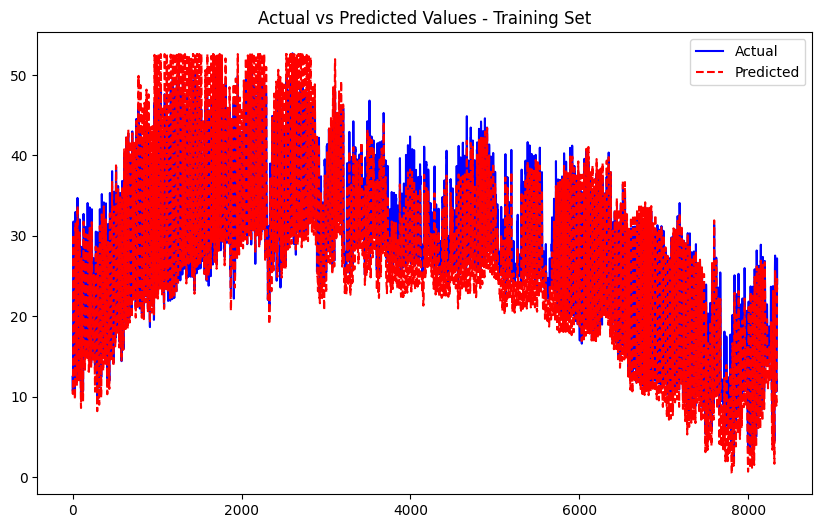

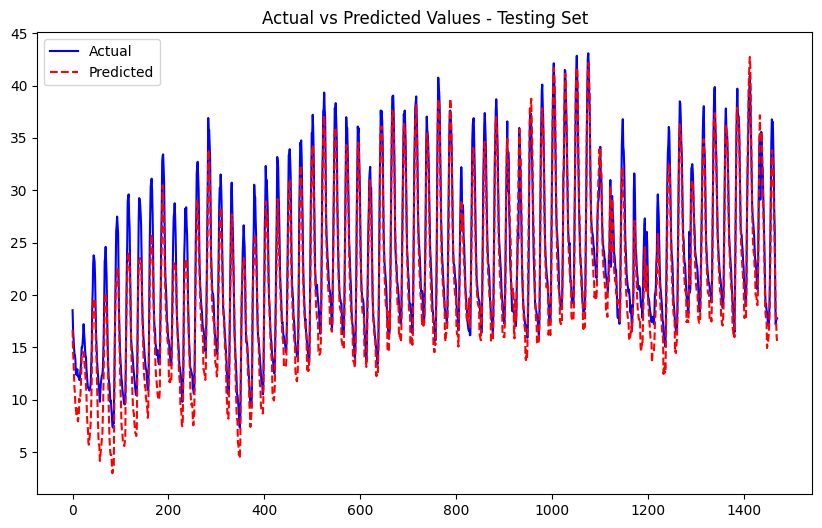

Processing node 20...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0532
Epoch [2/50], Train Loss: 0.0522
Epoch [3/50], Train Loss: 0.0514
Epoch [4/50], Train Loss: 0.0507
Epoch [5/50], Train Loss: 0.0513
Epoch [6/50], Train Loss: 0.0502
Epoch [7/50], Train Loss: 0.0504
Epoch [8/50], Train Loss: 0.0504
Epoch [9/50], Train Loss: 0.0502
Epoch [10/50], Train Loss: 0.0497
Epoch [11/50], Train Loss: 0.0491
Epoch [12/50], Train Loss: 0.0500
Epoch [13/50], Train Loss: 0.0487
Epoch [14/50], Train Loss: 0.0500
Epoch [15/50], Train Loss: 0.0499
Epoch [16/50], Train Loss: 0.0496
Epoch [17/50], Train Loss: 0.0487
Epoch [18/50], Train Loss: 0.0488
Epoch [19/50], Train Loss: 0.0491
Epoch [20/50], Train Loss: 0.0494
Epoch [21/50], Train Loss: 0.0490
Epoch [22/50], Train Loss: 0.0486
Epoch [23/50], Train Loss: 0.0490
Epoch [24/50], Train Loss: 0.0489
Epoch [25/50], Train Loss: 0.0485
Epoch [26/50], Train Loss: 0.0484
Epoch [27/50], Train Loss: 0.0482
Epoch [28/50], Train Loss: 0.0483
Epoch [29/50], Train Loss: 0.0482
Epoch [30/50], Train Lo

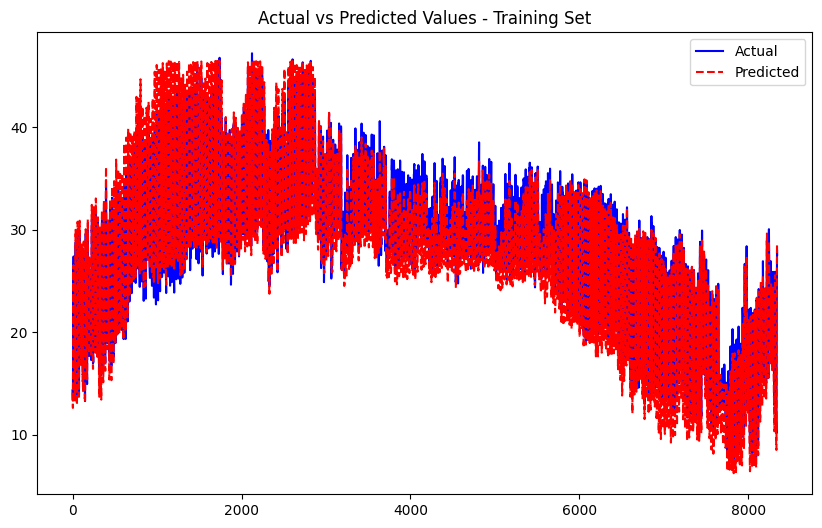

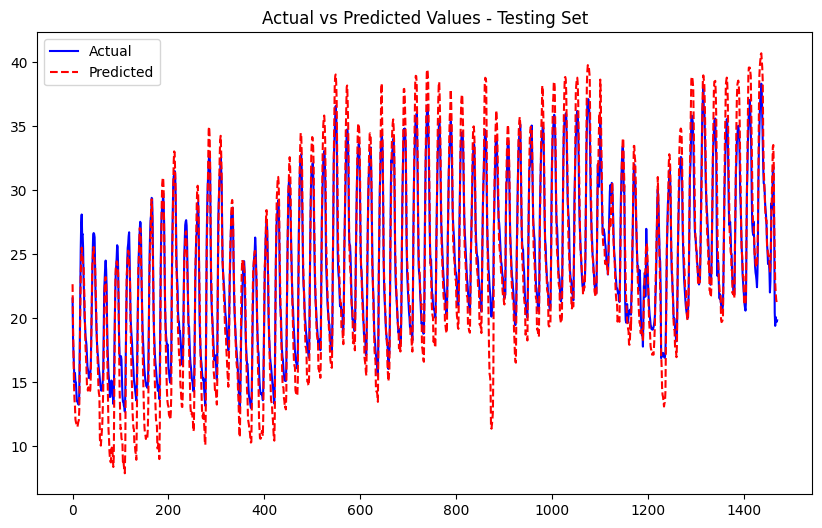

Processing node 21...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0517
Epoch [2/50], Train Loss: 0.0492
Epoch [3/50], Train Loss: 0.0484
Epoch [4/50], Train Loss: 0.0493
Epoch [5/50], Train Loss: 0.0486
Epoch [6/50], Train Loss: 0.0484
Epoch [7/50], Train Loss: 0.0484
Epoch [8/50], Train Loss: 0.0481
Epoch [9/50], Train Loss: 0.0484
Epoch [10/50], Train Loss: 0.0477
Epoch [11/50], Train Loss: 0.0477
Epoch [12/50], Train Loss: 0.0472
Epoch [13/50], Train Loss: 0.0480
Epoch [14/50], Train Loss: 0.0470
Epoch [15/50], Train Loss: 0.0470
Epoch [16/50], Train Loss: 0.0468
Epoch [17/50], Train Loss: 0.0471
Epoch [18/50], Train Loss: 0.0471
Epoch [19/50], Train Loss: 0.0476
Epoch [20/50], Train Loss: 0.0469
Epoch [21/50], Train Loss: 0.0463
Epoch [22/50], Train Loss: 0.0467
Epoch [23/50], Train Loss: 0.0465
Epoch [24/50], Train Loss: 0.0467
Epoch [25/50], Train Loss: 0.0468
Epoch [26/50], Train Loss: 0.0468
Epoch [27/50], Train Loss: 0.0461
Epoch [28/50], Train Loss: 0.0467
Epoch [29/50], Train Loss: 0.0467
Epoch [30/50], Train Lo

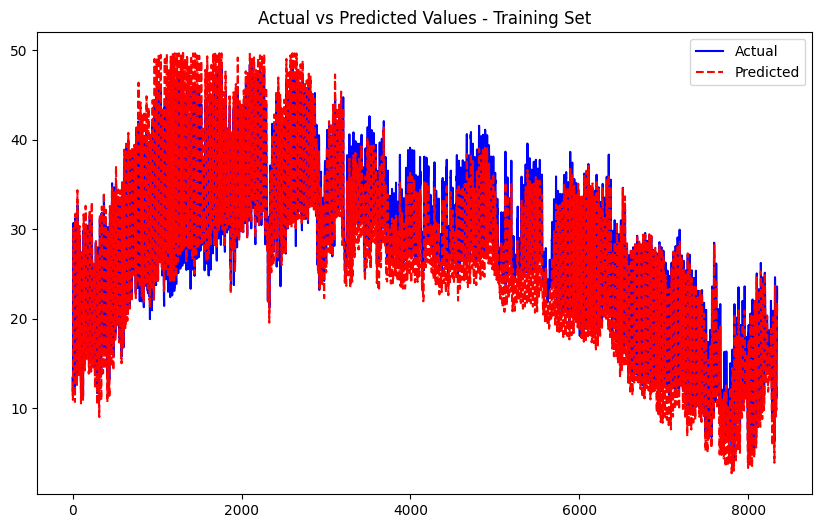

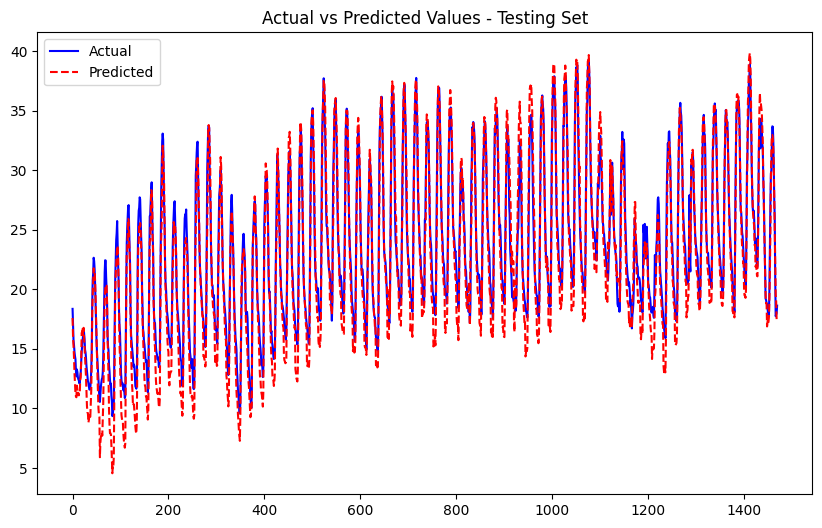

Processing node 22...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0646
Epoch [2/50], Train Loss: 0.0627
Epoch [3/50], Train Loss: 0.0614
Epoch [4/50], Train Loss: 0.0597
Epoch [5/50], Train Loss: 0.0597
Epoch [6/50], Train Loss: 0.0599
Epoch [7/50], Train Loss: 0.0588
Epoch [8/50], Train Loss: 0.0587
Epoch [9/50], Train Loss: 0.0585
Epoch [10/50], Train Loss: 0.0590
Epoch [11/50], Train Loss: 0.0580
Epoch [12/50], Train Loss: 0.0576
Epoch [13/50], Train Loss: 0.0578
Epoch [14/50], Train Loss: 0.0577
Epoch [15/50], Train Loss: 0.0572
Epoch [16/50], Train Loss: 0.0574
Epoch [17/50], Train Loss: 0.0575
Epoch [18/50], Train Loss: 0.0578
Epoch [19/50], Train Loss: 0.0592
Epoch [20/50], Train Loss: 0.0572
Epoch [21/50], Train Loss: 0.0567
Epoch [22/50], Train Loss: 0.0570
Epoch [23/50], Train Loss: 0.0574
Epoch [24/50], Train Loss: 0.0570
Epoch [25/50], Train Loss: 0.0569
Epoch [26/50], Train Loss: 0.0572
Epoch [27/50], Train Loss: 0.0570
Epoch [28/50], Train Loss: 0.0567
Epoch [29/50], Train Loss: 0.0571
Epoch [30/50], Train Lo

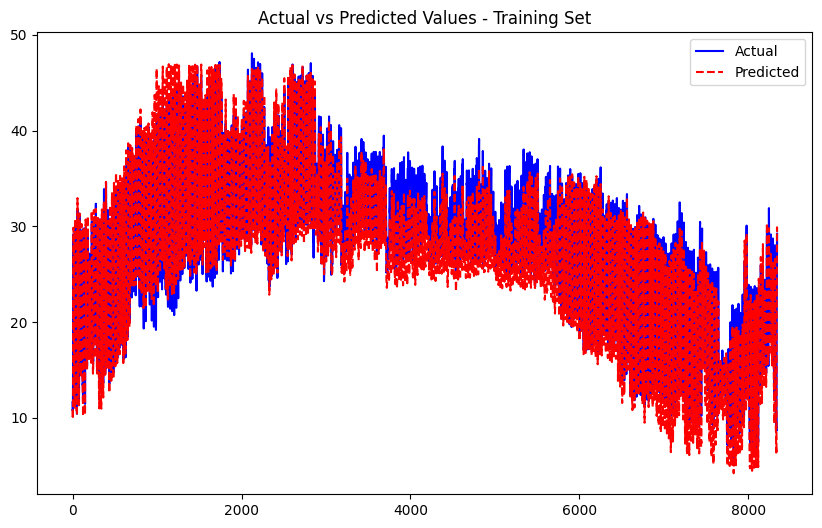

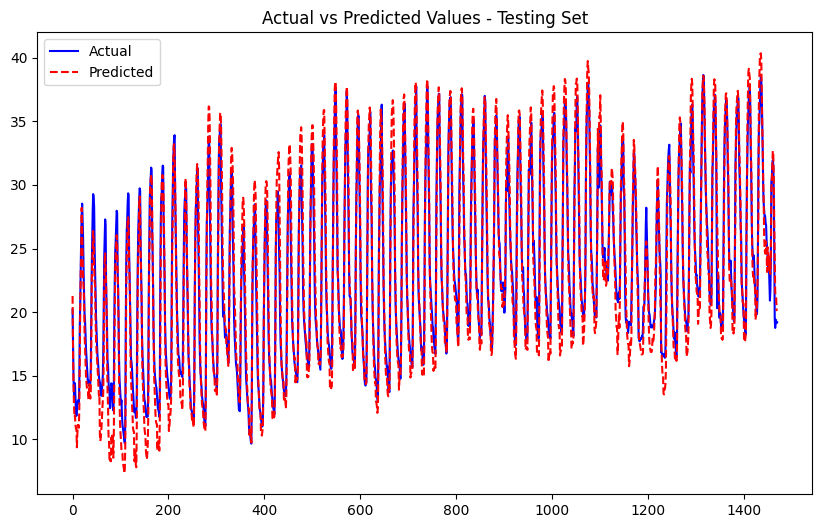

Processing node 23...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0641
Epoch [2/50], Train Loss: 0.0614
Epoch [3/50], Train Loss: 0.0609
Epoch [4/50], Train Loss: 0.0602
Epoch [5/50], Train Loss: 0.0601
Epoch [6/50], Train Loss: 0.0598
Epoch [7/50], Train Loss: 0.0600
Epoch [8/50], Train Loss: 0.0596
Epoch [9/50], Train Loss: 0.0588
Epoch [10/50], Train Loss: 0.0591
Epoch [11/50], Train Loss: 0.0587
Epoch [12/50], Train Loss: 0.0597
Epoch [13/50], Train Loss: 0.0582
Epoch [14/50], Train Loss: 0.0588
Epoch [15/50], Train Loss: 0.0582
Epoch [16/50], Train Loss: 0.0587
Epoch [17/50], Train Loss: 0.0584
Epoch [18/50], Train Loss: 0.0586
Epoch [19/50], Train Loss: 0.0587
Epoch [20/50], Train Loss: 0.0583
Epoch [21/50], Train Loss: 0.0580
Epoch [22/50], Train Loss: 0.0580
Epoch [23/50], Train Loss: 0.0581
Epoch [24/50], Train Loss: 0.0582
Epoch [25/50], Train Loss: 0.0583
Epoch [26/50], Train Loss: 0.0583
Epoch [27/50], Train Loss: 0.0578
Epoch [28/50], Train Loss: 0.0583
Epoch [29/50], Train Loss: 0.0578
Epoch [30/50], Train Lo

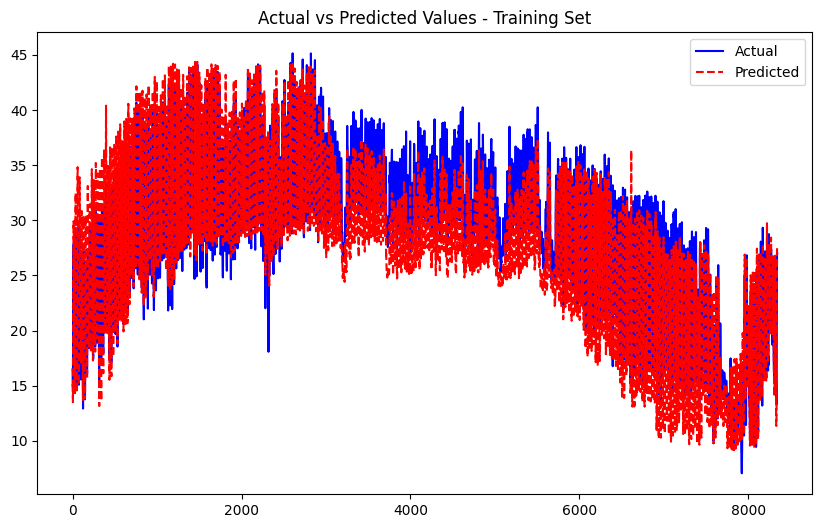

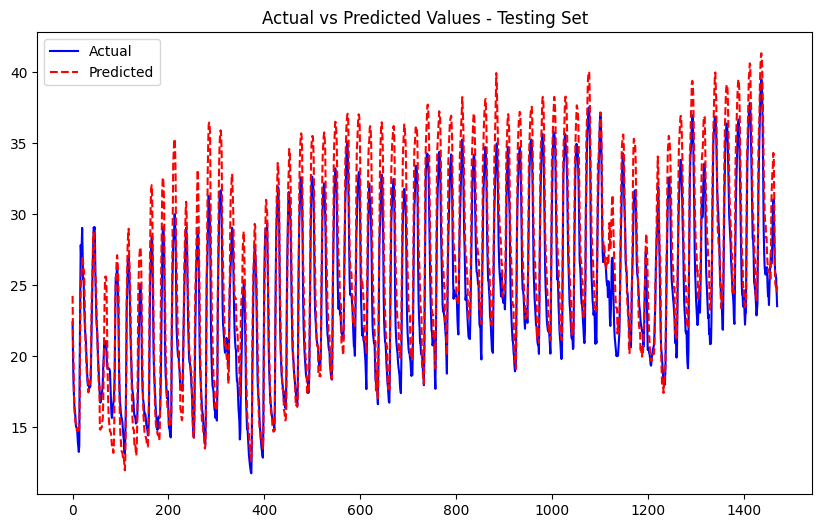

Processing node 24...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0497
Epoch [2/50], Train Loss: 0.0462
Epoch [3/50], Train Loss: 0.0458
Epoch [4/50], Train Loss: 0.0448
Epoch [5/50], Train Loss: 0.0439
Epoch [6/50], Train Loss: 0.0445
Epoch [7/50], Train Loss: 0.0437
Epoch [8/50], Train Loss: 0.0435
Epoch [9/50], Train Loss: 0.0438
Epoch [10/50], Train Loss: 0.0439
Epoch [11/50], Train Loss: 0.0431
Epoch [12/50], Train Loss: 0.0429
Epoch [13/50], Train Loss: 0.0439
Epoch [14/50], Train Loss: 0.0426
Epoch [15/50], Train Loss: 0.0435
Epoch [16/50], Train Loss: 0.0428
Epoch [17/50], Train Loss: 0.0425
Epoch [18/50], Train Loss: 0.0428
Epoch [19/50], Train Loss: 0.0422
Epoch [20/50], Train Loss: 0.0424
Epoch [21/50], Train Loss: 0.0424
Epoch [22/50], Train Loss: 0.0428
Epoch [23/50], Train Loss: 0.0421
Epoch [24/50], Train Loss: 0.0429
Epoch [25/50], Train Loss: 0.0427
Epoch [26/50], Train Loss: 0.0419
Epoch [27/50], Train Loss: 0.0424
Epoch [28/50], Train Loss: 0.0423
Epoch [29/50], Train Loss: 0.0415
Epoch [30/50], Train Lo

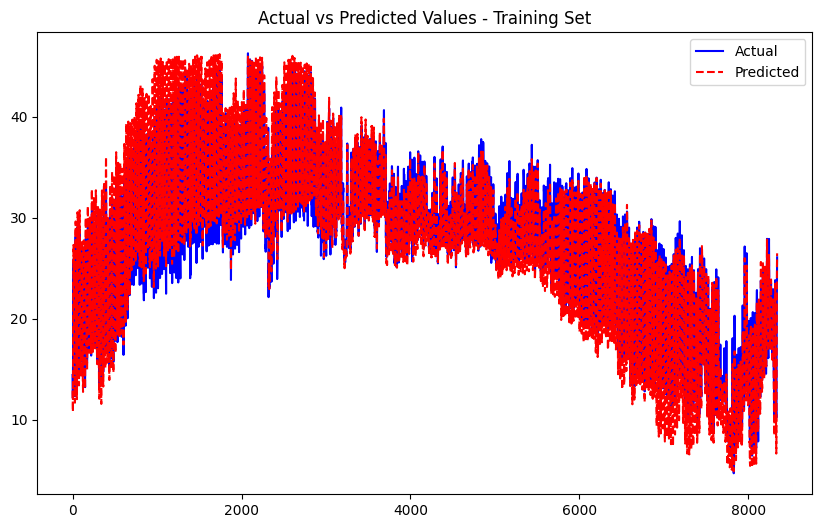

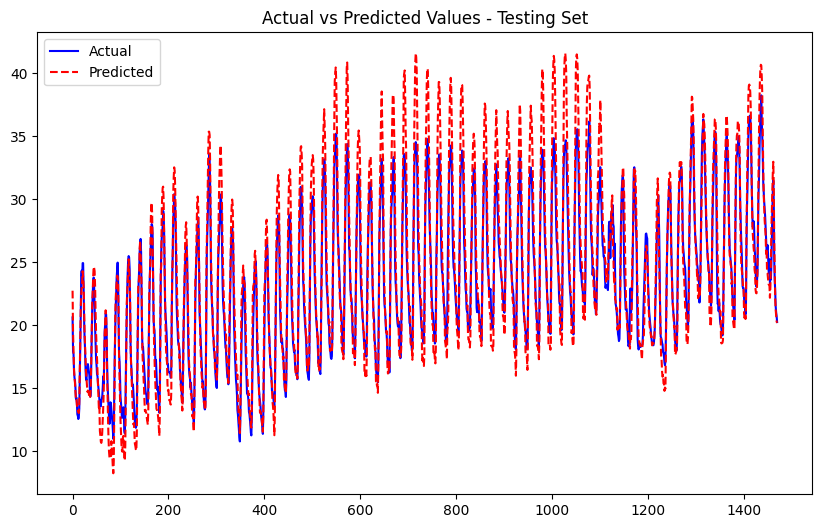

Processing node 25...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0410
Epoch [2/50], Train Loss: 0.0422
Epoch [3/50], Train Loss: 0.0407
Epoch [4/50], Train Loss: 0.0399
Epoch [5/50], Train Loss: 0.0392
Epoch [6/50], Train Loss: 0.0390
Epoch [7/50], Train Loss: 0.0384
Epoch [8/50], Train Loss: 0.0385
Epoch [9/50], Train Loss: 0.0379
Epoch [10/50], Train Loss: 0.0381
Epoch [11/50], Train Loss: 0.0379
Epoch [12/50], Train Loss: 0.0378
Epoch [13/50], Train Loss: 0.0376
Epoch [14/50], Train Loss: 0.0375
Epoch [15/50], Train Loss: 0.0375
Epoch [16/50], Train Loss: 0.0375
Epoch [17/50], Train Loss: 0.0368
Epoch [18/50], Train Loss: 0.0374
Epoch [19/50], Train Loss: 0.0374
Epoch [20/50], Train Loss: 0.0373
Epoch [21/50], Train Loss: 0.0370
Epoch [22/50], Train Loss: 0.0371
Epoch [23/50], Train Loss: 0.0366
Epoch [24/50], Train Loss: 0.0376
Epoch [25/50], Train Loss: 0.0371
Epoch [26/50], Train Loss: 0.0360
Epoch [27/50], Train Loss: 0.0373
Epoch [28/50], Train Loss: 0.0369
Epoch [29/50], Train Loss: 0.0365
Epoch [30/50], Train Lo

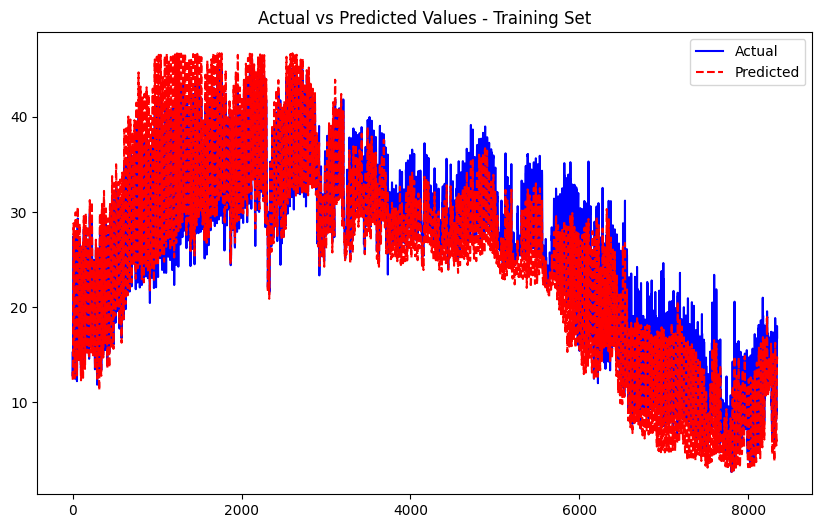

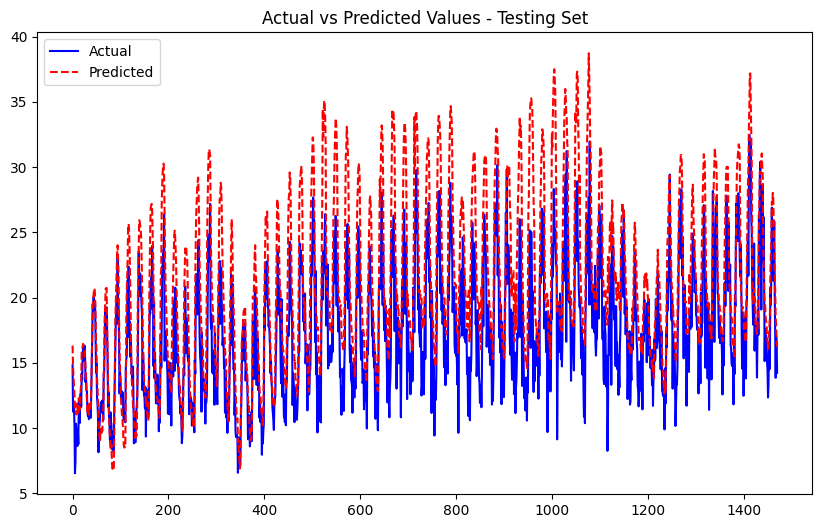

Processing node 26...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0532
Epoch [2/50], Train Loss: 0.0503
Epoch [3/50], Train Loss: 0.0490
Epoch [4/50], Train Loss: 0.0487
Epoch [5/50], Train Loss: 0.0475
Epoch [6/50], Train Loss: 0.0468
Epoch [7/50], Train Loss: 0.0468
Epoch [8/50], Train Loss: 0.0469
Epoch [9/50], Train Loss: 0.0471
Epoch [10/50], Train Loss: 0.0464
Epoch [11/50], Train Loss: 0.0456
Epoch [12/50], Train Loss: 0.0458
Epoch [13/50], Train Loss: 0.0460
Epoch [14/50], Train Loss: 0.0456
Epoch [15/50], Train Loss: 0.0460
Epoch [16/50], Train Loss: 0.0457
Epoch [17/50], Train Loss: 0.0458
Epoch [18/50], Train Loss: 0.0455
Epoch [19/50], Train Loss: 0.0458
Epoch [20/50], Train Loss: 0.0447
Epoch [21/50], Train Loss: 0.0452
Epoch [22/50], Train Loss: 0.0445
Epoch [23/50], Train Loss: 0.0453
Epoch [24/50], Train Loss: 0.0448
Epoch [25/50], Train Loss: 0.0448
Epoch [26/50], Train Loss: 0.0443
Epoch [27/50], Train Loss: 0.0442
Epoch [28/50], Train Loss: 0.0449
Epoch [29/50], Train Loss: 0.0447
Epoch [30/50], Train Lo

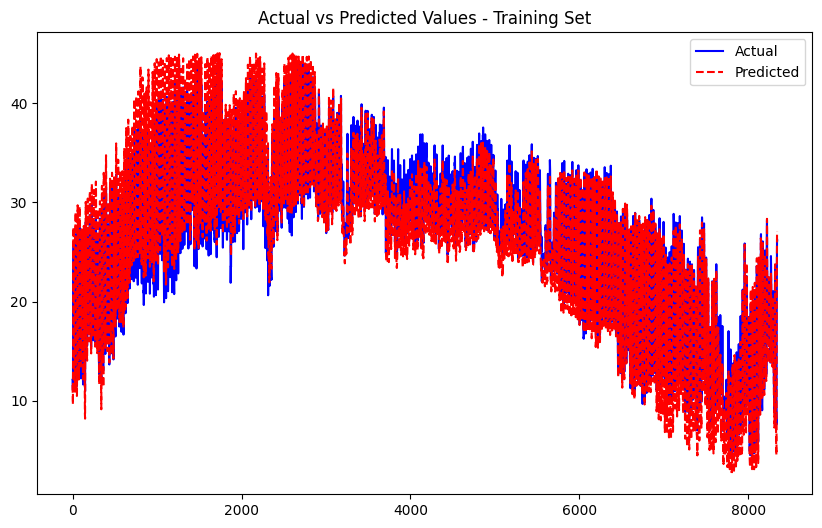

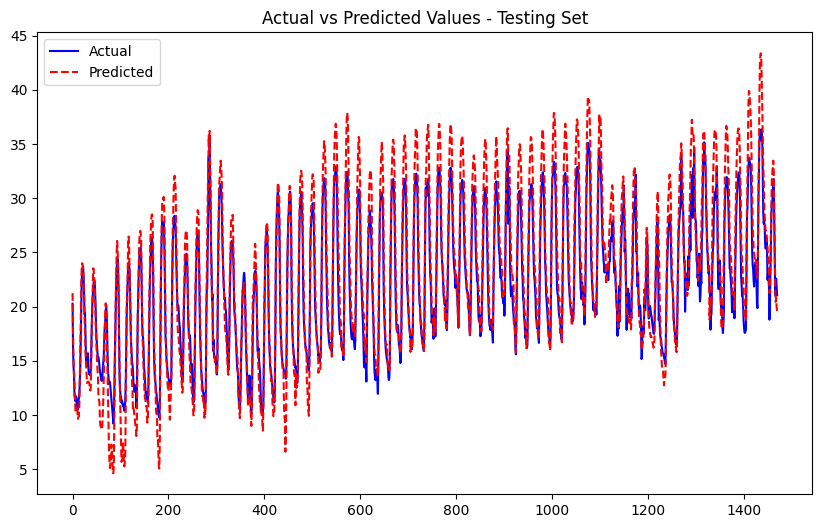

Processing node 27...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0518
Epoch [2/50], Train Loss: 0.0508
Epoch [3/50], Train Loss: 0.0498
Epoch [4/50], Train Loss: 0.0497
Epoch [5/50], Train Loss: 0.0494
Epoch [6/50], Train Loss: 0.0489
Epoch [7/50], Train Loss: 0.0486
Epoch [8/50], Train Loss: 0.0487
Epoch [9/50], Train Loss: 0.0485
Epoch [10/50], Train Loss: 0.0483
Epoch [11/50], Train Loss: 0.0485
Epoch [12/50], Train Loss: 0.0476
Epoch [13/50], Train Loss: 0.0482
Epoch [14/50], Train Loss: 0.0479
Epoch [15/50], Train Loss: 0.0481
Epoch [16/50], Train Loss: 0.0478
Epoch [17/50], Train Loss: 0.0474
Epoch [18/50], Train Loss: 0.0478
Epoch [19/50], Train Loss: 0.0470
Epoch [20/50], Train Loss: 0.0471
Epoch [21/50], Train Loss: 0.0472
Epoch [22/50], Train Loss: 0.0472
Epoch [23/50], Train Loss: 0.0475
Epoch [24/50], Train Loss: 0.0471
Epoch [25/50], Train Loss: 0.0475
Epoch [26/50], Train Loss: 0.0471
Epoch [27/50], Train Loss: 0.0461
Epoch [28/50], Train Loss: 0.0470
Epoch [29/50], Train Loss: 0.0472
Epoch [30/50], Train Lo

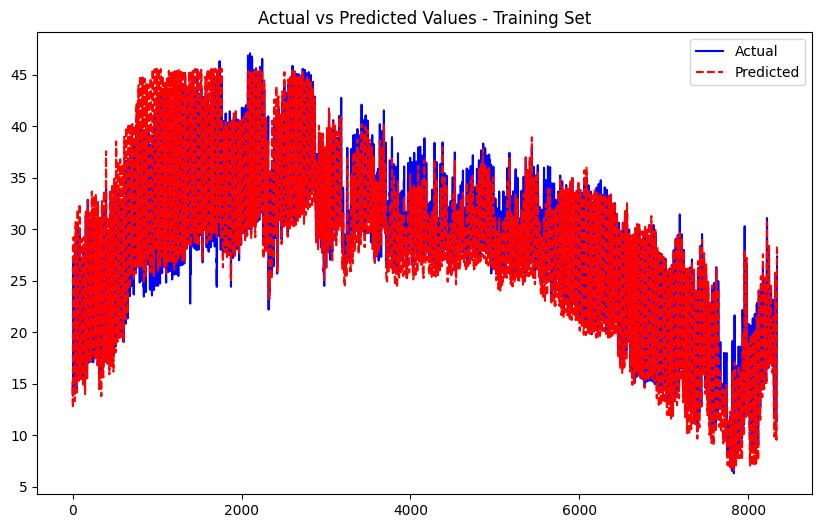

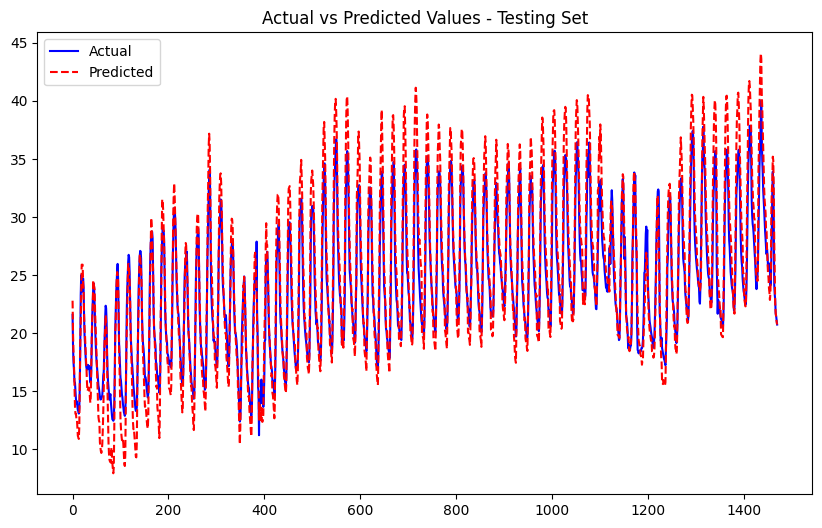

Processing node 28...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0487
Epoch [2/50], Train Loss: 0.0468
Epoch [3/50], Train Loss: 0.0448
Epoch [4/50], Train Loss: 0.0440
Epoch [5/50], Train Loss: 0.0440
Epoch [6/50], Train Loss: 0.0439
Epoch [7/50], Train Loss: 0.0437
Epoch [8/50], Train Loss: 0.0435
Epoch [9/50], Train Loss: 0.0437
Epoch [10/50], Train Loss: 0.0431
Epoch [11/50], Train Loss: 0.0433
Epoch [12/50], Train Loss: 0.0434
Epoch [13/50], Train Loss: 0.0437
Epoch [14/50], Train Loss: 0.0428
Epoch [15/50], Train Loss: 0.0438
Epoch [16/50], Train Loss: 0.0427
Epoch [17/50], Train Loss: 0.0424
Epoch [18/50], Train Loss: 0.0426
Epoch [19/50], Train Loss: 0.0422
Epoch [20/50], Train Loss: 0.0426
Epoch [21/50], Train Loss: 0.0421
Epoch [22/50], Train Loss: 0.0431
Epoch [23/50], Train Loss: 0.0423
Epoch [24/50], Train Loss: 0.0423
Epoch [25/50], Train Loss: 0.0426
Epoch [26/50], Train Loss: 0.0431
Epoch [27/50], Train Loss: 0.0425
Epoch [28/50], Train Loss: 0.0424
Epoch [29/50], Train Loss: 0.0417
Epoch [30/50], Train Lo

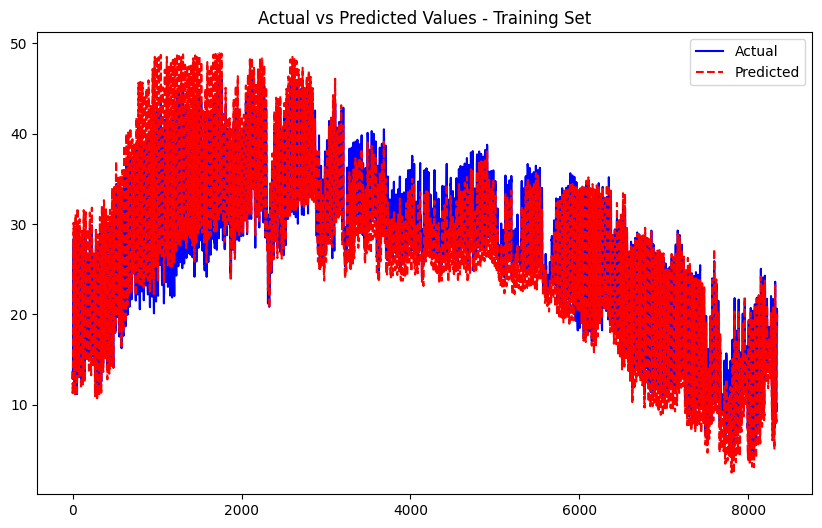

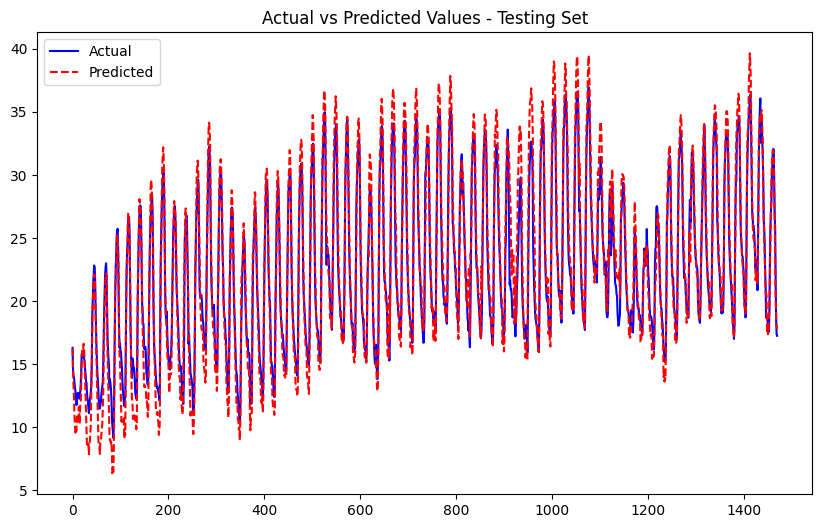

Processing node 29...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0471
Epoch [2/50], Train Loss: 0.0464
Epoch [3/50], Train Loss: 0.0463
Epoch [4/50], Train Loss: 0.0454
Epoch [5/50], Train Loss: 0.0454
Epoch [6/50], Train Loss: 0.0448
Epoch [7/50], Train Loss: 0.0452
Epoch [8/50], Train Loss: 0.0451
Epoch [9/50], Train Loss: 0.0455
Epoch [10/50], Train Loss: 0.0453
Epoch [11/50], Train Loss: 0.0455
Epoch [12/50], Train Loss: 0.0449
Epoch [13/50], Train Loss: 0.0441
Epoch [14/50], Train Loss: 0.0456
Epoch [15/50], Train Loss: 0.0447
Epoch [16/50], Train Loss: 0.0440
Epoch [17/50], Train Loss: 0.0440
Epoch [18/50], Train Loss: 0.0449
Epoch [19/50], Train Loss: 0.0444
Epoch [20/50], Train Loss: 0.0444
Epoch [21/50], Train Loss: 0.0451
Epoch [22/50], Train Loss: 0.0446
Epoch [23/50], Train Loss: 0.0443
Epoch [24/50], Train Loss: 0.0444
Epoch [25/50], Train Loss: 0.0444
Epoch [26/50], Train Loss: 0.0440
Epoch [27/50], Train Loss: 0.0439
Epoch [28/50], Train Loss: 0.0440
Epoch [29/50], Train Loss: 0.0441
Epoch [30/50], Train Lo

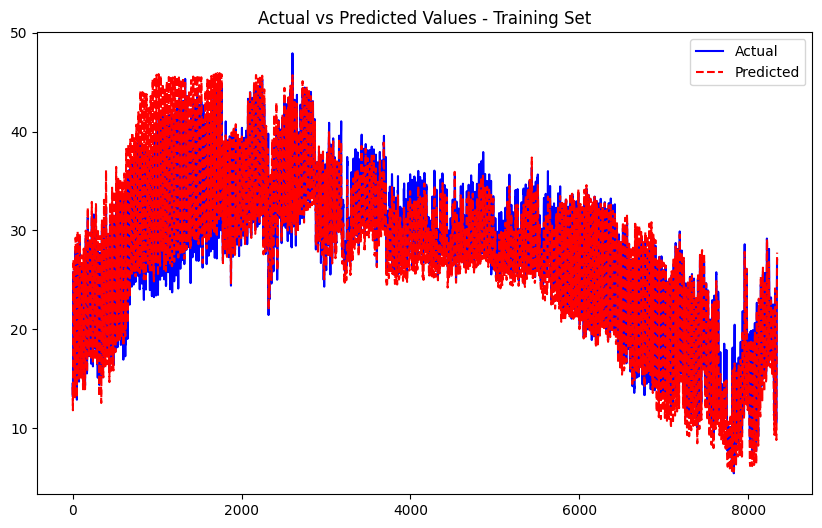

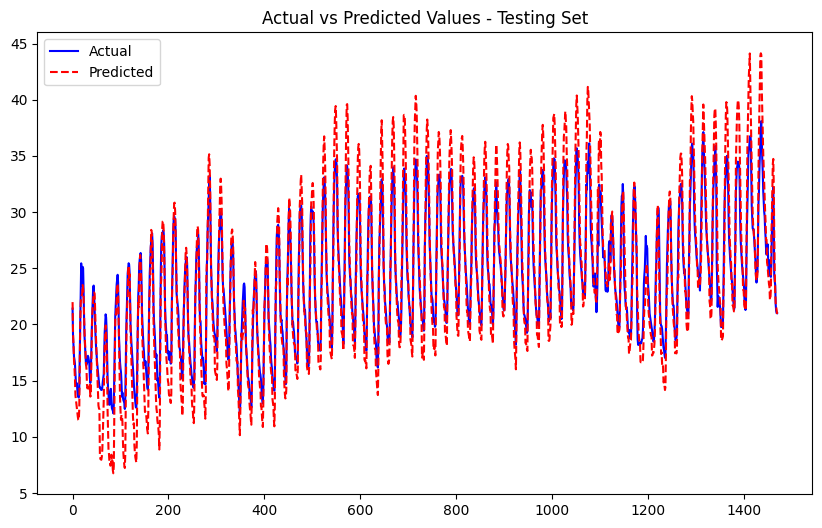

Processing node 30...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0655
Epoch [2/50], Train Loss: 0.0629
Epoch [3/50], Train Loss: 0.0619
Epoch [4/50], Train Loss: 0.0604
Epoch [5/50], Train Loss: 0.0599
Epoch [6/50], Train Loss: 0.0589
Epoch [7/50], Train Loss: 0.0587
Epoch [8/50], Train Loss: 0.0591
Epoch [9/50], Train Loss: 0.0582
Epoch [10/50], Train Loss: 0.0582
Epoch [11/50], Train Loss: 0.0590
Epoch [12/50], Train Loss: 0.0575
Epoch [13/50], Train Loss: 0.0576
Epoch [14/50], Train Loss: 0.0571
Epoch [15/50], Train Loss: 0.0572
Epoch [16/50], Train Loss: 0.0578
Epoch [17/50], Train Loss: 0.0570
Epoch [18/50], Train Loss: 0.0567
Epoch [19/50], Train Loss: 0.0568
Epoch [20/50], Train Loss: 0.0564
Epoch [21/50], Train Loss: 0.0567
Epoch [22/50], Train Loss: 0.0563
Epoch [23/50], Train Loss: 0.0559
Epoch [24/50], Train Loss: 0.0555
Epoch [25/50], Train Loss: 0.0564
Epoch [26/50], Train Loss: 0.0562
Epoch [27/50], Train Loss: 0.0557
Epoch [28/50], Train Loss: 0.0562
Epoch [29/50], Train Loss: 0.0549
Epoch [30/50], Train Lo

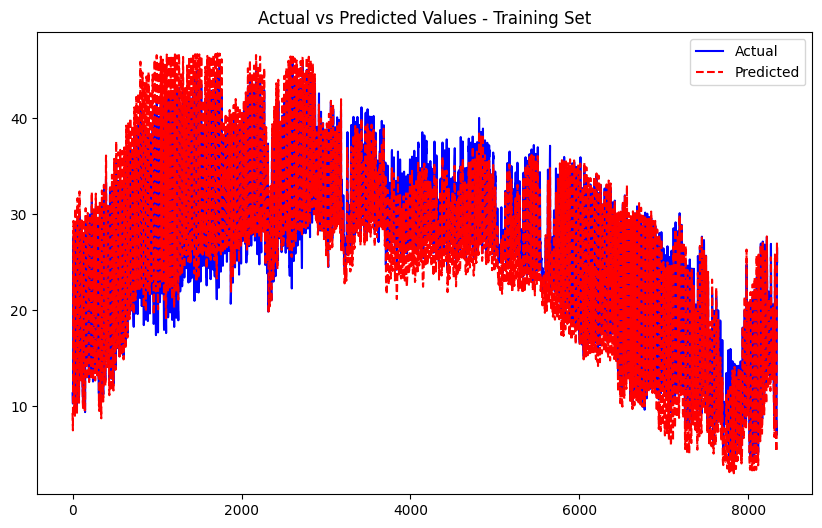

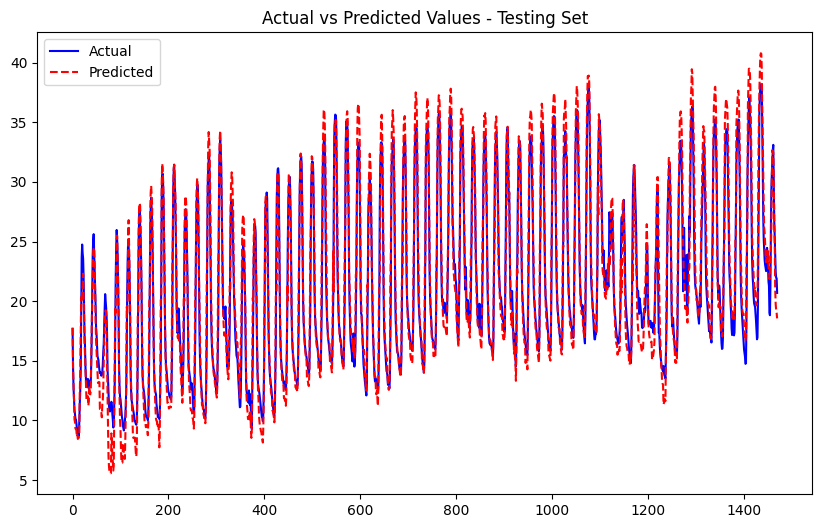

Processing node 31...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0552
Epoch [2/50], Train Loss: 0.0530
Epoch [3/50], Train Loss: 0.0528
Epoch [4/50], Train Loss: 0.0520
Epoch [5/50], Train Loss: 0.0507
Epoch [6/50], Train Loss: 0.0532
Epoch [7/50], Train Loss: 0.0532
Epoch [8/50], Train Loss: 0.0514
Epoch [9/50], Train Loss: 0.0509
Epoch [10/50], Train Loss: 0.0515
Epoch [11/50], Train Loss: 0.0507
Epoch [12/50], Train Loss: 0.0511
Epoch [13/50], Train Loss: 0.0503
Epoch [14/50], Train Loss: 0.0505
Epoch [15/50], Train Loss: 0.0495
Epoch [16/50], Train Loss: 0.0501
Epoch [17/50], Train Loss: 0.0504
Epoch [18/50], Train Loss: 0.0492
Epoch [19/50], Train Loss: 0.0493
Epoch [20/50], Train Loss: 0.0496
Epoch [21/50], Train Loss: 0.0492
Epoch [22/50], Train Loss: 0.0498
Epoch [23/50], Train Loss: 0.0493
Epoch [24/50], Train Loss: 0.0490
Epoch [25/50], Train Loss: 0.0495
Epoch [26/50], Train Loss: 0.0493
Epoch [27/50], Train Loss: 0.0496
Epoch [28/50], Train Loss: 0.0501
Epoch [29/50], Train Loss: 0.0495
Epoch [30/50], Train Lo

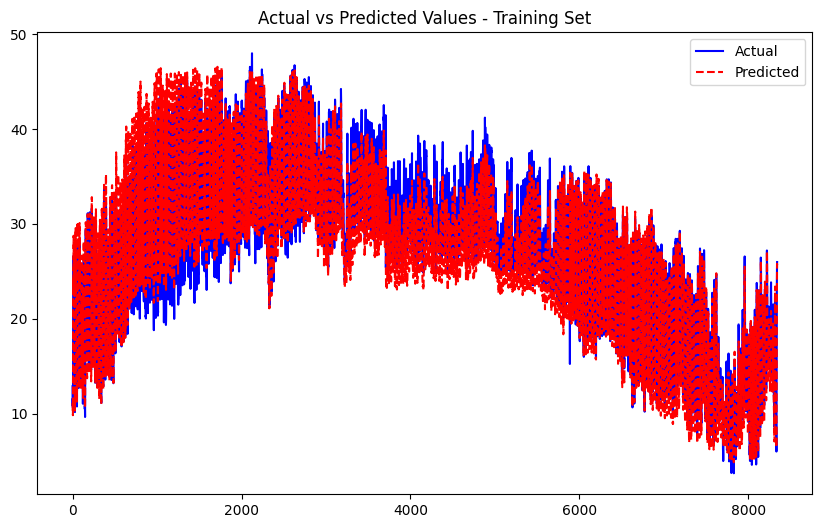

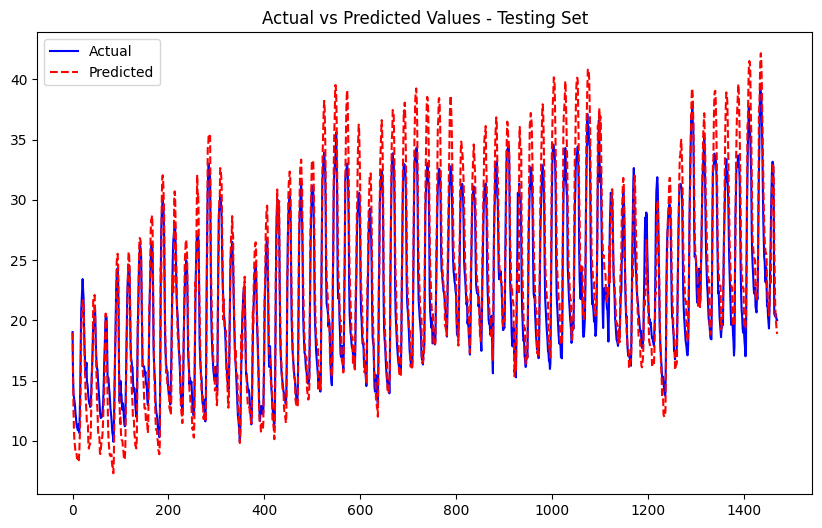

Processing node 32...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0471
Epoch [2/50], Train Loss: 0.0472
Epoch [3/50], Train Loss: 0.0468
Epoch [4/50], Train Loss: 0.0461
Epoch [5/50], Train Loss: 0.0466
Epoch [6/50], Train Loss: 0.0462
Epoch [7/50], Train Loss: 0.0459
Epoch [8/50], Train Loss: 0.0451
Epoch [9/50], Train Loss: 0.0449
Epoch [10/50], Train Loss: 0.0469
Epoch [11/50], Train Loss: 0.0452
Epoch [12/50], Train Loss: 0.0452
Epoch [13/50], Train Loss: 0.0454
Epoch [14/50], Train Loss: 0.0459
Epoch [15/50], Train Loss: 0.0444
Epoch [16/50], Train Loss: 0.0452
Epoch [17/50], Train Loss: 0.0452
Epoch [18/50], Train Loss: 0.0449
Epoch [19/50], Train Loss: 0.0447
Epoch [20/50], Train Loss: 0.0444
Epoch [21/50], Train Loss: 0.0448
Epoch [22/50], Train Loss: 0.0444
Epoch [23/50], Train Loss: 0.0445
Epoch [24/50], Train Loss: 0.0440
Epoch [25/50], Train Loss: 0.0440
Epoch [26/50], Train Loss: 0.0436
Epoch [27/50], Train Loss: 0.0438
Epoch [28/50], Train Loss: 0.0436
Epoch [29/50], Train Loss: 0.0434
Epoch [30/50], Train Lo

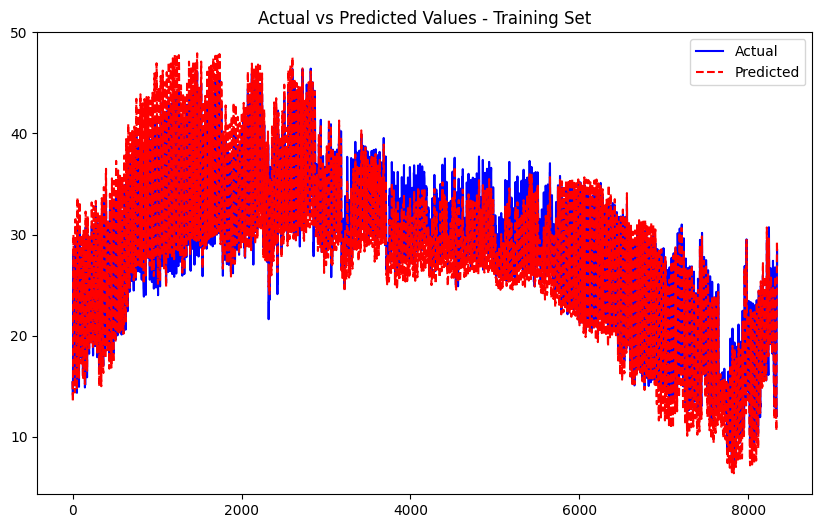

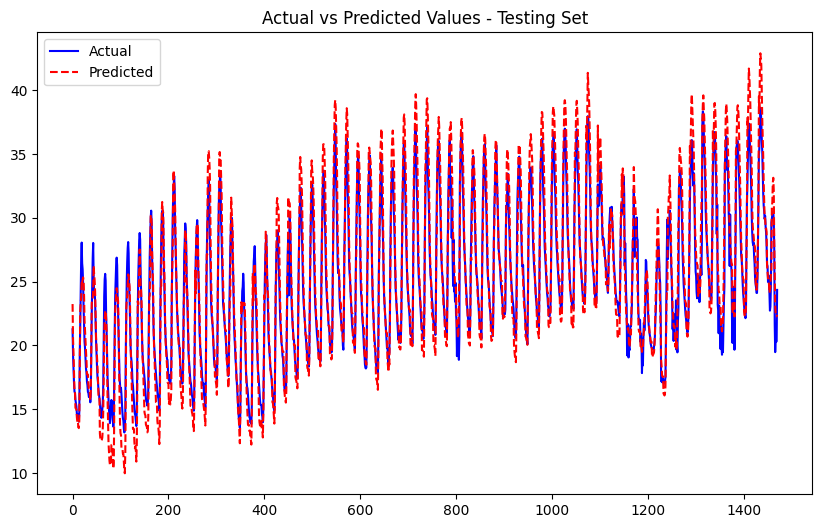

Processing node 33...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0577
Epoch [2/50], Train Loss: 0.0551
Epoch [3/50], Train Loss: 0.0544
Epoch [4/50], Train Loss: 0.0541
Epoch [5/50], Train Loss: 0.0534
Epoch [6/50], Train Loss: 0.0532
Epoch [7/50], Train Loss: 0.0526
Epoch [8/50], Train Loss: 0.0523
Epoch [9/50], Train Loss: 0.0523
Epoch [10/50], Train Loss: 0.0519
Epoch [11/50], Train Loss: 0.0518
Epoch [12/50], Train Loss: 0.0520
Epoch [13/50], Train Loss: 0.0524
Epoch [14/50], Train Loss: 0.0517
Epoch [15/50], Train Loss: 0.0520
Epoch [16/50], Train Loss: 0.0523
Epoch [17/50], Train Loss: 0.0521
Epoch [18/50], Train Loss: 0.0518
Epoch [19/50], Train Loss: 0.0517
Epoch [20/50], Train Loss: 0.0515
Epoch [21/50], Train Loss: 0.0508
Epoch [22/50], Train Loss: 0.0511
Epoch [23/50], Train Loss: 0.0510
Epoch [24/50], Train Loss: 0.0516
Epoch [25/50], Train Loss: 0.0510
Epoch [26/50], Train Loss: 0.0510
Epoch [27/50], Train Loss: 0.0517
Epoch [28/50], Train Loss: 0.0510
Epoch [29/50], Train Loss: 0.0506
Epoch [30/50], Train Lo

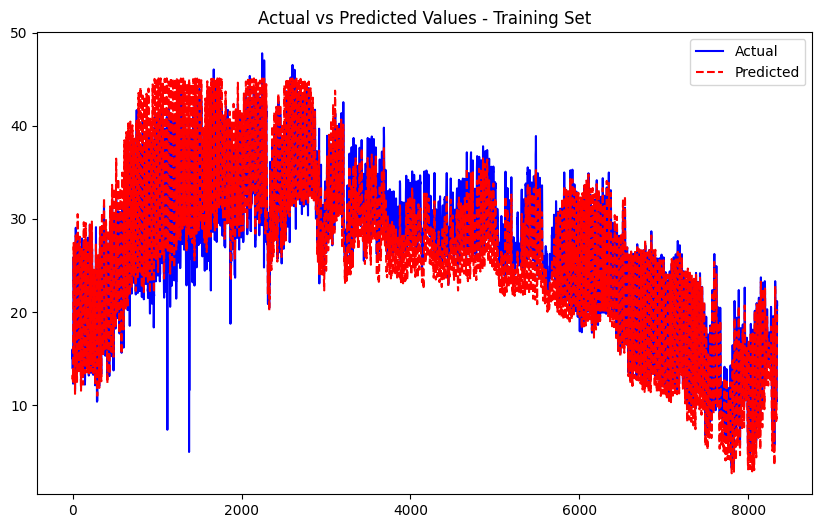

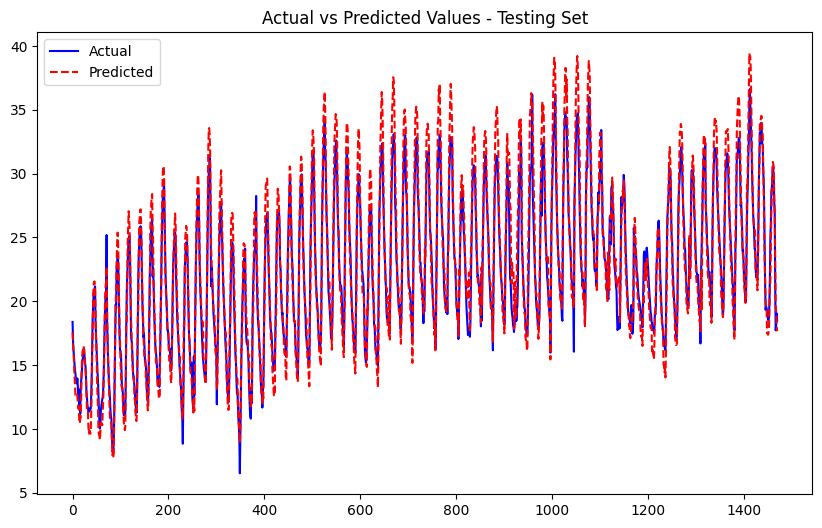

Processing node 34...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0471
Epoch [2/50], Train Loss: 0.0456
Epoch [3/50], Train Loss: 0.0454
Epoch [4/50], Train Loss: 0.0447
Epoch [5/50], Train Loss: 0.0448
Epoch [6/50], Train Loss: 0.0445
Epoch [7/50], Train Loss: 0.0442
Epoch [8/50], Train Loss: 0.0451
Epoch [9/50], Train Loss: 0.0437
Epoch [10/50], Train Loss: 0.0442
Epoch [11/50], Train Loss: 0.0438
Epoch [12/50], Train Loss: 0.0437
Epoch [13/50], Train Loss: 0.0440
Epoch [14/50], Train Loss: 0.0439
Epoch [15/50], Train Loss: 0.0438
Epoch [16/50], Train Loss: 0.0437
Epoch [17/50], Train Loss: 0.0440
Epoch [18/50], Train Loss: 0.0436
Epoch [19/50], Train Loss: 0.0436
Epoch [20/50], Train Loss: 0.0436
Epoch [21/50], Train Loss: 0.0436
Epoch [22/50], Train Loss: 0.0438
Epoch [23/50], Train Loss: 0.0430
Epoch [24/50], Train Loss: 0.0434
Epoch [25/50], Train Loss: 0.0430
Epoch [26/50], Train Loss: 0.0439
Epoch [27/50], Train Loss: 0.0434
Epoch [28/50], Train Loss: 0.0432
Epoch [29/50], Train Loss: 0.0436
Epoch [30/50], Train Lo

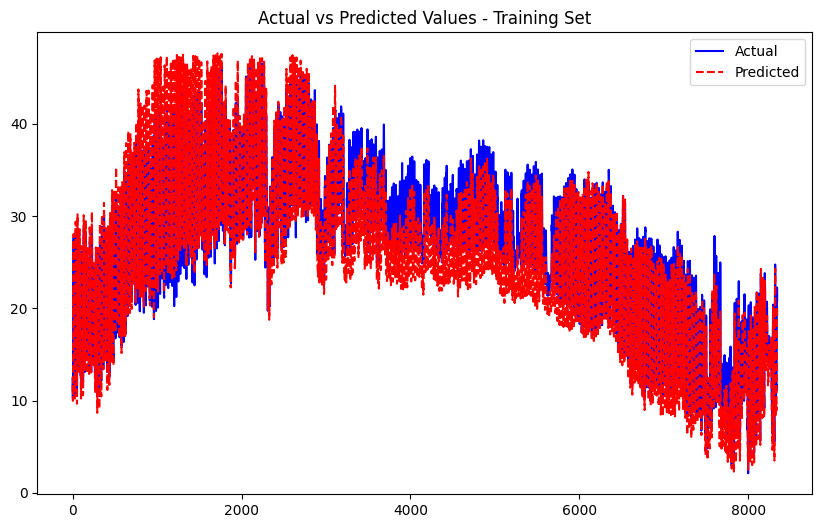

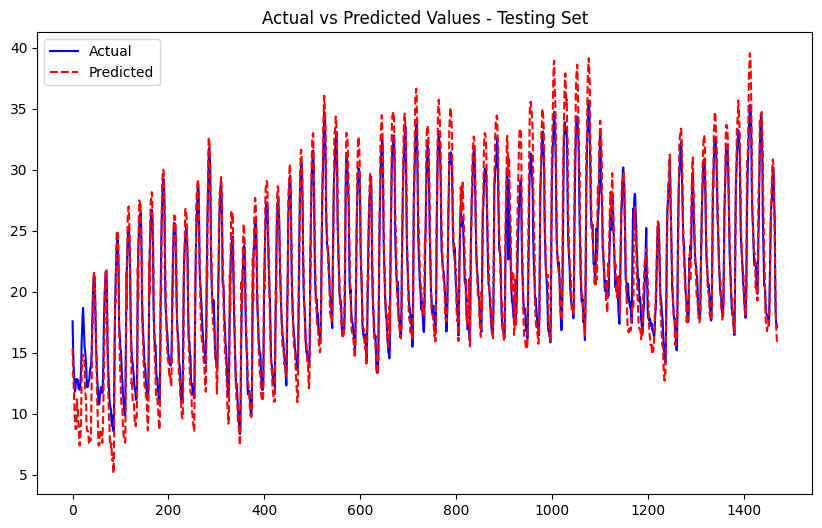

Processing node 35...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0464
Epoch [2/50], Train Loss: 0.0449
Epoch [3/50], Train Loss: 0.0450
Epoch [4/50], Train Loss: 0.0445
Epoch [5/50], Train Loss: 0.0439
Epoch [6/50], Train Loss: 0.0448
Epoch [7/50], Train Loss: 0.0431
Epoch [8/50], Train Loss: 0.0434
Epoch [9/50], Train Loss: 0.0436
Epoch [10/50], Train Loss: 0.0435
Epoch [11/50], Train Loss: 0.0430
Epoch [12/50], Train Loss: 0.0423
Epoch [13/50], Train Loss: 0.0433
Epoch [14/50], Train Loss: 0.0438
Epoch [15/50], Train Loss: 0.0425
Epoch [16/50], Train Loss: 0.0429
Epoch [17/50], Train Loss: 0.0431
Epoch [18/50], Train Loss: 0.0429
Epoch [19/50], Train Loss: 0.0436
Epoch [20/50], Train Loss: 0.0444
Epoch [21/50], Train Loss: 0.0431
Epoch [22/50], Train Loss: 0.0433
Epoch [23/50], Train Loss: 0.0428
Epoch [24/50], Train Loss: 0.0434
Epoch [25/50], Train Loss: 0.0429
Epoch [26/50], Train Loss: 0.0427
Epoch [27/50], Train Loss: 0.0431
Epoch [28/50], Train Loss: 0.0429
Epoch [29/50], Train Loss: 0.0425
Epoch [30/50], Train Lo

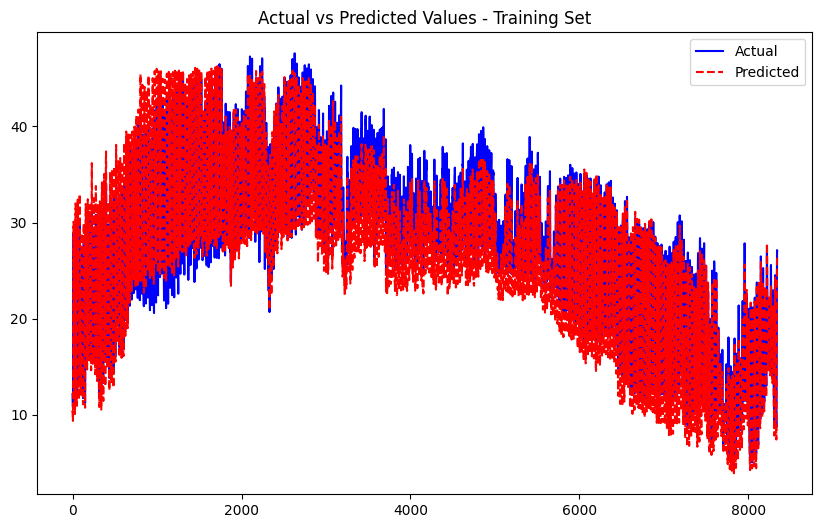

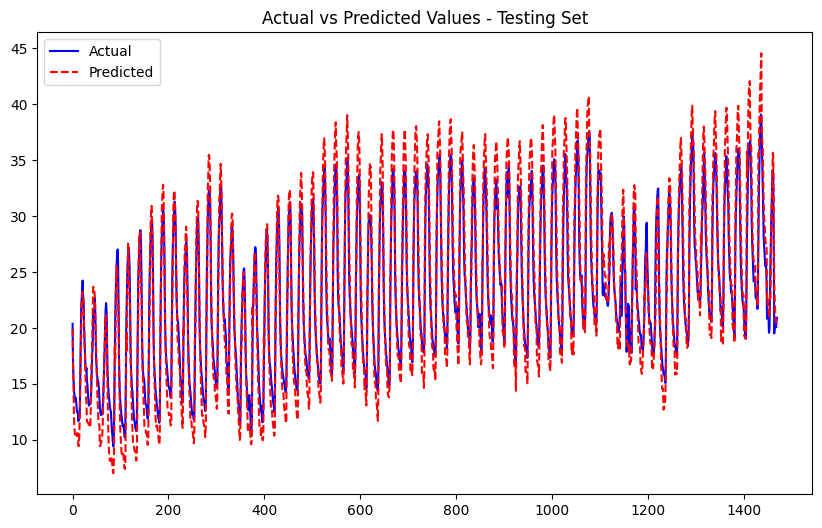

Processing node 36...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0499
Epoch [2/50], Train Loss: 0.0489
Epoch [3/50], Train Loss: 0.0484
Epoch [4/50], Train Loss: 0.0481
Epoch [5/50], Train Loss: 0.0480
Epoch [6/50], Train Loss: 0.0482
Epoch [7/50], Train Loss: 0.0474
Epoch [8/50], Train Loss: 0.0472
Epoch [9/50], Train Loss: 0.0470
Epoch [10/50], Train Loss: 0.0470
Epoch [11/50], Train Loss: 0.0470
Epoch [12/50], Train Loss: 0.0474
Epoch [13/50], Train Loss: 0.0472
Epoch [14/50], Train Loss: 0.0478
Epoch [15/50], Train Loss: 0.0477
Epoch [16/50], Train Loss: 0.0469
Epoch [17/50], Train Loss: 0.0467
Epoch [18/50], Train Loss: 0.0473
Epoch [19/50], Train Loss: 0.0470
Epoch [20/50], Train Loss: 0.0466
Epoch [21/50], Train Loss: 0.0472
Epoch [22/50], Train Loss: 0.0476
Epoch [23/50], Train Loss: 0.0501
Epoch [24/50], Train Loss: 0.0462
Epoch [25/50], Train Loss: 0.0462
Epoch [26/50], Train Loss: 0.0459
Epoch [27/50], Train Loss: 0.0465
Epoch [28/50], Train Loss: 0.0464
Epoch [29/50], Train Loss: 0.0454
Epoch [30/50], Train Lo

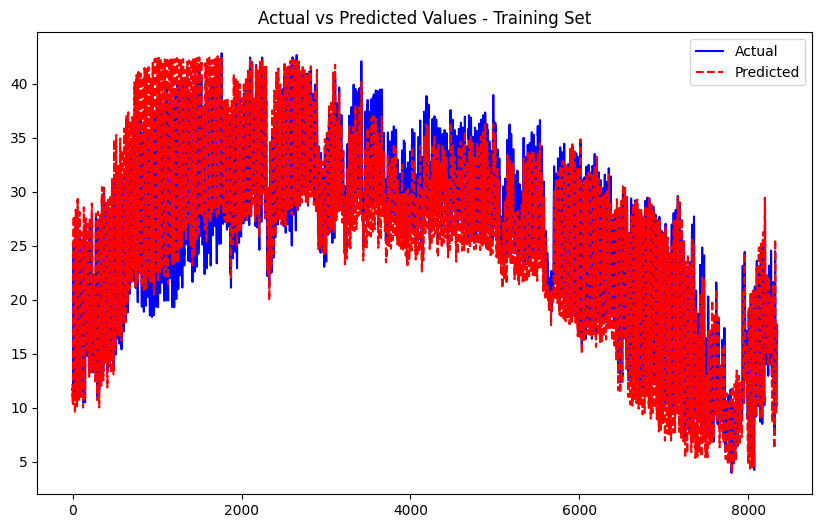

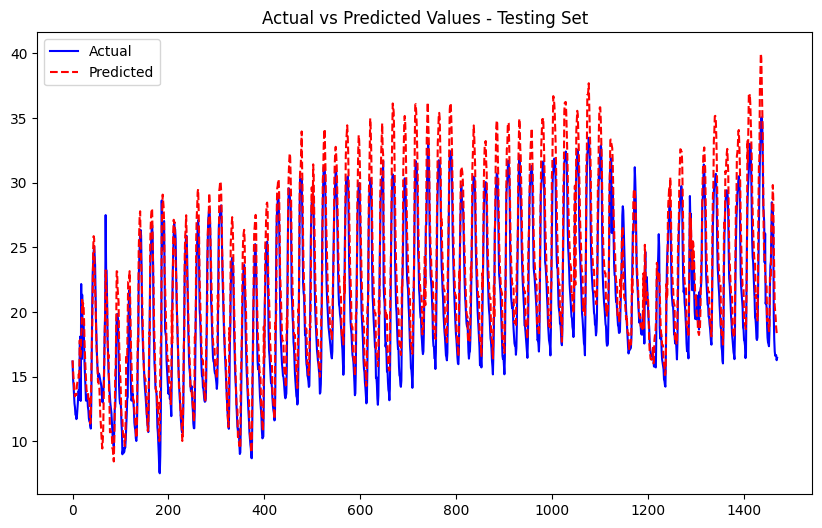

Processing node 37...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0540
Epoch [2/50], Train Loss: 0.0508
Epoch [3/50], Train Loss: 0.0504
Epoch [4/50], Train Loss: 0.0496
Epoch [5/50], Train Loss: 0.0507
Epoch [6/50], Train Loss: 0.0500
Epoch [7/50], Train Loss: 0.0494
Epoch [8/50], Train Loss: 0.0490
Epoch [9/50], Train Loss: 0.0507
Epoch [10/50], Train Loss: 0.0490
Epoch [11/50], Train Loss: 0.0490
Epoch [12/50], Train Loss: 0.0497
Epoch [13/50], Train Loss: 0.0495
Epoch [14/50], Train Loss: 0.0492
Epoch [15/50], Train Loss: 0.0486
Epoch [16/50], Train Loss: 0.0487
Epoch [17/50], Train Loss: 0.0485
Epoch [18/50], Train Loss: 0.0487
Epoch [19/50], Train Loss: 0.0486
Epoch [20/50], Train Loss: 0.0493
Epoch [21/50], Train Loss: 0.0487
Epoch [22/50], Train Loss: 0.0484
Epoch [23/50], Train Loss: 0.0481
Epoch [24/50], Train Loss: 0.0481
Epoch [25/50], Train Loss: 0.0476
Epoch [26/50], Train Loss: 0.0493
Epoch [27/50], Train Loss: 0.0487
Epoch [28/50], Train Loss: 0.0486
Epoch [29/50], Train Loss: 0.0490
Epoch [30/50], Train Lo

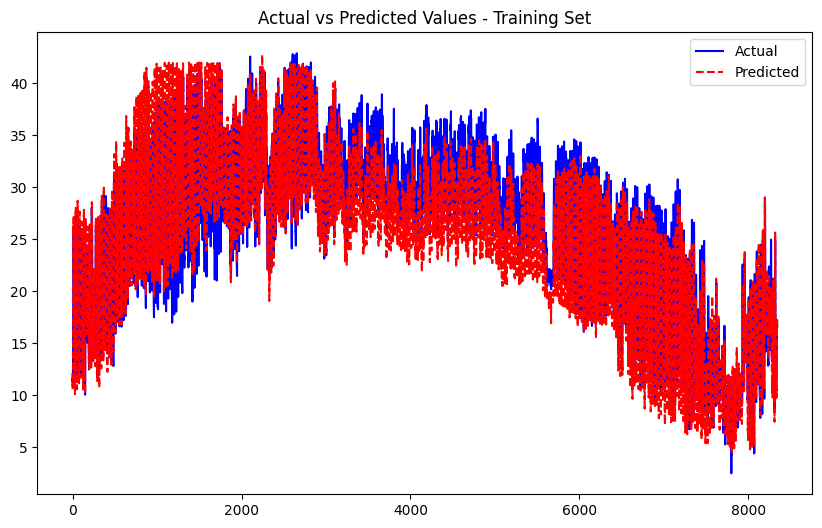

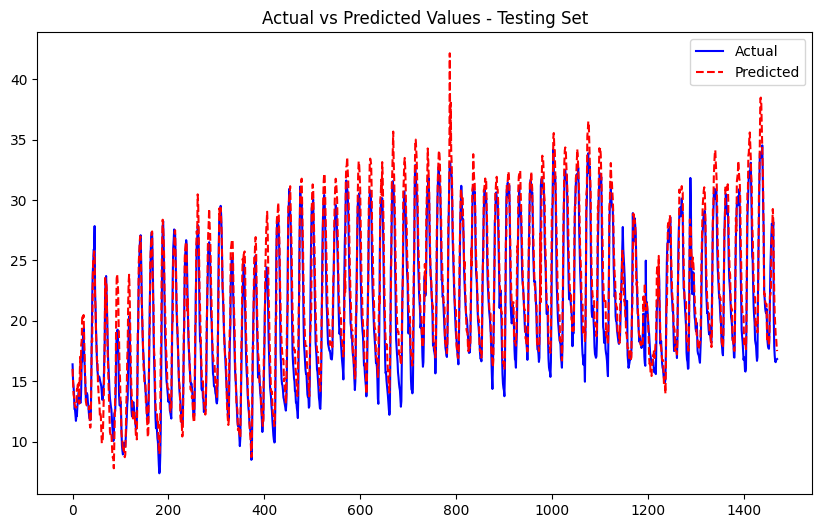

Processing node 38...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0459
Epoch [2/50], Train Loss: 0.0441
Epoch [3/50], Train Loss: 0.0438
Epoch [4/50], Train Loss: 0.0431
Epoch [5/50], Train Loss: 0.0431
Epoch [6/50], Train Loss: 0.0443
Epoch [7/50], Train Loss: 0.0421
Epoch [8/50], Train Loss: 0.0429
Epoch [9/50], Train Loss: 0.0428
Epoch [10/50], Train Loss: 0.0423
Epoch [11/50], Train Loss: 0.0427
Epoch [12/50], Train Loss: 0.0428
Epoch [13/50], Train Loss: 0.0421
Epoch [14/50], Train Loss: 0.0415
Epoch [15/50], Train Loss: 0.0418
Epoch [16/50], Train Loss: 0.0416
Epoch [17/50], Train Loss: 0.0424
Epoch [18/50], Train Loss: 0.0429
Epoch [19/50], Train Loss: 0.0417
Epoch [20/50], Train Loss: 0.0419
Epoch [21/50], Train Loss: 0.0421
Epoch [22/50], Train Loss: 0.0411
Epoch [23/50], Train Loss: 0.0419
Epoch [24/50], Train Loss: 0.0420
Epoch [25/50], Train Loss: 0.0416
Epoch [26/50], Train Loss: 0.0419
Epoch [27/50], Train Loss: 0.0422
Epoch [28/50], Train Loss: 0.0409
Epoch [29/50], Train Loss: 0.0415
Epoch [30/50], Train Lo

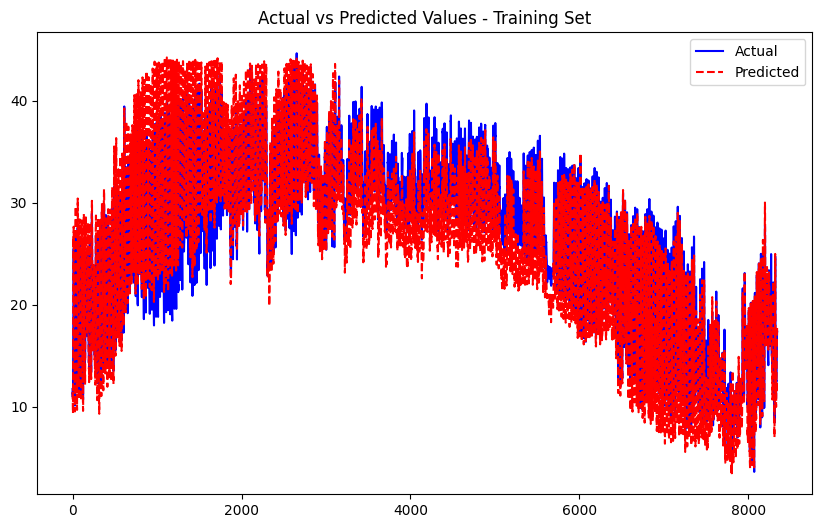

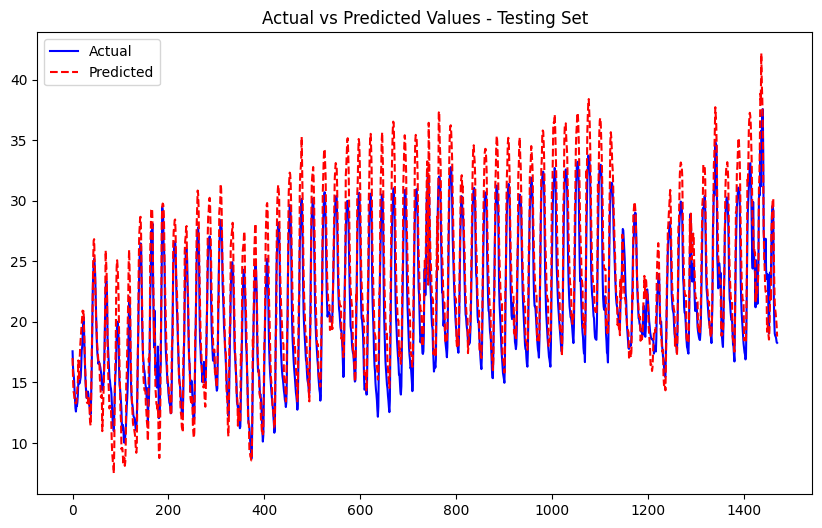

Processing node 39...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0805
Epoch [2/50], Train Loss: 0.0786
Epoch [3/50], Train Loss: 0.0776
Epoch [4/50], Train Loss: 0.0763
Epoch [5/50], Train Loss: 0.0755
Epoch [6/50], Train Loss: 0.0748
Epoch [7/50], Train Loss: 0.0748
Epoch [8/50], Train Loss: 0.0752
Epoch [9/50], Train Loss: 0.0742
Epoch [10/50], Train Loss: 0.0733
Epoch [11/50], Train Loss: 0.0734
Epoch [12/50], Train Loss: 0.0737
Epoch [13/50], Train Loss: 0.0735
Epoch [14/50], Train Loss: 0.0736
Epoch [15/50], Train Loss: 0.0730
Epoch [16/50], Train Loss: 0.0732
Epoch [17/50], Train Loss: 0.0728
Epoch [18/50], Train Loss: 0.0723
Epoch [19/50], Train Loss: 0.0730
Epoch [20/50], Train Loss: 0.0726
Epoch [21/50], Train Loss: 0.0721
Epoch [22/50], Train Loss: 0.0721
Epoch [23/50], Train Loss: 0.0720
Epoch [24/50], Train Loss: 0.0722
Epoch [25/50], Train Loss: 0.0738
Epoch [26/50], Train Loss: 0.0721
Epoch [27/50], Train Loss: 0.0716
Epoch [28/50], Train Loss: 0.0711
Epoch [29/50], Train Loss: 0.0714
Epoch [30/50], Train Lo

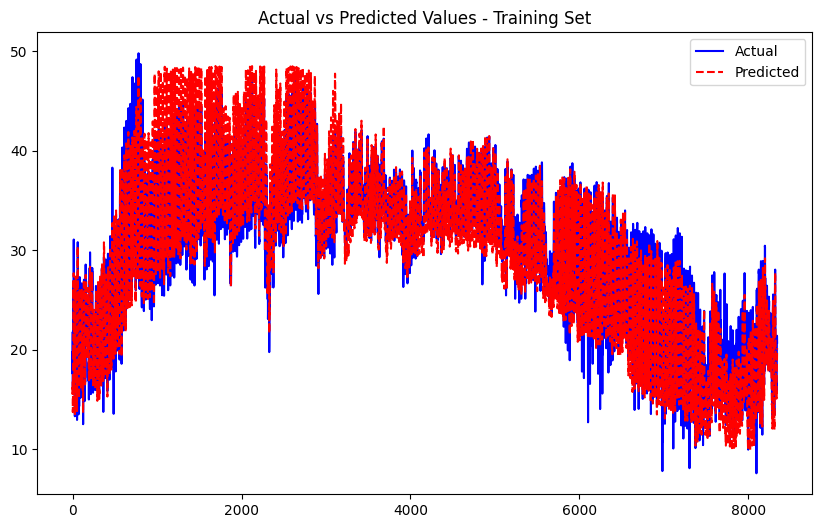

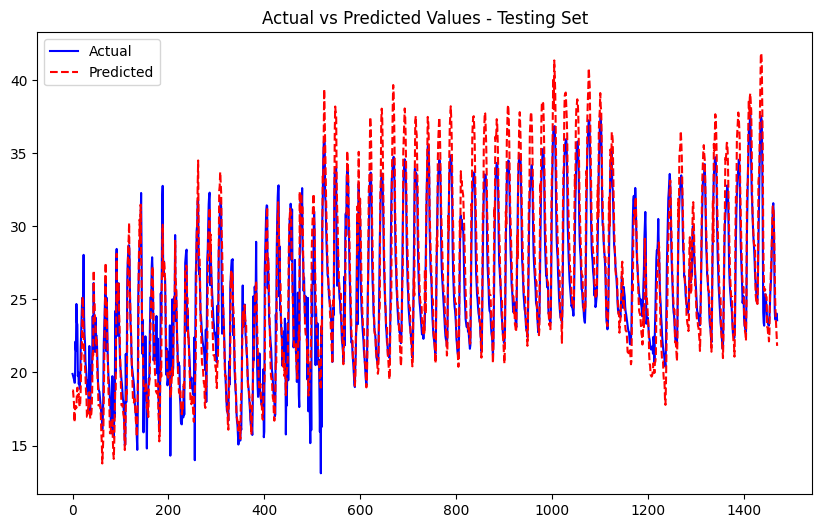

Processing node 40...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.2034
Epoch [2/50], Train Loss: 0.1834
Epoch [3/50], Train Loss: 0.1781
Epoch [4/50], Train Loss: 0.1917
Epoch [5/50], Train Loss: 0.1815
Epoch [6/50], Train Loss: 0.1845
Epoch [7/50], Train Loss: 0.1826
Epoch [8/50], Train Loss: 0.1762
Epoch [9/50], Train Loss: 0.1713
Epoch [10/50], Train Loss: 0.1662
Epoch [11/50], Train Loss: 0.1584
Epoch [12/50], Train Loss: 0.1564
Epoch [13/50], Train Loss: 0.1624
Epoch [14/50], Train Loss: 0.1585
Epoch [15/50], Train Loss: 0.1635
Epoch [16/50], Train Loss: 0.1466
Epoch [17/50], Train Loss: 0.1450
Epoch [18/50], Train Loss: 0.1669
Epoch [19/50], Train Loss: 0.1431
Epoch [20/50], Train Loss: 0.1334
Epoch [21/50], Train Loss: 0.1416
Epoch [22/50], Train Loss: 0.1521
Epoch [23/50], Train Loss: 0.1317
Epoch [24/50], Train Loss: 0.1300
Epoch [25/50], Train Loss: 0.1301
Epoch [26/50], Train Loss: 0.1244
Epoch [27/50], Train Loss: 0.1265
Epoch [28/50], Train Loss: 0.1210
Epoch [29/50], Train Loss: 0.1259
Epoch [30/50], Train Lo

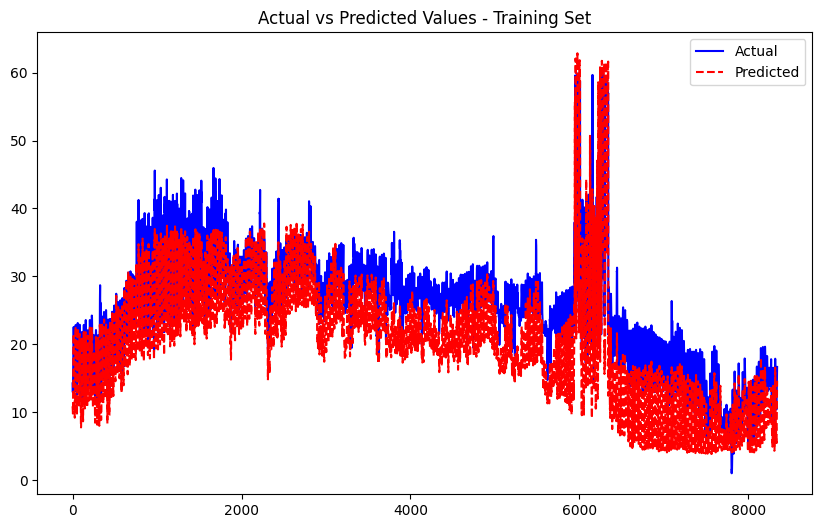

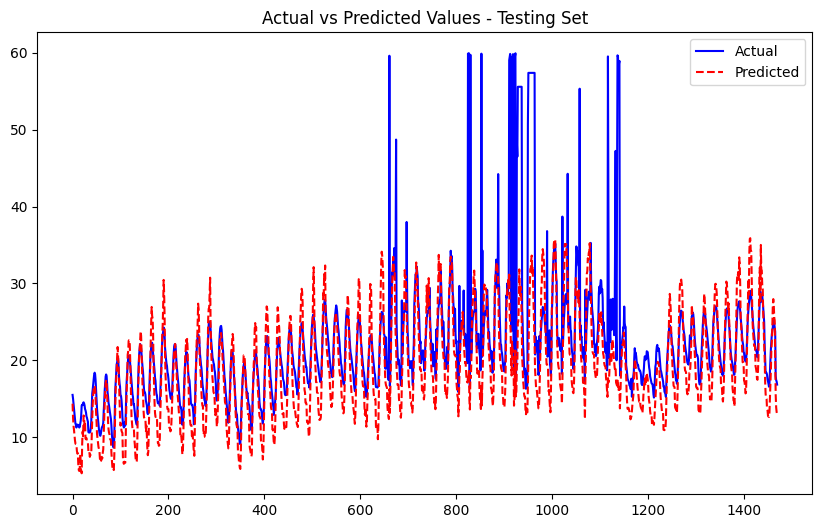

Processing node 41...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0936
Epoch [2/50], Train Loss: 0.0827
Epoch [3/50], Train Loss: 0.0766
Epoch [4/50], Train Loss: 0.0736
Epoch [5/50], Train Loss: 0.0727
Epoch [6/50], Train Loss: 0.0701
Epoch [7/50], Train Loss: 0.0689
Epoch [8/50], Train Loss: 0.0681
Epoch [9/50], Train Loss: 0.0668
Epoch [10/50], Train Loss: 0.0677
Epoch [11/50], Train Loss: 0.0671
Epoch [12/50], Train Loss: 0.0670
Epoch [13/50], Train Loss: 0.0661
Epoch [14/50], Train Loss: 0.0656
Epoch [15/50], Train Loss: 0.0666
Epoch [16/50], Train Loss: 0.0672
Epoch [17/50], Train Loss: 0.0655
Epoch [18/50], Train Loss: 0.0648
Epoch [19/50], Train Loss: 0.0661
Epoch [20/50], Train Loss: 0.0652
Epoch [21/50], Train Loss: 0.0663
Epoch [22/50], Train Loss: 0.0642
Epoch [23/50], Train Loss: 0.0657
Epoch [24/50], Train Loss: 0.0646
Epoch [25/50], Train Loss: 0.0641
Epoch [26/50], Train Loss: 0.0645
Epoch [27/50], Train Loss: 0.0639
Epoch [28/50], Train Loss: 0.0645
Epoch [29/50], Train Loss: 0.0643
Epoch [30/50], Train Lo

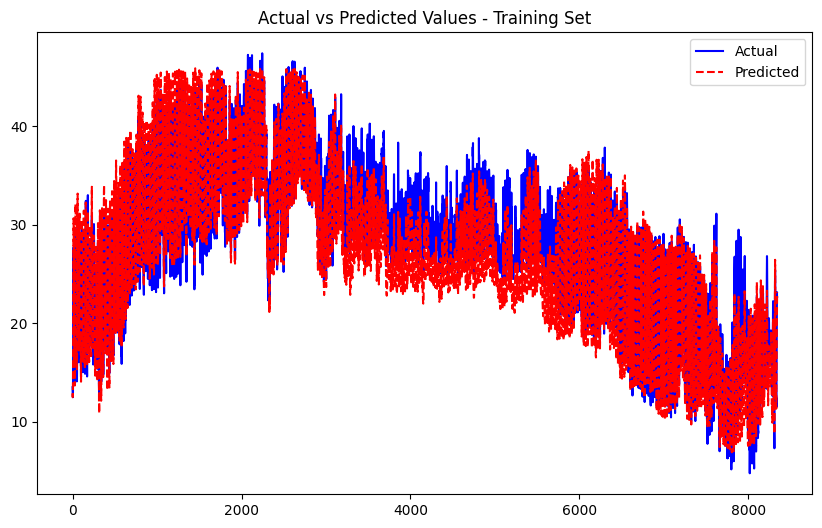

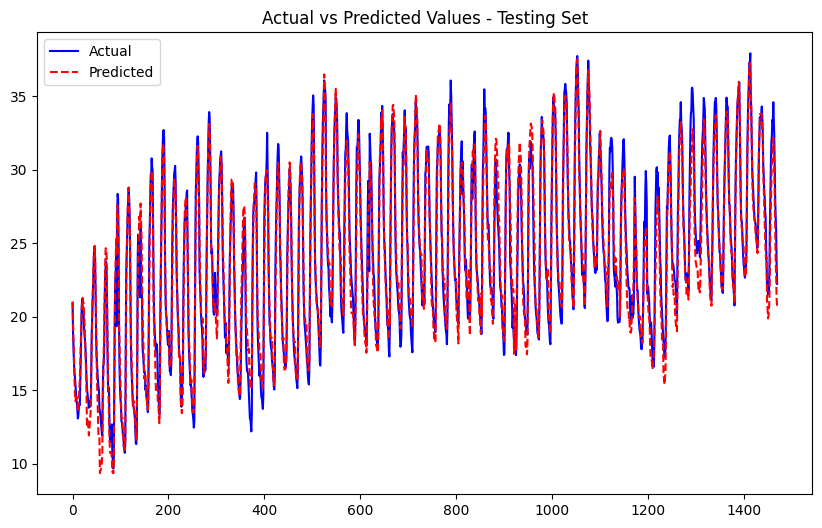

Train GNN and Transformer Imputed bs 3 sl 3.csv
CSV file 'Train GNN and Transformer Imputed bs 3 sl 3.csv' created successfully.
Test GNN and Transformer Imputed bs 3 sl 3.csv
CSV file 'Test GNN and Transformer Imputed bs 3 sl 3.csv' created successfully.


In [21]:
import torch
import torch.nn as nn
import torch.optim as optim
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import matplotlib.pyplot as plt
import numpy as np
import torch.optim.lr_scheduler as lr_scheduler

# Define the Transformer Model
class TransformerModel(nn.Module):
    def __init__(self, input_size, hidden_size, num_layers, output_size, num_heads=4, dropout_prob=0.2):
        super(TransformerModel, self).__init__()
        self.hidden_size = hidden_size
        
        # Define the embedding layer for input data
        self.embedding = nn.Linear(input_size, hidden_size)
        
        # Define the Transformer Encoder Layer
        encoder_layer = nn.TransformerEncoderLayer(d_model=hidden_size, nhead=num_heads, dim_feedforward=hidden_size*4, dropout=dropout_prob)
        self.transformer_encoder = nn.TransformerEncoder(encoder_layer, num_layers=num_layers)
        
        # Fully connected layer (output layer)
        self.fc = nn.Linear(hidden_size, output_size)
        
        # Activation function
        self.elu = nn.ELU()

    def forward(self, x):
        # Input shape: (batch_size, sequence_length, input_size)
        x = self.embedding(x)  # Apply embedding layer
        x = x.permute(1, 0, 2)  # Reshape to (sequence_length, batch_size, hidden_size) for Transformer

        # Pass through Transformer encoder
        out = self.transformer_encoder(x)  # out shape: (sequence_length, batch_size, hidden_size)
        
        # Extract the last time step output and apply ELU activation
        out = self.elu(out[-1, :, :])  # Take the last time step (batch_size, hidden_size)
        
        # Pass the output through the fully connected layer
        out = self.fc(out)
        
        return out


def train_model(model, train_loader, criterion, optimizer, num_epochs):
    model.train()  # Set the model to training mode
    for epoch in range(num_epochs):
        running_loss = 0.0
        
        # Training phase
        for features, targets in train_loader:
            features, targets = features.to(device), targets.to(device)
            
            # Forward pass
            outputs = model(features)
            loss = criterion(outputs, targets)  # Compute the loss

            # Backward and optimize
            optimizer.zero_grad()  # Clear previous gradients
            loss.backward()  # Backpropagate the loss
            optimizer.step()  # Update weights

            running_loss += loss.item()   

        # Print training loss after each epoch
        print(f'Epoch [{epoch+1}/{num_epochs}], Train Loss: {running_loss/len(train_loader):.4f}')
    
    # Switch back to evaluation mode
    model.eval()



def test_model(model, train_loader, test_loader, node_idx):
    model.eval()
    all_actuals = []
    all_predictions = []
    
    # For tracking actuals and predictions for train and test sets separately
    train_actuals = []
    train_predictions = []
    
    test_actuals = []
    test_predictions = []

    
    with torch.no_grad():
        # Predict on training data
        for features, targets in train_loader:
            features, targets = features.to(device), targets.to(device)
            outputs = model(features)

            train_actuals.append(targets.cpu().numpy())
            train_predictions.append(outputs.cpu().numpy())

        # Predict on testing data
        for features, targets in test_loader:
            features, targets = features.to(device), targets.to(device)
            outputs = model(features)

            test_actuals.append(targets.cpu().numpy())
            test_predictions.append(outputs.cpu().numpy())
    
    # Concatenate all sets
    train_actuals = np.concatenate(train_actuals, axis=0)
    test_actuals = np.concatenate(test_actuals, axis=0)
    
    train_predictions = np.concatenate(train_predictions, axis=0)
    test_predictions = np.concatenate(test_predictions, axis=0)

    # Check shapes before proceeding
    print(f"Training actuals shape: {train_actuals.shape}, Predictions shape: {train_predictions.shape}")
    print(f"Testing actuals shape: {test_actuals.shape}, Predictions shape: {test_predictions.shape}")
    
    # Combine them for inverse scaling
    all_actuals = np.concatenate([train_actuals, test_actuals])
    all_predictions = np.concatenate([train_predictions, test_predictions])
    
    # Inverse scaling
    file_name = input_files[node_idx]
    
    if file_name in scalers:
        all_actuals = all_actuals.reshape(-1, 1)
        all_predictions = all_predictions.reshape(-1, 1)
        
        # Apply inverse scaling
        all_actuals_inverse = scalers[file_name].inverse_transform(all_actuals).flatten()
        all_predictions_inverse = scalers[file_name].inverse_transform(all_predictions).flatten()
    else:
        print(f"Scaler not found for {file_name}")
        return
    
    # Split them back into training and test sets
    train_size = len(train_actuals)
    test_size = len(test_actuals)
    
    train_actuals_inverse = all_actuals_inverse[:train_size]
    test_actuals_inverse = all_actuals_inverse[train_size:]
    
    train_predictions_inverse = all_predictions_inverse[:train_size]
    test_predictions_inverse = all_predictions_inverse[train_size:]

    # Verify split sizes
    print(f"Split Training actuals shape: {train_actuals_inverse.shape}, Predictions shape: {train_predictions_inverse.shape}")
    print(f"Split Testing actuals shape: {test_actuals_inverse.shape}, Predictions shape: {test_predictions_inverse.shape}")
    
    # Function to calculate and print metrics
    def calculate_metrics(actuals, predictions, set_name):
        mae = mean_absolute_error(actuals, predictions)
        mse = mean_squared_error(actuals, predictions)
        rmse = np.sqrt(mse)
        r2 = r2_score(actuals, predictions)
        corr_coeff = np.corrcoef(actuals.flatten(), predictions.flatten())[0, 1]
        
        # Print the metrics
        print(f"{set_name} Set Metrics:")
        print(f"Mean Absolute Error (MAE): {mae:.4f}")
        print(f"Mean Squared Error (MSE): {mse:.4f}")
        print(f"Root Mean Squared Error (RMSE): {rmse:.4f}")
        print(f"Pearson Correlation Coefficient: {corr_coeff:.4f}")
        print(f"R-squared (R²): {r2:.4f}")
        print("\n" + "-"*40 + "\n")

        if set_name == 'Training':
            train_mae_list.append(mae)
            train_mse_list.append(mse)
            train_rmse_list.append(rmse)
            train_r2_list.append(r2)
            train_corr_list.append(corr_coeff)

        elif set_name == 'Testing':
            test_mae_list.append(mae)
            test_mse_list.append(mse)
            test_rmse_list.append(rmse)
            test_r2_list.append(r2)
            test_corr_list.append(corr_coeff)        
    
    # Calculate and print metrics for each set
    print(f"\nCalculating metrics for Node {node_idx+1} - {file_name}")
    calculate_metrics(train_actuals_inverse, train_predictions_inverse, 'Training')
    calculate_metrics(test_actuals_inverse, test_predictions_inverse, 'Testing')

    print(f"\n\nCalculating Average Metrics for Training:")
    print(f"Mean MAE: {np.mean(train_mae_list):.4f}")
    print(f"Mean MSE: {np.mean(train_mse_list):.4f}")
    print(f"Mean RMSE: {np.mean(train_rmse_list):.4f}")
    print(f"Mean R²: {np.mean(train_r2_list):.4f}")
    print(f"Mean CorrCoeff: {np.mean(train_corr_list):.4f}")

    print(f"\n\nCalculating Average Metrics for Testing:")
    print(f"Mean MAE: {np.mean(test_mae_list):.4f}")
    print(f"Mean MSE: {np.mean(test_mse_list):.4f}")
    print(f"Mean RMSE: {np.mean(test_rmse_list):.4f}")
    print(f"Mean R²: {np.mean(test_r2_list):.4f}")
    print(f"Mean CorrCoeff: {np.mean(test_corr_list):.4f}")
    
    # Function to plot actual vs predicted values
    def plot_results(actuals, predictions, set_name):
        plt.figure(figsize=(10, 6))
        plt.plot(actuals, label="Actual", color='blue')
        plt.plot(predictions, label="Predicted", color='red', linestyle='dashed')
        plt.title(f'Actual vs Predicted Values - {set_name} Set')
        plt.legend()
        plt.show()
    
    # Plot results for each set
    plot_results(train_actuals_inverse, train_predictions_inverse, 'Training')
    plot_results(test_actuals_inverse, test_predictions_inverse, 'Testing')


def create_dataloaders(features, targets, batch_size, sequence_length):
    # Convert DataFrame to NumPy arrays
    features_np = features.to_numpy()
    targets_np = targets.to_numpy()

    # Prepare sequences of data
    feature_sequences = []
    target_sequences = []

    # Create rolling windows of `sequence_length`
    for i in range(len(features_np) - sequence_length + 1):
        # Get sequence of features and corresponding target
        feature_sequences.append(features_np[i:i+sequence_length])
        target_sequences.append(targets_np[i+sequence_length-1])  # target is the last value of the sequence

    # Convert to NumPy arrays
    feature_sequences = np.array(feature_sequences)
    target_sequences = np.array(target_sequences)

    # Convert to PyTorch tensors
    features_tensor = torch.tensor(feature_sequences, dtype=torch.float32)
    targets_tensor = torch.tensor(target_sequences, dtype=torch.float32)

    # Create a dataset and dataloader
    dataset = torch.utils.data.TensorDataset(features_tensor, targets_tensor)
    return torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=False)

# Initialize the Transformer model, criterion, and optimizer
input_size = train_features_list[0].shape[1]
hidden_size = 128
num_layers = 2
output_size = 1
num_heads = 2  # Number of attention heads in Transformer
num_epochs = 50
learning_rate = 0.0005
batch_size = 3
sequence_length = 3

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = TransformerModel(input_size, hidden_size, num_layers, output_size, num_heads=num_heads).to(device)
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

print(f"For Batch Size= {batch_size} and Sequence Length = {sequence_length}")
train_mae_list = []
train_mse_list = []
train_rmse_list = []
train_r2_list = []
train_corr_list = []

test_mae_list = []
test_mse_list = []
test_rmse_list = []
test_r2_list = []
test_corr_list = []

# Process for each node
for node_idx, (train_features, train_targets, test_features, test_targets) in enumerate(zip(train_features_list, train_target_list, test_features_list, test_target_list)):
    print(f"Processing node {node_idx+1}...")

    # Create dataloaders
    train_loader = create_dataloaders(train_features, train_targets, batch_size, sequence_length)
    test_loader = create_dataloaders(test_features, test_targets, batch_size, sequence_length)

    # Train the model
    train_model(model, train_loader, criterion, optimizer, num_epochs)

    # Test the model and output metrics/plot
    test_model(model, train_loader, test_loader, node_idx)

    # Define function to create DataFrame and save to CSV
def create_metrics_csv(file_name, input_files, mae_list, mse_list, rmse_list, r2_list, corr_list):
    metrics_df = pd.DataFrame({
        "File Name": input_files,
        "MAE": mae_list,
        "MSE": mse_list,
        "RMSE": rmse_list,
        "R2": r2_list,
        "CorrCoeff": corr_list
    })
    metrics_df.to_csv(file_name, index=False)
    print(f"CSV file '{file_name}' created successfully.")

# Create CSV for training set
file_name = "Train GNN and Transformer Imputed bs 3 sl 3.csv"
print(file_name)
create_metrics_csv(file_name, input_files, train_mae_list, train_mse_list, train_rmse_list, train_r2_list, train_corr_list)

# Create CSV for test set
file_name = "Test GNN and Transformer Imputed bs 3 sl 3.csv"
print(file_name)
create_metrics_csv(file_name, input_files, test_mae_list, test_mse_list, test_rmse_list, test_r2_list, test_corr_list)    
